# **8. Deep Learning Software**
---



## 8.1 GPU and CPU: Overview and Evolution

### **CPUs (Central Processing Units)**
- **Function**: CPUs are optimized for **single-threaded performance**, handling tasks sequentially. Modern CPUs, especially from **Intel** (e.g., **Core i9** series) and **AMD** (e.g., **Ryzen 9** series), now feature **up to 16-24 cores** with **multi-threading** (SMT or Hyper-Threading), enabling better parallelism. Additionally, high-efficiency cores, such as those in Intel's **Alder Lake** and **Raptor Lake**, offer performance for mixed workloads.
- **Architectural Evolution**: CPUs have evolved with improvements in core count, clock speed, and **IPC (Instructions Per Cycle)**, making them highly capable for sequential tasks, like general-purpose computing, data processing, and running operating systems.
- **Memory**: CPUs utilize **DDR5** memory for faster access compared to older DDR4 systems, enhancing overall system performance.

### **GPUs (Graphics Processing Units)**
- **Function**: GPUs are built for **massive parallel processing** and excel at tasks like **image rendering**, **matrix multiplications**, and **deep learning**. Modern GPUs, especially from **NVIDIA** (e.g., **RTX 40 series** and **A100** series) and **AMD** (e.g., **RDNA** and **CDNA**), feature thousands of **cores** and are designed to handle high-throughput tasks.
- **Specialized Hardware**: For deep learning, NVIDIA’s **Tensor Cores** accelerate matrix operations central to neural networks, and specialized hardware like **TPUs** from Google further optimizes AI workloads.
- **Memory**: Modern GPUs use **GDDR6X** memory, offering significantly faster data access compared to older **GDDR5X** systems, and their memory sizes now reach up to **24 GB** or more for high-end models like the **NVIDIA A100**.

### **Key Differences: CPU vs GPU**
- **Core Architecture**:
  - **CPU**: Fewer, but faster and more capable cores. Best for **sequential tasks** and general-purpose processing.
  - **GPU**: Thousands of slower cores, optimized for **parallel tasks**, making them ideal for tasks like deep learning, scientific simulations, and 3D rendering.
  
- **Clock Speed**:
  - **CPU** cores run at high clock speeds (e.g., **3.5–5 GHz**), providing high performance for tasks requiring sequential execution.
  - **GPU** cores operate at lower speeds (e.g., **1.6 GHz**), but with significantly more cores to handle parallelism.

- **Memory and Bandwidth**:
  - **CPU**: Uses shared system memory (e.g., **DDR4/DDR5**), which can be a bottleneck for heavy workloads.
  - **GPU**: Uses **high-bandwidth dedicated memory** like **GDDR5X** and **GDDR6X**, allowing faster data handling for large-scale calculations.
 - **CPU Best For**:
    - Sequential tasks (e.g., running algorithms with many conditional branches)
    - Single-threaded operations
    - General-purpose computing
 - **GPU Best For**:
    - Parallel computing tasks (e.g., matrix operations, training neural networks)
    - Handling large datasets for deep learning
    - Tasks requiring high throughput (e.g., video rendering, image processing)

### Modern Use Cases for CPUs and GPUs
- **CPUs** remain indispensable for general-purpose computing, where tasks are less parallelizable or require high single-threaded performance, like running operating systems and certain application software.
- **GPUs** have become the powerhouse for modern **AI/ML (Artificial Intelligence/Machine Learning)** tasks. With their ability to perform many operations simultaneously, they excel in applications like **deep learning**, **computer vision**, and **data science**.

### Programming GPUs
- **CUDA** (for NVIDIA GPUs) is the most widely used platform for GPU programming, providing high-level libraries such as **cuDNN** (for deep learning) and **cuBLAS** (for linear algebra).
- **OpenCL** is an alternative to CUDA that works on GPUs from any vendor, though it is generally slower.
- Modern software tools, such as **TensorFlow**, **PyTorch**, and **MXNet**, leverage these frameworks, allowing deep learning researchers and practitioners to offload computations to GPUs with minimal manual programming.

### Performance: CPU vs GPU in Practice
- **Benchmarking**: When comparing the performance of CPUs and GPUs for deep learning tasks, GPUs, particularly with specialized libraries like **cuDNN** and optimized CUDA code, are much faster. For example, **GPU-based training** can be **66x to 76x faster** than CPU-based solutions, depending on the task and the setup.
- **Data Transfer Bottleneck**: One of the main bottlenecks in training deep learning models on GPUs is the transfer of data from **CPU to GPU**. Modern systems mitigate this by:
  - Using **high-speed SSDs** instead of HDDs for faster data read/write operations.
  - Loading all data into **RAM** and using **multiple CPU threads** for efficient prefetching of data.
  - Employing **high-bandwidth interconnects** like **NVIDIA NVLink** or **AMD Infinity Fabric** for efficient data transfer between multiple GPUs and CPUs.

### Modern Cloud Platforms and AI Hardware
- **Cloud computing** services such as **AWS**, **Azure**, and **Google Cloud** offer **GPU-based instances** (e.g., **NVIDIA Tesla V100** and **A100**) for on-demand access to powerful hardware for training deep learning models. These instances are equipped with specialized AI chips, such as **Tensor Cores** (NVIDIA) and **TPUs** (Google), which provide superior performance for matrix-based calculations and AI workloads.

### CPU/GPU Communication

When using GPUs for deep learning, there’s often a bottleneck in transferring data between the CPU and GPU. This is particularly noticeable when the data is large and needs to be loaded into memory before training begins. To mitigate this, you can:

- **Read all data into RAM** to reduce disk access time.
- **Use SSDs** instead of slower hard drives to speed up data transfer.
- **Use multiple CPU threads** to prefetch and load data into memory ahead of time, ensuring the GPU stays busy without waiting for data.

### Conclusion

- **CPUs** are still essential for general-purpose computing, especially for single-threaded tasks. However, as workloads become increasingly parallel, **GPUs** are taking the lead, especially in **AI**, **machine learning**, and **scientific computing**.

- **GPUs** are now central to modern computational tasks, not just for gaming and graphics, but for handling vast amounts of data and computations involved in deep learning, AI, and big data analytics. The evolution of hardware, such as **NVIDIA's A100**, **Google's TPUs**, and **AMD's ROCm platform**, demonstrates the shift towards specialized hardware for AI, marking a turning point in the future of computing.

While GPUs are essential for high-performance deep learning, CPUs remain important for other aspects of computation and are often used together with GPUs to create an optimized workflow.

---

- **CUDA (Compute Unified Device Architecture)**: This is NVIDIA's parallel computing platform and API. It allows developers to leverage the power of GPUs for general-purpose processing.
  
- **Tensor Cores**: Some GPUs, especially those from NVIDIA, feature Tensor Cores, which are specialized for deep learning tasks and further accelerate matrix operations in neural network training.



### 8.1.1 Matrix Multiplication: CPU vs GPU

#### Matrix Multiplication on a CPU
- **How it Works**:  
  CPUs utilize a small number of high-performance cores to handle matrix multiplication sequentially or in smaller parallel chunks.  
  - **Example**: For multiplying two matrices A (m x n) and B (n x p), the CPU computes the dot product for each cell in C (m x p) row-by-row or in small batches.  
- **Strengths**:  
  - Excellent precision for small to medium-sized matrix operations.  
  - Highly efficient for tasks with dependencies between computations.  
- **Limitations**:  
  - Limited core counts (e.g., 4–16 cores) lead to slower performance for large-scale matrix operations.  
  - Memory bandwidth shared with other processes can create performance bottlenecks.  

#### Matrix Multiplication on a GPU
- **How it Works**:  
  GPUs leverage thousands of cores to perform matrix multiplication in parallel, distributing calculations for different parts of the matrix to multiple cores.  
  - **Example**: Each GPU core calculates the dot product for a single cell in C, dividing the task into blocks and threads for maximum parallelism.  
- **Strengths**:  
  - **Massive Parallelism**: Thousands of operations occur simultaneously, significantly accelerating computations.  
  - **Optimized Libraries**: Libraries like cuBLAS (NVIDIA GPUs) and ROCm BLAS (AMD GPUs) optimize GPU performance for matrix operations.  
  - **Specialized Hardware**: GPUs like NVIDIA’s Tensor Cores enable mixed-precision computation (FP16/FP32) to boost performance in deep learning applications.  
- **Limitations**:  
  - **Data Transfer Overhead**: Transferring large matrices between CPU and GPU memory can bottleneck the computation.  
  - **Precision Trade-offs**: Mixed precision, while faster, may not be suitable for scientific or critical computations requiring high precision.  

#### Performance Comparison
- CPUs are better at sequential tasks due to faster individual cores but are limited by the number of available cores.  
- GPUs excel at parallel tasks, achieving speedups of 66x or more in matrix operations like those in neural networks.  
  - **Example**: Training a neural network relies heavily on large-scale matrix multiplications, which GPUs handle much faster.  

#### Real-World Usage
- **CPUs**:  
  - Ideal for small-scale matrix operations or computations with dependencies.  
  - Commonly used for preprocessing or data preparation in deep learning.  
- **GPUs**:  
  - Essential for large-scale matrix computations in frameworks like TensorFlow and PyTorch.  
  - Widely used for training and inference in deep learning, where matrix multiplication is a key operation.  


### 8.1.2 Parallel Processing Programming: CPU vs GPU

#### Parallel Processing on a CPU
- **How it Works**:  
  CPUs support multithreading and parallel execution across a few high-performance cores. This allows for efficient handling of tasks that can be divided into smaller, independent subtasks.  
  - **Example**: In matrix multiplication, a CPU may split the rows of matrix A or columns of matrix B across threads to compute portions of the output matrix C.  
- **Programming Models**:  
  - **OpenMP**: A widely used API for parallel programming on multicore CPUs, allowing developers to annotate code for parallel execution.  
  - **Threading Libraries**: Languages like Python (via multiprocessing or threading) and C++ (via standard threading libraries) allow explicit parallelism.  
- **Strengths**:  
  - Excellent for tasks with low levels of parallelism or tasks requiring high precision and complex control flows.  
  - Easier to program and debug for small-scale parallelism compared to GPUs.  
- **Limitations**:  
  - Limited scalability due to fewer cores.  
  - Shared memory bandwidth between cores may lead to bottlenecks in highly parallel workloads.  

#### Parallel Processing on a GPU
- **How it Works**:  
  GPUs are built for massive parallelism, with thousands of smaller, simpler cores executing operations concurrently.  
  - **Example**: Each core on a GPU may process a specific cell in the output matrix C during matrix multiplication, enabling simultaneous computation of all elements.  
- **Programming Models**:  
  - **CUDA (Compute Unified Device Architecture)**: NVIDIA's platform for writing GPU-accelerated code in C/C++ or Python. It allows for fine-grained control over GPU resources.  
  - **OpenCL**: A cross-platform API for parallel computing on CPUs, GPUs, and other accelerators. While versatile, it may lag behind CUDA in performance and ecosystem support.  
  - **Higher-Level APIs**: Libraries like TensorFlow, PyTorch, cuBLAS, and cuDNN abstract GPU programming, providing optimized tools for deep learning and other computations.  
- **Strengths**:  
  - Superior scalability for large, independent computations.  
  - Optimized for repetitive tasks such as matrix multiplication, vector operations, and image processing.  
- **Limitations**:  
  - Programming GPUs requires more expertise compared to CPUs.  
  - Data transfer between the CPU and GPU can be a bottleneck, necessitating careful memory management.  

#### Performance Comparison
- **CPUs**:  
  - Best suited for tasks with low to moderate parallelism and complex dependencies.  
  - Efficient for control-heavy operations where branching logic is common.  
- **GPUs**:  
  - Provide significant speedups for tasks with high parallelism and low interdependency, such as matrix multiplications, image processing, and deep learning training.  
  - GPUs may achieve 50-100x faster execution for suitable workloads compared to CPUs.  

#### Real-World Usage
- **Parallel Programming on CPUs**:  
  - Commonly used in data preprocessing, simulation tasks, and applications requiring lower levels of parallelism.  
  - Easier to integrate into existing systems where GPUs are not available.  
- **Parallel Programming on GPUs**:  
  - Essential for training deep learning models, scientific simulations, and rendering tasks.  
  - Leveraged heavily in high-performance computing (HPC) environments and frameworks like TensorFlow, PyTorch, and NVIDIA RAPIDS for accelerated data science.  


### 8.1.3 Running Deep Learning Models on Streaming Data for Automotive Applications

#### Overview
In automotive applications, deep learning models are increasingly used for real-time tasks such as autonomous driving, driver assistance systems, and in-vehicle infotainment. These models often process streaming data (e.g., sensor data, camera feeds, vehicle telemetry) to make split-second decisions. For such applications, the system needs to operate efficiently on embedded platforms with stringent performance, power consumption, and reliability requirements.

#### Key Requirements for Automotive Deep Learning Models
1. **Low Latency**: Deep learning models must make real-time predictions with minimal delay to ensure safety and user experience.
2. **High Throughput**: Continuous streams of data must be processed quickly, often from multiple sensors (cameras, LIDAR, radar, etc.).
3. **Resource Efficiency**: Due to limited computational resources on embedded devices, models need to be lightweight and optimized for performance and power consumption.
4. **Reliability**: The system must operate reliably in the harsh automotive environment, handling issues like temperature extremes, vibrations, and power fluctuations.

#### Platforms for Running Deep Learning Models in Automotive Applications
1. **Embedded Linux**:  
   Embedded Linux (e.g., Yocto, OpenEmbedded, Ubuntu Core) is commonly used in automotive systems due to its flexibility, open-source nature, and support for a wide range of hardware.  
   - **Deployment**: Deep learning models on Embedded Linux can run in containers (e.g., Docker) or native applications.
   - **Edge Computing**: Typically, deep learning models on embedded Linux devices are deployed on edge devices for real-time processing of sensor data (e.g., cameras, LIDAR) without needing to send the data to the cloud.
   - **Tools**: Libraries like TensorFlow Lite, PyTorch Mobile, and NVIDIA TensorRT (for NVIDIA-based systems) allow deep learning models to run efficiently on ARM-based or other embedded processors.
  
2. **QNX**:  
   QNX is a real-time operating system (RTOS) widely used in the automotive industry for safety-critical applications, such as autonomous driving and infotainment.  
   - **Real-Time Performance**: QNX ensures low-latency execution for deep learning models, which is critical for automotive applications like collision avoidance and lane-keeping assistance.
   - **Deployment**: QNX can run models using frameworks like TensorFlow or PyTorch, but typically with optimizations to ensure real-time processing. It may require porting models to optimized inference engines compatible with QNX.
   - **Hardware Integration**: QNX provides support for GPUs and accelerators, crucial for running deep learning models efficiently on embedded automotive hardware.

3. **Android for Automotive (AAOS)**:  
   Android Auto and Android Automotive OS (AAOS) are used in infotainment systems and in-vehicle touchscreens. While AAOS is not typically used for autonomous driving, it is commonly employed for running applications like navigation, media, and vehicle control interfaces.  
   - **Deployment**: Deep learning models for applications like object recognition, user interaction prediction, and voice assistants can be run directly on Android devices. Frameworks like TensorFlow Lite and ONNX Runtime for Android provide optimized models for mobile and embedded devices.
   - **UI Integration**: Models can integrate with the Android user interface, providing features like gesture recognition or adaptive control based on driver behavior. This is particularly useful in touchscreen applications and infotainment systems.
   - **Edge Inference**: For applications like voice recognition or gesture control, models can perform inference on the device, reducing latency compared to cloud-based models.

#### Considerations for Deploying Deep Learning on Automotive Systems
1. **Model Optimization**:  
   - **Model Compression**: Techniques like quantization, pruning, and knowledge distillation are essential to reduce the size and complexity of models for efficient deployment on embedded platforms.
   - **TensorFlow Lite and PyTorch Mobile**: These tools allow models to be converted into smaller, optimized versions that can run efficiently on embedded Linux, QNX, or Android-based platforms.
   - **Hardware Acceleration**: Models can be accelerated using hardware accelerators like NVIDIA Jetson (CUDA, TensorRT), Qualcomm AI Engine, or specialized automotive chips like NXP or Renesas, which provide integrated AI support.

2. **Edge vs Cloud Inference**:  
   - **Edge Computing**: In automotive applications, it's often preferable to perform inference on the edge, within the vehicle, to minimize latency and reduce dependence on cloud connectivity. This is especially important for autonomous driving where decisions must be made in real-time.
   - **Cloud Offloading**: In some cases, non-critical tasks or less latency-sensitive tasks can be offloaded to the cloud. However, cloud processing is typically reserved for non-time-critical functions (e.g., vehicle data analytics, fleet management).

3. **Data Streaming and Preprocessing**:  
   - **Sensor Data Handling**: Automotive systems generate vast amounts of data from sensors such as cameras, radar, LiDAR, and IMUs. Efficient data handling pipelines are necessary to preprocess and feed the data to deep learning models in real-time.
   - **Data Buffers**: Use of circular buffers or streaming data pipelines ensures continuous feeding of sensor data into the model without dropping frames or samples.

4. **Power Consumption**:  
   - **Efficient Models**: Automotive systems, especially embedded devices, must be power-efficient. Running heavy models on battery-powered devices like electric vehicles or mobile units in the car demands energy-efficient inference strategies.
   - **Edge Processing**: Offloading heavy computation to the edge with hardware accelerators minimizes power consumption, as opposed to relying on constant cloud communication.

#### Real-World Applications in Automotive Systems
1. **Autonomous Driving**:  
   - Real-time object detection, semantic segmentation, and path planning models process camera, radar, and LiDAR data to make driving decisions. These models typically run on powerful embedded platforms like NVIDIA Drive PX, TensorRT-optimized systems, or specialized automotive chips.
   
2. **Driver Assistance**:  
   - Systems like lane-keeping assist, collision avoidance, and adaptive cruise control rely on deep learning models running on embedded Linux or QNX systems to make decisions based on real-time sensor data.

3. **In-Vehicle Infotainment**:  
   - Voice assistants, gesture recognition, and personalized user experiences can run deep learning models on Android Automotive OS devices, allowing for seamless interaction with the vehicle's touchscreen or voice interface.

4. **Predictive Maintenance**:  
   - Deep learning models for predictive maintenance analyze data from vehicle sensors to predict component failure, ensuring the vehicle operates efficiently and safely.

#### Challenges
- **Latency**: In autonomous driving, even a few milliseconds of delay can be critical. Thus, optimizing the deployment pipeline to minimize inference time is essential.
- **Scalability**: As more sensors and data sources are integrated into the vehicle, ensuring that the deep learning model can scale efficiently becomes crucial.
- **Reliability and Safety**: For safety-critical applications (e.g., autonomous driving), the system must be highly reliable and fault-tolerant, requiring rigorous testing and validation of deep learning models and the surrounding software architecture.

#### Conclusion
Running deep learning models for streaming data in automotive applications requires a balance between low-latency performance, resource efficiency, and reliability. Embedded Linux, QNX, and Android Automotive OS are all viable platforms for deploying deep learning models, with the choice depending on the specific use case, hardware platform, and performance requirements. The integration of optimized deep learning frameworks, model compression techniques, and hardware accelerators ensures that automotive systems can handle the demands of real-time data processing in dynamic environments.


### 8.1.4 Programming GPUs for Automotive Deep Learning Applications

#### Overview
Programming GPUs is essential for accelerating deep learning models, especially when real-time data processing is required, such as in automotive applications for autonomous driving, driver assistance systems, and in-vehicle infotainment. GPU programming allows the parallelization of computations, which can drastically speed up tasks like matrix multiplications, object detection, and sensor data fusion. Two primary frameworks for programming GPUs are CUDA (NVIDIA-specific) and OpenCL (cross-platform), with the former being the most widely used in deep learning applications.

#### CUDA: GPU Programming with NVIDIA
CUDA (Compute Unified Device Architecture) is a parallel computing platform and programming model developed by NVIDIA. It allows developers to write C-like code that can run directly on the GPU, taking full advantage of its thousands of cores for parallel processing tasks, which is crucial for deep learning.

- **C-like Code for GPUs**: CUDA allows developers to write code in C, C++, and Python (via wrappers like `pyCUDA`) that is executed directly on NVIDIA GPUs. It provides access to low-level GPU hardware, enabling fine-tuned optimizations for deep learning models.
  
- **Higher-Level APIs**: CUDA also offers several high-level APIs to simplify common tasks in deep learning, such as linear algebra, Fourier transforms, and deep neural network operations:
  - **cuBLAS**: A library that provides GPU-accelerated implementations of basic linear algebra operations (e.g., matrix multiplications) commonly used in deep learning models.
  - **cuFFT**: A library for performing fast Fourier transforms (FFT) on GPUs, which is useful for signal processing in some automotive applications like radar and LIDAR data processing.
  - **cuDNN**: A GPU-accelerated library for deep neural networks, optimized for deep learning workloads. It provides highly optimized functions for training and inference in convolutional neural networks (CNNs), which are often used in autonomous driving for object detection, image segmentation, and more.

- **Real-Time Performance**: CUDA is essential for automotive deep learning applications, where the need for real-time performance is critical. Using NVIDIA GPUs and CUDA optimizations (e.g., Tensor Cores for mixed-precision operations) can reduce inference times significantly, allowing real-time decision-making in applications such as autonomous driving.

#### OpenCL: Cross-Platform GPU Programming
OpenCL (Open Computing Language) is an open-source, cross-platform framework for parallel computing. It allows developers to write programs that execute across a variety of computing devices, including GPUs, CPUs, and other accelerators, from multiple vendors.

- **Cross-Platform Compatibility**: Unlike CUDA, which is specific to NVIDIA GPUs, OpenCL works across a wider range of hardware, including GPUs from AMD, Intel, and ARM-based systems. This makes it a good choice for automotive systems that might use heterogeneous hardware.
  
- **Performance**: While OpenCL provides more flexibility and broader device support, it tends to be slower than CUDA for deep learning applications, especially on NVIDIA GPUs. This is due to the fact that CUDA is highly optimized for NVIDIA hardware, leveraging NVIDIA-specific features like Tensor Cores and other performance enhancements.

- **Use Cases**: OpenCL can still be useful in automotive systems where heterogeneous hardware is used (e.g., a mix of NVIDIA, AMD, and ARM-based chips). However, for deep learning tasks, CUDA is typically preferred due to its superior performance and optimizations for neural network tasks.

#### Tools and Libraries for Deep Learning
While low-level GPU programming with CUDA and OpenCL is powerful, in many cases, it is more efficient to use higher-level deep learning libraries that abstract away the complexities of GPU programming and optimization. These libraries provide optimized implementations for common deep learning tasks, including model training, inference, and deployment.

1. **TensorFlow**:
   - TensorFlow supports GPU acceleration via CUDA on NVIDIA GPUs. It allows for easy deployment of deep learning models on automotive systems, with optimizations for both training and inference on embedded hardware.
   - TensorFlow Lite can be used to deploy lightweight models on resource-constrained automotive systems.

2. **PyTorch**:
   - PyTorch also supports CUDA and is a popular framework for deep learning research. PyTorch’s dynamic computation graph makes it easier to experiment and deploy new deep learning models.
   
3. **TensorRT**:
   - TensorRT is a high-performance deep learning inference library from NVIDIA. It is used to optimize trained models (e.g., TensorFlow or PyTorch models) for fast, efficient execution on NVIDIA GPUs, which is crucial in automotive applications that require real-time processing, such as object detection and decision-making.

4. **ONNX**:
   - The Open Neural Network Exchange (ONNX) format provides a common platform for interoperability between different deep learning frameworks (e.g., TensorFlow, PyTorch). ONNX models can be optimized and run on multiple hardware platforms using frameworks like ONNX Runtime.

#### Best Practices for Automotive Applications
1. **Hardware Selection**:
   - **NVIDIA GPUs**: For automotive applications requiring high-performance deep learning models, such as real-time object detection or sensor fusion, NVIDIA GPUs (e.g., Jetson AGX Xavier, NVIDIA Drive) provide excellent support for CUDA and deep learning frameworks.
   - **Tensor Cores**: Use GPUs with Tensor Cores (e.g., Volta and Turing architecture) to leverage mixed-precision computations, which can speed up inference and reduce power consumption.

2. **Model Optimization**:
   - Use **model quantization**, **pruning**, and **knowledge distillation** techniques to reduce the size and complexity of models, ensuring they can run efficiently on automotive hardware.
   - Utilize **TensorRT** to optimize models for faster inference on NVIDIA hardware.

3. **Edge Computing**:
   - Offload deep learning computations to edge devices (e.g., embedded Linux or NVIDIA Jetson) in the vehicle. This approach minimizes latency, reduces the need for constant cloud connectivity, and ensures that the system operates autonomously and in real-time.

4. **Power Efficiency**:
   - Optimize the deep learning models for power-efficient inference, especially in battery-powered vehicles. Running heavy computations on GPUs should be balanced with power constraints to ensure the system remains operational without draining the vehicle’s battery.

#### Conclusion
Programming GPUs with frameworks like CUDA and OpenCL is essential for achieving high-performance deep learning models in automotive applications. CUDA, with its optimizations for NVIDIA GPUs, is the go-to solution for deep learning tasks in autonomous driving, driver assistance, and infotainment systems. OpenCL provides cross-platform support but may not match CUDA's performance for deep learning. For most automotive use cases, leveraging existing deep learning frameworks like TensorFlow, PyTorch, and TensorRT, combined with GPU acceleration, offers the best performance and efficiency for real-time, embedded applications in modern vehicles.


## 8.2 Deep Learning Frameworks

Deep learning frameworks have evolved significantly over the years, offering optimized tools and libraries for building, training, and deploying machine learning models. Below is an overview of the key transitions in deep learning frameworks:

### Theano → TensorFlow
- **Theano** was one of the earliest deep learning frameworks and was widely used for research purposes. It allowed developers to define, optimize, and evaluate mathematical expressions involving multi-dimensional arrays. However, Theano’s development was officially discontinued in 2017, and it is no longer actively maintained.
  
- **TensorFlow**, developed by Google, became one of the most popular and widely used frameworks after Theano’s decline. TensorFlow is designed to be highly flexible, with support for both research and production environments. It can scale from small embedded systems to large-scale machine learning models. Key features of TensorFlow include:
  - **Comprehensive Ecosystem**: Includes tools like TensorFlow Lite (for mobile and embedded systems), TensorFlow Extended (for production pipelines), and TensorFlow.js (for running models in the browser).
  - **TensorFlow 2.0**: Introduced improvements such as tighter integration with Keras (a high-level neural networks API), eager execution (for dynamic model creation), and simplified APIs for better usability.
  - **Support for Deployment**: TensorFlow provides tools like TensorFlow Serving, TensorFlow Hub, and TensorFlow.js to streamline the deployment of trained models on various platforms, from cloud servers to edge devices.

### Torch → PyTorch
- **Torch** was a popular framework for deep learning research, primarily used in academia. Built on the Lua programming language, it provided an intuitive interface for developing deep learning models. However, due to limitations in scalability and a smaller user community, it was eventually overshadowed by PyTorch.
  
- **PyTorch** is a deep learning framework developed by Facebook’s AI Research (FAIR) lab. PyTorch gained widespread popularity due to its flexibility, ease of use, and strong support for dynamic computation graphs. PyTorch’s main features include:
  - **Dynamic Computation Graphs**: Unlike TensorFlow’s static graph (before TensorFlow 2.0), PyTorch allows for dynamic computation graphs, making it more intuitive for developers and researchers working on novel models or experiments.
  - **Strong Community and Ecosystem**: PyTorch has quickly become the preferred framework in the research community, with a wide range of pre-trained models available through libraries like `torchvision` and `torchtext`. It also integrates seamlessly with tools like ONNX (Open Neural Network Exchange), which enables cross-platform model deployment.
  - **Performance and Scalability**: PyTorch provides strong support for GPUs through CUDA and offers tools for distributed training (using libraries like `torch.distributed`).

### Caffe → Caffe2
- **Caffe** was a deep learning framework developed by the Berkeley Vision and Learning Center (BVLC). It was designed to be fast and efficient, especially for convolutional neural networks (CNNs) and image classification tasks. Caffe was used in many early computer vision applications but had limited support for dynamic models and lacked a strong community for ongoing development.
  
- **Caffe2** was the successor to Caffe and was developed by Facebook with the goal of addressing the limitations of the original framework. Caffe2 offered:
  - **Better Scalability**: Caffe2 was designed to support both research and production applications, with optimizations for mobile and embedded devices.
  - **Integration with PyTorch**: In 2018, Facebook merged Caffe2 with PyTorch to create a unified platform for deep learning. Caffe2's focus on deployment was absorbed into PyTorch, making it more production-ready while still maintaining its research capabilities.
  - **Mobile and Edge Optimizations**: Caffe2 included tools to run models efficiently on mobile devices, such as the `Caffe2 mobile` framework for on-device inference.

### Conclusion
The landscape of deep learning frameworks has evolved with increasing focus on flexibility, scalability, and real-time deployment. **TensorFlow** and **PyTorch** are the dominant frameworks today, offering comprehensive solutions for training, fine-tuning, and deploying models across various devices, including mobile and embedded systems. These frameworks, combined with the ongoing evolution of hardware like GPUs, are pushing the boundaries of what deep learning can achieve in diverse applications, including automotive, healthcare, and robotics.


### 8.2.1 How Framework Choice Affects Embedded System Deployment in Autonomous Driving

Choosing the right deep learning framework is critical when deploying a model on embedded systems, especially for real-time applications like **autonomous driving**. Embedded systems in autonomous vehicles typically have limited computational resources, including memory, processing power, and storage. Additionally, these systems often require **low-latency** and **high-throughput** for tasks like object detection, path planning, and sensor fusion. Below are some factors on how framework choice impacts model deployment on these systems:

#### 1. **Performance Optimization**
- **TensorFlow Lite**: TensorFlow's lightweight version designed for mobile and embedded devices provides performance optimizations such as model quantization (reducing precision of weights) and hardware acceleration (via GPUs, NPUs, or DSPs). It allows models trained with TensorFlow to be efficiently deployed on embedded devices with lower resource consumption and faster inference times.
- **PyTorch Mobile**: PyTorch’s mobile platform allows for deployment on embedded devices with optimizations for mobile CPUs and GPUs. PyTorch’s support for **JIT compilation** and **TorchScript** enables the model to run efficiently on a variety of embedded platforms.
- **Caffe2 (now part of PyTorch)**: Originally designed for mobile devices and embedded systems, Caffe2 focused on high-performance inference, especially for low-latency applications. Since it was integrated into PyTorch, users can leverage the PyTorch ecosystem for deployment on edge devices with optimizations similar to TensorFlow Lite.

#### 2. **Hardware Compatibility**
- **TensorFlow Lite** is highly optimized for a wide range of hardware, including **ARM-based** CPUs, **Raspberry Pi**, and custom **TPU** chips. This makes it well-suited for edge devices with constrained resources in an autonomous vehicle. It supports hardware acceleration via **GPU** (using OpenGL or Vulkan) and specialized accelerators like **EdgeTPU** or **NVIDIA Jetson**.
- **PyTorch**, while historically more focused on research and development, has expanded its capabilities for embedded systems. It now supports various platforms like **NVIDIA Jetson** and **ARM** architectures through **TorchScript** and **JIT compilation**. PyTorch is gaining popularity for its flexibility, though it may still require more manual tuning for embedded deployment.
- **ONNX (Open Neural Network Exchange)**: A popular alternative for cross-framework deployment, ONNX provides a unified format for models trained in TensorFlow, PyTorch, and other frameworks. It supports a variety of embedded platforms and accelerators, providing a bridge between frameworks to ensure better hardware compatibility.

#### 3. **Memory and Latency Considerations**
- **TensorFlow Lite** provides specific tools to reduce memory footprint through model **quantization** and **pruning**, reducing both the size and the computational requirements of the model. This is essential in automotive applications, where onboard devices often operate with limited RAM and processing power.
- **PyTorch** offers **TorchScript** for optimizing models for production deployment. However, for embedded systems, developers need to carefully manage memory and latency, especially for real-time inference, which is crucial for autonomous driving tasks like image processing and sensor fusion.

#### 4. **Deployment on Real-time Systems**
- **Real-time requirements**: Autonomous driving systems require low-latency decision-making. TensorFlow Lite, with its optimizations, is particularly suitable for embedded real-time systems. It can run models faster and more efficiently on embedded devices like **NVIDIA Jetson** and **Raspberry Pi**.
- **Model Conversion**: Frameworks like **TensorFlow Lite** and **PyTorch Mobile** support the conversion of models into formats optimized for embedded systems. This enables smooth deployment of models without needing to re-implement them. For instance, models trained in TensorFlow can be converted to TensorFlow Lite format, which is highly optimized for mobile and embedded devices with real-time inference requirements.

#### 5. **Development and Ecosystem Support**
- **TensorFlow** has a robust ecosystem, including a dedicated toolchain for embedded devices, such as **TensorFlow Lite**, **TensorFlow.js**, and **TensorFlow Hub**. These tools help developers optimize models, reduce their size, and deploy them seamlessly on embedded systems.
- **PyTorch** offers great flexibility, but when it comes to embedded deployment, it lacks the same level of specialized toolsets as TensorFlow. However, the **PyTorch JIT compiler** and **TorchScript** help developers convert models into optimized versions for embedded systems.
- **Caffe2** was originally optimized for mobile and embedded systems, but now that it is integrated into **PyTorch**, developers can leverage PyTorch’s capabilities along with the performance benefits that Caffe2 originally offered for mobile devices.

#### 6. **Edge Processing and Sensor Integration**
- Autonomous vehicles often require processing sensor data (such as LiDAR, radar, cameras, etc.) at the edge (on the vehicle itself). Frameworks like **TensorFlow Lite**, **PyTorch Mobile**, and **ONNX** have tools and libraries designed to facilitate edge processing for real-time decision-making.
- **TensorFlow Lite for Microcontrollers**: TensorFlow Lite extends to even more resource-constrained platforms, such as **microcontrollers** used in embedded systems, which is important for vehicles that rely on low-power, small-scale processors for specific tasks (e.g., controlling sensors or monitoring simple processes).

### Conclusion

In summary, the choice of framework plays a significant role in determining how well a deep learning model can run on embedded systems in autonomous driving applications. **TensorFlow Lite** and **PyTorch Mobile** are the leading frameworks for deployment on embedded systems, providing optimizations for both performance and hardware compatibility. However, the decision also depends on the specific hardware, real-time requirements, and resource constraints of the embedded device in question.

- **TensorFlow Lite** tends to be the preferred choice for embedded systems due to its wide support for various platforms, optimization features, and active development for resource-constrained environments.
- **PyTorch**, while more flexible for research, is increasingly becoming viable for embedded deployment, especially with the introduction of **TorchScript** and **PyTorch Mobile**.

Ultimately, the best choice will depend on the specific needs of the application, the target hardware, and the available resources.


### 8.2.2 Computational Graphs

Computational graphs are an essential concept in deep learning frameworks, providing a structured way to represent operations, data flow, and dependencies in a neural network. They allow frameworks to optimize computation and automatically compute gradients for backpropagation during model training. Below we will discuss the concept of computational graphs and compare how they are implemented in different frameworks, including **NumPy**, **TensorFlow**, and **PyTorch**.


#### 8.2.2.1 Computational Graphs in Deep Learning With Python

Computational graphs are essential in deep learning, as they represent mathematical functions and computations in the form of graphs. In these graphs, nodes represent values or operations, and edges represent the flow of data or operations between these nodes.

##### What Are Computational Graphs?

In deep learning, a computational graph is a way to represent a function in the language of graph theory. The nodes of the graph can be of two types:

1. **Input nodes**: These nodes represent the inputs to the function (e.g., variables, features).
2. **Function nodes**: These nodes represent operations that take inputs, perform computations, and return a result.

Edges connect the nodes and represent the flow of data between them, carrying values and sometimes weights.

#### Example of a Computational Graph

Let’s say we have a mathematical function like:

```
f(x, y, z) = (x + y) . z
```

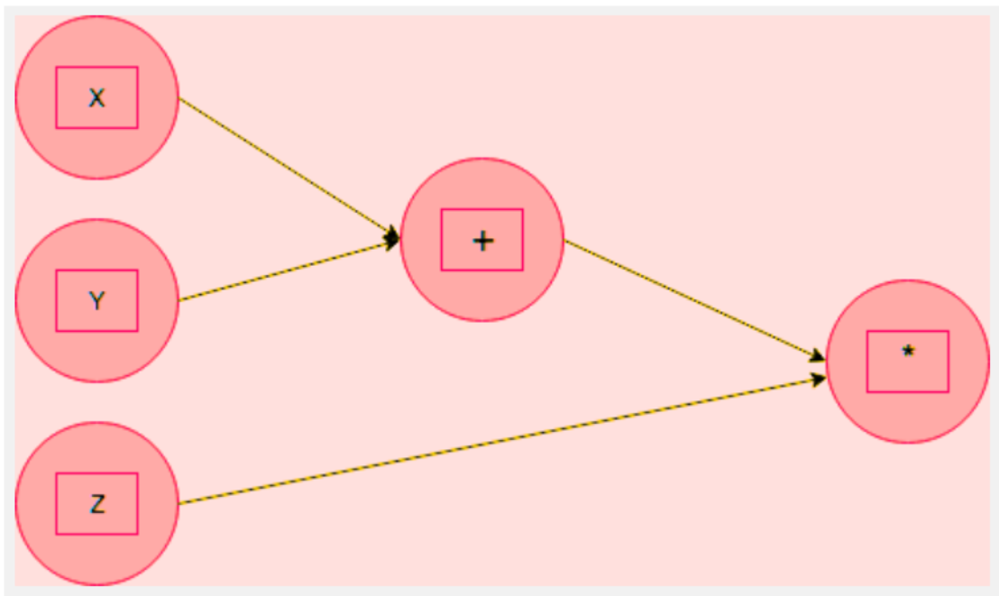


The flow of data starts with the input nodes \(x\), \(y\), and \(z\), and the result is passed through function nodes (addition and multiplication) to compute the final output.

#### Why Do We Need Computational Graphs?

When working with large deep learning models, the number of nodes and edges in a computational graph can grow exponentially. For instance, deep neural networks with millions of parameters can be represented by graphs containing millions of nodes and edges. A direct calculation of such a graph would be impractical. Computational graphs provide a structured way to break down complex functions into manageable parts and facilitate efficient computation, especially for operations like backpropagation.

#### Backpropagation and Computational Graphs

One of the key benefits of computational graphs is their ability to describe backpropagation. In deep learning, backpropagation is the method used to update the weights of the network during training. It relies on computing the gradients of the loss function with respect to the weights of the network, which can be efficiently done using the chain rule in calculus.

By representing the computations in a graph, each node’s contribution to the final output is clear, and gradients can be computed using the chain rule, moving backward through the graph.

#### Python Implementation with Dask

To implement computational graphs in Python, one popular library is **Dask**, which allows for parallel computing and handling of large datasets. Dask can be used to create and evaluate computational graphs efficiently.

```python
import dask.array as da
import numpy as np

# Create some Dask arrays (representing nodes in the graph)
x = da.from_array(np.array([1, 2, 3]), chunks=1)
y = da.from_array(np.array([4, 5, 6]), chunks=1)

# Define the graph of operations
z = (x + y) * 2

# Compute the result
z.compute()
```

**Conclusion**

> Computational graphs are foundational to deep learning. They offer an intuitive way to represent complex functions and enable efficient computation and backpropagation. Python, with libraries like Dask, provides a powerful way to implement these graphs for both small-scale and large-scale deep learning tasks.


In [ ]:
!pip install dask

In [ ]:
import dask.array as da
import numpy as np

# Create some Dask arrays (representing nodes in the graph)
x = da.from_array(np.array([1, 2, 3]), chunks=1)
y = da.from_array(np.array([4, 5, 6]), chunks=1)

# Define the graph of operations
z = (x + y) * 2

# Compute the result
z.compute()

array([10, 14, 18])

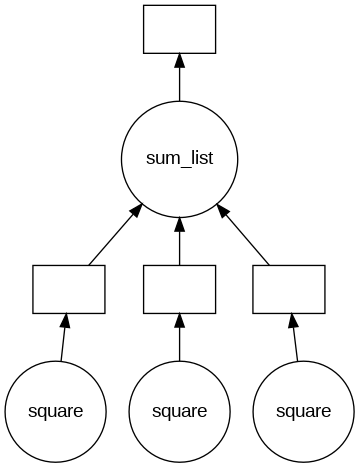

In [ ]:
from dask import delayed, compute
import dask

@delayed
def square(num):
    print(f"Square function called with: {num}")
    return num * num

@delayed
def sum_list(args):
    print(f"Sum_list function called with: {args}")
    return sum(args)

# List of items
items = [1, 2, 3]

# Building the computation graph
computation_graph = sum_list([square(i) for i in items])

# Visualizing the computation graph and saving it to a file
  # computation_graph.visualize(filename='dask_computation_graph.png')
computation_graph.visualize()




In [ ]:
# Execute the computation
result = computation_graph.compute()

# Print the result of the computation
print(f"Result: {result}")

Square function called with: 2
Square function called with: 3
Square function called with: 1
Sum_list function called with: [1, 4, 9]
Result: 14


#### 8.2.2.2 Dynamic Deep Learning Python Computational Graphs

In deep learning, **dynamic computational graphs** (DCGs) offer a more flexible and powerful way of handling data during training and inference compared to traditional static graphs. Static graphs are predefined and fixed, but dynamic graphs allow for the construction and modification of operations at runtime, offering greater flexibility when working with complex and varying data.

##### **Challenges with Static Computational Graphs**
Static graphs require that the structure of the model, including operations and layers, is predefined. This becomes problematic when the input data varies in size, shape, or type. For instance, in Natural Language Processing (NLP) tasks or when dealing with sequences of varying lengths, static graphs struggle to adapt. **Dynamic computational graphs** overcome these limitations by allowing operations to be defined on the fly during execution.

#### Dynamic Computational Graphs in Deep Learning
A **dynamic computational graph** allows operations to be added to the graph at runtime. This approach is useful for:
1. **Variable Input Shapes**: Data like images, text, or time-series data may have varying dimensions. Dynamic graphs can adapt to these changes.
2. **Variable Model Structure**: Dynamic graphs enable easy changes to the model architecture during training, such as adding/removing layers or switching activation functions.
3. **Flexible Operations**: With dynamic graphs, complex or custom operations can be dynamically inserted into the model, making the system more versatile.

##### **Key Concepts of Dynamic Computational Graphs**
1. **Mutable Graph**: A DCG can be changed during execution, allowing for operations to be added or removed as needed.
2. **Runtime Construction**: Operations are defined and computed as the program runs, which makes debugging easier and improves flexibility.
3. **Control Flow**: Dynamic graphs allow for control flow operations such as loops and conditional branches to be incorporated directly into the graph. This is essential for handling tasks like sequence generation or reinforcement learning.

#### Benefits of Dynamic Graphs
1. **More Intuitive Debugging**: Since the graph is built at runtime, errors can be traced and fixed immediately without waiting for the entire graph to be built and compiled beforehand.
2. **Ease of Experimentation**: Dynamic graphs make it easier to experiment with different network architectures and training strategies without having to redefine the entire computational graph every time.
3. **Better Memory Management**: As computations are defined and executed on the fly, memory usage can be optimized during the runtime process, which is particularly useful for large-scale models.


##### Example of Dynamic Computational Graph in Deep Learning (Python)
Python deep learning frameworks like **PyTorch** and **TensorFlow 2.0** are built to work with dynamic computational graphs. In PyTorch, this is referred to as **define-by-run**. Below is a basic example of dynamic graph usage in PyTorch:


In [ ]:
import torch
import torch.nn as nn

# Define a simple dynamic neural network
class DynamicNet(nn.Module):
    def __init__(self):
        super(DynamicNet, self).__init__()
        self.fc1 = nn.Linear(10, 20)
        self.fc2 = nn.Linear(20, 30)
        self.fc3 = nn.Linear(30, 1)

    def forward(self, x):
        x = torch.relu(self.fc1(x))
        x = torch.relu(self.fc2(x))
        x = self.fc3(x)  # Output layer
        return x

# Create a model instance
model = DynamicNet()

# Sample input (random tensor)
input_data = torch.randn(5, 10)  # 5 samples, each with 10 features

# Forward pass (dynamic graph)
output = model(input_data)
print(output)

tensor([[-0.3141],
        [-0.2077],
        [-0.3058],
        [-0.2423],
        [-0.2374]], grad_fn=<AddmmBackward0>)


In this example:

- The graph is constructed dynamically as the input flows through the layers of the network.
- Each call to `model(input_data)` triggers the construction of a new graph specific to the input.

##### **Forward and Backward Propagation in Dynamic Computational Graphs**

**Forward Propagation**: In DCGs, forward propagation involves computing the output by passing the input data through the nodes (layers). Since the graph is built dynamically, each layer’s output is computed in real-time based on the current input.

**Backward Propagation**: In backward propagation, gradients are calculated starting from the output node and flowing back towards the input nodes. Since the graph is dynamic, the backward pass is also computed in real-time, adjusting the model parameters based on the computed gradients.


### Conclusion

Dynamic Computational Graphs are a powerful concept in deep learning, offering flexibility for handling diverse data types and model architectures. Their ability to modify and optimize the graph during runtime allows for easier experimentation, better memory management, and more efficient debugging. Frameworks like PyTorch leverage this concept to make deep learning model development more intuitive and efficient.

Dynamic graphs are essential for tasks that require runtime flexibility, such as in NLP, Reinforcement Learning, and complex networks with variable input data. They are an important aspect of building modern deep learning systems.


In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim

# Simple model
class SimpleNN(nn.Module):
    def __init__(self):
        super(SimpleNN, self).__init__()
        self.fc1 = nn.Linear(5, 10)
        self.fc2 = nn.Linear(10, 1)

    def forward(self, x):
        x = torch.relu(self.fc1(x))
        x = self.fc2(x)
        return x

# Create model, loss function, and optimizer
model = SimpleNN()
loss_fn = nn.MSELoss()
optimizer = optim.SGD(model.parameters(), lr=0.01)

# Sample input and target
input_data = torch.randn(1, 5)
target = torch.randn(1, 1)

# Forward pass (Dynamic graph)
output = model(input_data)
loss = loss_fn(output, target)

# Backward pass
loss.backward()

# Update model parameters
optimizer.step()

# Print the loss and parameters
print(f"Loss: {loss.item()}")
print(f"Model parameters: {list(model.parameters())}")


Loss: 8.385626792907715
Model parameters: [Parameter containing:
tensor([[ 0.1876, -0.3631, -0.3608,  0.2603, -0.1266],
        [ 0.2349,  0.0924, -0.2603, -0.3918, -0.3538],
        [ 0.0870,  0.2544,  0.1471, -0.0971, -0.3887],
        [ 0.3286,  0.0400,  0.3969,  0.1859, -0.0560],
        [-0.3705, -0.0511,  0.2634,  0.0737,  0.2871],
        [-0.4104,  0.0423, -0.2206, -0.2005,  0.1454],
        [-0.4416,  0.0876,  0.2445, -0.0466, -0.1985],
        [ 0.1316,  0.1847,  0.1073,  0.0908, -0.1142],
        [-0.0603,  0.3215, -0.3193, -0.0961,  0.3136],
        [-0.4247, -0.1106, -0.1560,  0.1546,  0.2622]], requires_grad=True), Parameter containing:
tensor([-0.2097, -0.1446, -0.0541, -0.4285,  0.3048,  0.2141,  0.1232,  0.0104,
        -0.0757,  0.3837], requires_grad=True), Parameter containing:
tensor([[-0.3073,  0.0017, -0.1877,  0.1458,  0.2614,  0.1830,  0.2417,  0.2960,
          0.3040,  0.3287]], requires_grad=True), Parameter containing:
tensor([0.1632], requires_grad=True)]



#### 8.2.2.3 The Point of Deep Learning Frameworks

Deep learning frameworks like **TensorFlow**, **PyTorch**, and even **NumPy** (to an extent) work with computational graphs to facilitate automatic differentiation and optimization. The purpose of using computational graphs is to:

- **Efficiently manage complex operations**: Neural networks involve large numbers of operations on data (such as matrix multiplication, activation functions, etc.), and computational graphs help manage these operations in a way that can be optimized for performance.
  
- **Automatic Differentiation**: The ability to compute gradients automatically is a key feature of deep learning. By maintaining a computational graph, frameworks can keep track of the operations and compute derivatives during backpropagation without manual intervention.
  
- **Optimization**: Frameworks use computational graphs to optimize the execution order of operations, minimize redundant computations, and leverage hardware acceleration (e.g., using GPUs and TPUs) to speed up training.

- **Modularity and Flexibility**: Deep learning models are often composed of multiple layers and operations. Computational graphs allow developers to build, modify, and extend models in a modular way while ensuring that the underlying computations are correctly managed.



#### 8.2.2.4 Computational Graphs (NumPy vs TensorFlow vs PyTorch)

##### 1. **NumPy** (Traditional Computation with Arrays)
- **NumPy** does not inherently use computational graphs like TensorFlow or PyTorch. Instead, it provides a framework for performing numerical operations on **arrays** (n-dimensional tensors). Operations in NumPy are executed immediately (eager execution), meaning that calculations are carried out when the operation is called.
  
- **Manual Gradient Computation**: Since NumPy does not have an automatic differentiation feature, gradients must be manually computed, which can be cumbersome when dealing with complex neural networks. For deep learning tasks, developers often have to implement their own backpropagation methods or rely on additional libraries to compute gradients.
  
- **No Computational Graphs**: In NumPy, each operation is evaluated immediately, and no graph structure is built to optimize or manage dependencies. This makes it less suited for large-scale machine learning or deep learning models where backpropagation and gradient descent are essential.

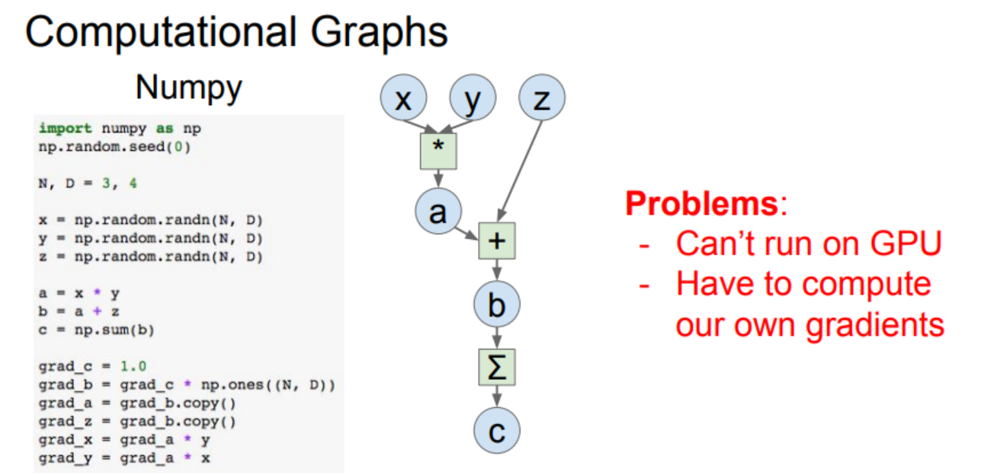

##### 2. **TensorFlow** (Static Computational Graphs)
- **TensorFlow** primarily uses a **static computational graph**. In this model, the computational graph is defined first (as a graph of operations), and then the framework performs the computation in a separate session. This is known as **graph-based execution**.

- **Graph Definition and Execution**: In TensorFlow 1.x, you would first define the operations and build the graph (e.g., matrix multiplications, activation functions) and then feed data into the graph during a session. In TensorFlow 2.x, however, eager execution is enabled by default, but you can still define and execute a graph using **`tf.function`** to optimize performance.

- **Automatic Differentiation**: TensorFlow builds a computational graph in the background, tracking all operations on tensors. When it’s time to compute gradients for backpropagation, TensorFlow traverses the graph and computes the derivatives automatically.

- **Optimizations**: TensorFlow leverages the computational graph to optimize operations, fuse computation steps, and deploy on specialized hardware like GPUs and TPUs. The graph structure enables optimizations like operation reordering, memory management, and parallelization of tasks.

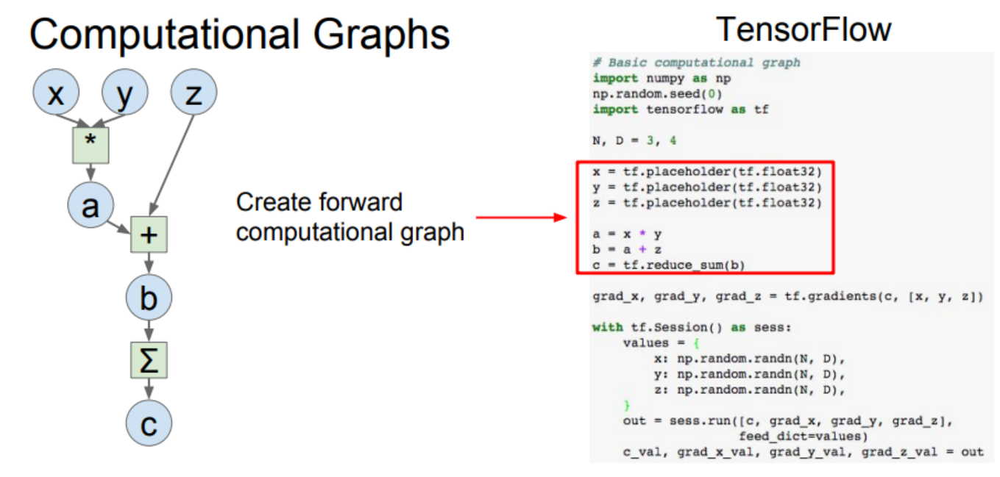

##### 3. **PyTorch** (Dynamic Computational Graphs)
- **PyTorch** uses a **dynamic computational graph**, often referred to as **define-by-run**. In PyTorch, the computational graph is built dynamically as operations are executed, meaning the graph is created on the fly as the data flows through the network.

- **Dynamic Graph Building**: This dynamic nature allows more flexibility compared to static graphs, as the graph is created during each forward pass. This is particularly useful for models with variable-length input data or architectures that change during training.

- **Eager Execution by Default**: Unlike TensorFlow (before v2.x), PyTorch executes operations immediately (eager execution), and the graph is constructed as operations are run. This is beneficial for debugging since the developer can easily inspect intermediate results during execution.

- **Automatic Differentiation**: PyTorch's **Autograd** module automatically tracks operations on tensors and constructs the computational graph for differentiation. The framework then computes gradients during backpropagation without needing to manually specify the derivatives.

- **Optimizations**: Since PyTorch constructs the computational graph dynamically, the optimization process occurs during runtime. PyTorch also supports optimization techniques for GPU usage, making it efficient for large-scale deep learning applications.

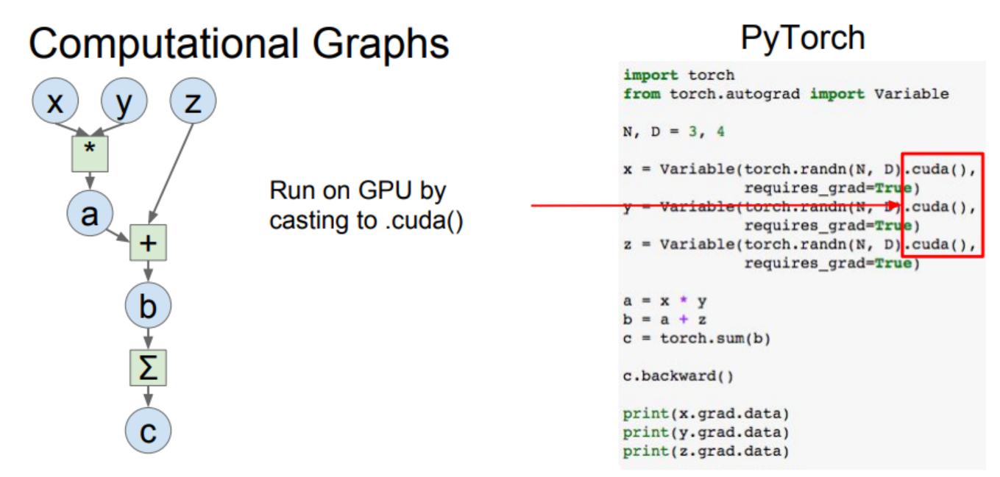

##### Key Differences:

| Feature               | **NumPy**              | **TensorFlow**                | **PyTorch**                   |
|-----------------------|------------------------|-------------------------------|-------------------------------|
| **Graph Type**        | No computational graph | Static (TensorFlow 1.x)        | Dynamic (Define-by-run)        |
| **Eager Execution**   | Yes                    | Yes (TensorFlow 2.x)          | Yes                           |
| **Automatic Differentiation** | No                | Yes                           | Yes                           |
| **Optimization**      | Manual                 | Optimized via graph execution | Optimized during runtime       |
| **Suitability for Deep Learning** | Not ideal       | Suitable (but less flexible)  | Ideal for research and dynamic models |
| **Hardware Acceleration** | Limited             | Supports GPUs, TPUs           | Supports GPUs                  |

### Conclusion

- **NumPy** is mainly used for numerical computing but does not offer built-in support for deep learning tasks, automatic differentiation, or optimized graph execution.
  
- **TensorFlow** employs a static computational graph, which is optimized for performance in production environments but less flexible for debugging or dynamic models. TensorFlow 2.x introduced eager execution, which bridges the gap between static and dynamic graphs.
  
- **PyTorch** provides a dynamic computational graph, making it more flexible and user-friendly, especially for research and rapid prototyping. It excels in applications that require dynamic model structures or variable-length input data, such as in natural language processing and real-time tasks like autonomous driving.

In summary, while **NumPy** is suitable for basic numerical tasks, **TensorFlow** and **PyTorch** are the better options for deep learning tasks, with **TensorFlow** being more optimized for production environments and **PyTorch** offering greater flexibility for research and development.


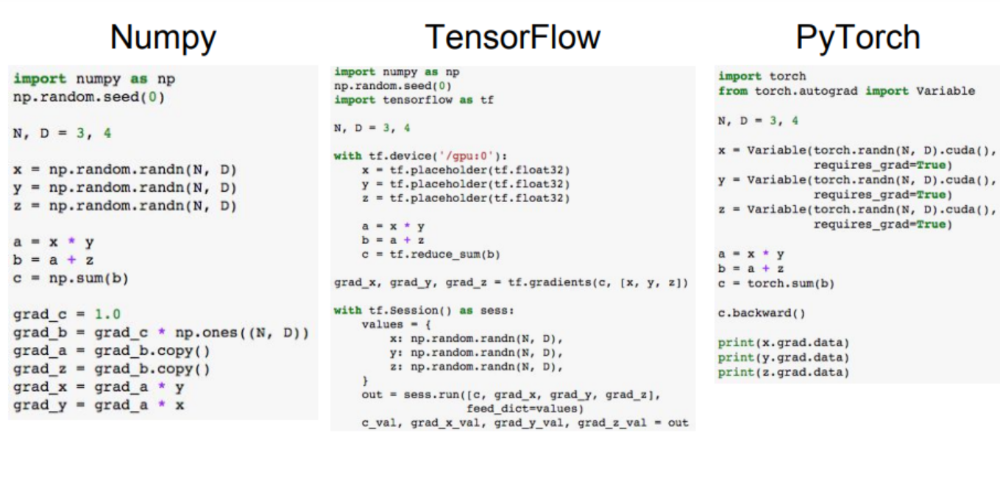

| Feature                       | **NumPy**                         | **TensorFlow**                   | **PyTorch**                      |
|-------------------------------|-----------------------------------|----------------------------------|----------------------------------|
| **Graph Type**                | No computational graph           | Static graph (TensorFlow 1.x)    | Dynamic graph (define-by-run)    |
| **Eager Execution**           | Yes                               | Yes (TensorFlow 2.x)             | Yes                              |
| **Automatic Differentiation** | No                                | Yes                              | Yes                              |
| **Optimization**              | Manual                            | Optimized via graph execution    | Optimized during runtime         |
| **Suitability for Deep Learning** | Not suitable                    | Suitable for production, less flexible | Ideal for research, flexible for experimentation |
| **Hardware Acceleration**     | Limited (CPU only)                | Supports GPUs and TPUs           | Supports GPUs                    |
| **CPU/GPU Weight Copying**    | No support for GPU operations     | TensorFlow 1.x: Can be inefficient at copying weights; TensorFlow 2.x improved this | PyTorch: Efficient GPU/CPU transitions, better handling of weight copying |
| **Loss Not Going Down**       | Not applicable to deep learning   | Can be caused by improper graph execution or optimizer settings; easier to debug with `tf.function` | Often due to improper model design or learning rate settings; dynamic graphs make debugging easier |
| **Model Debugging**           | Simple but manual debugging      | Harder to debug due to static graph; easier with eager execution in TF 2.x | Easier due to dynamic graph and eager execution |
| **Training Speed**            | Slow, no GPU support              | Fast with optimized graph execution on GPUs/TPUs | Fast with GPU support, optimized runtime |
| **Memory Management**         | Manual management                 | Automatic memory management with graph optimization | Automatic memory management, dynamic adjustments |
| **Parallelization**           | Manual parallelization            | Built-in parallelism for GPUs/TPUs | Built-in support for multi-GPU parallelism |

##### 8.2.2.4.1 Key Concepts in PyTorch

###### 1. PyTorch Tensors
PyTorch Tensors are the core building blocks for numerical computations in PyTorch. They are similar to NumPy arrays but with the added advantage of GPU acceleration and support for automatic differentiation. Key features include:
- **GPU Acceleration**: Tensors can be moved between CPU and GPU using `.cuda()` or `.to(device)`, enabling fast computation on GPUs.
- **Enhanced Operations**: Tensors support a variety of in-place operations, broadcasting, and complex mathematical functions, offering flexibility for different types of computations.
- **Custom Backends**: PyTorch now supports integration with custom tensor backends, which can be used to implement specialized hardware accelerators beyond GPUs.

###### 2. Variable and Tensor Merge
In earlier versions of PyTorch, `Variable` and `Tensor` were distinct, with `Variable` being used for tracking gradients. Starting from version 0.4, these two were merged into a single class:
- Now, a **Tensor** can track gradients when `requires_grad=True`, eliminating the need for a separate `Variable` class.

###### 3. Autograd: Automatic Differentiation
PyTorch's automatic differentiation system, **autograd**, is integral to training neural networks. Enhancements include:
- **Custom Gradient Functions**: Users can now define custom gradient operations using `torch.autograd.Function` for more control over the backward pass.
- **Mixed Precision Training**: PyTorch supports **automatic mixed precision (AMP)**, using lower-precision floating-point formats to speed up training while maintaining accuracy.

###### 4. `nn.Module`: Building Neural Networks
The `nn.Module` class provides a high-level API for defining neural networks, with significant improvements:
- **Expanded Layers and Architectures**: PyTorch now includes support for advanced layers like **Transformers**, **LSTMs**, **GRUs**, and more, facilitating the development of complex models.
- **Parameter Management**: `nn.Module` automatically tracks model parameters (weights, biases) and supports utilities for saving/loading models efficiently.
- **TorchScript**: PyTorch models can be serialized using **TorchScript**, enabling deployment in non-Python environments such as C++.

###### 5. Optimizers and `torch.optim`
PyTorch’s optimizer package has been improved, offering more features and better efficiency:
- **Advanced Optimizers**: Optimizers like Adam, SGD, and RMSprop now support features like learning rate scheduling, weight decay, and more.
- **Fused Optimizers**: For large models (e.g., transformers), PyTorch includes fused optimizers that combine multiple operations for better computational efficiency.

###### 6. DataLoaders and Datasets
The `DataLoader` and `Dataset` classes have become more flexible and efficient:
- **Multi-Process Data Loading**: PyTorch allows data loading with multiple processes, improving performance on multi-core CPUs.
- **Custom Datasets**: Writing custom `Dataset` classes for specific tasks like image, text, or audio processing is now more streamlined and efficient.
- **Data Augmentation**: PyTorch provides built-in tools for data augmentation, especially through the **torchvision** library, enhancing model generalization.

###### 7. Pretrained Models
Pretrained models are now even more accessible through libraries like `torchvision` and are widely used for transfer learning. These models serve as excellent starting points and can be easily fine-tuned for specific tasks.

###### 8. PyTorch for Mobile and Deployment
PyTorch has made significant advancements in model deployment:
- **PyTorch Mobile**: PyTorch now supports optimized implementations for deploying models on mobile devices (Android and iOS), enabling on-device inference.
- **ONNX Support**: PyTorch can export models to the **ONNX (Open Neural Network Exchange)** format, facilitating interoperability between different frameworks (e.g., TensorFlow, Caffe2).
- **JIT Compilation**: PyTorch’s **Just-In-Time (JIT) compilation** optimizes models for deployment, enabling high-performance inference even in non-Python environments like C++.

###### 9. PyTorch vs. TensorFlow
PyTorch has gained significant traction due to its intuitive design and dynamic computation graph, offering advantages over other frameworks like TensorFlow:
- **Debugging**: PyTorch’s integration with Python’s debugger makes it easier to inspect and modify models during development.
- **Dynamic Computation Graph**: PyTorch’s dynamic graph is more flexible compared to TensorFlow’s static graph (prior to TensorFlow 2.0).
- **Community Adoption**: PyTorch has seen rapid adoption, especially in academia, with more research papers and contributions.

###### 10. Visualization Tools
While **Visdom** was initially introduced for visualizing PyTorch models, other tools like **TensorBoard** and **Weights & Biases** are now more commonly used for tracking training performance and visualizations.


##### 8.2.2.4.2 Static Graphs VS Dynamic Graphs

##### **1. TensorFlow: Static Graphs vs PyTorch: Dynamic Graphs**

- **TensorFlow (Static Graphs)**: In TensorFlow, you define the computational graph **once**, and then execute it multiple times. This static nature allows TensorFlow to optimize the graph ahead of time before execution, making it more efficient. The graph is built outside the code and runs after being compiled. This is often referred to as a "static graph" because it doesn’t change during execution.

- **PyTorch (Dynamic Graphs)**: In contrast, PyTorch builds the computation graph dynamically. Every time you run a forward pass, a new computational graph is created, allowing for more flexibility. This is called "define-by-run" as the graph is built as operations are performed. It enables easier debugging and modification of the graph since it behaves like normal Python code.



##### **2. Static vs Dynamic: Optimization**

- **Static Graph Optimization**:
   In static graphs, since the framework knows the entire computation graph ahead of time, it can perform optimizations **before execution**. For instance:
   - **Fusion of operations**: If you have repeated operations, like a sequence of `Conv` followed by `ReLU`, a static graph framework can optimize this by fusing operations together, reducing overhead.
   - Example:
     - **Before Optimization**:
       ```
       Conv -> ReLU -> Conv -> ReLU -> Conv -> ReLU
       ```
     - **After Optimization**:
       ```
       Conv+ReLU -> Conv+ReLU -> Conv+ReLU (fused operations)
       ```
   - This fusion reduces the computational load and memory usage by simplifying the execution.

- **Dynamic Graph Optimization**: Since the graph in PyTorch is built at runtime, optimizations cannot be performed ahead of time in the same way as static graphs. However, this dynamic nature offers flexibility, allowing the graph to adapt to changes during execution.


##### **3. Static vs Dynamic: Serialization**

- **Static Graph Serialization**:
   Once the static graph is built in TensorFlow, you can **serialize** it and execute it without needing the original Python code that created the graph. This is useful for deploying models in production or on devices where Python might not be available.
   
- **Dynamic Graph Serialization**:
   In PyTorch, because the graph is intertwined with the Python code (dynamic), you always need the code that builds the graph in order to execute it. This makes PyTorch models harder to serialize and deploy in non-Python environments, though there are tools like **TorchScript** to overcome this challenge.


##### **4. Static vs Dynamic: Conditional Operations**

- **TensorFlow (Static)**: TensorFlow requires the use of **special operators** (e.g., `tf.cond`) for conditional operations. Since the graph is static, it must define all possible operations, including conditionals, ahead of time. This can make conditionally executed parts of the graph more complex to manage.
  
- **PyTorch (Dynamic)**: PyTorch allows **normal Python control flow**, such as `if` and `else`, within the computation graph. The graph is built dynamically, so the conditional logic is executed naturally as part of the Python code. This makes it more intuitive and easier to debug.

Example:
```python
if z > 0:
    y = w1 * x
else:
    y = w2 * x
```

**Conditional Operations**
This would run seamlessly in **PyTorch**, whereas in **TensorFlow**, you would have to use TensorFlow-specific control flow mechanisms like `tf.cond`.


##### **5. Static vs Dynamic: Loops**

- **TensorFlow (Static)**: In TensorFlow, loops and recurrence are handled using special control flow operators, such as `tf.while_loop`. This is because the graph is defined statically, and the loop must be accounted for ahead of time in the graph definition.

- **PyTorch (Dynamic)**: In PyTorch, loops can be implemented with regular Python loops, making them more intuitive and easier to debug. For instance, a simple loop in PyTorch would look like:
  ```python
  for t in range(1, T):
      y[t] = (y[t-1] + x[t]) * w
```
This allows for greater flexibility and makes PyTorch code more "Pythonic."


##### **6. Dynamic Graphs in TensorFlow**

While TensorFlow primarily used static graphs, **TensorFlow Fold** (a library introduced in 2017) made dynamic graphs easier in TensorFlow. This library, for example, supports **dynamic batching**, allowing TensorFlow to adapt more easily to inputs of varying sizes and shapes. This was a significant step toward incorporating more dynamic behavior in TensorFlow, albeit still within the framework's primarily static paradigm.


### Summary Comparison

| **Feature**           | **TensorFlow (Static Graphs)**                 | **PyTorch (Dynamic Graphs)**            |
|-----------------------|-----------------------------------------------|-----------------------------------------|
| **Graph Building**     | Build graph once, then execute multiple times | Build graph dynamically during execution |
| **Optimization**       | Can optimize graph before execution           | Optimizations happen during execution   |
| **Serialization**      | Can serialize and execute without the code    | Code must always be available for execution |
| **Conditionals**       | Requires special control flow operators       | Uses standard Python control flow       |
| **Loops**              | Requires special control flow operators       | Uses standard Python loops              |
| **Flexibility**        | Less flexible, but optimized for performance  | More flexible, easier to debug          |


##### 8.2.2.4.3 Serialization vs Parallelization

**Serialization** and **Parallelization** are two fundamental concepts in machine learning frameworks, often influencing how models are deployed and how computations are handled during training.

---

**Serialization** refers to the process of saving a model or computation graph for later use, typically for inference. This allows the trained model to be stored and reused without needing the original code that built the graph. Serialization is useful for model deployment, where the model can be loaded and executed without needing to rebuild the entire computation graph each time.

- **TensorFlow** can serialize the entire static computation graph, making it possible to save the model and later load it for inference.
- **PyTorch**, which uses dynamic computation graphs, typically requires the code to be kept alongside the model for execution, though it also provides **TorchScript** to serialize models for later use.

---

**Parallelization** involves dividing a task into smaller sub-tasks and executing them simultaneously across multiple processors or devices. This is particularly useful in training deep learning models, where computations can be very intensive. By using parallelization, frameworks can leverage multiple GPUs or even distributed machines to speed up the computation.

- **TensorFlow** supports parallelization across multiple GPUs or machines, which can be managed manually or automatically by the framework.
- **PyTorch** also supports parallelization, particularly through **DataParallel** and **DistributedDataParallel**, which enable training on multiple GPUs.

---

### Key Differences

| **Aspect**            | **Serialization**                             | **Parallelization**                             |
|-----------------------|-----------------------------------------------|------------------------------------------------|
| **Definition**         | Saving a model or graph for future use        | Splitting a task to run simultaneously on multiple devices |
| **Purpose**            | For model deployment and inference            | To speed up training or processing by using multiple devices |
| **Framework**          | TensorFlow (static graphs), PyTorch (TorchScript) | TensorFlow (multi-GPU support), PyTorch (DataParallel) |
| **Usage**              | Model saving/loading without code             | Model training or inference across multiple GPUs or machines |
| **Example Use Case**   | Saving a trained model for inference          | Training a model faster by distributing computation across GPUs |

---

**Conclusion**:  
- **Serialization** is focused on saving and restoring models or computations for later use.  
- **Parallelization** is focused on optimizing performance by executing tasks concurrently, especially during training.  

Both concepts play crucial roles in machine learning, contributing to **efficient deployment** (serialization) and **performance optimization** (parallelization).


In [ ]:
"""
TensorFlow (Static Graphs):
Save and load a trained model graph without needing the original Python code.
"""
# TensorFlow example
import tensorflow as tf

# Save model
model.save("saved_model")

# Load model for inference
loaded_model = tf.saved_model.load("saved_model")


"""
PyTorch (Dynamic Graphs):
Using TorchScript to serialize the model.
"""

import torch
import torch.nn as nn

class SimpleModel(nn.Module):
    def forward(self, x):
        return x * 2

# Create a model
model = SimpleModel()

# Convert model to TorchScript for serialization
scripted_model = torch.jit.script(model)

# Save the scripted model
scripted_model.save("simple_model.pt")

# Load the model
loaded_model = torch.jit.load("simple_model.pt")


In [ ]:
"""
TensorFlow (Static Graphs):
Distribute the workload across multiple GPUs.
"""
# TensorFlow example for multiple GPUs
strategy = tf.distribute.MirroredStrategy()

with strategy.scope():
    model = tf.keras.models.Sequential([
        tf.keras.layers.Dense(64, activation='relu', input_shape=(32,)),
        tf.keras.layers.Dense(10)
    ])
    model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])


"""
PyTorch (Dynamic Graphs):
Using DataParallel to use multiple GPUs.
"""
import torch
import torch.nn as nn

# Simple model
class SimpleModel(nn.Module):
    def forward(self, x):
        return x * 2

# Instantiate the model
model = SimpleModel()

# Check if multiple GPUs are available and parallelize the model
if torch.cuda.device_count() > 1:
    model = nn.DataParallel(model)

model = model.cuda()


# **9.CNN Architectures**
---



## **9.1 Overview of Popular CNN Architectures**

### Key Highlights:
1. **LeNet**:
   - Early CNN architecture.
   - Utilizes simple convolutional and pooling layers.
   - Designed for digit recognition tasks.

2. **AlexNet**:
   - Popularized deep learning.
   - Introduced ReLU activation and dropout layers.
   - Effective for large-scale image classification.

3. **VGG**:
   - Employs small filters (3x3) with deep architectures.
   - Known for uniform design and simplicity.

4. **ResNet**:
   - Introduced residual connections to combat vanishing gradients.
   - Supports very deep networks (e.g., ResNet-50, ResNet-101).

5. **Inception**:
   - Combines filters of multiple sizes in parallel.
   - Emphasizes efficient computation using bottleneck layers.

   ![](https://miro.medium.com/v2/resize:fit:828/format:webp/0*vb72NzJrSMxQZ7j9)


### **9.1.1 Early Beginnings of Convolutional Neural Networks**

### **9.1.1.1 Neocognitron (1980)**
- Proposed by Kunihiko Fukushima as an early model of a hierarchical neural network.
- Inspired by the visual cortex structure, it introduced concepts of feature extraction and hierarchical pattern recognition.
- Marked the beginning of convolution-like operations for image processing.

### **9.1.1.2 LeNet-5 (1998)**
- Developed by Yann LeCun for digit recognition (e.g., MNIST dataset).
- First practical CNN architecture:
  - **Components**: Convolutional layers, pooling layers, and fully connected layers.
  - Efficient for small-scale tasks like digit and character recognition.
- Established the foundational structure of modern CNNs.




### **9.1.2 CNNs in the Deep Learning Era**

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/0*LeK_gmCf3DfO3gj_.jpeg)

### **9.1.2.1 AlexNet (2012)**
- Introduced by Alex Krizhevsky, Ilya Sutskever, and Geoffrey Hinton.
- Won the ImageNet Large Scale Visual Recognition Challenge (ILSVRC) in 2012, significantly outperforming traditional machine learning methods.
- Innovations:
  - ReLU activation for non-linearity.
  - Dropout for regularization.
  - GPU acceleration for training.
- Marked the resurgence of deep learning in computer vision.

### **9.1.2.2 ZFNet (2013)**
- Refinement of AlexNet, proposed by Zeiler and Fergus.
- Improved performance by visualizing learned features and tuning hyperparameters.
- Showcased the importance of understanding feature maps and receptive fields.

### **9.1.2.3 VGG (2014)**
- Developed by the Visual Geometry Group at Oxford.
- Key Features:
  - Uniform architecture with small filters (3x3).
  - Deep structures (16 or 19 layers).
- Advantage: Simplicity and depth, leading to enhanced feature representation.




### **9.1.3 Innovations in Model Efficiency and Depth**

### **9.1.3.1 GoogleNet/Inception (2014)**
- Introduced by Google with the Inception module.
- Efficient design:
  - Parallel convolution layers of varying sizes (e.g., 1x1, 3x3, 5x5).
  - Bottleneck layers for reducing computational cost.
- Achieved state-of-the-art performance with fewer parameters.

### **9.1.3.2 ResNet (2015)**
- Developed by Microsoft Research.
- Introduced residual connections to address the vanishing gradient problem.
- Enabled training of extremely deep networks (e.g., ResNet-50, ResNet-101).
- Revolutionized deep learning by demonstrating the benefits of very deep architectures.

### **9.1.3.3 DenseNet (2016)**
- Proposes dense connectivity:
  - Each layer receives inputs from all preceding layers.
  - Improves feature reuse and gradient flow.
- Achieves efficient parameter utilization.




### **9.1.4 Advances in Specialized Applications**

### **9.1.4.1 Computer Vision Tasks**
- **Object Detection**: Faster R-CNN, YOLO, and SSD leverage CNNs for real-time object localization and detection.
- There are **multiple versions of YOLO** (YOLOv1, v2, v3, and the latest being YOLOv4 and YOLOv5).
- **Image Segmentation**: U-Net and Mask R-CNN enable pixel-level segmentation for applications like medical imaging.
- **Style Transfer**: Neural Style Transfer techniques use CNNs to recreate artistic effects in images.

### **9.1.4.2 Generative Models**
- **Generative Adversarial Networks (GANs)**:
  - Introduced by Ian Goodfellow in 2014.
  - Combine a generator (often based on CNNs) and a discriminator to create realistic images and videos.
- **Autoencoders**:
  - Use CNNs to encode and decode images, enabling tasks like image reconstruction and denoising.




### **9.1.5 Recent Developments and Future Directions**

### **9.1.5.1 Vision Transformers (ViTs)**
- Emerging architectures are integrating CNN features with transformers for broader context awareness.

### **9.1.5.2 Generative Videos**
- CNNs, combined with GANs and RNNs, are increasingly used to generate realistic videos.
- Applications:
  - Deepfake generation.
  - Video frame prediction and interpolation.
  - Autonomous vehicle simulation environments.

### **9.1.5.3 Real-Time and Edge Applications**
- MobileNet and EfficientNet optimize CNNs for mobile and embedded systems.
- Focus on lightweight architectures for real-time processing.

### **9.1.5.4 AI-Driven Creativity**
- Tools like DALL-E and other generative AI systems expand the scope of CNNs to artistic video generation and virtual reality content creation.


### **9.1.6 Conclusion**
The evolution of CNNs from simple pattern recognition models to foundational tools in modern AI highlights their transformative impact. CNNs now power diverse applications, from computer vision to generative media, shaping the future of artificial intelligence.


| **Model**       | **Number of Layers** | **Number of Parameters** | **Model Size**    | **Efficiency**        | **Accuracy (Top-5)** | **Number of Filters** | **Types of Layers**                              | **Key Features**                                                                                  |
|-----------------|----------------------|--------------------------|-------------------|-----------------------|----------------------|-----------------------|--------------------------------------------------|---------------------------------------------------------------------------------------------------|
| **LeNet-5 (1998)** | 7                    | ~60k                     | Small             | Low                   | ~98.4% (MNIST)       | 6-10                  | Convolutional, Pooling, Fully Connected           | One of the earliest CNNs, designed for digit classification on small datasets like MNIST.          |
| **AlexNet (2012)** | 8                    | ~60 million               | Large             | Moderate              | 84.6% (ImageNet)     | 96-256                | Convolutional, Max-Pooling, Fully Connected, ReLU | First deep CNN that won ImageNet competition, introduced ReLU activation and GPU training.          |
| **ZFNet (2013)**  | 8                    | ~60 million               | Large             | Moderate              | 88.2% (ImageNet)     | 96-256                | Convolutional, Max-Pooling, Fully Connected       | Improvement on AlexNet with better visualization and optimization of features.                     |
| **VGG (2014)**    | 16-19                | ~138 million              | Very Large        | Low                   | 92.7% (ImageNet)     | 64-512                | Convolutional, Max-Pooling, Fully Connected       | Known for its deep architecture and use of small 3x3 filters, but with high computational cost.    |
| **GoogleNet (Inception) (2014)** | 22                   | ~6.8 million              | Moderate          | High                  | 93.3% (ImageNet)     | 32-256                | Convolutional, Inception modules, Pooling         | Introduced the inception module, using multiple filter sizes in parallel, and bottleneck layers.    |
| **ResNet (2015)** | 50-152               | ~25-60 million            | Moderate          | High                  | 96.4% (ImageNet)     | 64-2048               | Convolutional, Residual connections, Fully Connected | Introduced residual connections to train very deep networks without vanishing gradients.            |
| **DenseNet (2016)** | 121-201              | ~8-25 million             | Moderate to Large | High                  | 96.4% (ImageNet)     | 32-256                | Convolutional, Dense connections, Pooling         | Dense connections where each layer receives input from all previous layers, improving feature reuse.|
| **MobileNet (2017)** | 28                   | ~4-6 million              | Small             | Very High             | ~70% (ImageNet)      | 32-1024               | Depthwise Separable Convolutions, Convolutional     | Efficient architecture designed for mobile and edge devices, optimized for performance and size.    |
| **EfficientNet (2019)** | 8-8                | ~5.3 million              | Small to Moderate | Very High             | 97.0% (ImageNet)     | 32-1024               | Convolutional, Depthwise Separable Convolutions    | Optimizes model size, depth, and resolution using a compound scaling method.                       |
| **Vision Transformer (ViT) (2020)** | 12-24               | ~87 million               | Moderate to Large | Moderate              | 88.55% (ImageNet)    | N/A                   | Transformer, Self-Attention                        | Uses transformers for vision tasks, focusing on global context and long-range dependencies.         |
| **EfficientDet (2020)** | 8                    | ~3-6 million              | Small to Moderate | Very High             | 44.5% (COCO)         | 32-128                | Convolutional, Depthwise Separable, Fully Connected | Focused on object detection, with high efficiency and accuracy on mobile devices.                    |
| **YOLOv4 (2020)**  | 106                  | ~64 million               | Moderate          | High                  | 43.5% (COCO)         | 128-1024              | Convolutional, Fully Connected, Detection layers    | Focused on real-time object detection with excellent speed and accuracy balance.                    |


## 9.2 Filters in CNN Architectures

### Kernel or Filter or Feature Detectors

In a convolutional neural network (CNN), the **kernel** (also known as a **filter** or **feature detector**) is used to extract features from images. The kernel is a small matrix or filter that slides over the input image to detect specific features such as edges, corners, and textures.

**Formula for Output Size (after Convolution)**:  
**Output size = [i - k] + 1**  
Where:
- **i** = Size of the input (image).
- **k** = Size of the kernel (filter).

This formula tells you the size of the output after applying the kernel to the image. The kernel is typically smaller than the input image and moves across it, performing element-wise multiplication and summing up the results at each location.

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/0*n7GQU2sA0Y8P72Yf.png)

### Stride

**Stride** is a parameter that determines how much the filter or kernel moves across the image during the convolution operation. If the stride is set to 1, the kernel moves one pixel at a time. If the stride is set to 2, the kernel will skip over 2 pixels.

**Formula for Output Size (after applying Stride)**:  
**Output size = [(i - k) / s] + 1**  
Where:
- **i** = Size of the input (image).
- **k** = Size of the kernel.
- **s** = Stride (the step size at which the kernel moves).

For example:
- If the input size is 7x7, the kernel is 3x3, and the stride is 2:
  - **Output size = [(7 - 3) / 2] + 1 = [4 / 2] + 1 = 2 + 1 = 3**
  - So, the output size would be 3x3.

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*E52voKt51l-PRD-fKtWMSg.png)

### Padding

**Padding** refers to adding extra pixels around the edges of the image to preserve the image size after applying convolution. Padding helps avoid shrinking the image during multiple convolution operations. If padding is set to zero, the image shrinks with each convolution step. By adding padding, the original size of the image can be maintained, which is crucial for extracting low-level features without losing information at the borders.

**Formula for Output Size (after applying Padding and Stride)**:  
**Output size = [(i - k + 2p) / s] + 1**  
Where:
- **i** = Size of the input (image).
- **k** = Size of the kernel.
- **p** = Padding (the number of extra pixels added around the image).
- **s** = Stride.

Example:
- If the input size is 7x7, kernel is 3x3, padding is 1, and stride is 1:
  - **Output size = [(7 - 3 + 2(1)) / 1] + 1 = [7] + 1 = 8**
  - The output size would be 8x8 with padding of 1.

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/0*voP_09Y6cK97GsHq.png)

### Pooling

**Pooling** is a technique in CNNs to downsample feature maps and reduce their spatial dimensions (height and width), while retaining the essential features. Pooling helps in making the model more invariant to small translations and reduces the computational load. The most common types of pooling are **Max Pooling** and **Average Pooling**.

In **Max Pooling**, the maximum value from each patch of the feature map is selected, while in **Average Pooling**, the average value of each patch is selected. Pooling reduces the spatial size and hence the number of parameters, which helps prevent overfitting.

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*GTCHpY_vpITjdwx5Vt33HQ.png)

### Flatten

**Flattening** is the process of converting a 2-dimensional matrix (resulting from convolution and pooling layers) into a 1-dimensional vector. This operation is necessary to connect the convolutional layers with the fully connected layers for classification tasks. Flattening converts the extracted features into a single long vector that is fed into the fully connected layers for the final prediction or classification.

For example, if the feature map size after convolution and pooling is 4x4x64, flattening converts it into a vector of size **4 * 4 * 64 = 1024**.

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*xz9SQ3YzE2LRaR-_qfbZ6w.png)

### Q1: What is the total number of parameters in this layer?

To calculate the **total number of parameters** in a convolutional layer, the formula is:

**Number of parameters = (K × K × C + 1) × F**

Where:
- **K** is the kernel size (height and width).
- **C** is the number of input channels (e.g., 3 for RGB images).
- **F** is the number of filters (kernels) in the layer.
- **+1** accounts for the bias term associated with each filter.

Example:
If a convolutional layer has:
- Kernel size: 3x3
- Input channels (C): 3 (RGB image)
- Number of filters (F): 64

The calculation would be:

**Number of parameters = (3 × 3 × 3 + 1) × 64 = (27 + 1) × 64 = 28 × 64 = 1792**

So, the total number of parameters in this layer would be **1792**.


![](https://miro.medium.com/v2/resize:fit:1100/format:webp/0*n7GQU2sA0Y8P72Yf.png)

### Q2: What is the output volume size?

The **output volume size** (height, width, and depth) of a convolutional layer can be computed using the following formula:

**Output height = (Input height - K + 2P) / S + 1**  
**Output width = (Input width - K + 2P) / S + 1**  
**Output depth = F**

Where:
- **K** is the kernel size.
- **P** is the padding applied (if any).
- **S** is the stride (how much the filter moves at each step).
- **F** is the number of filters.

Example:
If:
- Input size is 32x32 (height and width).
- Kernel size is 3x3.
- Padding (P) is 1 (same padding).
- Stride (S) is 1.
- Number of filters (F) is 64.

The calculation would be:

**Output height = (32 - 3 + 2(1)) / 1 + 1 = 32**  
**Output width = (32 - 3 + 2(1)) / 1 + 1 = 32**  
**Output depth = 64**

Thus, the output volume size would be **32x32x64**.

### Q3: What is the number of parameters in this layer?

This question is similar to Q1, but it's asking for the number of parameters in a different context or layer. The formula remains the same as in Q1, where we calculate based on kernel size, input channels, and the number of filters used.

Example:
Let’s say a convolutional layer has:
- Kernel size: 5x5
- Input channels: 64
- Filters: 128

The number of parameters would be:

**Number of parameters = (5 × 5 × 64 + 1) × 128 = (1600 + 1) × 128 = 1601 × 128 = 205,888**

So, the total number of parameters in this layer would be **205,888**.



> Why the Input Size Doesn't Affect the Number of Parameters in a Convolutional Layer
 - The total number of parameters in a convolutional layer is determined by:
 - **Kernel size (K)**: Dimensions of the filter.
 - **Input channels (C)**: Number of input channels (e.g., 3 for RGB images).
 - **Number of filters (F)**: The number of kernels.

> **Formula:**
  - **Number of parameters = (K × K × C + 1) × F**
  - **K × K × C**: Weights for each filter across all input channels.
  - **+1**: Bias term for each filter.
  - **F**: Number of filters (kernels).

> Why the Input Size Doesn't Affect Parameters:
 - **Input size (height/width)** does not change the number of parameters because it doesn’t affect the kernel/filter size or the number of filters.
 - It affects the **output volume** (feature map size) and memory/computation cost, but not the number of parameters.

> When Input Size Matters:
 - Input size influences the **size of the output volume** and the computational cost.
 - Larger input images require more memory and processing power due to larger output feature maps.

> ### Why No Parameters in Pooling layer:
 - The pooling layer does not involve learning any weights or biases.
 - It uses a fixed-size filter (in this case, a 3x3 filter) that slides over the input and performs an operation (max or average), but does not require training any parameters.
 - Thus, the number of parameters for the pooling layer is **0**.




## **9.3 Choosing Filter Depth and Dimensions in CNN Layers**

- **Filter Depth**: Represents the number of feature maps.
  - Higher depth increases the model’s capacity to learn complex features.
  - Requires balancing to prevent overfitting and excessive computation.

- **Filter Dimensions**: Typically chosen as small squares, like 3x3 or 5x5.
  - Smaller dimensions enhance computational efficiency and feature granularity.
  - Larger dimensions are useful for capturing broad contextual information.


## **9.4 Filter Dimensions, Depth, and Layer Structure in CNNs**

In Convolutional Neural Networks (CNNs), the depth and dimension of filters, as well as the selection of the number of filters and the overall architecture of the network, are key factors that influence the model's performance, efficiency, and ability to learn complex features. These choices depend on the task at hand, the available data, and the trade-offs between accuracy and computational efficiency. Let’s break down how the depth of filters, their dimensions, and the selection of layers play a role in CNN architectures.

### 1. Filter Dimensions
The filter (or kernel) in a CNN is used to perform convolutions over the input data to extract features. The dimension of a filter refers to its width and height, for example, 3x3, 5x5, or even larger. Here’s how the filter dimensions affect the model:

#### 1.1 Small Filters (e.g., 3x3, 5x5)
- **Advantages:**
  - Capture fine-grained, local features (edges, textures, etc.).
  - Allow for more layers in the network, helping to learn hierarchical features progressively.
  - 3x3 filters are particularly popular because they have fewer parameters while being able to represent larger receptive fields when stacked.
- **Usage:** Common in architectures like VGGNet and ResNet (using mostly 3x3 filters in layers).
- **Example:** In VGG16, the filters in the convolution layers are all 3x3.

#### 1.2 Larger Filters (e.g., 7x7, 11x11)
- **Advantages:**
  - Can capture more complex patterns in fewer layers (larger receptive fields).
  - Require fewer layers to capture a large spatial context.
- **Disadvantages:**
  - More computationally expensive.
  - Prone to overfitting when the dataset is small.
- **Usage:** Used in some earlier architectures like AlexNet (uses 11x11 filters in the first convolution layer).

#### 1.3 1x1 Filters
- **Advantages:**
  - Can be used for dimensionality reduction, reducing the number of channels without changing spatial dimensions.
  - Act as a bottleneck to control computational complexity, especially in architectures like Inception and ResNet.
- **Usage:** Common in Inception (to perform efficient computation) and ResNet (for residual connections and down-sampling).

### 2. Depth of Filters (Number of Filters)
The depth of the filters refers to how many filters are applied to the input in each convolutional layer. This essentially dictates the number of feature maps or channels produced by each convolutional operation.

#### 2.1 Small Number of Filters (e.g., 16, 32)
- **Advantages:**
  - Lower computational cost and memory usage.
  - Helps prevent overfitting, especially in smaller datasets.
- **Usage:** Early layers of the network typically have fewer filters since they capture low-level features (edges, textures).

#### 2.2 Large Number of Filters (e.g., 128, 256, 512)
- **Advantages:**
  - Allows the model to capture more complex, higher-level features as the network goes deeper.
  - Needed to capture diverse representations of the data, especially in later layers where the network learns complex patterns.
- **Usage:** Deeper layers often have more filters, as seen in networks like ResNet and DenseNet, where the number of filters increases as the layers go deeper.

### 3. Layer Structure and the Selection of Filters
The architecture of CNNs is typically organized into several stages, and the number and size of filters change as the network gets deeper.

#### 3.1 Early Layers
- Focus on low-level features like edges, textures, and simple shapes.
- Use a small number of filters with small dimensions (3x3, 5x5).
- **Example:** In VGG16, the first few layers have 64 filters, followed by 128 filters.

#### 3.2 Middle Layers
- Capture mid-level features (combinations of edges and textures).
- Increase the number of filters to capture more complex patterns.
- **Example:** In AlexNet, the middle layers have a large number of filters (e.g., 256 filters).

#### 3.3 Deep Layers
- Learn high-level features or abstract patterns (e.g., parts of objects or entire objects).
- Have even more filters to capture fine details and abstract representations.
- **Example:** In ResNet, deeper layers (like ResNet-152) contain more filters as the network goes deeper.

#### 3.4 Bottleneck Layers
- In deeper architectures, like ResNet and DenseNet, bottleneck layers (like 1x1 convolutions) are used to reduce the number of parameters, while maintaining high performance. These layers reduce the dimensionality before applying larger convolutions or performing aggregation.

### 4. Common Architectures and Filter Selections
Let’s look at some popular CNN architectures and how they select the number of filters:

#### 4.1 LeNet-5
- Early layers: 6 filters (5x5), followed by 16 filters (5x5).
- The network uses relatively few filters because it was designed for simpler tasks like digit recognition on MNIST.

#### 4.2 AlexNet
- Early layers: 96 filters (11x11) for the first layer, 256 filters (5x5) for the second, followed by 384 and 256 filters in the subsequent layers.
- The large number of filters in AlexNet was necessary to capture the complex patterns in the ImageNet dataset.

#### 4.3 VGGNet
- Uses a simple structure with 3x3 filters, progressively increasing the number of filters with each layer.
- Example: 64 filters in the first convolutional layer, 128 in the next, followed by 256, 512, and then 512 in deeper layers.

#### 4.4 ResNet
- Starts with fewer filters and progressively increases the depth and number of filters in subsequent layers (64, 128, 256, 512 filters).
- Uses residual connections to allow deeper networks (e.g., ResNet-152) to function effectively, even with hundreds of layers.

#### 4.5 Inception (GoogLeNet)
- Combines multiple filter sizes (1x1, 3x3, 5x5) in parallel within the Inception module, which allows the network to capture a range of features at different scales.
- Inception networks can adjust the number of filters per layer dynamically, balancing efficiency and accuracy.

#### 4.6 EfficientNet
- Scales the network depth, width, and resolution in a balanced way using a method called compound scaling. The network starts with a small number of filters and scales up as necessary.
- EfficientNet achieves high accuracy with fewer parameters by carefully choosing the depth, width, and resolution.

### 5. Selecting the Number of Filters
- **Input size:** The input data’s complexity and size affect the number of filters. For example, larger images (like those in ImageNet) generally require more filters to capture intricate details.
- **Task complexity:** Complex tasks like object detection or segmentation require more filters to capture diverse features, while simpler tasks like digit classification might only need a few.
- **Overfitting:** More filters increase the model’s capacity, but too many filters can lead to overfitting, especially if the dataset is small. Regularization techniques like dropout or data augmentation can mitigate this.
- **Computational Efficiency:** More filters increase computation time and memory usage. Balancing the number of filters with the available computational resources is critical, especially for mobile or embedded applications.

### Conclusion
The selection of the number of filters and their dimensions in CNNs is a critical design choice that impacts the model’s ability to learn and generalize. Small filters help capture local patterns efficiently, while larger filters can capture more complex patterns but at the cost of increased computation. The number of filters typically increases as the network deepens to capture more abstract representations. Selecting the optimal filter size and number depends on the task, the dataset, and the trade-offs between accuracy and computational efficiency.


## **9.5 Impact of Filters, Dimensions, and Architecture on CNN Efficiency**

The number of filters, their dimensions, and the architecture of a Convolutional Neural Network (CNN) significantly affect its model size, number of parameters, and efficiency in production, influencing both training time and inference speed.

### 1. Impact on Total Number of Parameters:
The number of parameters in a CNN is determined by filter size and the depth of the input and output layers. Smaller filters (e.g., 3x3) lead to fewer parameters, speeding up training and reducing memory use, while larger filters (e.g., 7x7) increase parameters, memory, and training time. Increasing the depth (number of filters) also grows the parameter count linearly.

**Example:**

- A 3x3 filter with 64 filters: 1,792 parameters.
- A 7x7 filter with 64 filters: 9,472 parameters.

### 2. Impact on Model Size:
The model size increases with the number of parameters. Larger models require more storage, slower transfer times, and greater inference time.

**Example:**

- 100,000 parameters = 400 KB.
- 1 million parameters = 4 MB.

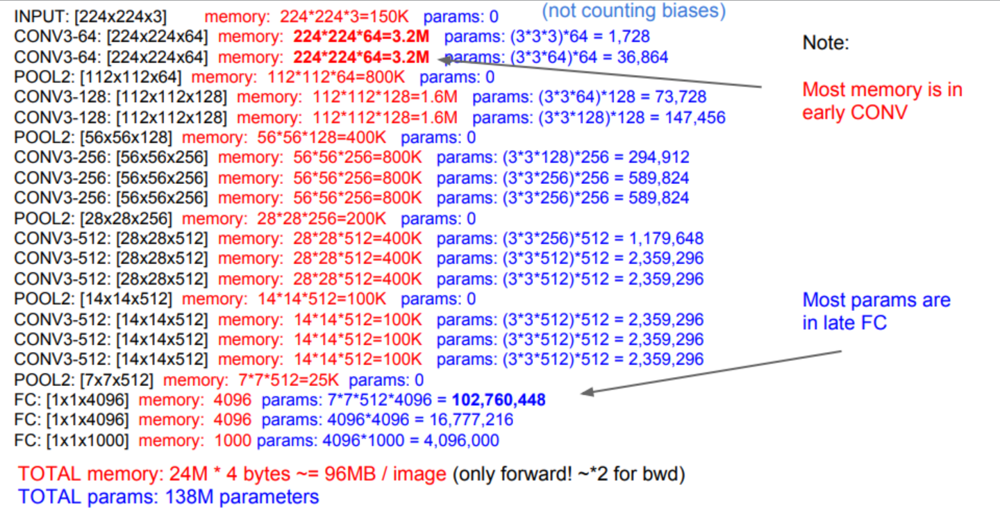

### 3. Impact on Training Time:
More parameters mean longer training times due to the increased computational load during backpropagation. Larger models demand more compute resources (CPU/GPU) and may require specialized hardware.

### 4. Impact on Inference Speed:
In production, smaller filters (e.g., 3x3) tend to be more efficient for inference, requiring fewer operations. Larger filters or more filters increase the computational load, slowing inference speed.

### 5. Model Optimization for Production:
To optimize CNNs for production, techniques like pruning (removing unnecessary weights), quantization (reducing precision), knowledge distillation (training smaller models), and layer fusion (combining layers) can reduce size and improve inference speed.

### 6. Challenges in Production Cycle:
- **Latency:** Larger models or networks with more filters can introduce delays, which is critical in real-time applications.
- **Edge Devices:** On devices with limited resources (e.g., smartphones), models need to be optimized for memory and computation efficiency.
- **Scalability:** Cloud-based deployment of large models requires high bandwidth and storage.

### Summary:
- Small filters (e.g., 3x3) are efficient for deeper networks and faster inference, while larger filters (e.g., 7x7) may capture more complex patterns but increase computational cost.
- More filters increase model complexity and memory usage but enhance representation learning.
- Model size impacts storage, transfer, and inference speed.
- Training time grows with the number of parameters.
- Optimizations like pruning, quantization, and distillation are essential for production-level efficiency.



## **9.6 Role and Benefits of Bottleneck Layers in CNNs**

Bottleneck layers are a key concept in deep learning, particularly in designing efficient Convolutional Neural Networks (CNNs) for tasks like classification, detection, and segmentation. They reduce computational complexity and the number of parameters, optimizing the model for production, especially when computational resources are limited.

### **What are Bottleneck Layers?**
A bottleneck layer refers to a part of the network where the dimensionality or number of channels is temporarily reduced before being expanded again. This narrow point reduces the amount of computation and the number of parameters, helping prevent the network from becoming unnecessarily large and slow.

![](https://i.sstatic.net/LhEso.png)

[Examples](https://docs.ultralytics.com/yolov5/tutorials/architecture_description/#2-data-augmentation-techniques)

### **How Bottleneck Layers Work**
- **Dimensionality Reduction**: Bottleneck layers reduce the number of channels in the middle of the network, lowering computational load and the number of parameters.
- **1x1 Convolutions**: Commonly used in bottleneck layers, 1x1 convolutions reduce the depth of feature maps without affecting spatial resolution. They are computationally inexpensive since they only perform channel-wise aggregation.

```
Network in network layer → convolution layer → Network in network layer
```

### **Bottleneck Layer in ResNet (Residual Networks)**
ResNet is a popular example where bottleneck layers are employed. In deeper networks like ResNet-50 or ResNet-101, bottleneck blocks help reduce the number of filters and then expand them again. This enables efficient training for very deep networks.

**Structure of a Bottleneck Block in ResNet**:
1. **1x1 Convolution**: Reduces the number of channels.
2. **3x3 Convolution**: Processes the reduced set of channels.
3. **1x1 Convolution**: Expands the number of channels back to the original or desired depth.

### **Key Benefits of Bottleneck Layers**

- **Reduced Model Complexity**: By reducing the depth of feature maps temporarily, bottleneck layers cut down the number of parameters and computations needed, making the model more efficient.
  
- **Improved Training Efficiency**: With fewer parameters, training becomes faster, requiring less memory, and helping to avoid overfitting.
  
- **Preserving Important Features**: Bottleneck layers force the network to focus on the most important features by reducing the number of feature maps in intermediate layers, improving the compactness and discriminative power of the learned representations.

- **Enabling Deeper Networks**: Without bottleneck layers, deeper networks would become too large and slow to train. They make it feasible to train very deep networks like ResNet-50, ResNet-101, and beyond.

- **Computational Efficiency**: The 1x1 convolutions in bottleneck layers are computationally inexpensive because they only compute linear combinations of input channels.

- **Better Memory Management**: By reducing the memory footprint, bottleneck layers are particularly useful for deploying models on memory-constrained devices such as mobile phones and embedded systems.




| **Aspect**               | **Bottleneck Layers**                         | **Pooling Layers**                           |
|--------------------------|-----------------------------------------------|----------------------------------------------|
| **Primary Purpose**       | Reduce the number of channels (depth)        | Reduce the spatial dimensions (height, width) |
| **Operations**            | 1x1 convolutions for dimension reduction, followed by 3x3 convolutions for processing | MaxPooling or AveragePooling                |
| **Effect on Dimensions**  | Reduces depth (number of channels) but keeps spatial dimensions | Reduces height and width of feature maps    |
| **Purpose in Architecture** | Make deep networks computationally efficient by reducing parameters | Decrease spatial complexity to improve computation |
| **Impact on Computational Load** | Reduces number of parameters, thus reducing computation | Reduces spatial resolution, lowering computation costs |
| **Usage**                 | Common in deep networks like ResNet, Inception | Common for downsampling in various architectures |
| **Involves Pooling?**     | No, usually uses convolutions for compression | Yes, involves pooling operations (e.g., MaxPooling, AveragePooling) |


![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*r8G3kNw-mUcu9sJBzY0CLQ.png)


> For example, an input feature map of dimensions 28x28x256 has a height and width of 28, with 256 channels. To reduce the channels to 16, we convolve 16 network-in-network filters (1x1x256) with the input. These 16 filters (1x1x256x16) produce 28x28x16 feature maps, reducing the input's dimensionality while maintaining spatial dimensions.

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*moju85D019R45FOYfGSdWw.png)



### 9.6.1 Determining Computational Complexity in Terms of Number of Network Parameters

The computational complexity of a neural network is determined by the number of parameters it contains. These parameters are defined by the **filter weights** in the convolutional layers and the **weight matrices** initialized after the dense layers. In this section, we will focus on calculating the **convolutional filter weight parameters** and compare the complexity with and without the use of a bottleneck layer.

#### **Case 1: Without Bottleneck Layer (Direct Convolution)**
#### 1. **Without Bottleneck Layer (Direct Convolution)**

- **Input dimensions**: 28x28x256
- **Filter size**: 10x10x256
- **Number of filters**: 256 (matching the input depth)
- **Padding**: Zero padding is applied

The number of parameters for each filter is:

```
Input (28x28x256) → filter weights (10x10x256) → output (28x28x256)
```
```
Parameters per filter = 10 * 10 * 256 = 25,600
````

Since we have 256 filters, the total number of parameters is:

```
Total parameters = 25,600 * 256 = 6,553,600
```


Thus, the **number of parameters in the convolutional layer** is **6,553,600**.

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*Vj7dSkUmbQyf6Ikmsv-W5g.png)

#### **Case 2: With Bottleneck Layer**

Here, we use a bottleneck layer to reduce the feature map's dimensions, which in turn reduces the total number of learnable parameters.

##### **Step 1: Bottleneck Layer (1x1 Convolution)**

- **Input dimensions**: 28x28x256
- **Filter size**: 1x1x256x64 (64 output channels)
- **Output dimensions**: 28x28x64

The number of parameters for the bottleneck layer is:

```
Input to NiN layer (28x28x256) → filter weights (1x1x256x64) → output (28x28x64)
```
```
Parameters per filter = 1 * 1 * 256 = 256 Total parameters = 256 * 64 = 16,384
```


So, the **number of parameters in the bottleneck layer** is **16,384**.

##### **Step 2: Convolutional Layer (10x10 Filter)**

Now, we apply the **10x10x256** filter to the output of the bottleneck layer, which has dimensions 28x28x64.

- **Input dimensions**: 28x28x64
- **Filter size**: 10x10x64
- **Number of filters**: 256 (to match the original depth)

The number of parameters for this convolution is:

```
Parameters per filter = 10 * 10 * 64 = 6,400 Total parameters = 6,400 * 256 = 1,638,400
```

So, the **number of parameters in the second convolutional layer** is **1,638,400**.


#### **Total Parameters with Bottleneck Layer**

The total number of parameters with the bottleneck layer is the sum of the parameters from both layers:

```
Total parameters = 16,384 + 1,638,400 = 1,654,784

```
![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*oP9s23XlfzenSmNxDXPFrQ.png)

#### **Comparison**

- **Without Bottleneck**: 6,553,600 parameters
- **With Bottleneck**: 1,654,784 parameters

The ratio of the parameters is:

```
6,553,600 / 1,654,784 ≈ 3.96
```


This shows that the bottleneck layer reduces the number of parameters by a factor of approximately **3.96**, which greatly reduces computational complexity.


### Conclusion

Using a bottleneck layer results in a significant reduction in the number of learnable parameters, which reduces the network's computational complexity. This is especially helpful in deep networks, such as **GoogLeNet** and **YOLO**, where even trivial convolutional operations can cause a large increase in complexity due to the size of the feature maps.


## **9.7 Understanding How ResNet Mitigates Overfitting and the Concept of Shallower Models**

When increasing the number of layers in a ResNet (Residual Network), overfitting can become a potential issue, particularly when the model becomes very deep. However, ResNet and other similar deep architectures are designed with several strategies that help mitigate overfitting even as the network depth increases.

### Key Factors That Help Prevent Overfitting in ResNet

#### Residual Connections:
One of the primary reasons ResNet works well with deeper networks is the use of residual connections (skip connections). These connections allow the network to learn identity mappings. When the network is very deep, learning these identity mappings helps in stabilizing the training process and mitigates the risk of overfitting because the network can skip unnecessary layers when needed and focus on learning useful transformations. This results in improved gradient flow during backpropagation, helping the model converge better and preventing it from getting stuck in local minima, which can contribute to overfitting.

#### Vanishing/Exploding Gradients:
As networks grow deeper, gradients can either vanish (become too small) or explode (become too large), making training difficult. The residual connections in ResNet help address this problem by ensuring that the gradients can flow through the network more effectively. This makes deeper networks more trainable and reduces the likelihood of overfitting due to poor gradient propagation.

#### Batch Normalization:
ResNet typically uses batch normalization (BN) after each convolutional layer. Batch normalization normalizes the output of each layer, ensuring that the network’s weights are updated in a way that improves convergence and stability. BN also acts as a form of regularization, helping prevent overfitting by reducing internal covariate shift and making the training process more robust.

#### Regularization Techniques:

- **Dropout:** While not strictly part of ResNet's core architecture, dropout is commonly used in conjunction with ResNet to further prevent overfitting. Dropout randomly disables a fraction of neurons during training, forcing the network to not rely on specific activations and improving generalization.

![](https://www.baeldung.com/wp-content/uploads/sites/4/2020/05/2-1-2048x745-1-1024x373.jpg)

![](https://www.baeldung.com/wp-content/uploads/sites/4/2020/05/Blank-Diagram1.svg)

- **Weight Decay (L2 Regularization):** Adding weight decay can penalize large weights, forcing the model to find solutions that are less likely to overfit the data. This is commonly used with ResNet to control overfitting.

#### Data Augmentation:
In practice, data augmentation is used during the training of ResNet. Augmentation techniques, such as random cropping, flipping, and rotation, artificially increase the diversity of the training set, which helps the model generalize better and reduces overfitting. This is particularly important when using deep networks, as they are more prone to overfitting on limited datasets.

#### Pretrained Models (Transfer Learning):
Using pretrained models (especially with architectures like ResNet-50, ResNet-101, etc.) and fine-tuning them on your dataset is another effective strategy to combat overfitting. By using a model that has already learned useful features on a large, diverse dataset (such as ImageNet), you reduce the risk of overfitting, particularly when working with smaller datasets.

#### Global Average Pooling:
In many ResNet variants, particularly those used for classification tasks, global average pooling is used instead of fully connected layers at the end. This helps prevent overfitting because it reduces the number of parameters compared to using a large fully connected layer. Fewer parameters mean less chance of overfitting, particularly when the dataset is small or when there are limited training resources.

### Challenges of Deep ResNets and Overfitting
While ResNet's design helps mitigate overfitting, there are still challenges to consider:

#### Extremely Deep Networks:
As the number of layers increases significantly (e.g., going from ResNet-50 to ResNet-152 or deeper), the number of parameters also increases. Even with residual connections and batch normalization, very deep networks can still overfit if the dataset is not large enough to support the additional complexity.

#### Data Insufficiency:
If the dataset is too small, even ResNet may start overfitting despite its design advantages. Deep networks require large datasets to generalize well, and when the dataset is insufficient, the model may memorize the training data rather than learning meaningful patterns.

#### Hyperparameter Tuning:
Overfitting may occur if hyperparameters (such as learning rate, batch size, or dropout rate) are not tuned properly. For example, using too large a learning rate or too few training epochs may cause the model to overfit or underfit.

### Strategies to Mitigate Overfitting in Deep ResNets

#### Early Stopping:
Early stopping can be employed to prevent the model from overfitting. During training, the model’s performance on the validation set is monitored, and training stops once the validation performance starts to degrade, even if the training performance continues to improve.

#### Cross-Validation:
Using cross-validation can help ensure that the model generalizes well. By splitting the data into multiple folds, the model is trained on different subsets of the data, helping to assess its generalization ability and reduce overfitting.

#### Advanced Regularization:
Techniques such as cutout, mixup, or label smoothing can be employed in ResNet to further regularize the model and help it generalize better.

### Summary: How ResNet Mitigates Overfitting as Layers Increase

- **Residual connections** are a key factor in making deeper networks feasible without overfitting, as they allow the network to learn identity mappings and ensure better gradient flow.
- **Batch normalization**, **data augmentation**, **weight decay**, and **dropout** all serve as regularization strategies that help prevent overfitting.
- The use of **pretrained models** and fine-tuning also helps prevent overfitting when there is limited data available.
- Despite these advantages, extremely deep networks (e.g., ResNet-152 or deeper) can still overfit if not managed properly, particularly if the dataset is small. It is important to balance model depth with dataset size and to use regularization techniques to ensure good generalization.
- By combining these strategies, ResNet models can handle deeper architectures while maintaining a balance between accuracy and overfitting.

### Shallower Models

A shallower model refers to a neural network or deep learning architecture with fewer layers compared to a deeper model. Specifically, in the context of Convolutional Neural Networks (CNNs) or other deep learning architectures, the term "shallower" typically means the network has:

- **Fewer Layers:** A shallower model has fewer layers of neurons (e.g., fewer convolutional layers, pooling layers, or fully connected layers). For example, a shallow CNN might have just a few convolutional layers, whereas a deep CNN could have tens or even hundreds of layers.
- **Smaller Network Depth:** Depth refers to how many layers are stacked in a model. In a shallow model, the depth is low, which means the model has a limited ability to learn complex patterns from data compared to deeper models. For instance, a ResNet-18 is considered shallower than ResNet-152 because ResNet-18 has only 18 layers, while ResNet-152 has 152 layers.

#### Key Characteristics of Shallower Models:
- **Fewer Parameters:** Shallower models tend to have fewer parameters because they have fewer layers. This can be advantageous for training on smaller datasets, as the risk of overfitting is reduced due to the lower model capacity.
- **Lower Computational Cost:** A shallower model requires less computation for both training and inference because there are fewer layers to process. This can lead to faster training times and less memory usage, making them suitable for applications with limited resources.
- **Less Complexity:** Shallow models are less complex and might struggle to capture highly intricate patterns in data compared to deeper models. For instance, a shallow model may not perform well on tasks like object detection or image classification if the data is highly complex.
- **Risk of Underfitting:** Because shallow models have fewer layers, they are less capable of learning from large and complex datasets. As a result, they may not be able to fully capture the underlying patterns in the data, leading to underfitting. This means the model performs poorly because it is too simple for the problem at hand.

#### Shallow vs. Deep Models
- **Shallow Models:**
  - Fewer layers (e.g., 2-5 layers).
  - Suitable for simpler tasks or smaller datasets.
  - Faster to train and use fewer resources.
  - May underperform on complex tasks or larger datasets due to limited capacity.
  
- **Deep Models:**
  - More layers (e.g., 50, 100, or more layers).
  - Better suited for complex tasks (e.g., image recognition, natural language processing).
  - Require more computational resources, larger datasets, and longer training times.
  - Have a greater risk of overfitting, but techniques like regularization, data augmentation, and residual connections help mitigate this.

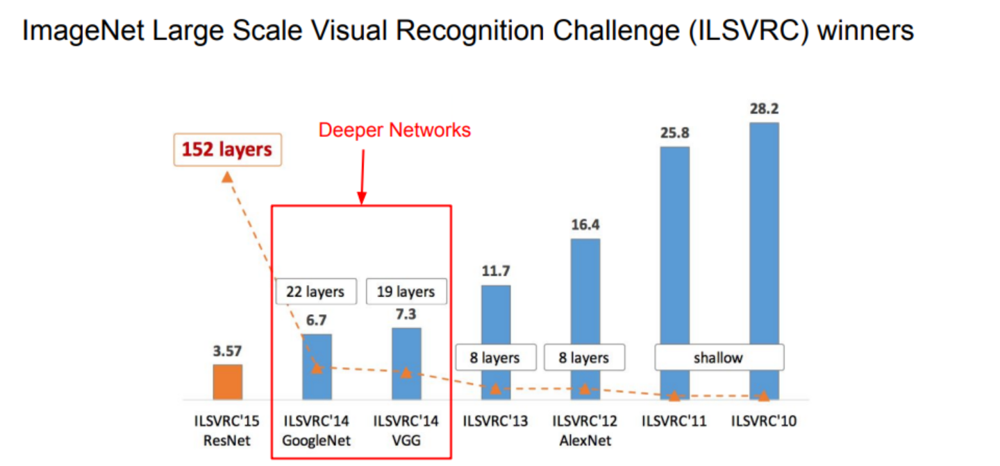

#### Trade-offs Between Shallow and Deep Models:
Shallow models are simpler and easier to train, but their capacity to model complex relationships is limited. They might struggle to perform well on difficult tasks like high-resolution image classification, object detection, or natural language processing.

Deep models are more powerful and capable of learning intricate patterns, but they require larger datasets, more computational power, and careful regularization to avoid overfitting.

In summary, shallower models are networks with fewer layers, which typically result in lower capacity to model complex data but come with the benefits of reduced training time, computational cost, and a lower risk of overfitting, especially for simpler tasks or smaller datasets.


## **9.8 Inception Module**

The **Inception Module** is a key innovation in convolutional neural networks (CNNs) introduced in **GoogLeNet (Inception v1)**, which won the ImageNet Large Scale Visual Recognition Challenge in 2014. The main idea behind the Inception Module is to use multiple types of convolutions within the same layer, enabling the network to capture a variety of features at different scales, without increasing the computational burden significantly.

### Key Features of the Inception Module:
1. **Multiple Filter Sizes in Parallel**: The module applies multiple types of convolutions (e.g., 1x1, 3x3, and 5x5) simultaneously, enabling the network to capture different levels of detail and abstraction in features. This parallelism allows the network to be more expressive while learning multiple kinds of patterns at once.
   
2. **1x1 Convolutions for Dimensionality Reduction**: One of the critical innovations in the Inception Module is the use of 1x1 convolutions. These are applied before larger convolutions (such as 3x3 or 5x5) to reduce the number of input channels, lowering the computational cost while maintaining the richness of learned features. This helps to prevent excessive computation in deeper layers.

3. **Concatenation of Feature Maps**: The outputs from the different convolutions are concatenated along the depth axis (i.e., the channels). This enables the network to integrate features of various scales into a unified representation, which increases the model's capacity to capture diverse spatial patterns.

4. **Pooling Operations**: Max pooling or average pooling operations are typically incorporated within the module. This increases the receptive field of the network and helps it learn larger spatial context, thus improving its ability to generalize across different input variations.

### Structure of the Inception Module:
An Inception module typically consists of the following operations applied in parallel:
- **1x1 Convolution**: Helps reduce the number of channels, improving computational efficiency.
- **3x3 Convolution**: Captures medium-level features.
- **5x5 Convolution**: Captures larger spatial features.
- **3x3 Max Pooling**: Aggregates information from larger regions.
- **Concatenate**: The results of all operations are concatenated to form the final feature map.

### Diagram of an Inception Module:

```plaintext
            +----------------------+
            |   1x1 Convolution    |
            +----------------------+
                    |
            +----------------------+
            |   3x3 Convolution    |
            +----------------------+
                    |
            +----------------------+
            |   5x5 Convolution    |
            +----------------------+
                    |
            +----------------------+
            |   3x3 Max Pooling    |
            +----------------------+
                    |
         +----------------------------+
         | Concatenate all feature maps |
         +----------------------------+
```
## **Advantages of the Inception Module:**

- **Increased Efficiency**: By using multiple filter sizes in parallel, the Inception module can learn different features at various scales, allowing for more efficient and accurate feature extraction.
- **Lower Computational Cost**: The 1x1 convolutions help reduce the number of channels before applying more computationally expensive 3x3 and 5x5 convolutions, thus lowering the overall cost and memory usage.
- **Improved Flexibility**: The combination of convolutions and pooling allows the module to capture a wide range of features, making it adaptable to different kinds of input data.
- **Scalability**: The Inception module is designed to scale efficiently with deeper architectures, enabling it to handle larger and more complex datasets without a significant increase in computational burden.

## **Evolution of the Inception Architecture:**

- **Inception v1 (GoogLeNet)**: Introduced the Inception module and achieved state-of-the-art performance at the time.

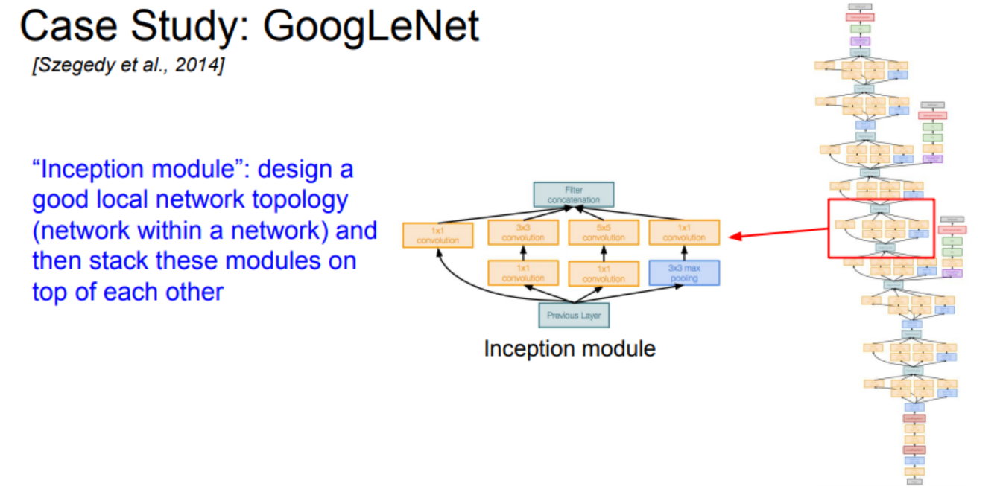

- **Inception v2 and v3**: Introduced optimizations like factorized convolutions (breaking down larger convolutions into smaller ones) and batch normalization to improve training stability.
- **Inception v4**: Further enhanced the architecture to improve both efficiency and accuracy, building upon the ideas from previous versions.

## **Applications of the Inception Module:**

The Inception module is used in a variety of tasks in computer vision, including:

- **Image Classification**: The Inception module helps networks to classify objects based on complex visual patterns.
- **Object Detection**: It can be applied to detect objects within an image by learning spatial hierarchies and features at different scales.
- **Semantic Segmentation**: Inception modules can aid in understanding pixel-wise classifications within images.
- **Transfer Learning**: Pre-trained Inception models are often used for transfer learning in various vision-based tasks due to their generalization capability.

## **Summary:**

The Inception Module is a fundamental component in modern CNNs, allowing networks to efficiently capture diverse features by applying multiple convolutions with different filter sizes in parallel. It enables networks to learn complex patterns without significant increases in computational cost, making it an essential building block in many deep learning architectures, particularly for image-related tasks.


> **Problem with the Inception Module:**
>
> Despite its advantages, the Inception module can present issues related to **computational complexity**:
>
> 1. **Increased Computational Requirements**: The parallel use of multiple filter sizes (1x1, 3x3, and 5x5 convolutions) increases the number of operations required for each forward pass, leading to higher computational costs, especially in deeper networks.
>
> 2. **Memory Usage**: The parallel operations within the Inception module increase memory demands. Each set of convolutions and pooling layers requires separate memory allocation, making it more memory-intensive, particularly when dealing with large images or deep networks.
>
> 3. **Training Time**: With multiple convolutions and pooling layers applied at each stage, the training time increases compared to simpler architectures. This added complexity also makes the model harder to optimize, requiring more computational resources for hyperparameter tuning.
>
> **Summary**: The trade-off with the Inception module is its ability to extract diverse features from different scales at the cost of higher computational complexity. These complexities can hinder real-time or large-scale deployments unless optimized effectively.


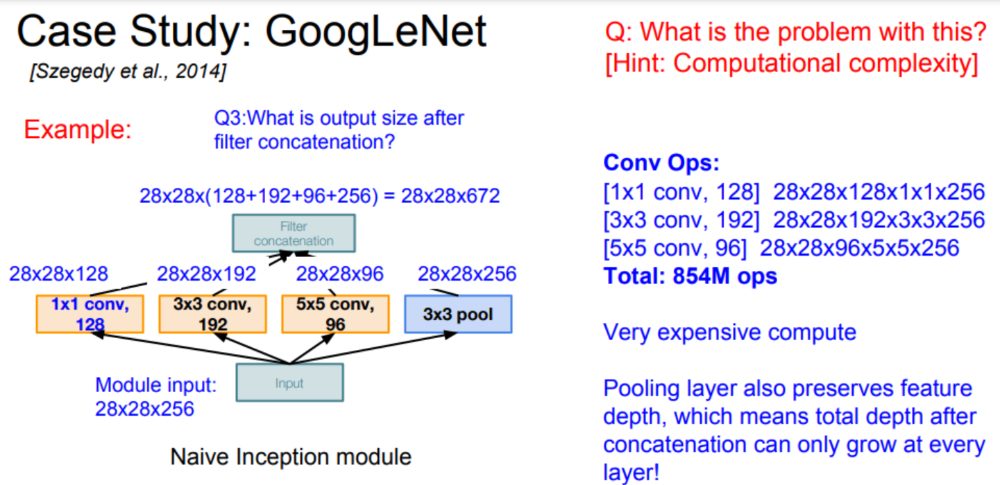

> **Solution: “Bottleneck” Layers with 1x1 Convolutions to Reduce Feature Depth**
>
> One effective solution to mitigate the computational complexity of the Inception module is the use of **"bottleneck" layers** that apply **1x1 convolutions**. These layers help reduce the depth of the feature maps before applying the more computationally expensive 3x3 and 5x5 convolutions.
>
> **How Bottleneck Layers Work:**
>
> - **1x1 Convolutions**: These convolutions are applied before the larger convolutions (such as 3x3 or 5x5). By using 1x1 convolutions, the number of channels (or depth of the feature maps) is reduced, thereby decreasing the computational load and memory usage.
> - **Reducing Depth**: The "bottleneck" layer serves as a dimensionality reduction step, allowing the network to focus on more important features while reducing the overall number of operations needed in the subsequent layers.
> - **Increased Efficiency**: This reduction in feature depth helps to lower the computational complexity of the network, making it more efficient and faster during both training and inference.

> **Summary**: Using 1x1 convolutions in bottleneck layers helps reduce the depth of feature maps, addressing the computational complexity of the Inception module while maintaining the ability to learn diverse features at different scales.


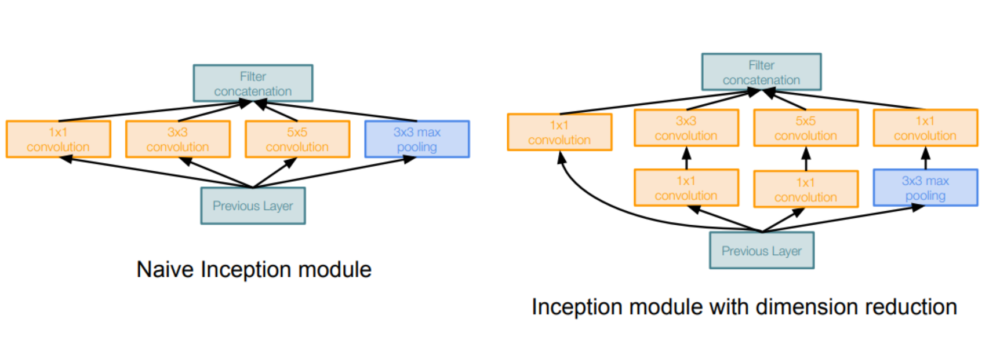

**Full GoogLeNet architecture**

![](https://media.geeksforgeeks.org/wp-content/uploads/20200429201549/Inceptionv1_architecture.png)

> **Auxiliary Classification Outputs to Inject Additional Gradient at Lower Layers:**
>
> In deep architectures like the Inception network, one effective strategy to improve training is the use of **auxiliary classification outputs**. These are additional classification heads added at lower layers in the network. The auxiliary output provides extra gradient signals, which help with the training of deeper layers that may otherwise struggle due to vanishing gradients.
>
> **How Auxiliary Classifiers Work:**
> - **Structure**: Typically, an auxiliary classifier consists of an **Average Pooling** layer followed by a **1x1 Convolution**, a **Fully Connected (FC) layer**, another **FC layer**, and finally a **Softmax layer** to produce the classification output.
> - **Gradient Injection**: By adding this auxiliary classifier, additional gradient information is propagated back into the earlier layers during backpropagation, which can help with faster and more stable convergence, especially in very deep networks.
> - **Preventing Vanishing Gradients**: This technique reduces the risk of vanishing gradients in deep networks, ensuring that the lower layers continue to learn effectively.
>
> **Summary**: Auxiliary classification outputs provide a powerful way to boost the learning process in deep networks by injecting additional gradients into earlier layers, thereby enhancing training stability and performance.


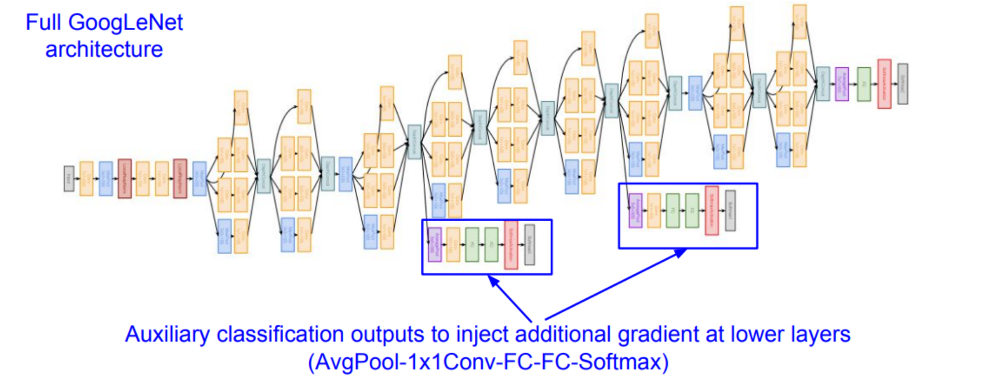

## 9.9 Residual Connections in Neural Networks

A **residual connection**, also known as a **skip connection**, is a technique used in deep neural networks, particularly in architectures like **ResNet (Residual Network)**, to address challenges like **vanishing gradients**, **training difficulties**, and **overfitting** in very deep models.

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*U-cDCj0EEC5CjoX0HcQdjA.png)

### What is a Residual Connection?

In a residual connection, the input to a layer (or a block of layers) is directly **added** to the output of that layer (or block), bypassing the transformation in between. This creates a shortcut for the information to flow directly to subsequent layers, ensuring that some of the input features are preserved.

**Mathematically:**

If the input to a layer is `x`, and the transformation applied by the layer (or block) is `F(x)`, the output with a residual connection becomes:

`y = F(x) + x`

- `F(x)`: Represents the transformation (e.g., convolution, activation, etc.).
- `x`: The original input, added directly to the output `F(x)`.

### Why Use Residual Connections?

1. **Addressing the Vanishing Gradient Problem**
   - Ensures gradients flow back directly through the shortcut path, reducing the risk of vanishing gradients.

2. **Improving Training of Deep Networks**
   - Makes it easier to train deeper networks by allowing them to learn **identity mappings** and focus on refining important features.

3. **Preventing Degradation of Performance**
   - Helps avoid performance degradation when adding more layers by optimizing the use of additional layers.

4. **Encouraging Feature Reuse**
   - Combines learned features (`F(x)`) and raw input features (`x`), improving expressiveness.

### Intuition Behind Residual Connections

- If certain layers are not contributing significantly, the network can **skip them** by learning an identity function `F(x) = 0`.
- This allows the network to adaptively decide which transformations are necessary and which can be bypassed.


### Example of a Residual Block

A **residual block** typically looks like this:

1. Input `x` passes through a series of layers (e.g., convolution, batch normalization, ReLU).
2. The output `F(x)` is added to `x` (the input).
3. The result `y = F(x) + x` becomes the input for the next layer.

**Diagram:**
```
Input --> [Conv + BatchNorm + ReLU] --> Output
  |                                        |
   ----------------------------------------
                  (Addition)

```

![](https://miro.medium.com/v2/resize:fit:828/format:webp/1*RTYKpn1Vqr-8zT5fqa8-jA.png)

### Applications of Residual Connections

1. **ResNet (Residual Networks):**
   - Residual connections are the foundation of ResNet architectures, enabling the training of very deep models (e.g., ResNet-152).
   
2. **Variations:**
   - Used in architectures like ResNeXt, Wide-ResNet, and DenseNet.

3. **Other Tasks:**
   - Residual connections are used in image recognition, object detection, natural language processing, and generative models.

### Benefits of Residual Connections

- **Better Gradient Flow:** Reduces the risk of vanishing gradients.
- **Efficient Training:** Enables faster and more stable training of deep networks.
- **Feature Reuse:** Combines raw and transformed features for better performance.
- **Supports Very Deep Networks:** Allows architectures with hundreds of layers to perform well.

### Summary: Residual Connections and Their Impact

Residual connections in neural networks serve a role similar to gain in a PID controller by improving stability and efficiency, particularly in very deep networks. Here’s a concise summary of their impact:

1. **Stabilizing Training Dynamics**  
   - Prevent vanishing or exploding gradients, ensuring smooth backpropagation in deep networks.

2. **Improved Learning Efficiency**  
   - Simplify the optimization process by focusing on residual mappings \( F(x) = y - x \), making training faster and more effective.

3. **Combining New and Old Features**  
   - Dynamically balance learned transformations \( F(x) \) and original input features \( x \), fostering feature reuse and adaptive learning.

4. **Avoiding Performance Degradation**  
   - Maintain or improve performance as the network depth increases by allowing layers to skip unnecessary computations.

5. **Fostering Identity Mappings**  
   - Enable networks to skip layers when deeper transformations are not beneficial, preserving input features when needed.

**Key Takeaway**
Residual connections act as a gain-like mechanism, regulating information flow to ensure efficient, stable, and scalable learning in deep neural networks. This innovation has become a cornerstone for modern architectures like ResNet, driving their success in handling complex tasks with very deep layers.

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*EMHk3-4qk-MK6O34BTQhxA.png)

### **9.9.1 Hypothesis: Optimization Challenges in Deeper Models**

#### **Problem Statement**
Deeper neural networks are fundamentally harder to optimize, and their performance may degrade despite having more layers. Intuitively, a deeper model should perform at least as well as a shallower one, as it can replicate the shallower model's functionality with added capacity. However, the optimization landscape becomes more challenging with depth due to factors like vanishing gradients and increased parameter complexity.

#### **Proposed Solution: Identity Mapping via Residual Connections**

**Core Idea:**
To address the optimization problem, we can design the deeper model by:
1. **Copying Learned Layers**: Initialize the deeper model by transferring the learned parameters of the shallower model.
2. **Identity Mapping for Additional Layers**: Set the additional layers to identity mappings \( F(x) = x \). This ensures that the added layers do not initially modify the data flow, preserving the shallower model's performance.

#### **Key Benefits of This Approach**

1. **Performance Retention**:
   - By construction, the deeper model retains the performance of the shallower model as a baseline.

2. **Improved Optimization**:
   - Identity mappings reduce the risk of vanishing gradients, as gradients flow directly through the skip connections.

3. **Flexibility to Learn**:
   - The additional layers, initialized as identity mappings, can adaptively learn transformations during training, improving model capacity without disrupting the base functionality.

4. **Simpler Transition to Deeper Models**:
   - This approach allows seamless scaling from shallower to deeper models, reducing the need for complex re-initializations or retraining.

#### **Realization in Residual Networks (ResNet)**

Residual connections directly implement this hypothesis by:
- Allowing layers to approximate identity mappings initially.
- Facilitating incremental learning of new features without compromising the learned representations of earlier layers.

This design has been instrumental in enabling very deep models (e.g., ResNet-152) to outperform shallower counterparts without optimization difficulties.

#### **Conclusion**

By using residual connections and identity mappings, we can effectively address the optimization challenges in deeper networks. This approach ensures that deeper models perform at least as well as their shallower versions while unlocking their potential for higher representational capacity.


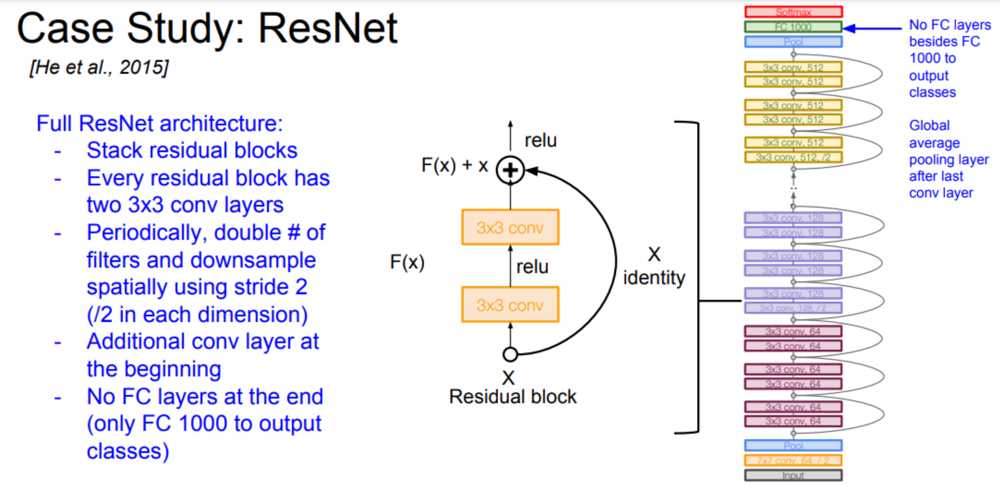

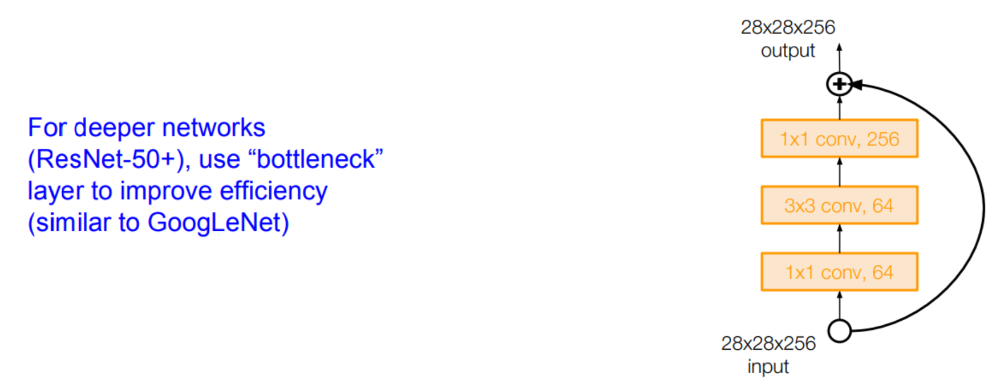

**An Analysis of Deep Neural Network Models for Practical Applications, 2017.**

![](https://www.researchgate.net/profile/Frank-Koss/publication/320084139/figure/fig2/AS:543716588744704@1506643544031/Comparison-of-popular-CNN-architectures-The-vertical-axis-shows-top-1-accuracy-on.png)

### **9.9.2 NiN (Network in Network)**

**Concept**: NiN replaces traditional convolutional layers with micro-networks that perform more complex feature extraction within each spatial location.

- **Main Idea**: Uses multilayer perceptrons (MLPs) as convolutional kernels.
- **Benefits**:
  - Increases feature extraction capability by adding non-linear processing within each convolution.
  - Reduces the need for large filter sizes.
- **Challenges**: Higher computational cost due to increased non-linear operations.


In [ ]:
!pip install d2l

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.9/58.9 kB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 111.7/111.7 kB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 75.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 65.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.3/12.3 MB 94.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.6/62.6 kB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.4/34.4 MB 12.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.3/98.3 kB 6.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 125.0/125.0 kB 8.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 95.2/95.2 kB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 59.3 MB/s eta 0:00:00
  Attempting uninstall: requests
    Found existing installation: requests 2.32.3
    Uninstalling requests-2.32.3:
      Successfull

In [ ]:
import torch
from torch import nn
from d2l import torch as d2l


def nin_block(in_channels, out_channels, kernel_size, strides, padding):
    return nn.Sequential(
        nn.Conv2d(in_channels, out_channels, kernel_size, strides, padding),
        nn.ReLU(),
        nn.Conv2d(out_channels, out_channels, kernel_size=1), nn.ReLU(),
        nn.Conv2d(out_channels, out_channels, kernel_size=1), nn.ReLU())

In [ ]:
net = nn.Sequential(
    nin_block(1, 96, kernel_size=11, strides=4, padding=0),
    nn.MaxPool2d(3, stride=2),
    nin_block(96, 256, kernel_size=5, strides=1, padding=2),
    nn.MaxPool2d(3, stride=2),
    nin_block(256, 384, kernel_size=3, strides=1, padding=1),
    nn.MaxPool2d(3, stride=2),
    nn.Dropout(0.5),
    # There are 10 label classes
    nin_block(384, 10, kernel_size=3, strides=1, padding=1),
    nn.AdaptiveAvgPool2d((1, 1)),
    # Transform the four-dimensional output into two-dimensional output with a
    # shape of (batch size, 10)
    nn.Flatten())

![](https://classic.d2l.ai/_images/nin.svg)

In [ ]:
X = torch.rand(size=(1, 1, 224, 224))
for layer in net:
    X = layer(X)
    print(layer.__class__.__name__,'output shape:\t', X.shape)

Sequential output shape:	 torch.Size([1, 96, 54, 54])
MaxPool2d output shape:	 torch.Size([1, 96, 26, 26])
Sequential output shape:	 torch.Size([1, 256, 26, 26])
MaxPool2d output shape:	 torch.Size([1, 256, 12, 12])
Sequential output shape:	 torch.Size([1, 384, 12, 12])
MaxPool2d output shape:	 torch.Size([1, 384, 5, 5])
Dropout output shape:	 torch.Size([1, 384, 5, 5])
Sequential output shape:	 torch.Size([1, 10, 5, 5])
AdaptiveAvgPool2d output shape:	 torch.Size([1, 10, 1, 1])
Flatten output shape:	 torch.Size([1, 10])



### **9.9.3 Wide ResNet**

**Concept**: A variant of ResNet that widens the network (increases filter dimensions) instead of deepening it.

- **Main Idea**: Reduces the depth of ResNet while expanding the number of channels in each layer.
- **Benefits**:
  - Easier optimization with fewer layers.
  - Achieves comparable or better performance with reduced training time.
- **Challenges**: Increased memory consumption due to wider layers.

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*bggPuUy0IyrcqsHt_Lxwvw.png)


### **9.9.4 ResNeXt**

**Concept**: Extends ResNet by introducing **cardinality**, which is the number of parallel transformations in a layer.

- **Main Idea**: Instead of simply deepening or widening, ResNeXt increases the paths (cardinality) for feature extraction.
- **Benefits**:
  - Improved performance with fewer parameters compared to deeper models.
  - More flexibility in designing architectures.
- **Challenges**: Requires careful tuning of cardinality, depth, and width.

![](https://player.slideplayer.com/89/14282282/slides/slide_48.jpg)


### **9.9.5 Stochastic Depth**

**Concept**: A regularization technique where certain layers are randomly skipped during training.

- **Main Idea**: For each mini-batch, layers are stochastically dropped, allowing the network to behave as a combination of deep and shallow models.
- **Benefits**:
  - Reduces overfitting and improves generalization.
  - Speeds up training by skipping computations.
- **Challenges**: Careful selection of dropout probabilities is necessary.



### **9.9.6 DenseNet**

**Concept**: Connects each layer to every other layer in a dense connectivity pattern.

- **Main Idea**: Instead of learning completely new features in each layer, DenseNet reuses features from all preceding layers.
- **Benefits**:
  - Reduces the number of parameters significantly.
  - Improves gradient flow and feature reuse.
- **Challenges**: Computational overhead due to increased connections.

![](https://www.researchgate.net/publication/367236033/figure/fig2/AS:11431281113721345@1674056588852/DenseNet-Structure-Densely-Sources-DenseNet-Structure-Densely-Connected-Convolutional.jpg)


### **9.9.7 FractalNet**

**Concept**: Uses a fractal-like architecture with repeated self-similar structures to create deep networks.

- **Main Idea**: Multiple paths of varying depths are created in a fractal pattern, allowing networks to implicitly regularize.
- **Benefits**:
  - Robust to overfitting.
  - Mimics the benefits of residual connections without explicit shortcuts.
- **Challenges**: High computational cost due to intricate fractal patterns.

![](https://figures.semanticscholar.org/0d0101e65e52ae0cec38bcd13c6a9d631979c577/2-Figure1-1.png)


### **9.9.8 SqueezeNet**

**Concept**: A lightweight architecture designed for reduced parameter usage while maintaining performance.

- **Main Idea**: Introduces **Fire Modules**, which use squeeze (1x1 filters) and expand (1x1 and 3x3 filters) operations to compress feature maps.
- **Benefits**:
  - Extremely small model size, suitable for mobile and embedded devices.
  - Comparable accuracy to AlexNet with 50x fewer parameters.
- **Challenges**: Lower capacity might limit performance on complex tasks.


## **9.10 Modern CNN Architectures Used in Autonomous Vehicles and How They Are Used**

- **Modern CNN architectures** play a crucial role in enabling autonomous vehicles to process and understand their environment.
- These architectures are designed to handle various tasks such as image classification, object detection, semantic segmentation, and depth estimation, which are essential for the vehicle’s decision-making process.
  
### Common CNN Architectures Used in Autonomous Vehicles:
1. **VGGNet**:
   - Used for feature extraction from images with a deep network structure, helping in tasks like image classification and object recognition.

2. **ResNet (Residual Networks)**:
   - Known for its ability to handle very deep networks by using skip connections, which allow gradients to flow easily during training. This helps in processing complex data from cameras and sensors in autonomous vehicles.

3. **YOLO (You Only Look Once)**:
   - A real-time object detection system that can detect multiple objects in a single pass, making it efficient for applications such as pedestrian detection, vehicle tracking, and traffic sign recognition.

4. **U-Net**:
   - Mainly used for semantic segmentation, allowing the vehicle to recognize and classify different regions of the road (e.g., lanes, pedestrians, other vehicles, etc.).

5. **Faster R-CNN**:
   - Used for object detection tasks in autonomous vehicles. It provides high accuracy and speed for detecting vehicles, pedestrians, and obstacles.

### How These Architectures Are Used:
- **Object Detection**: CNNs help autonomous vehicles identify and classify objects (e.g., pedestrians, vehicles, traffic signs) to navigate safely through the environment.
- **Lane Detection**: Networks like VGGNet or ResNet can be used to detect lane markings on roads, allowing the vehicle to follow the correct lane.
- **Semantic Segmentation**: U-Net and similar networks help in segmenting images to identify various parts of the scene, such as roads, pedestrians, and other vehicles, which is crucial for path planning.
- **Depth Estimation**: CNNs are used to estimate the depth of objects in the vehicle’s surroundings, aiding in obstacle avoidance and collision detection.

### Conclusion:
- Modern CNN architectures in autonomous vehicles are essential for processing sensor data and enabling real-time decision-making, allowing these vehicles to operate safely and efficiently in complex environments.


# **10. RNN**
---



## **10.1 Understanding the Basics of Sequence Models**


### **10.1.1 What are time-indexed data points, and how do they relate to sequence modeling in RNNs?**

#### **Time-Indexed Data Points**

Time-indexed data points refer to data that is organized or indexed by time or sequential order. This type of data typically comes in the form of time series data, where each data point corresponds to a specific point in time (e.g., hourly stock prices, daily weather observations, or sensor readings over time).

Each data point in time-indexed data is associated with a timestamp or index that reflects its position in a temporal sequence. The time aspect is crucial, as it introduces dependencies between successive data points, meaning that the current data point often depends on the previous ones.

For example:
- **Stock prices**: The price of a stock today is likely influenced by its price in the past few days.
- **Weather data**: The temperature today may be influenced by the temperature over the last few hours or days.
- **Sensor data**: A sensor's reading at any given time is typically dependent on previous readings.

This temporal structure in the data is what makes time-indexed data essential for **sequence modeling**.

[For More Information](https://www.geeksforgeeks.org/time-series-forecasting-using-recurrent-neural-networks-rnn-in-tensorflow/)

#### **Relation to Sequence Modeling in RNNs**

Sequence modeling is a method used in machine learning to predict or understand data that has temporal dependencies. Recurrent Neural Networks (RNNs) are a class of neural networks designed specifically to handle such sequential data. Here's how time-indexed data and RNNs relate:

![](https://media.geeksforgeeks.org/wp-content/uploads/20230502081219/visualisation-min.png)

1. **Sequential Dependencies**:
   - RNNs excel at capturing the **dependencies between consecutive time steps** in sequence data. Time-indexed data naturally involves these dependencies. For instance, in stock price prediction, the price at time \( t \) depends on the price at time \( t-1 \), and this pattern continues over time.
   - RNNs use their internal state (memory) to store information about previous time steps, which helps in making predictions based on past data points. This makes them suitable for tasks like forecasting or sequence classification.

2. **Handling Variable-Length Sequences**:
   - Time-indexed data can often have varying lengths (e.g., one sequence may contain a year's worth of daily data, while another may only cover a week). RNNs can process sequences of **variable length**, making them versatile for many different types of sequential data.

3. **Dynamic Time Series Prediction**:
   - In RNNs, the data from each time step is fed into the network, and the network's hidden states evolve over time as new data points arrive. This allows RNNs to model dynamic systems like time-series forecasting, where predictions at time \( t \) rely on patterns learned from earlier time steps.

4. **Backpropagation Through Time (BPTT)**:
   - RNNs are trained using an algorithm called **Backpropagation Through Time (BPTT)**. This method allows the model to adjust its weights based on the errors observed at each time step. BPTT ensures that the RNN can learn from **sequential dependencies** present in time-indexed data by updating weights for each step, effectively learning long-range temporal relationships.

5. **Real-World Applications**:
   - **Natural Language Processing (NLP)**: In tasks like machine translation, text generation, and speech recognition, RNNs process sequences of words, where each word depends on the previous ones in the sentence. Each word in the sequence can be considered a time-indexed data point, as the model's predictions at each time step depend on the previous words.
   - **Time Series Forecasting**: In financial markets, healthcare, or weather forecasting, predicting future events depends heavily on previous values (time-indexed data points). RNNs are used to forecast future data points, utilizing past observations to make predictions.

#### **Key Takeaways**:
- **Time-indexed data** is data organized by timestamps or ordered in a sequence, where each point depends on its previous values.
- **RNNs** are ideal for modeling sequences because they can capture dependencies between time-indexed data points across different time steps, making them suitable for applications such as forecasting, text generation, and speech recognition.
- **Training RNNs** involves **Backpropagation Through Time (BPTT)**, allowing the network to learn temporal dependencies in sequences of time-indexed data.

In essence, time-indexed data is the natural input for sequence models like RNNs, as they are designed to handle the inherent sequential dependencies present in such data.


### **10.1.2 How does a traditional language model differ from a sequence-based model like an RNN?**

#### **Traditional Language Model**

A **traditional language model** typically relies on statistical techniques to predict the probability of a word or sequence of words occurring in a sentence based on fixed rules or simple statistical analysis. Common traditional models include **n-gram models** and **hidden Markov models (HMMs)**. These models consider a limited context (often the previous \( n-1 \) words in the sequence) to predict the next word or sequence of words.

- **N-gram models**: An n-gram language model predicts the next word based on the previous \( n-1 \) words. For example, a bigram model considers the previous word to predict the current word. These models have limitations because they rely only on local context (fixed-length windows of previous words) and do not capture long-range dependencies or word meanings.
  
- **Limitations of Traditional Models**:
  - **Fixed-length context**: Traditional language models, like n-grams, have a fixed window size (i.e., only considering a limited number of previous words). This leads to the **curse of dimensionality** as the number of possible word combinations increases with larger n.
  - **Lack of long-term memory**: Traditional models cannot remember long-range dependencies between words, making them less effective for tasks that require understanding over long sentences or documents.
  - **Rule-based or statistical**: These models do not learn features or representations from data but rather rely on predefined rules and statistical relationships.

#### **Sequence-Based Model (RNN)**

A **Recurrent Neural Network (RNN)** is a deep learning model designed specifically for sequence-based data, such as text, speech, or time-series data. Unlike traditional language models, RNNs learn to capture sequential dependencies by maintaining a hidden state that is updated at each time step based on both the current input and the previous hidden state.

- **Key Features of RNNs**:
  - **Dynamic context**: RNNs can handle sequences of arbitrary length and capture long-term dependencies in the data. The model’s hidden state acts as a form of memory, allowing it to retain information from earlier time steps and use that information to make predictions later in the sequence.
  - **Learning representations**: RNNs automatically learn relevant features and representations of the input data, making them much more flexible and capable of modeling complex relationships compared to traditional models.
  - **End-to-end learning**: RNNs learn directly from data through backpropagation, without the need for predefined rules or explicit statistical assumptions.

- **Longer-term dependencies**: Unlike traditional models, RNNs can capture relationships between distant words or elements in a sequence. For example, in language modeling, an RNN can remember the subject of a sentence even if the verb appears many words later.


#### **Traditional Language Model in little depth**

A language model assigns probabilities to sequences of words:

```
P(w_1, w_2, ..., w_T)
```


where `w_i` is the `i`-th word in the sequence.

#### **Key Idea:**
The joint probability of a sequence is estimated using the chain rule:

```
P(w_1, w_2, ..., w_T) = P(w_1) * P(w_2 | w_1) * P(w_3 | w_1, w_2) ... P(w_T | w_1, w_2, ..., w_{T-1})
```


This becomes computationally expensive as `T` increases.

#### **Techniques in Traditional Language Models**

##### **N-Gram Models:**
Simplify computation by assuming word dependence only on the last `N-1` words:

```
P(w_T | w_1, ..., w_{T-1}) ≈ P(w_T | w_{T-(N-1)}, ..., w_{T-1})
```


###### **Advantages:**
- Simpler and effective for small contexts.

###### **Disadvantages:**
- Limited context and struggles with large vocabularies.

##### **Smoothing Techniques:**
- **Additive Smoothing (Laplace):** Adds a constant (`α`) to all counts.
- **Kneser-Ney Smoothing:** Better generalization by redistributing probabilities.

##### **Count-Based Approaches:**
Based on word frequency counts:

```
P(w_{T-1}, w_T) = Count(w_{T-1}, w_T) / Count(w_{T-1})
```


##### **Maximum Likelihood Estimation (MLE):**
Estimates probabilities by maximizing data likelihood:

```
P(w_T | w_{T-1}) = Count(w_{T-1}, w_T) / Count(w_{T-1})

```


#### **Limitations**

- **Data Sparsity:** Zero probability for unseen sequences.
- **Limited Context:** Fixed `N`-grams can't capture long dependencies.
- **Vocabulary Size:** Large vocabularies require more resources.



#### **Key Differences Between Traditional Language Models and RNNs**

1. **Context Handling**:
   - Traditional models (e.g., n-grams) have a **fixed context** window and can only consider a limited number of previous words.
   - RNNs, on the other hand, can maintain a **dynamic context** and capture long-range dependencies by using a hidden state that evolves over time.

2. **Modeling Capabilities**:
   - Traditional models are **rule-based** or **statistical**, relying on explicit probabilities between fixed sequences of words.
   - RNNs **learn from data**, meaning they can automatically adjust their weights and improve over time, making them more flexible and capable of handling complex language patterns.

3. **Memory**:
   - Traditional models like n-grams do not have memory of past events (other than a fixed context).
   - RNNs have an **internal memory** (the hidden state) that can store information from previous time steps, allowing them to model long-term dependencies in sequences.

4. **Scalability**:
   - Traditional models are **computationally limited** by the size of the n-gram or the vocabulary, often facing challenges with **sparse data** and the curse of dimensionality.
   - RNNs are **scalable** and can be trained on large datasets, handling complex sequences and larger vocabularies more efficiently.

5. **Performance on Sequence Tasks**:
   - Traditional models struggle with **long-range dependencies** (e.g., maintaining coherence in long sentences).
   - RNNs excel at **sequence-based tasks** such as text generation, machine translation, and speech recognition, where understanding dependencies over long sequences is crucial.

#### **Key Takeaways**:

- **Traditional Language Models** like n-grams are based on fixed statistical rules and can only capture short-range dependencies due to their limited context.
- **RNNs** are designed to model sequential data by maintaining a hidden state that captures **long-range dependencies**, allowing them to handle tasks involving more complex and longer sequences, such as text generation and machine translation.
- RNNs have a **learning mechanism** that automatically adjusts based on data, while traditional models require predefined rules and assumptions.
- RNNs are much more effective at handling **long-term dependencies** and complex sequence patterns compared to traditional language models.

In summary, the key difference lies in the ability of RNNs to learn from data and model longer-term dependencies, which makes them more powerful and flexible for sequence-based tasks compared to traditional, statistical language models.


### **10.1.3 What are the limitations of traditional models when applied to sequential data, and how does transitioning to RNNs address them?**

#### **Limitations of Traditional Models for Sequential Data**

Traditional models such as **n-grams**, **Hidden Markov Models (HMMs)**, and **rule-based models** have certain inherent limitations when handling sequential data, such as text, speech, or time series. These limitations include the following:

##### **1. Limited Contextual Awareness**
Traditional models rely on a fixed context window (e.g., n-grams consider only the previous \( n-1 \) words). This limitation prevents the model from capturing long-term dependencies and broader context, which are essential in understanding the overall meaning of a sequence.

- **Example**: A trigram model considers only the previous two words, which means it may struggle to capture the context in longer sentences.

##### **2. No Memory of Previous Inputs**
Most traditional models treat each data point in isolation and do not maintain any memory of past inputs. This is problematic for sequential tasks where earlier data points heavily influence later ones, such as in time-series forecasting or language translation.

- **Example**: In language translation, translating a complex sentence may require understanding earlier words, something traditional models struggle with as they don’t have memory of past states.

##### **3. Poor Generalization**
Traditional models typically struggle to generalize when exposed to new sequences, especially those with varying lengths or unseen patterns. They often rely on predefined rules and patterns rather than learning directly from the data, which limits their flexibility.

- **Example**: For sentiment analysis, traditional models may fail to recognize varying sentence structures or emotional tones due to reliance on fixed rules.

##### **4. Curse of Dimensionality**
As the size of the context increases (e.g., moving from bigrams to trigrams or higher-order n-grams), the number of possible word combinations grows exponentially, leading to a sparse data problem. This results in inefficient computation and poor performance on rare or unseen sequences.

- **Example**: A trigram model exponentially increases the number of possible word combinations, making it inefficient to handle larger vocabularies.

##### **5. Difficulty Modeling Long-Term Dependencies**
Traditional models struggle to capture long-term dependencies because they do not retain memory of past inputs beyond a fixed window. This makes them ill-suited for tasks that require understanding the relationship between distant elements in a sequence.

- **Example**: In a long document or a conversation, the relationship between the first and last words (e.g., subject-object relationships) may be lost.

---

#### **How RNNs Address the Limitations of Traditional Models**

Recurrent Neural Networks (RNNs) are specifically designed to handle sequential data and address the limitations of traditional models. Here's how RNNs overcome these challenges:

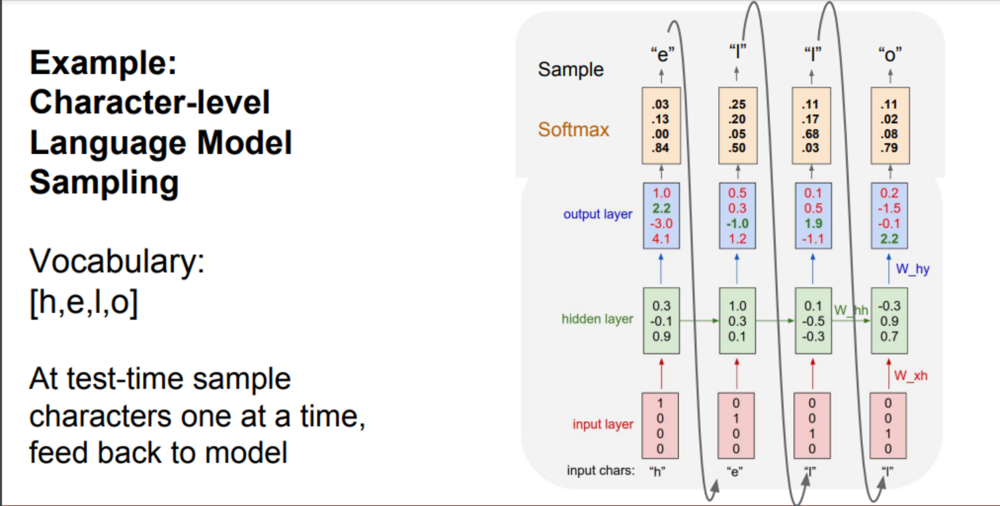

##### **1. Dynamic Contextual Awareness**
Unlike traditional models, RNNs maintain a hidden state that evolves over time, reflecting information from previous time steps. This allows RNNs to capture long-range dependencies and retain contextual information, enabling a deeper understanding of the sequence.

- **Example**: In a sentence, an RNN can maintain the context of the subject ("The cat") across many time steps, allowing it to generate appropriate verbs ("sat") even when far apart.

##### **2. Memory of Past Inputs**
RNNs use their hidden state to store memory of past inputs, enabling them to incorporate information from earlier time steps when making predictions. This makes RNNs much better suited for tasks where previous inputs are crucial for determining the next output.

- **Example**: In time-series forecasting, an RNN can remember past trends and use that information to predict future values, unlike traditional models that reset context with each time step.

##### **3. Improved Generalization**
RNNs learn patterns directly from the training data, adapting to various sequence lengths and unseen patterns. This makes them more flexible and capable of generalizing to new, previously unseen sequences.

- **Example**: In sentiment analysis, RNNs can generalize across different sentence structures and emotional tones by learning directly from the text, without relying on hard-coded rules.

##### **4. Efficient Parameter Use**
While traditional models, especially n-grams, require storing probabilities for every combination of words, RNNs use weight sharing across time steps. This reduces the number of parameters needed and allows RNNs to handle larger sequences more efficiently.

- **Example**: An RNN can process a long sentence using the same parameters across all time steps, significantly reducing the computational burden compared to an n-gram model.

##### **5. Modeling Long-Term Dependencies**
One of the main strengths of RNNs is their ability to capture long-term dependencies. Through mechanisms like **LSTM** (Long Short-Term Memory) or **GRU** (Gated Recurrent Units), RNNs can preserve important information across many time steps, addressing the problem of vanishing gradients in standard RNNs.

- **Example**: In machine translation, an LSTM-based model can capture dependencies between words that are far apart in the sentence, ensuring more accurate translations.

---

#### **Summary**

Traditional models such as n-grams, HMMs, and rule-based approaches face significant challenges in handling sequential data due to:

- **Limited contextual awareness**.
- **No memory of past inputs**.
- **Poor generalization** to new sequences.
- **The curse of dimensionality**.
- **Difficulty modeling long-term dependencies**.

Recurrent Neural Networks (RNNs) address these challenges by:

- **Maintaining dynamic context** and memory of past inputs.
- **Learning directly from data** to generalize across different patterns.
- **Reducing parameter complexity** through weight sharing.
- **Capturing long-term dependencies**, especially with LSTMs and GRUs.

Thus, RNNs provide a powerful framework for modeling sequential data, making them ideal for tasks such as language modeling, time-series prediction, and machine translation.


In [ ]:
import numpy as np
import PyPDF2

# data I/O
with open('/content/File_1.txt', 'r') as f:
    data = f.read()  # should be simple plain text file

chars = list(set(data))
data_size, vocab_size = len(data), len(chars)
print('data has %d characters, %d unique.' % (data_size, vocab_size))
char_to_ix = {ch: i for i, ch in enumerate(chars)}
ix_to_char = {i: ch for i, ch in enumerate(chars)}

# hyperparameters
hidden_size = 100  # size of hidden layer of neurons
seq_length = 25  # number of steps to unroll the RNN for
learning_rate = 1e-1

# model parameters
Wxh = np.random.randn(hidden_size, vocab_size) * 0.01  # input to hidden
Whh = np.random.randn(hidden_size, hidden_size) * 0.01  # hidden to hidden
Why = np.random.randn(vocab_size, hidden_size) * 0.01  # hidden to output
bh = np.zeros((hidden_size, 1))  # hidden bias
by = np.zeros((vocab_size, 1))  # output bias

def lossFun(inputs, targets, hprev):
    """
    inputs, targets are both list of integers.
    hprev is Hx1 array of initial hidden state
    returns the loss, gradients on model parameters, and last hidden state
    """
    xs, hs, ys, ps = {}, {}, {}, {}
    hs[-1] = np.copy(hprev)
    loss = 0
    # forward pass
    for t in range(len(inputs)):
        xs[t] = np.zeros((vocab_size, 1))  # encode in 1-of-k representation
        xs[t][inputs[t]] = 1
        hs[t] = np.tanh(np.dot(Wxh, xs[t]) + np.dot(Whh, hs[t - 1]) + bh)  # hidden state
        ys[t] = np.dot(Why, hs[t]) + by  # unnormalized log probabilities for next chars
        ps[t] = np.exp(ys[t]) / np.sum(np.exp(ys[t]))  # probabilities for next chars
        loss += -np.log(ps[t][targets[t], 0])  # softmax (cross-entropy loss)

    # backward pass: compute gradients going backwards
    dWxh, dWhh, dWhy = np.zeros_like(Wxh), np.zeros_like(Whh), np.zeros_like(Why)
    dbh, dby = np.zeros_like(bh), np.zeros_like(by)
    dhnext = np.zeros_like(hs[0])
    for t in reversed(range(len(inputs))):
        dy = np.copy(ps[t])
        dy[targets[t]] -= 1  # backprop into y
        dWhy += np.dot(dy, hs[t].T)
        dby += dy
        dh = np.dot(Why.T, dy) + dhnext  # backprop into h
        dhraw = (1 - hs[t] * hs[t]) * dh  # backprop through tanh nonlinearity
        dbh += dhraw
        dWxh += np.dot(dhraw, xs[t].T)
        dWhh += np.dot(dhraw, hs[t - 1].T)
        dhnext = np.dot(Whh.T, dhraw)

    for dparam in [dWxh, dWhh, dWhy, dbh, dby]:
        np.clip(dparam, -5, 5, out=dparam)  # clip to mitigate exploding gradients

    return loss, dWxh, dWhh, dWhy, dbh, dby, hs[len(inputs) - 1]

def sample(h, seed_ix, n):
    """
    sample a sequence of integers from the model
    h is memory state, seed_ix is seed letter for first time step
    """
    x = np.zeros((vocab_size, 1))
    x[seed_ix] = 1
    ixes = []
    for t in range(n):
        h = np.tanh(np.dot(Wxh, x) + np.dot(Whh, h) + bh)
        y = np.dot(Why, h) + by
        p = np.exp(y) / np.sum(np.exp(y))
        ix = np.random.choice(range(vocab_size), p=p.ravel())
        x = np.zeros((vocab_size, 1))
        x[ix] = 1
        ixes.append(ix)
    return ixes

n, p = 0, 0
mWxh, mWhh, mWhy = np.zeros_like(Wxh), np.zeros_like(Whh), np.zeros_like(Why)
mbh, mby = np.zeros_like(bh), np.zeros_like(by)  # memory variables for Adagrad
smooth_loss = -np.log(1.0 / vocab_size) * seq_length  # loss at iteration 0

while True:
    # prepare inputs (we're sweeping from left to right in steps seq_length long)
    if p + seq_length + 1 >= len(data) or n == 0:
        hprev = np.zeros((hidden_size, 1))  # reset RNN memory
        p = 0  # go from start of data
    inputs = [char_to_ix[ch] for ch in data[p:p + seq_length]]
    targets = [char_to_ix[ch] for ch in data[p + 1:p + seq_length + 1]]

    # sample from the model now and then
    if n % 100 == 0:
        sample_ix = sample(hprev, inputs[0], 200)
        txt = ''.join(ix_to_char[ix] for ix in sample_ix)
        print('----\n %s \n----' % (txt,))

    # forward seq_length characters through the net and fetch gradient
    loss, dWxh, dWhh, dWhy, dbh, dby, hprev = lossFun(inputs, targets, hprev)
    smooth_loss = smooth_loss * 0.999 + loss * 0.001
    if n % 100 == 0:
        print('iter %d, loss: %f' % (n, smooth_loss))  # print progress

    # perform parameter update with Adagrad
    for param, dparam, mem in zip([Wxh, Whh, Why, bh, by],
                                  [dWxh, dWhh, dWhy, dbh, dby],
                                  [mWxh, mWhh, mWhy, mbh, mby]):
        mem += dparam * dparam
        param += -learning_rate * dparam / np.sqrt(mem + 1e-8)  # adagrad update

    p += seq_length  # move data pointer
    n += 1  # iteration counter


data has 42402 characters, 78 unique.
----
 Vz?VK”5G0i!dqL™xE,)lpz—™qjo96T“ws?4EIyn8—sn7M?xKmN;hCgmRngm.b /HUVTv6Jz—w?uEq’R ?vQR—BJ.k/-VLl™t1e9QGP-5i,zRp9jbN—z”HbVaMwj lNY’,A(/0HkBU3™J.Q“l“/cMW(™B—TO9x?Kj?m™DxKH6-s)P9LVb)z“,Qe(GmTpoT4A/uD?bS2)… 
----
iter 0, loss: 108.917719
----
 asropatfhvtteeshkphmssstsew isoaradfapymrtpawn apslhs nasttpae
iS  Eatpah pWphsahsalitdssahhihhaaaafnasswr
spha be.a nhappa nth,yheateyttioahivpt atsgSd twaaaitatriraas haaShasahSpalhhehaer(a yeeaett  
----
iter 100, loss: 108.875844
----
 wordoreewon ruyu
ydue
on ol
gbwneriscl
we n
cheiwea arno u  t nre folinuaaue .h kdognn aospce so ene  .ec
w)owsso u oofoki fs ariuxwu chofs wrdebd cntcbdeo hssng at   civae oi eeveowurdeseawou u en ao 
----
iter 200, loss: 106.754074
----
 04
0444YYYYYSSSre 0404000049YYYSYeSee 00404400F9YYY:YSreen T4
00044FYYYYYYYiees0000004049YYYYSYSeeiT04004M0049YYYYYSeeemF000047406YYYYYeoneiT440404004YYYYYSreeu 
T04040049YYYYSsSSees4000044490YYYYYeSe 
----
iter 300, loss: 104.516585
----

KeyboardInterrupt: 

### **10.1.4 RNN | Process Sequences**

Recurrent Neural Networks (RNNs) are designed to process sequential data, unlike traditional feedforward neural networks. RNNs can be used for various sequence processing tasks, such as image captioning, sentiment classification, machine translation, and video classification.

### Key Characteristics of RNNs:
1. **Sequential Data Processing**: RNNs are designed to handle sequences by passing information from one step to the next. The network's hidden state is updated at each time step, allowing it to maintain memory of previous inputs in the sequence.
  
2. **Hidden State**: The hidden state of an RNN is updated using the current input and the previous hidden state. This means the network can theoretically learn dependencies between elements in a sequence.

3. **Shared Weights**: RNNs use the same weights across all time steps, which allows them to generalize to sequences of different lengths without requiring a separate model for each time step.

### RNN Architecture:
- **Input Layer**: Takes the sequence of data points (e.g., words in a sentence, time steps in a time series).
- **Recurrent Layer**: The core of the RNN, where the hidden state is updated at each time step based on the input and previous hidden state.
- **Output Layer**: Produces the prediction based on the updated hidden state.

### Basic RNN Equation:
At each time step `t`, the hidden state `h_t` is updated as follows:

```
h_t = f(W * x_t + U * h_{t-1} + b)
```

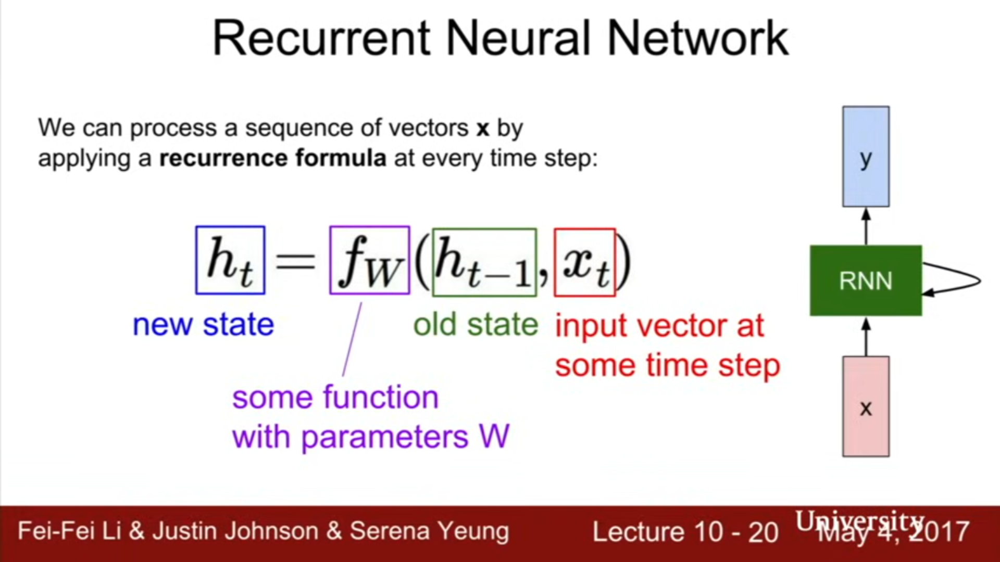

Where:
- `x_t` is the input at time step `t`,
- `h_{t-1}` is the hidden state from the previous time step,
- `W`, `U`, and `b` are learnable parameters,
- `f` is an activation function, typically `tanh` or `ReLU`.



> RNNs handle different types of sequence-to-sequence relationships:

![](https://goodboychan.github.io/images/copied_from_nb/image/various_rnn.png)

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/0*VO4DW_vN7ldqgEZg.png)


- **One-to-One**: A single input produces a single output. This is the simplest RNN architecture, also known as the Vanilla Neural Network. It is commonly used for regular machine learning tasks.
  
- **One-to-Many**: A single input produces multiple outputs. An example is **Image Captioning**, where one image (input) generates a sequence of words (output), or **Music Generation**, where a single musical note (input) generates a sequence of notes (output).

- **Many-to-One**: Multiple inputs produce a single output. This is common in tasks like **Sentiment Analysis**, where a sequence of words (input) results in a single sentiment (output).

- **Many-to-Many**: Multiple inputs produce multiple outputs.
  - **Tx = Ty**: The input and output sequences are of the same size. An example is **Named Entity Recognition (NER)**, where each input word has a corresponding output label.
  - **Tx ≠ Ty**: The input and output sequences are of different sizes. An example is **Machine Translation**, where a sentence in one language (input) is translated into a sentence in another language (output), which may have a different number of words.

![image.png](data:image/png;base64,)

These different RNN types are essential for solving a wide range of sequence-based tasks.

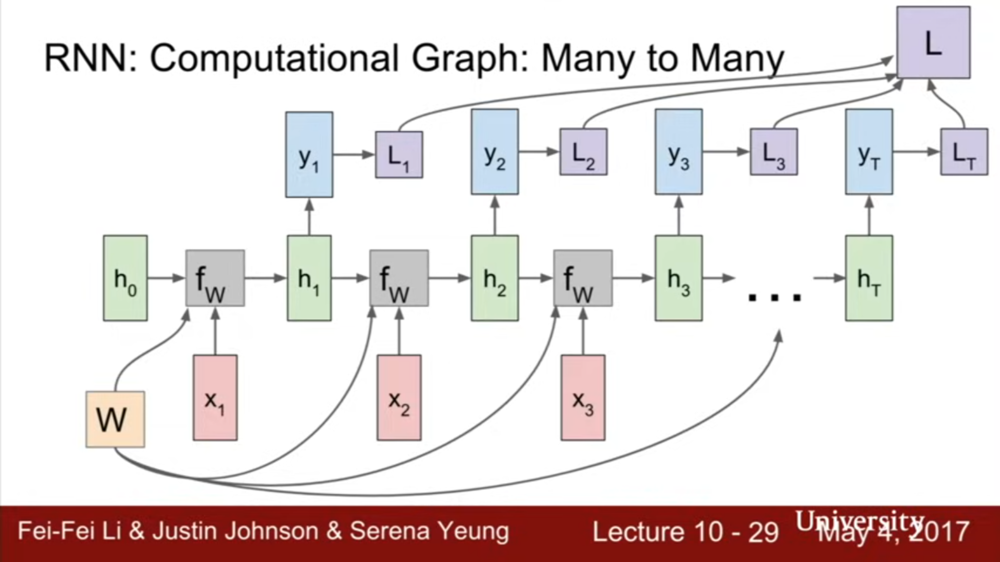

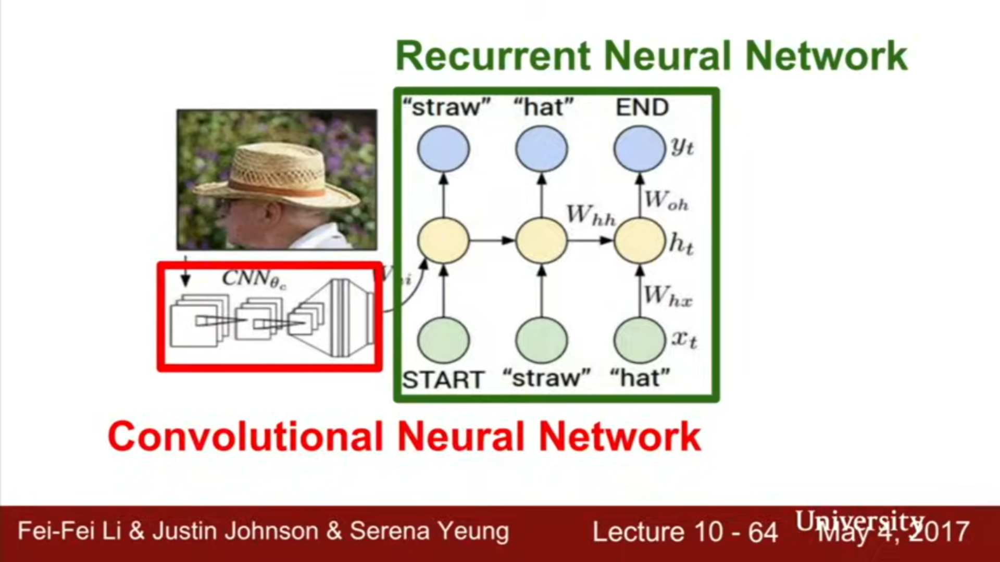



## **10.2 RNN Architecture and Mathematical Foundations**


### **10.2.1 What is the difference between the folded and unfolded representations of RNNs, and how does unrolling help in understanding them?**

**Recurrent Neural Networks (RNNs)** are designed to process sequential data and are derived from traditional Feed Forward Neural Networks. Unlike vanilla networks, RNNs have memory elements that allow them to remember previous outputs.

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*xkettaJKKiel3_OQ3DFDVQ.png)

They are called **"Recurrent"** because they perform the same task repeatedly for each element in a sequence, with each output depending on prior computations. This makes RNNs a significant improvement over vanilla networks, which are limited to fixed input sizes and only process current inputs.

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*ggFZwn7TExHCBy8ijTsCxQ.png)



### **10.2.2 How does Backpropagation Through Time (BPTT) work for RNNs, and what are its computational challenges?**

#### **How BPTT Works for RNNs:**
- **Unrolling the RNN:** The RNN is unrolled across all time steps, creating a computational graph for the sequence.
- **Forward Pass:** Inputs are processed to compute outputs and calculate the loss.
- **Backward Pass:** Errors are propagated backward through time using the chain rule to compute gradients.
- **Weight Updates:** Gradients from all time steps are accumulated to update the shared weights.

#### **Computational Challenges:**
1. **Vanishing and Exploding Gradients:**
   - Gradients can shrink or grow exponentially over long sequences, causing instability.
2. **High Computational Cost:**
   - Unrolling and processing long sequences require significant memory and time.
3. **Long-Term Dependencies:**
   - Gradients decay, making it hard to capture dependencies across many time steps.
4. **Limited Parallelism:**
   - Sequential processing restricts parallel computation.

BPTT is essential for RNN training but requires optimizations like gradient clipping or advanced architectures (e.g., LSTMs) to mitigate these challenges.


#### **Why RNNs?**

RNNs overcome limitations of traditional models by introducing "memory," enabling the processing of sequential data and retaining context across time steps. Here’s how RNNs differ:

#### **1. Handling Variable-Length Sequences**
RNNs can process sequences of arbitrary length using a hidden state, \( h_t \), at each time step \( t \), which captures information from all previous steps:

```markdown
h_t = f(h_{t-1}, x_t)
```

Where `( x_t )` is the input at time `( t )`, and `( f )` is a non-linear function (e.g., tanh or ReLU). Unlike n-grams, RNNs can consider all previous words in a sequence, capturing long-term dependencies.


### **Backpropagation Through Time (BPTT) for RNNs: Mathematical Perspective**

BPTT is a specific implementation of backpropagation for Recurrent Neural Networks (RNNs). It computes gradients for all time steps of the sequence by "unrolling" the network and applying standard backpropagation.

#### **Mathematical Overview:**

![](https://raw.githubusercontent.com/mmuratarat/mmuratarat.github.io/master/_posts/images/BPTT.png)

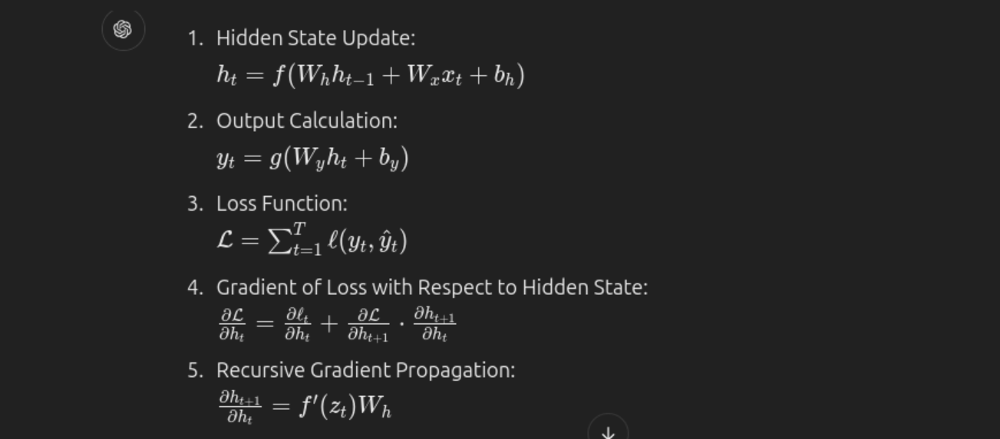



1. **Hidden State Update:**
   - **h_t**: The hidden state at time step t, representing the memory or context of the RNN up to that point.
   - **f**: A non-linear activation function (e.g., tanh or ReLU) applied to the weighted sum of the inputs and the previous hidden state.
   - **W_h**: The weight matrix applied to the previous hidden state h_(t-1).
   - **W_x**: The weight matrix applied to the current input x_t at time step t.
   - **b_h**: The bias term added to the weighted sum of the previous hidden state and the current input.

2. **Output Calculation:**
   - **y_t**: The output at time step t, computed by applying an output function (e.g., softmax) to the hidden state h_t.
   - **W_y**: The weight matrix applied to the hidden state h_t to compute the output.
   - **b_y**: The bias term added to the output calculation.

3. **Loss Function:**
   - **L**: The total loss function, summing individual losses at each time step t.
   - **l(y_t, ŷ_t)**: The loss function (e.g., cross-entropy loss) for the predicted output y_t and the target ŷ_t.

4. **Gradient of Loss with Respect to Hidden State:**
   - **∂L / ∂h_t**: The gradient of the total loss L with respect to the hidden state h_t at time step t.
   - **∂l_t / ∂h_t**: The gradient of the loss at time step t with respect to the hidden state h_t.
   - **∂L / ∂h_(t+1)**: The gradient of the total loss with respect to the hidden state at the next time step h_(t+1).
   - **∂h_(t+1) / ∂h_t**: The derivative of the next hidden state h_(t+1) with respect to the current hidden state h_t.

5. **Recursive Gradient Propagation:**
   - **∂h_(t+1) / ∂h_t**: The gradient of the next hidden state h_(t+1) with respect to the current hidden state h_t, calculated recursively during backpropagation.
   - **f'(z_t)**: The derivative of the activation function f with respect to the input z_t to the hidden state. This is used to calculate the gradient during backpropagation.  
   - **W_h**: The weight matrix applied during the recursive gradient calculation, propagating the error backward through the network.


#### **Gradient Calculation via BPTT:**

1. **Unrolling the RNN:**
   The RNN is unrolled into a sequence of \( T \) copies, with each copy representing one time step. Gradients are computed for each time step and accumulated.

2. **Recursive Gradient Calculation:**
   To compute the gradient of the loss with respect to the hidden state at time \( t \) is:
   

4. **Backpropagation Through Time Steps:**
   Gradients are propagated backward from \( T \) to \( 1 \), summing contributions from each time step.

#### **Challenges in BPTT:**
- **Vanishing/Exploding Gradients:** Gradients can diminish or explode when propagated over many time steps, affecting training stability.
- **High Computational Cost:** Unrolling and computing gradients for long sequences require significant memory and computation.

BPTT captures temporal dependencies by calculating gradients over the entire sequence, making it a powerful but resource-intensive method for training RNNs.





#### **2. Addressing the Data Sparsity Problem**
RNNs learn continuous word representations (embeddings) rather than relying on explicit counts like n-grams. This enables generalization to unseen word combinations and infers meaning from context, even for rare or new words.

#### **3. Memory and Contextual Awareness**
RNNs maintain memory through their hidden states, allowing them to model relationships between words over long distances. For example, in "The cat sat on the mat," the RNN can link "cat" and "mat" semantically despite their separation.

#### **How RNNs Work in Language Modeling**
- **Input Representation:** Words are represented as vectors (e.g., Word2Vec or GloVe embeddings) capturing semantic meanings.
- **Training RNNs:** RNNs predict the next word `( w_t )` in a sequence based on previous words:

```markdown
P(w_t | w_1, w_2, ..., w_{t-1}) = softmax(W h_t + b)
```

Where \( h_t \) is the hidden state, \( W \) is the weight matrix, and \( b \) is the bias.

- **Sequential Processing:** The RNN updates its hidden state for each word and generates a probability distribution for the next word.  
- **Backpropagation Through Time (BPTT):** BPTT propagates the prediction error backward through the sequence to adjust the network’s weights effectively.

RNNs' ability to model sequences, handle variable-length inputs, and learn contextual representations makes them a powerful tool for tasks like language modeling and sequence prediction.


### **10.2.3 What is Truncated Backpropagation Through Time, and how does it make training RNNs more efficient?**

**Truncated Backpropagation Through Time (TBPTT)** is a variation of the Backpropagation Through Time (BPTT) algorithm, specifically designed to make training Recurrent Neural Networks (RNNs) more computationally efficient.

![](https://ars.els-cdn.com/content/image/1-s2.0-S0959438818302009-gr2.jpg)

- **Key Idea:**  
  Instead of propagating errors backward through the entire sequence (as in standard BPTT), TBPTT splits the sequence into manageable chunks of a fixed length \( k \). Gradients are computed only for this truncated window, reducing the computational burden.

- **How it Works:**  
  1. The RNN processes the sequence in chunks of length \( k \).  
  2. Gradients are computed for each chunk and used to update the network's weights.  
  3. The hidden state is carried over between chunks, maintaining continuity across the sequence.

- **Benefits:**  
  - **Efficiency:** Reduces memory usage and computation time.  
  - **Scalability:** Makes it feasible to train RNNs on long sequences without running into hardware limitations.  

- **Limitation:**  
  - TBPTT may lose information about dependencies spanning beyond the truncated window, which can impact performance for tasks requiring long-term memory.

TBPTT strikes a balance between computational efficiency and capturing temporal dependencies, making it a practical choice for training RNNs on large-scale sequential data.



## **10.3 Applications of RNNs and LSTMs**


### **10.3.1 Overview of LSTM**

Long Short-Term Memory (LSTM) is a type of Recurrent Neural Network (RNN) designed to overcome the limitations of traditional RNNs, especially in capturing long-term dependencies in sequential data. LSTMs are widely used in applications such as language modeling, speech recognition, time-series prediction, and more, due to their ability to maintain and manage memory over long periods of time.

#### Key Features of LSTM:
1. **Memory Cells**: Unlike standard RNNs, which suffer from the vanishing gradient problem, LSTMs have memory cells that allow information to be stored and retrieved over long time spans, making it easier for them to capture long-term dependencies.

2. **Gates**: LSTMs use gates to regulate the flow of information into and out of memory cells:
   - **Forget Gate**: Decides what portion of the previous memory to forget.
   - **Input Gate**: Controls the amount of new information to store in the memory cell.
   - **Output Gate**: Determines what part of the memory to output as the current state.

3. **Cell State**: The memory cell's state is updated based on the input data and previous memory, enabling the model to retain important information while discarding irrelevant details.

4. **Activation Functions**: LSTM networks commonly use sigmoid functions for gating operations and hyperbolic tangent (tanh) for regulating the output values.

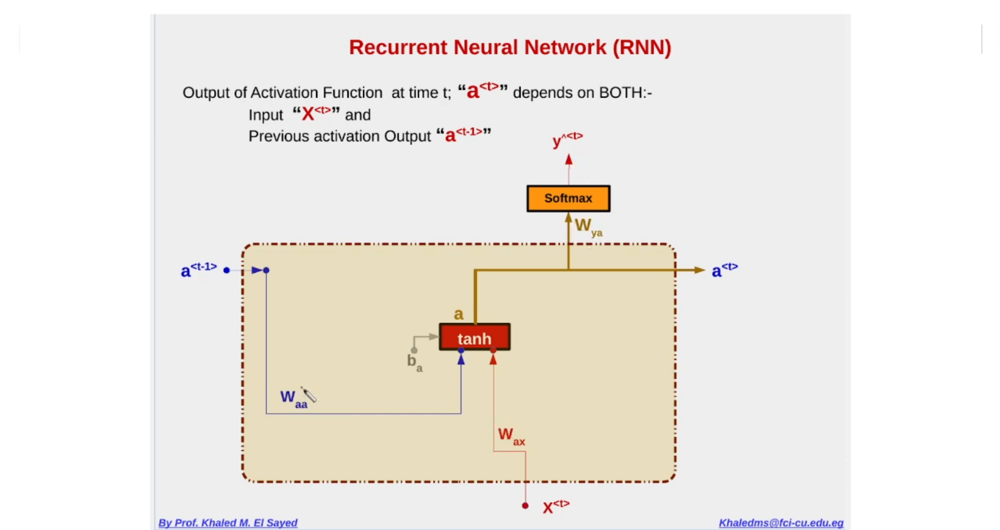

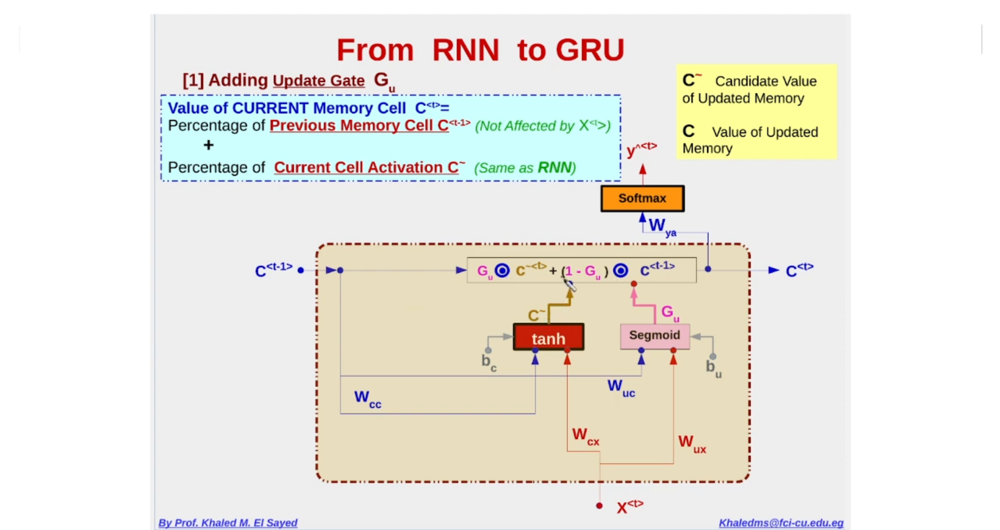




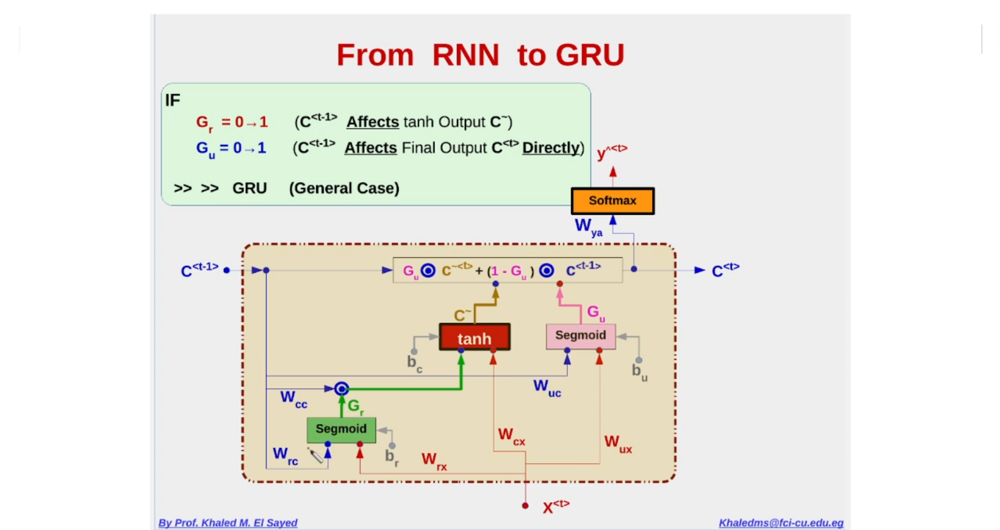

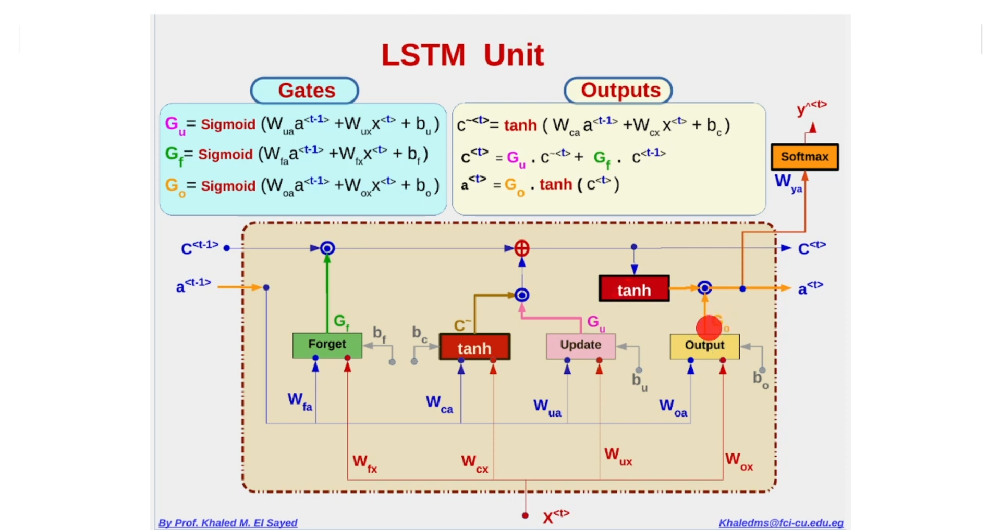


![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*AeKfV2uAPeMg9j8HhQZk2w.png)

LSTM networks are particularly powerful for tasks involving sequential data, where understanding long-term relationships between data points is essential.

### **10.3.2 RNN and LSTM Sequence Applications**

Recurrent Neural Networks (RNNs) and Long Short-Term Memory networks (LSTMs) are widely used for sequence-based applications. They excel in tasks where the order of the data points (i.e., time dependencies or temporal patterns) plays a crucial role. Here are several sequence-based applications for RNNs and LSTMs:

1. **Time Series Forecasting**  
   **Description**: Predicting future values based on historical data, such as stock prices, weather conditions, or energy consumption.  
   **Use Case**: Stock Market Prediction  
   **Problem**: Predict future stock prices based on previous prices.  
   **RNN/LSTM Advantage**: LSTMs can capture long-term dependencies and patterns in the stock price movement over time.  
   **Example**: Given a sequence of past stock prices, the model can predict the stock price for the next day.

2. **Natural Language Processing (NLP)**  
   RNNs and LSTMs are frequently used in NLP tasks because language relies on sequential data (e.g., sentences, words).

   - **Text Generation**  
     **Description**: Generating coherent text based on a given prompt, often used for creative writing, chatbots, or poetry generation.  
     **Use Case**: Poetry Generation  
     **Problem**: Generate a poem or text similar to a given dataset of poetry.  
     **RNN/LSTM Advantage**: LSTMs are effective in generating human-like text because they can remember long-range dependencies between words and phrases.  
     **Example**: Given an initial word or phrase, generate a sequence of words that form a poem or short story.

   - **Machine Translation**  
     **Description**: Translating sentences from one language to another, such as English to French, or vice versa.  
     **Use Case**: English to French Translation  
     **Problem**: Translate a sentence from English into French.  
     **RNN/LSTM Advantage**: LSTMs can handle long-term dependencies in sentences, making them suitable for tasks where words in the sentence must be understood in context.  
     **Example**: Given an English sentence "I am learning", generate the French translation "Je suis en train d'apprendre".

   - **Sentiment Analysis**  
     **Description**: Classifying the sentiment of a text (positive, negative, or neutral).  
     **Use Case**: Review Sentiment Analysis  
     **Problem**: Given a product review, classify whether it is positive or negative.  
     **RNN/LSTM Advantage**: LSTMs are well-suited for analyzing long, context-dependent text, such as identifying sentiment in reviews that may contain subtle cues.  
     **Example**: Classifying a review like "This product is amazing!" as positive.

3. **Speech Recognition**  
   **Description**: Converting spoken language into text. This task is crucial for virtual assistants, transcription services, and voice-activated applications.  
   **Use Case**: Voice to Text Transcription  
   **Problem**: Convert an audio recording of someone speaking into written text.  
   **RNN/LSTM Advantage**: LSTMs can capture long sequences of spoken words and map them to their corresponding text representations.  
   **Example**: Transcribing a sentence spoken in real-time, such as “Hello, how are you today?”

4. **Video and Image Captioning**  
   **Description**: Automatically generating a description for a given video or image by processing frames as a sequence.  
   **Use Case**: Image Captioning  
   **Problem**: Given an image, generate a descriptive caption for it.  
   **RNN/LSTM Advantage**: RNNs or LSTMs are used after a convolutional neural network (CNN) extracts features from the image, then generating the sequence of words that describe the image.  
   **Example**: Given an image of a dog playing in the park, the model generates the caption "A dog running in a grassy field."

5. **Anomaly Detection in Sequences**  
   **Description**: Identifying unusual patterns or outliers in sequences of data, which could be important in fields like security, finance, or healthcare.  
   **Use Case**: Fraud Detection  
   **Problem**: Detect unusual transaction patterns in banking or credit card data that might indicate fraud.  
   **RNN/LSTM Advantage**: LSTMs are capable of modeling sequential patterns in transaction data, making them effective for identifying anomalies based on previous sequences.  
   **Example**: If a customer's spending pattern suddenly changes significantly, the model can flag this as potential fraud.

6. **Speech Synthesis (Text-to-Speech, TTS)**  
   **Description**: Converting written text into spoken words. TTS systems can be powered by LSTMs to generate more natural and fluent speech.  
   **Use Case**: Voice Assistants  
   **Problem**: Generate natural-sounding voice responses from text.  
   **RNN/LSTM Advantage**: LSTMs can model the sequential nature of speech, allowing for more natural intonations and pauses in speech.  
   **Example**: Converting the text "Good morning, how can I help you?" into natural-sounding speech.

7. **Handwriting Recognition**  
   **Description**: Recognizing handwritten text by processing sequential pixel data from images.  
   **Use Case**: Digit Recognition  
   **Problem**: Recognize handwritten digits (like those in the MNIST dataset).  
   **RNN/LSTM Advantage**: LSTMs can process the sequence of pixel rows in a handwritten word or digit and learn the sequence of strokes.  
   **Example**: Given an image of a handwritten "7", classify it as the digit "7".

8. **Music Generation**  
   **Description**: Generating new music sequences (melodies, chords, etc.) based on a given style or pattern.  
   **Use Case**: Melody Generation  
   **Problem**: Generate a melody that follows a certain musical style (e.g., classical or jazz).  
   **RNN/LSTM Advantage**: LSTMs can model the long-term dependencies between notes in a melody, enabling the generation of coherent, musically valid sequences.  
   **Example**: Given a few notes from a classical melody, generate the rest of the melody.

9. **Activity Recognition**  
   **Description**: Recognizing the type of activity being performed based on sequential sensor data (such as from accelerometers or gyroscopes).  
   **Use Case**: Human Activity Recognition  
   **Problem**: Classify physical activities (e.g., walking, running, sitting) based on sensor data.  
   **RNN/LSTM Advantage**: LSTMs can recognize the patterns of motion in the sensor data over time, making them suitable for this application.  
   **Example**: Classifying a sequence of sensor readings as "walking" or "running" based on the patterns.

10. **Character-level Text Classification**  
    **Description**: Classifying text at the level of individual characters, which can be useful for tasks like language identification or detecting spam content.  
    **Use Case**: Language Identification  
    **Problem**: Classify the language of a given text sequence based on character patterns.  
    **RNN/LSTM Advantage**: RNNs and LSTMs can handle character-level features and sequential data effectively, identifying language based on the sequence of characters.  
    **Example**: Given a sentence, classify it as being in English, French, or German.

#### **Summary of RNN/LSTM Applications**:
- Time Series Forecasting (stock prices, weather)
- NLP Tasks (text generation, machine translation, sentiment analysis)
- Speech Recognition and Speech Synthesis
- Video/Image Captioning
- Anomaly Detection (fraud detection, network security)
- Handwriting Recognition and Music Generation
- Activity Recognition (e.g., from sensor data)
- Character-level Text Classification (e.g., language detection)

RNNs and LSTMs are highly versatile and can be applied to any problem where the data points are dependent on one another in a sequential manner. Their ability to capture long-term dependencies makes them the go-to models for tasks involving sequences.

### **10.3.3 How does a character-level language model work, and what are its advantages and challenges compared to word-level models?**

#### How a Character-Level Language Model Works

A character-level language model processes text as sequences of individual characters, rather than words or subwords. It predicts the next character in a sequence, one character at a time. Here's an overview of its functioning:

1. **Tokenization**: The text is split into individual characters (letters, digits, punctuation, spaces, etc.).
2. **Embedding**: Each character is represented as a vector using an embedding layer.
3. **Sequence Modeling**: Neural networks, such as RNNs (LSTM, GRU) or Transformers, learn dependencies between characters in the sequence.
4. **Prediction**: The model outputs probabilities for the next character based on the input sequence.
5. **Training**: The model minimizes a loss function (e.g., cross-entropy) by comparing predictions to actual next characters.

Once trained, the model generates text by sampling characters from its predictions and feeding them back as input.

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*ustZ-q5dwFEeW_hvZpCzCg.jpeg)

![](https://raw.githubusercontent.com/tejaslodaya/character-level-language-model/master/images/sample.png)

#### Advantages of Character-Level Models

1. **No Vocabulary Issues**:
   - Handles any text without requiring a predefined vocabulary or dealing with out-of-vocabulary words.
   - Avoids the need for complex tokenization rules, making it language-agnostic.

2. **Fine-Grained Understanding**:
   - Captures morphological nuances like prefixes, suffixes, and spelling variations.
   - Useful in specialized domains (e.g., chemical formulas, programming code, or handling typos).

3. **Compact Representation**:
   - A small character set reduces memory requirements for embeddings.

4. **Open-Vocabulary**:
   - Can generate rare or unseen words, useful for creative text generation tasks.


#### Challenges of Character-Level Models

1. **Longer Sequences**:
   - Characters lead to longer sequences compared to words, increasing computational complexity.
   - Makes learning long-term dependencies more difficult.

2. **Slower Training and Inference**:
   - Processing one character at a time is slower, especially for long text sequences.

3. **Difficulty Capturing Semantic Meaning**:
   - Characters alone lack inherent meaning, making semantic understanding harder.

4. **Error Propagation**:
   - Errors in character prediction compound over time, potentially producing nonsensical text.

5. **Resource Intensive**:
   - Requires large datasets and careful optimization to learn meaningful patterns.

#### Key Concepts of Character-Level Language Models

- **Character as Basic Unit**:
  - Instead of treating a word or token as the basic unit of the language, character-level models work with individual characters, which include letters, punctuation, numbers, and spaces.
  - For example, in the sentence "hello," the input sequence would be:
    ```
    h -> e -> l -> l -> o
    ```

- **Sequential Nature**:
  - Since language is sequential (the meaning of a word or sentence often depends on its context), these models maintain a sequence of characters and learn dependencies between them.
  - RNNs, LSTMs, and GRUs are typically used in character-level language models to learn these sequences.

- **Predicting Next Character**:
  - The model is trained to predict the probability distribution of the next character given the sequence of previous characters. For example:
    - Given the characters "hel," the model might predict the next character is "l" with high probability, since "hell" is a common sequence.

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/0*tPDYjf-hs8AwAD6J.png)

#### Architecture of Character-Level Language Models

A typical architecture for a character-level language model includes:

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/0*9LxR_80giSfC-a9N.png)

1. **Input Layer**:
   - Each character in the input sequence is represented as a one-hot vector, where only one element is 1 (representing the character), and the rest are 0.

2. **Embedding Layer (Optional)**:
   - Instead of one-hot encoding, some models use an embedding layer to represent characters in a continuous vector space, capturing semantic relationships between characters.

3. **Recurrent Layer (RNN, LSTM, GRU)**:
   - Processes the sequence of characters. Each time step corresponds to a character, and the RNN's hidden state updates based on the current character and the previous hidden state.

4. **Output Layer**:
   - Generates a probability distribution over all possible characters using a softmax activation function, predicting the next character.

5. **Loss Function**:
   - Minimizes the cross-entropy loss between the predicted character distribution and the actual next character in the sequence.


#### Training Process

1. **Input Sequence**:
   - A sequence of characters is provided to the model. For example:
     ```
     Input: "hel", Target: "l"
     ```
     The target sequence is the same as the input sequence but shifted by one character.

2. **Learning**:
   - The model learns to map the input sequence to a probability distribution of possible next characters.

3. **Backpropagation**:
   - Predictions are compared to actual target characters, and the error is backpropagated through the network to adjust the weights.

4. **Optimization**:
   - The weights are updated using an optimizer (e.g., Adam or SGD) to minimize the prediction error.


#### Comparison to Word-Level Models

| **Feature**                 | **Character-Level Models**       | **Word-Level Models**             |
|-----------------------------|----------------------------------|-----------------------------------|
| **Granularity**             | Fine (characters)               | Coarse (words or subwords)        |
| **Vocabulary**              | Small, fixed size               | Large, requires handling for unseen words |
| **Training Efficiency**     | Slower, longer sequences         | Faster, shorter sequences         |
| **Generality**              | Language-agnostic               | Requires language-specific tokenization rules |
| **Handling Unseen Text**    | Excellent, open-vocabulary       | Limited, unless using subword models |
| **Semantic Understanding** | Limited                         | Better contextual understanding   |

Character-level models are flexible and handle unseen or specialized text well. However, word-level models are typically more efficient and better at capturing semantic context.

In [ ]:
import numpy as np
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Activation
from tensorflow.keras.optimizers import Adam

# Prepare the dataset
text = "hello world"
chars = sorted(set(text))  # Find unique characters in the text
char_to_index = {ch: i for i, ch in enumerate(chars)}
index_to_char = {i: ch for i, ch in enumerate(chars)}

# Prepare input sequences and target characters
seq_length = 3
X = []
y = []

for i in range(len(text) - seq_length):
    X.append([char_to_index[ch] for ch in text[i:i+seq_length]])
    y.append(char_to_index[text[i+seq_length]])

X = np.array(X)
y = np.array(y)

# One-hot encode the target
y = to_categorical(y, num_classes=len(chars))

# Define the model
model = Sequential()
model.add(LSTM(128, input_shape=(X.shape[1], 1)))
model.add(Dense(len(chars)))
model.add(Activation('softmax'))

# Compile the model
model.compile(loss='categorical_crossentropy', optimizer=Adam(learning_rate=0.01))

# Reshape input data to fit the LSTM
X = np.expand_dims(X, axis=-1)

# Train the model
model.fit(X, y, epochs=40, batch_size=32)

# Generate text
def generate_text(model, seed, length=10):
    generated_text = seed
    for _ in range(length):
        input_seq = [char_to_index[ch] for ch in seed]
        input_seq = np.expand_dims(input_seq, axis=0)
        input_seq = np.expand_dims(input_seq, axis=-1)

        predicted_char_index = np.argmax(model.predict(input_seq), axis=-1)[0]
        predicted_char = index_to_char[predicted_char_index]

        generated_text += predicted_char
        seed = seed[1:] + predicted_char  # Shift seed for next prediction

    return generated_text

# Generate new text from a seed
seed = "hel"
generated = generate_text(model, seed, length=10)
print(f"Generated text: {generated}")


Epoch 1/40
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step - loss: 2.1356
Epoch 2/40
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - loss: 1.8921
Epoch 3/40
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 1.7669
Epoch 4/40
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 1.6902
Epoch 5/40
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - loss: 1.6123
Epoch 6/40
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - loss: 1.5370
Epoch 7/40
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 1.4538
Epoch 8/40
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 1.3474
Epoch 9/40
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - loss: 1.2300
Epoch 10/40
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - loss: 1.1223
Epoch 11/40
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 1.0045
Epoch 12/40
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step - loss: 0.9063
Epoch 13/40
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - loss: 0.8126
Epoch 14/40
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - loss: 0.7311
Epoch 15/40
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step - loss: 0.6553
Epoch 16/40
1/1 ━━━━━━━━━━━━━━━━━━━━

### **10.3.4 Transitioning from RNN to LSTM: Practical Steps and Key Scenarios**

Recurrent Neural Networks (RNNs) and Long Short-Term Memory networks (LSTMs) are sequence-modeling neural networks designed to handle temporal dependencies in data. While RNNs excel in modeling short-term dependencies, they face limitations with long-term dependencies due to issues like vanishing gradients. LSTMs were introduced to address these shortcomings, making them better suited for tasks requiring the capture of long-term relationships.

#### **1. Key Features of RNN and LSTM**

| Feature               | RNN                                      | LSTM                                           |
|-----------------------|------------------------------------------|------------------------------------------------|
| **Memory**            | Limited to short-term dependencies      | Effective in retaining long-term memory       |
| **Training Stability**| Prone to vanishing and exploding gradients | Resolves vanishing gradient issues with gates |
| **Architecture**      | Simple                                  | Complex (gating mechanisms)                   |
| **Performance**       | Works well for short sequences          | Excels with long-term dependencies            |
| **Training Time**     | Faster but less effective on long tasks | Slower but more robust                        |

#### **2. Steps to Transition from RNN to LSTM**

##### **Step 1: Understand Architectural Differences**
- **RNN:**
  - Maintains a single hidden state updated at each time step.
  - Suffers from vanishing gradients, limiting memory to short sequences.
- **LSTM:**
  - Introduces gates (Forget, Input, and Output) to control information flow.
  - Retains long-term dependencies through a cell state.

##### **Step 2: Modify the Architecture**
Replace the RNN layer with an LSTM layer in your code. This is straightforward with libraries like TensorFlow or PyTorch.

```python
from tensorflow.keras.layers import SimpleRNN, LSTM

# Vanilla RNN
model.add(SimpleRNN(units=128, input_shape=(timesteps, features)))

# Transition to LSTM
model.add(LSTM(units=128, input_shape=(timesteps, features)))
```
### **Step 3: Adjust Input and Output Handling**

- **Ensure input dimensions remain compatible:**
  - Input shape for LSTMs: `(batch_size, timesteps, features)`
- **Configure the output:**
  - Return a sequence of outputs: `return_sequences=True`
  - Return only the final output: `return_sequences=False`

### **Step 4: Tune Hyperparameters**

- **Learning Rate:** Lower it slightly for better convergence.
- **Batch Size:** Smaller batches may improve stability.
- **Dropout:** Add dropout layers to prevent overfitting.

### **Step 5: Optimize Training**

- **Gradient Clipping:** Prevent exploding gradients.
- **Efficient Batching:** Leverage parallel processing to speed up training.

### **Scenarios Where Transition to LSTM Is Essential**

1. **Long-Term Dependencies:**
   - Crucial for tasks like language modeling, translation, and time-series forecasting.
   - RNNs fail to retain context over extended sequences.

2. **Noisy or Complex Data:**
   - LSTMs selectively retain relevant information, discarding noise.

3. **Avoiding Vanishing Gradients:**
   - LSTMs ensure gradient flow through gating mechanisms.

4. **Structured Sequence Generation:**
   - Applications like text or music generation rely on long-term dependencies.


### **Code Example: Transitioning from RNN to LSTM**

```python
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import SimpleRNN, LSTM, Dense

# Vanilla RNN
vanilla_rnn = Sequential([
    SimpleRNN(units=128, input_shape=(timesteps, features)),
    Dense(units=output_dim, activation='softmax')
])

# LSTM
lstm_model = Sequential([
    LSTM(units=128, input_shape=(timesteps, features)),
    Dense(units=output_dim, activation='softmax')
])

# Compilation
vanilla_rnn.compile(optimizer='adam', loss='categorical_crossentropy')
lstm_model.compile(optimizer='adam', loss='categorical_crossentropy')
```


## **10.4 Mathematics and Gradient Analysis**


### **10.4.1 What are the Mathematical Differences Between Vanilla RNNs and LSTMs, Particularly in Gradient Calculations?**

#### **1. Gradient Calculation in Vanilla RNNs**
- **Vanilla RNN Equations:**

![](https://kharshit.github.io/img/gradient_flow_rnn.png)

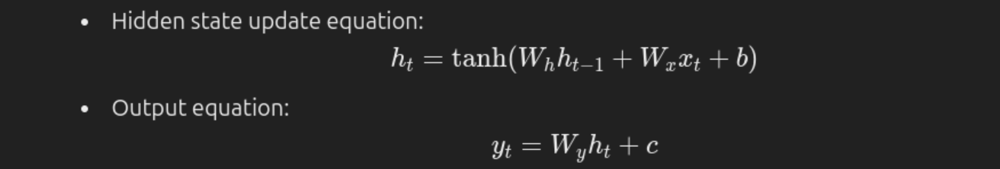

- **Challenges in Gradient Flow:**
  - Gradients of the loss with respect to earlier time steps decay exponentially due to repeated multiplication with the recurrent weight matrix \( W_h \).
  - **Vanishing Gradient Problem:**  
    - \( W_h \) typically has eigenvalues less than 1, causing gradients to shrink over long sequences.
  - **Exploding Gradient Problem:**  
    - If \( W_h \) has eigenvalues greater than 1, gradients can grow uncontrollably.

#### **2. Gradient Calculation in LSTMs**
- **LSTM Equations:**

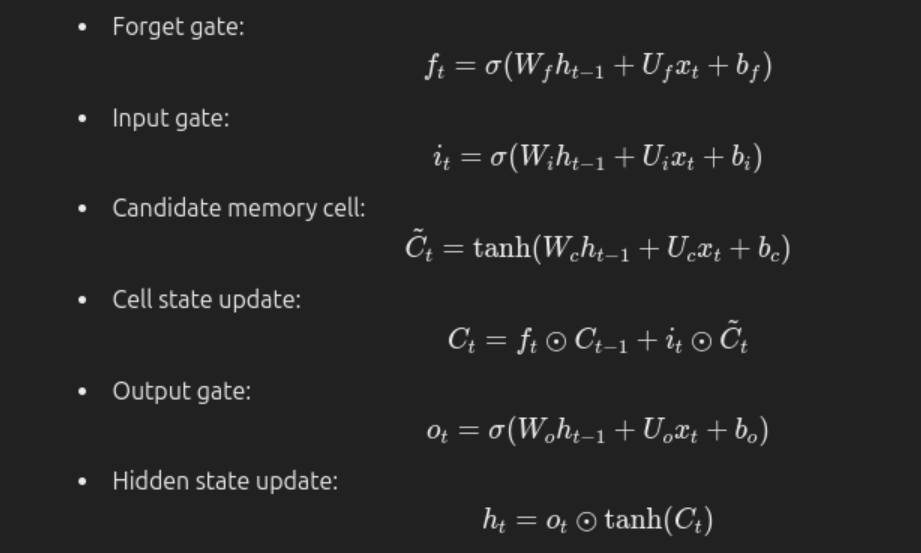

- **Improvements in Gradient Flow:**
  - The **cell state \( C_t \)** acts as a long-term memory with linear updates controlled by the forget and input gates.
  - Gradients can flow through the cell state without vanishing because of direct additive updates in:

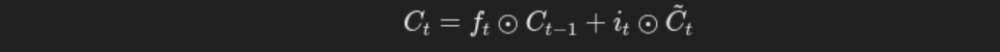

- **Key Features:**
  - **Forget Gate:** Allows selective forgetting of irrelevant information.
  - **Input Gate:** Controls how much new information is added.
  - **Gradient Preservation:** The gating mechanism ensures gradients do not vanish or explode.

![](https://kharshit.github.io/img/gradient_flow_lstm.png)

#### **3. Summary of Differences**
| Aspect                     | Vanilla RNNs                                   | LSTMs                                          |
|----------------------------|-----------------------------------------------|-----------------------------------------------|
| **Memory Mechanism**       | Single hidden state                           | Separate hidden state and cell state          |
| **Gradient Flow**          | Prone to vanishing/exploding gradients        | Gated updates preserve gradients              |
| **Long-Term Dependencies** | Struggles with retention                      | Efficiently handles long-term dependencies    |
| **Architecture**           | Simpler with fewer gates                      | Complex with input, forget, and output gates  |

#### **Conclusion**
The mathematical differences between vanilla RNNs and LSTMs lie primarily in how they handle gradients during backpropagation. While RNNs suffer from vanishing and exploding gradients, LSTMs use gating mechanisms to preserve gradient flow, making them more suitable for tasks involving long-term dependencies.


### **10.4.2 How do Vanishing and Exploding Gradients Affect RNN Training, and How Does LSTM Mitigate These Issues Through Its Gating Mechanisms?**


#### 1. Impact of Vanishing and Exploding Gradients on RNN Training

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/0*pfDZQ6GIiZ0MGHjG.jpeg)

##### **Vanishing Gradients:**
- **Cause:**
  - Gradients are calculated by repeatedly multiplying with weight matrices during backpropagation through time (BPTT).
  - When the eigenvalues of the recurrent weight matrix \( W_h \) are less than 1, the gradients decay exponentially over time.

- **Effect:**
  - **Difficulty in Learning Long-Term Dependencies:**
    - Early layers or time steps receive nearly zero gradients, leading to ineffective updates.
  - The model becomes biased toward capturing short-term patterns, ignoring long-term context.

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/0*ET_iHvyIb0eNBzD9.jpeg)

##### **Exploding Gradients:**
- **Cause:**
  - If the eigenvalues of \( W_h \) are greater than 1, the gradients grow exponentially during BPTT.

- **Effect:**
  - **Unstable Training:**
    - Gradients become excessively large, causing erratic updates to weights.
  - Leads to divergence of the loss function, making training ineffective.

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/0*SKflG0ykj6EWPnm4.jpeg)


#### 2. Truncated BPTT in RNN and LSTM

To address computational inefficiencies and mitigate gradient issues in very long sequences, Truncated Backpropagation Through Time (TBPTT) is often used for both RNNs and LSTMs.

##### **What is Truncated BPTT?**
- Instead of performing backpropagation over the entire sequence, TBPTT divides the sequence into smaller, manageable chunks of fixed length.
- Gradients are calculated and updated for each chunk, reducing computational complexity and memory requirements.

##### **TBPTT in Vanilla RNNs:**
- **Benefits:**
  - Reduces computational load, enabling training on long sequences.
- **Challenges:**
  - Gradient vanishing or exploding still persists within each chunk.
  - Limited effectiveness for very long-term dependencies since gradients don’t propagate across chunk boundaries.

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/0*ctBCh2RrzCY4zvrV.jpeg)

##### **TBPTT in LSTMs:**
- **Advantages over RNNs:**
  - LSTMs’ gating mechanisms preserve relevant information across chunks via the cell state.
  - Even with TBPTT, LSTMs handle long-term dependencies better than RNNs.
- **Key Benefit:**
  - The cell state’s linear updates allow gradient flow across boundaries, making LSTMs more robust in chunked training scenarios.



#### 3. How LSTM Mitigates These Issues Through Gating Mechanisms

LSTMs address vanishing and exploding gradients using a specialized architecture that includes gating mechanisms to control the flow of information.

##### **Key Components in LSTM:**

1. **Three Gating Mechanisms**
   - **Forget Gate**: Decides what to forget from the cell state.  

   - **Input Gate**: Decides what new information to store in the cell state.  

   - **Output Gate**: Decides what to output from the cell state.

![](https://www.researchgate.net/publication/330890239/figure/fig1/AS:723133304676353@1549419823273/Basic-structure-of-a-long-short-term-memory-LSTM-unit.jpg)


2. **Input Vector and Cell State**
   - At each time step `( t )`, the input is a combination of the previous hidden state `( h_{t-1} )` and the current input `( x_t )`.
   - The **cell state** `( C_t )` carries long-term information through the sequence.
![](https://www.researchgate.net/publication/360772511/figure/fig2/AS:1173216244572160@1656727958674/Main-components-of-an-LSTM-cell-Le-et-al-2019.png)

##### **How LSTM Solves the Gradient Problems:**


- **Gradient Calculation**:  
  In traditional RNNs, gradients tend to vanish over time due to repeated multiplication by small numbers. In contrast, LSTMs use a more complex structure that includes the forget gate, input gate, and output gate, which helps maintain a more stable gradient over long sequences.

- **Additive Gradient Structure**:  
  The cell state \( C_t \) in LSTMs is designed to be updated in an additive manner. This allows for a more controlled gradient flow, reducing the risk of gradients vanishing or exploding.

- **Forget Gate's Role**:  
  The forget gate in LSTMs allows the network to decide what information should be kept or discarded. This selective memory helps prevent the gradients from decaying too quickly during backpropagation.



#### 3. Summary: Advantages of LSTM Over Vanilla RNNs

| Problem                | RNN Limitation                               | LSTM Solution                                    |
|------------------------|-----------------------------------------------|-------------------------------------------------|
| **Vanishing Gradients** | Gradients decay over long sequences.          | Linear cell state updates preserve gradients.   |
| **Exploding Gradients** | Gradients grow uncontrollably in BPTT.        | Gating mechanisms regulate information flow.    |
| **Long-Term Memory**    | Cannot retain long-term dependencies.         | Maintains memory through forget/input gates.    |

---

### **Conclusion**

Vanishing and exploding gradients significantly hinder the training of vanilla RNNs by affecting their ability to learn long-term dependencies and maintain stable weight updates. LSTMs, with their gating mechanisms and linear cell state updates, effectively mitigate these issues, enabling stable training and improved performance on tasks involving sequential data.


In [ ]:
# Code Example of TBPTT

import torch
import torch.nn as nn
import torch.optim as optim

# Example RNN model
class RNNModel(nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(RNNModel, self).__init__()
        self.rnn = nn.RNN(input_size, hidden_size, batch_first=True)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x, h):
        out, h = self.rnn(x, h)
        out = self.fc(out)
        return out, h

# Hyperparameters
input_size = 1
hidden_size = 50
output_size = 1
chunk_size = 10
sequence_length = 100
batch_size = 1
epochs = 100

# Data
x = torch.randn(batch_size, sequence_length, input_size)  # Random input sequence
y = torch.randn(batch_size, sequence_length, output_size)  # Random target sequence

# Model, loss, optimizer
model = RNNModel(input_size, hidden_size, output_size)
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.01)

# Training with TBPTT
for epoch in range(epochs):
    h = None  # Initialize hidden state
    total_loss = 0

    # Split sequence into chunks
    for t in range(0, sequence_length, chunk_size):
        x_chunk = x[:, t:t+chunk_size, :]
        y_chunk = y[:, t:t+chunk_size, :]

        # Forward pass
        optimizer.zero_grad()
        output, h = model(x_chunk, h)

        # Detach hidden state to truncate backpropagation
        h = h.detach()

        # Compute loss
        loss = criterion(output, y_chunk)
        total_loss += loss.item()

        # Backward pass and update
        loss.backward()
        optimizer.step()

    print(f"Epoch {epoch+1}/{epochs}, Loss: {total_loss:.4f}")


Epoch 1/100, Loss: 8.4443
Epoch 2/100, Loss: 8.3756
Epoch 3/100, Loss: 7.9196
Epoch 4/100, Loss: 8.1453
Epoch 5/100, Loss: 7.7978
Epoch 6/100, Loss: 7.8164
Epoch 7/100, Loss: 7.7642
Epoch 8/100, Loss: 8.0138
Epoch 9/100, Loss: 7.8490
Epoch 10/100, Loss: 7.8393
Epoch 11/100, Loss: 7.6654
Epoch 12/100, Loss: 7.7241
Epoch 13/100, Loss: 8.0942
Epoch 14/100, Loss: 7.9456
Epoch 15/100, Loss: 7.7633
Epoch 16/100, Loss: 8.1042
Epoch 17/100, Loss: 8.0120
Epoch 18/100, Loss: 7.8707
Epoch 19/100, Loss: 7.8150
Epoch 20/100, Loss: 7.6554
Epoch 21/100, Loss: 7.4299
Epoch 22/100, Loss: 7.7139
Epoch 23/100, Loss: 7.4728
Epoch 24/100, Loss: 7.8772
Epoch 25/100, Loss: 7.7620
Epoch 26/100, Loss: 7.3801
Epoch 27/100, Loss: 7.0201
Epoch 28/100, Loss: 7.2954
Epoch 29/100, Loss: 7.0670
Epoch 30/100, Loss: 6.9311
Epoch 31/100, Loss: 7.5510
Epoch 32/100, Loss: 7.0613
Epoch 33/100, Loss: 7.0881
Epoch 34/100, Loss: 5.9670
Epoch 35/100, Loss: 5.9762
Epoch 36/100, Loss: 6.4609
Epoch 37/100, Loss: 8.7034
Epoch 38/1

In [ ]:
# Example: PyTorch LSTM

import torch
import torch.nn as nn

# Define LSTM Model
class LSTMModel(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, num_layers=1):
        super(LSTMModel, self).__init__()
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x, h):
        out, (h_n, c_n) = self.lstm(x, h)  # LSTM forward pass
        out = self.fc(out[:, -1, :])       # Fully connected layer on last output
        return out, (h_n, c_n)

# Parameters
input_size = 10  # Number of features
hidden_size = 50  # Number of hidden units
output_size = 1   # Regression output
sequence_length = 20
batch_size = 32

# Instantiate Model
model = LSTMModel(input_size, hidden_size, output_size)
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.01)

# Dummy Data
x = torch.randn(batch_size, sequence_length, input_size)
y = torch.randn(batch_size, output_size)

# Training Step
h = None  # Initialize hidden and cell states
for epoch in range(40):
    optimizer.zero_grad()
    output, h = model(x, h)
    h = tuple([state.detach() for state in h])  # Detach hidden states for TBPTT
    loss = criterion(output, y)
    loss.backward()
    optimizer.step()
    print(f"Epoch {epoch+1}, Loss: {loss.item():.4f}")


Epoch 1, Loss: 1.5337
Epoch 2, Loss: 1.4582
Epoch 3, Loss: 1.3883
Epoch 4, Loss: 1.3025
Epoch 5, Loss: 1.1882
Epoch 6, Loss: 1.0474
Epoch 7, Loss: 0.8917
Epoch 8, Loss: 0.7231
Epoch 9, Loss: 0.5761
Epoch 10, Loss: 0.4274
Epoch 11, Loss: 0.3670
Epoch 12, Loss: 0.2628
Epoch 13, Loss: 0.1863
Epoch 14, Loss: 0.1622
Epoch 15, Loss: 0.1404
Epoch 16, Loss: 0.1199
Epoch 17, Loss: 0.1045
Epoch 18, Loss: 0.0942
Epoch 19, Loss: 0.0823
Epoch 20, Loss: 0.0665
Epoch 21, Loss: 0.0479
Epoch 22, Loss: 0.0333
Epoch 23, Loss: 0.0271
Epoch 24, Loss: 0.0254
Epoch 25, Loss: 0.0244
Epoch 26, Loss: 0.0218
Epoch 27, Loss: 0.0183
Epoch 28, Loss: 0.0164
Epoch 29, Loss: 0.0163
Epoch 30, Loss: 0.0151
Epoch 31, Loss: 0.0114
Epoch 32, Loss: 0.0076
Epoch 33, Loss: 0.0062
Epoch 34, Loss: 0.0068
Epoch 35, Loss: 0.0073
Epoch 36, Loss: 0.0067
Epoch 37, Loss: 0.0056
Epoch 38, Loss: 0.0052
Epoch 39, Loss: 0.0054
Epoch 40, Loss: 0.0056




## **10.5 Advanced Topics: Attention Mechanisms and Applications**


### **10.5.1 How Does Image Captioning with Attention Work, and Why Is Attention Critical in Tasks Involving Both Vision and Language?**

Image captioning with attention involves generating descriptive text based on the content of an image. This task combines vision and language processing, which makes it challenging as it requires not only understanding the image but also generating coherent natural language descriptions. Attention mechanisms play a critical role in improving the performance of these systems, particularly when tasks involve both vision and language.

![](https://raw.githubusercontent.com/yunjey/pytorch-tutorial/master/tutorials/03-advanced/image_captioning/png/model.png)


#### **1. Image Captioning Process**

The typical pipeline for image captioning can be broken down into the following steps:

- **Feature Extraction**: The image is passed through a pre-trained convolutional neural network (CNN), such as ResNet or Inception, to extract high-level features that represent different aspects of the image.
  
- **RNN or LSTM for Language Generation**: Once the image features are extracted, a Recurrent Neural Network (RNN), often an LSTM (Long Short-Term Memory) network, is used to generate the caption, one word at a time. The RNN is trained to predict the next word in the sequence, conditioned on the previous words and image features.

- **Attention Mechanism**: Attention mechanisms allow the model to focus on different parts of the image at each time step while generating the caption. Instead of treating the image as a single vector, the attention mechanism enables the model to "attend" to specific regions of the image that are most relevant to the current word being generated.



#### **2. How Attention Works in Image Captioning**

- **Encoder-Decoder Architecture**: In the encoder-decoder framework, the image is first processed by an encoder (CNN) to obtain feature representations. The decoder (RNN/LSTM) generates words sequentially. However, instead of using a fixed representation of the entire image, the attention mechanism allows the decoder to focus on different parts of the image for each word it generates.

- **Attention Weights**: At each decoding step, attention weights are computed based on the current state of the decoder and the image features. These weights determine how much focus each part of the image should get for generating the next word. The image features are weighted and summed to create a context vector, which is then passed to the decoder to produce the next word.

  Mathematically:

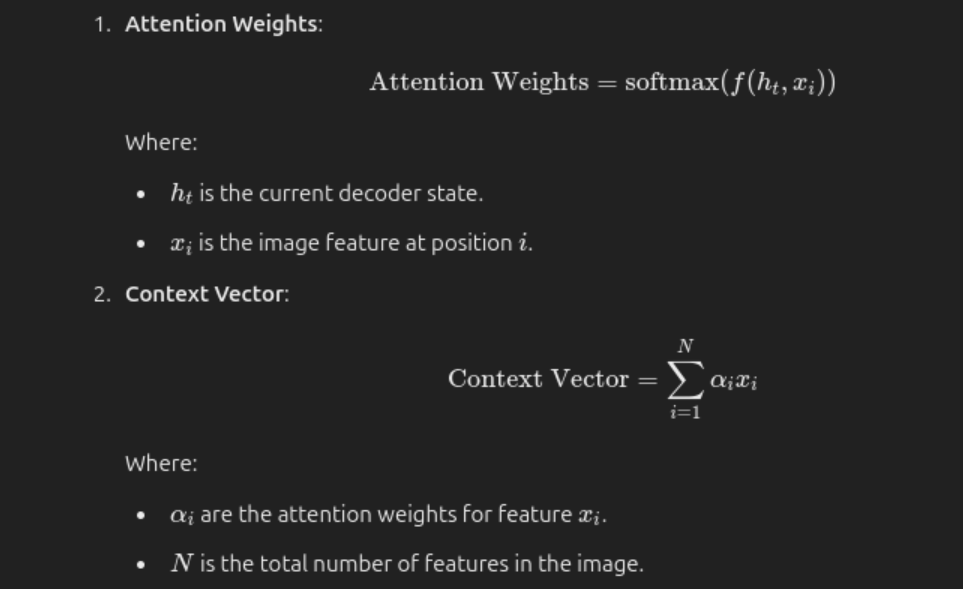

  The context vector is used by the RNN to predict the next word in the caption.


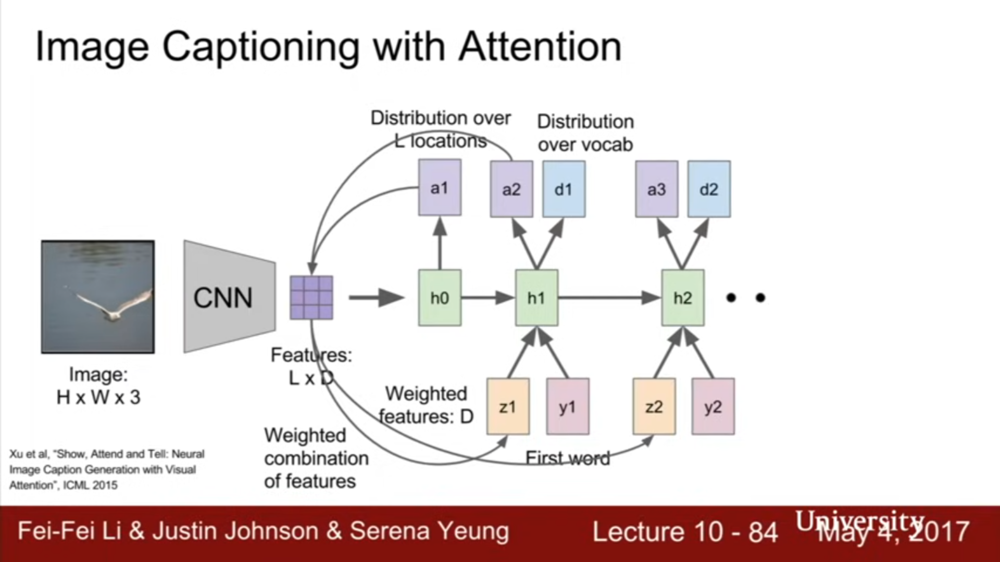


#### **3. Why is Attention Critical in Vision-Language Tasks?**

**Case-1 Without Attention**
- **Image Captioning Systems:**
  - Use an **encoder-decoder** structure for end-to-end training.
  
- **Encoder (Image Feature Extraction):**
  - Typically a **CNN (Convolutional Neural Network)**.
  - Pre-trained models on ImageNet, such as:
    - VGGNet
    - ResNet
    - Inception V3
  - The **classifier layer** is skipped, and the **feature map** is extracted for captioning.

- **Decoder (Language Model):**
  - Usually an **LSTM (Long Short-Term Memory)** or other RNN-based models.
  - Takes image features and generates captions based on previous hidden state and predicted words.
  - Process continues until the **"<eos>" (end of sequence)** token is predicted.

![](https://cdn.dida.do/blog/20220530_mk_image_captioning_with_attention/encoder-decoder.png)

- **Transfer Learning:**
  - CNNs are not trained from scratch; pre-trained models are used to extract image features.
  - ImageNet-trained models generalize well for various computer vision tasks.
  
- **Sequence Generation:**
  - The decoder receives the **"<sos>" (start of sequence)** token and generates the caption word-by-word.

![](https://cdn.dida.do/blog/20220530_mk_image_captioning_with_attention/lstm.png)

**Case-2 With Attention**
- **Image Captioning with Attention:**
  - Attention mechanism enhances image captioning by allowing the algorithm to focus on important parts of the image and ignore redundant content.
  - **Attention** is a weighted sum of encoder outputs, helping the model focus on relevant image areas.

![](https://cdn.dida.do/blog/20220530_mk_image_captioning_with_attention/encoder-decoder-attn.png)

- **How Attention Works:**
  - The **CNN** processes the image and outputs **feature maps**.
  - The **attention module** uses these feature maps and the hidden state to assign weights to image pixels.
  - These weighted features are concatenated with the input word for that time step and passed to the **LSTM** for generating the caption.

- **Improved Alignment Between Vision and Language:**
  - Attention aligns specific image regions with corresponding words in the caption. For example, when generating the word "dog," the model focuses on the dog in the image, and when generating "tree," it focuses on the tree.

- **Handling Ambiguities:**
  - Attention helps disambiguate contexts in tasks like image captioning or visual question answering, focusing on different parts of the image based on the current word or question.

- **Contextual Understanding:**
  - Attention allows the model to generate more contextually appropriate captions. Instead of a generic caption like "A person is standing," it can generate more detailed ones like "A person is standing near a tree."

- **Visualization of Attention Weights:**
  - Visualizes which parts of the image the model focuses on during word generation.
  - Example:
    - When generating "frisbee," attention focuses on the frisbee in the image.
    - When generating "woman," attention highlights the woman in the image.
    
#### **4. Benefits of Attention in Vision-Language Tasks**

- **Better Performance**: Attention mechanisms allow models to achieve state-of-the-art results in various vision-language tasks, such as image captioning, visual question answering (VQA), and visual grounding.
  
- **Interpretability**: Attention provides interpretability by showing which parts of the image were considered most important for generating a particular word or phrase. This makes the model's decision-making process more transparent.

- **Adaptability**: The attention mechanism makes models adaptable to different types of images and tasks by allowing them to focus on different visual elements based on the task at hand.

#### **Summary**

Attention mechanisms are critical in image captioning and other vision-language tasks because they enable the model to focus on specific parts of the image, improving the accuracy and relevance of the generated captions. By allowing the model to dynamically adjust its focus, attention improves the alignment between visual and textual information, leading to better performance in tasks that require understanding both vision and language.


### **10.5.2 Attention Types: Key Differences and Suitable Scenarios**

![](https://substackcdn.com/image/fetch/w_1272,c_limit,f_webp,q_auto:good,fl_progressive:steep/https%3A%2F%2Fsubstack-post-media.s3.amazonaws.com%2Fpublic%2Fimages%2Fdb5fee80-7ead-4b42-8e5f-6e5e33cf8b4d_3336x998.png)

1. **Global (Soft) Attention**:  
   - **Definition**: In soft attention, the model computes a weighted sum of all possible inputs (features), where the weights are determined by an attention mechanism. This allows the model to attend to all parts of the input sequence or image, with varying importance, through a differentiable process.
   - **How it works**: The attention weights are continuous, and the model attends to all parts of the input in a smooth and differentiable manner, allowing gradients to flow back during training.
   - **Mathematical Formulation**: The attention weights (αᵢ) are calculated using a softmax function, and the context vector is a weighted sum of the input features xᵢ:
     - Context Vector = ∑ (αᵢ * xᵢ)
   - **Advantages**: Soft attention is easy to train because it is differentiable and works well with gradient-based optimization methods. It is often used in models like image captioning and machine translation, where the model can learn to focus on different parts of the input as required.
   - **Suitable Scenarios**: Soft attention is suitable for most tasks, including machine translation, image captioning, and speech recognition, where the model benefits from considering all input features with varying attention.
   
2. **Local (Hard) Attention**:  
   - **Definition**: Hard attention, on the other hand, selects a discrete subset of the input (e.g., a specific region of an image or a word in a sentence) to attend to at each time step. This process is non-differentiable and requires techniques like reinforcement learning to train the model.
   - **How it works**: In hard attention, the model makes discrete choices about which part of the input to attend to, effectively "picking" specific parts of the input. This introduces a challenge for gradient-based optimization since the attention mechanism is not differentiable.
   - **Mathematical Formulation**: The selection process involves a sampling operation, where the model chooses specific inputs at each time step, rather than computing a weighted sum.
   - **Advantages**: Hard attention can reduce computational cost because it focuses only on certain parts of the input at each time step. It can also help the model better emulate human-like attention, which is typically selective rather than diffuse.
   - **Suitable Scenarios**: Hard attention is more suitable for tasks where it is important to focus on specific parts of the input at each step, such as visual question answering, object detection, or tasks requiring a more fine-grained focus on certain regions of an image or sequence.

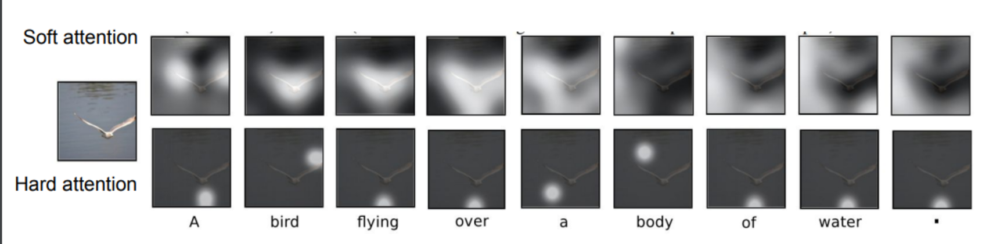

3. **Self-Attention "Transformers"**:  
   - Also known as intra-attention, this mechanism allows different positions within a single sequence to attend to each other.
   - It is a key component of transformer models, enabling efficient sequence-to-sequence learning without relying on recurrent layers.

![](https://substackcdn.com/image/fetch/w_1272,c_limit,f_webp,q_auto:good,fl_progressive:steep/https%3A%2F%2Fsubstack-post-media.s3.amazonaws.com%2Fpublic%2Fimages%2F576078bb-77e3-4886-9724-73a37ee0dc80_3337x1196.png)

4. **Multi-Head Attention**:  
   - This approach extends self-attention by allowing the model to focus on different parts of the input data from different representation subspaces.
   - It provides a richer understanding of the data, helping the model capture various aspects of the input data simultaneously.

![](https://substackcdn.com/image/fetch/w_1272,c_limit,f_webp,q_auto:good,fl_progressive:steep/https%3A%2F%2Fsubstack-post-media.s3.amazonaws.com%2Fpublic%2Fimages%2Fd4e175ed-7fe0-43a1-b14e-ba90a8ec1e25_3326x1160.png)

### **Comparison**:

| **Aspect**            | **Soft Attention**                                | **Hard Attention**                        |
|-----------------------|---------------------------------------------------|-------------------------------------------|
| **Nature of Attention** | Continuous (weighted sum)                        | Discrete (selects specific regions)       |
| **Training Method**     | Differentiable, gradient-based optimization      | Non-differentiable, requires reinforcement learning or approximations |
| **Computational Cost**  | Higher (attends to all input features)           | Lower (focuses on selected parts)         |
| **Suitability**         | General tasks (e.g., translation, captioning)     | Tasks requiring selective attention (e.g., object detection) |

### **Which to Choose?**
- **Use Soft Attention** when you need the model to consider all parts of the input and where differentiability is crucial for efficient training. It’s more general and widely used.
- **Use Hard Attention** when you want to focus on specific parts of the input, especially in cases where computational efficiency is critical or where the task requires selective focus on certain features. However, training might be more complex due to the non-differentiability of the selection process.

### **Conclusion**

**Soft attention** is more suitable for self-driving cars due to its flexibility, efficiency, and real-time adaptability. It allows the vehicle's perception system to process and prioritize data from multiple sensors (e.g., cameras, LiDAR, radar) continuously. Soft attention enables the model to focus on relevant features, such as pedestrians, road signs, and vehicles, while handling the dynamic and complex nature of driving environments. Its differentiability also allows for efficient training, making it ideal for real-time decision-making in autonomous driving systems. Therefore, **soft attention** is the preferred approach for autonomous vehicles.


## **10.6 Integrating Models in Real-World Applications**


### **10.6.1 How can LSTMs be combined with CNNs for autonomous driving, and what roles do they play in processing sensor data and decision-making?**

Long Short-Term Memory (LSTM) networks and Convolutional Neural Networks (CNNs) can be combined effectively in autonomous driving systems to process sensor data and aid in decision-making tasks. Each type of neural network brings a specific set of advantages that, when combined, create a robust model for handling both spatial and temporal information, which are crucial for autonomous driving.

#### **Roles and Combination in Autonomous Driving:**

1. **CNNs for Feature Extraction:**
   - **Role**: Convolutional Neural Networks (CNNs) excel at extracting spatial features from images or video frames, which are commonly used in autonomous vehicles' visual systems (e.g., cameras, LiDAR).
   - **Application**: CNNs can process raw input data from visual sensors (such as cameras) to extract important features like road signs, pedestrians, lane boundaries, vehicles, and obstacles. These features are crucial for understanding the environment around the vehicle and making decisions about navigation.
   - **Example**: In a self-driving car, CNNs can be applied to process camera images, identifying objects like traffic lights, pedestrians, and other vehicles.

2. **LSTMs for Temporal Processing:**
   - **Role**: Long Short-Term Memory (LSTM) networks are designed to capture long-term dependencies and temporal relationships in sequential data. They are particularly well-suited for tasks where context from previous time steps is critical for decision-making.
   - **Application**: LSTMs are used to analyze time-series data, such as the sequential frames from a camera, the continuous stream of data from LiDAR sensors, or the vehicle's speed and trajectory. LSTMs can capture the temporal evolution of the vehicle’s surroundings and predict future states, helping the vehicle anticipate what might happen next (e.g., predicting the movement of other vehicles or pedestrians).
   - **Example**: An LSTM might take the sequence of vehicle positions over time and predict the future trajectory, allowing the autonomous car to make better decisions about navigation and obstacle avoidance.

#### **Combining CNNs and LSTMs:**

- **Processing Visual Data and Temporal Dependencies**: When combined, CNNs and LSTMs can handle both spatial and temporal aspects of autonomous driving. For example, a CNN first processes an image from a camera to extract spatial features, and these features are then passed to an LSTM to capture the temporal dynamics over multiple frames.
  
- **End-to-End Learning**: The combination allows for end-to-end learning, where the model can process raw sensor inputs (images, LiDAR, etc.) and output control commands (steering, braking, etc.). The CNN handles the spatial feature extraction, while the LSTM handles the prediction of future behavior based on past and present information, enabling the vehicle to make more informed and accurate decisions.

#### **Use Cases in Autonomous Driving:**

1. **Object Detection and Tracking**:
   - The CNN detects objects like other vehicles, pedestrians, and traffic signs in real-time.
   - The LSTM tracks the movement of these objects over time, predicting future positions to avoid collisions or plan safe routes.

2. **Trajectory Prediction**:
   - CNNs can be used to interpret visual data from cameras or other sensors, such as lane markings and the position of surrounding vehicles.
   - LSTMs then use this information to predict the future trajectory of the vehicle, ensuring that the car can navigate through traffic or avoid obstacles in real-time.

3. **Sensor Fusion**:
   - CNNs can process data from individual sensors like cameras or LiDAR, while LSTMs combine the outputs from these sensors over time to form a more coherent understanding of the vehicle's environment.
   - This fusion enables better decision-making and helps ensure that the vehicle responds appropriately to dynamic situations (e.g., sudden braking or steering to avoid an obstacle).

#### **Conclusion:**

By combining CNNs and LSTMs, autonomous vehicles can take advantage of CNNs' ability to process spatial data and LSTMs' ability to understand temporal relationships. This powerful combination is crucial for tasks like object detection, tracking, and trajectory prediction, enabling vehicles to operate safely and efficiently in complex, dynamic environments.


### **10.6.2 What are the challenges of using RNNs or LSTMs in real-world applications like autonomous driving, and how can these be addressed?**

Recurrent Neural Networks (RNNs) and Long Short-Term Memory (LSTM) networks have been widely used for sequential data processing in autonomous driving, but there are several challenges associated with their implementation in real-world applications. Below are the key challenges and potential solutions:

#### **1. Long-Term Dependency Issues**

- **Challenge**: RNNs and even LSTMs, despite their design to handle temporal data, can struggle with capturing long-term dependencies in very long sequences. This limitation arises due to the vanishing or exploding gradient problem in traditional RNNs, and while LSTMs mitigate this to some extent, they still face difficulties when the sequence length increases significantly.
  
- **Impact in Autonomous Driving**: In autonomous driving, long-term dependencies are crucial for tasks such as anticipating the movement of vehicles and pedestrians over time. If the model fails to capture these long-term relationships, it might not make accurate predictions or timely decisions, leading to safety risks.

- **Solution**: One approach to mitigate this is to use **attention mechanisms** or **transformers**, which allow the model to focus on the most relevant parts of the input sequence without being limited by the fixed temporal window of LSTMs. Additionally, more sophisticated variants like **Gated Recurrent Units (GRUs)** or the use of **gradient clipping** can help stabilize long-term dependencies.

#### **2. High Computational Requirements**

- **Challenge**: Training and deploying RNNs and LSTMs for real-time applications like autonomous driving requires significant computational resources. These networks need to process large amounts of sensor data (e.g., from cameras, LiDAR, and radar), which can be computationally expensive, especially when combined with deep architectures.

- **Impact in Autonomous Driving**: Real-time processing is critical in autonomous vehicles. If the model is too slow or requires too much computational power, it can result in delays or system crashes, potentially compromising safety.

- **Solution**: To address these issues, techniques such as **model pruning**, **quantization**, and the use of **edge computing** can be employed to reduce computational load. Deploying models on specialized hardware like **Graphics Processing Units (GPUs)** or **Tensor Processing Units (TPUs)** can also help accelerate the inference process.

#### **3. Difficulty in Handling Variable Sequence Lengths**

- **Challenge**: In autonomous driving, data from different sensors (such as video frames, LiDAR scans, and GPS readings) are often of varying lengths, and RNNs/LSTMs typically require sequences to have fixed lengths, or at least consistent padding. Dealing with variable sequence lengths can be challenging in real-time decision-making.

- **Impact in Autonomous Driving**: The system might encounter difficulties when processing irregular data streams, leading to incomplete or incorrect analysis of the vehicle's environment. This is particularly problematic when trying to integrate data from multiple sources in real-time.

- **Solution**: One approach is to implement **bucketing** or **dynamic padding** techniques, which group sequences of similar lengths together during training. Alternatively, a hybrid model that incorporates **CNNs** or **transformers** can be used to handle different sequence lengths and sensor modalities more effectively.

#### **4. Risk of Overfitting**

- **Challenge**: LSTMs and RNNs have a large number of parameters and can easily overfit the training data, especially when the dataset is small or not sufficiently diverse.

- **Impact in Autonomous Driving**: Overfitting in autonomous driving systems can result in poor generalization to unseen environments, such as unfamiliar road conditions, unexpected pedestrian movements, or new obstacles. This can undermine the reliability and safety of the self-driving car.

- **Solution**: **Regularization techniques** like **dropout**, **L2 regularization**, and **data augmentation** can be used to prevent overfitting. Additionally, using a large and diverse dataset that better represents real-world driving conditions will help ensure that the model generalizes well.

#### **5. Data Imbalance and Sensor Noise**

- **Challenge**: Autonomous vehicles rely on sensor data, which is often noisy, incomplete, or unbalanced. For example, cameras might struggle with low light conditions, LiDAR might miss certain objects in fog, and radar might be impacted by interference.

- **Impact in Autonomous Driving**: Sensor noise and data imbalance can make it difficult for RNNs and LSTMs to learn robust features, leading to inaccuracies in detection, tracking, and decision-making.

- **Solution**: Data preprocessing techniques such as **sensor fusion**, where data from multiple sensors are combined to create a more accurate representation of the environment, can help reduce the impact of noisy or incomplete data. Additionally, **synthetic data generation** can be used to balance underrepresented scenarios in the dataset.

#### **6. Interpretability and Explainability**

- **Challenge**: RNNs and LSTMs are often considered **black-box models**, meaning it is difficult to interpret how the network arrived at a particular decision. This lack of transparency is a significant concern in autonomous driving, where safety and accountability are paramount.

- **Impact in Autonomous Driving**: When autonomous vehicles make decisions that affect human safety, it is crucial to understand the rationale behind those decisions. Lack of interpretability can lead to difficulties in debugging, improving, and trusting the system.

- **Solution**: Techniques such as **attention mechanisms**, **LIME (Local Interpretable Model-agnostic Explanations)**, and **SHAP (SHapley Additive exPlanations)** can be used to enhance the interpretability of the model. These methods can highlight which parts of the input (e.g., specific objects in the image or certain events in the sensor data) influenced the model's decision.

#### **Conclusion**

While RNNs and LSTMs offer great potential for sequential data processing in autonomous driving systems, they come with a number of challenges that need to be addressed to ensure safe, efficient, and reliable performance. By leveraging modern techniques like attention mechanisms, sensor fusion, and specialized hardware, these challenges can be mitigated, allowing RNNs and LSTMs to be more effective in real-world autonomous driving applications.




## **10.7 Autoencoders and Variants**


### **10.7.1 What are autoencoders, stacked autoencoders, and convolutional autoencoders?**

Autoencoders are a type of artificial neural network used for unsupervised learning tasks, primarily for dimensionality reduction, feature learning, and anomaly detection. They aim to compress input data into a lower-dimensional representation and then reconstruct the input from this compressed form. There are different variants of autoencoders, including stacked autoencoders and convolutional autoencoders.

![](https://media.geeksforgeeks.org/wp-content/uploads/20240515023125/Screenshot-2024-05-15-022904.png)

Let's explore each one in detail:

![](https://miro.medium.com/v2/resize:fit:640/format:webp/0*aczMeLeLVCYaJgK-)

# Types of Autoencoders

1. **Vanilla Autoencoder (AE)**
   - The basic form of autoencoder consisting of an encoder and decoder network.
   - It learns to compress (encode) the input data into a latent-space representation and then reconstruct (decode) the data from this representation.

2. **Denoising Autoencoder (DAE)**
   - Designed to reconstruct the input data from a corrupted or noisy version.
   - The model learns to remove noise from the input during the reconstruction process.

3. **Variational Autoencoder (VAE)**
   - A probabilistic version of the autoencoder that learns a distribution (mean and variance) of the latent variables.
   - VAE is used for generative tasks, and its reconstruction is influenced by the learned distribution.

4. **Sparse Autoencoder**
   - Encourages sparsity in the learned latent representations, often by applying an L1 regularization to the hidden layer.
   - It forces the network to learn more efficient representations, where only a few neurons are active at a time.

5. **Convolutional Autoencoder**
   - Uses convolutional layers for both the encoder and decoder networks.
   - This type is suitable for image data and is often used in tasks like image denoising and inpainting.

6. **Contractive Autoencoder (CAE)**
   - Adds a penalty term to the cost function that encourages the model to be robust to small variations in the input.
   - It can help with feature learning by minimizing the sensitivity of the learned representations.

7. **Adversarial Autoencoder (AAE)**
   - Combines the structure of an autoencoder with a Generative Adversarial Network (GAN).
   - It uses a discriminator network to enforce a specific distribution (e.g., normal distribution) on the latent space.

8. **Stacked Autoencoder**
   - Involves stacking multiple layers of autoencoders to form a deeper architecture.
   - The output of each autoencoder is used as the input for the next one, allowing the model to learn more complex representations.

9. **Variational Convolutional Autoencoder**
   - Combines convolutional layers with a variational autoencoder.
   - It can be used for image generation and other tasks requiring convolutional feature learning.

10. **Multimodal Autoencoder**
    - Designed to process and learn representations from multiple types of data or modalities (e.g., images and text).
    - It merges different input sources into a shared latent space.

11. **Recurrent Autoencoder**
    - Uses Recurrent Neural Networks (RNNs) for encoding and decoding sequences.
    - Useful for time-series data or sequential data like text and speech.

12. **Deep Autoencoder**
    - A deeper version of the vanilla autoencoder, with more hidden layers in both the encoder and decoder networks.
    - It can learn more abstract and hierarchical representations.

#### **Summary of Differences**

| Type of Autoencoder         | Encoder Type              | Decoder Type              | Applications                              |
|-----------------------------|---------------------------|---------------------------|-------------------------------------------|
| **Autoencoder**              | Fully connected layers    | Fully connected layers    | Noise reduction, dimensionality reduction |
| **Stacked Autoencoder**      | Multiple stacked layers   | Multiple stacked layers   | Deep feature learning, hierarchical representations |
| **Convolutional Autoencoder**| Convolutional layers      | Transposed convolutional layers | Image compression, denoising, feature learning |

Each of these autoencoders has its own strengths depending on the type of data and the complexity of the problem at hand. Autoencoders in general are powerful tools for learning compact representations of data, and stacked and convolutional variants allow them to scale to more complex data types and deeper architectures.


### **10.7.2 How does an autoencoder architecture work?**

An **autoencoder** is a type of artificial neural network that learns to encode input data into a compact, lower-dimensional representation and then reconstruct the input data from this representation.

The architecture of an autoencoder consists of two primary components: the **encoder** and the **decoder**. Let's break down the architecture and how it works:

#### **1. Encoder**

The encoder is the first part of the autoencoder network. Its role is to take the high-dimensional input data and map it to a lower-dimensional latent representation (also called the bottleneck or encoding). This process is done through a series of transformations that reduce the input's dimensionality.

- **Structure**: The encoder typically consists of one or more **layers** of neurons, which may include fully connected layers or convolutional layers, depending on the type of autoencoder.
- **Goal**: The goal of the encoder is to extract the most important features of the input data, removing redundancy while preserving the essential information.

#### **2. Latent Space (Bottleneck)**

The latent space, often called the bottleneck, is the compressed representation of the input data. It is typically the smallest layer in the autoencoder, representing the most critical features of the data. This is where the model's learned representation of the data resides.

- **Size**: The size of the latent space is a hyperparameter that controls the amount of compression. A smaller latent space forces the model to learn a more compact representation of the data.
- **Representation**: It captures the key features of the input data in a lower-dimensional form, which the decoder will use to reconstruct the original input.

#### **3. Decoder**

The decoder is the second part of the autoencoder, which takes the compressed latent space representation and attempts to reconstruct the original input data. The decoder tries to reverse the encoding process to generate an output that is as close as possible to the input data.

- **Structure**: Similar to the encoder, the decoder can consist of fully connected layers or transposed convolutional layers (in the case of convolutional autoencoders). These layers work to expand the compressed representation back to the original data dimension.
- **Goal**: The goal of the decoder is to reconstruct the input data from the latent representation, ideally with minimal loss of information.

#### **4. Loss Function**

The performance of the autoencoder is measured by how well the output matches the original input. This is done using a **loss function** that calculates the difference between the input and the reconstructed output. The most common loss function used is **Mean Squared Error (MSE)**, which computes the squared differences between the original input and the reconstructed output.

- **Optimization**: The model is trained to minimize this loss function, allowing the encoder and decoder to improve their ability to compress and reconstruct the input data effectively.

![](https://miro.medium.com/v2/resize:fit:828/format:webp/1*qVx8wDUpqIqpEWy6-fW3Cg.png)

#### **Overall Architecture Summary**

- **Input Layer**: The data is input into the network.
- **Encoder**: Compresses the input into a lower-dimensional representation.
- **Latent Space**: The compressed representation that captures the key features of the input.
- **Decoder**: Attempts to reconstruct the original input from the compressed representation.
- **Output Layer**: The reconstructed output.

The autoencoder is trained by minimizing the reconstruction loss using gradient descent or other optimization techniques. Over time, the network learns to produce increasingly accurate reconstructions of the input data by effectively encoding and decoding it.

#### **Applications of Autoencoders**
- **Dimensionality Reduction**: Autoencoders are often used to reduce the dimensionality of data while preserving important features. This can be useful in tasks like data visualization or noise reduction.
- **Anomaly Detection**: By learning a compact representation of normal data, autoencoders can identify anomalies when they deviate from the learned representation.
- **Image Denoising**: Autoencoders are commonly used to remove noise from images by learning to reconstruct clean images from noisy ones.
- **Feature Learning**: Autoencoders can be used to learn meaningful features from raw data, which can then be used for downstream tasks like classification or clustering.

#### **Visual Representation of Autoencoder Architecture**

```
Input -> [Encoder] -> Latent Space -> [Decoder] -> Output
```

#### **10.7.2.1 What is the architecture of Variational Autoencoder (VAE)?**
   - The architecture of a Variational Autoencoder (VAE) consists of two main components: an **encoder** and a **decoder**.
     - **Encoder**: The encoder network maps the input data to a latent space, which is represented as a probability distribution (mean and variance). The encoder typically uses fully connected layers or convolutional layers (for image data) to produce these parameters.
     - **Latent Space**: Instead of learning a fixed encoding, the VAE learns a distribution in the latent space. This distribution is sampled, and the decoder uses this sample to reconstruct the input data.
     - **Decoder**: The decoder network takes a sample from the latent space and reconstructs the input data.
     - **Objective**: The VAE’s objective is to maximize the likelihood of the data while also minimizing the divergence between the learned latent space distribution and a prior distribution (typically Gaussian).
     - **Regularization**: The VAE uses a regularization term called the **Kullback-Leibler (KL) divergence**, which ensures that the learned latent distribution approximates the prior distribution.

![](https://media.geeksforgeeks.org/wp-content/uploads/20231201153426/Variational-AutoEncoder.png)

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*kXiln_TbF15oVg7AjcUEkQ.png)

#### **10.7.2.2 What is the architecture of Convolutional Autoencoder?**
   - Convolutional Autoencoders are a type of autoencoder designed for processing image data.
     - **Encoder**: The encoder uses **convolutional layers** to progressively down-sample the input image, extracting higher-level features at each layer. Pooling layers (such as max-pooling) are often used to reduce spatial dimensions.
     - **Latent Space**: After several convolutional and pooling layers, the encoder compresses the image into a **latent representation** (feature map) in a lower-dimensional space.
     - **Decoder**: The decoder uses **transposed convolutional layers** (also known as **deconvolutional layers**) to up-sample the latent representation, reconstructing the image to its original size.
     - **Objective**: The goal is to reconstruct the input image with minimal error by learning the relevant features in the encoding process, typically using Mean Squared Error (MSE) as the loss function.
     - **Applications**: These autoencoders are particularly useful for tasks such as **image denoising**, **image compression**, and **feature extraction**.
     
![](https://www.researchgate.net/publication/369855548/figure/fig2/AS:11431281139291982@1680837293399/Architecture-of-Convolutional-Autoencoder.ppm)

#### **10.7.2.3 What is the architecture of Denoising Autoencoder (DAE)?**
   - Denoising Autoencoders are designed to work with noisy data and are trained to reconstruct the clean version of the input.
     - **Encoder**: Similar to the basic autoencoder, the encoder maps the noisy input data to a latent space representation. It learns to extract features from the noisy input.
     - **Corruption**: The input data is intentionally corrupted (e.g., adding noise, masking parts of the data) before feeding it into the encoder.
     - **Latent Space**: The encoder learns a representation of the corrupted data in a lower-dimensional space, which holds the essential features despite the noise.
     - **Decoder**: The decoder reconstructs the clean version of the input data from the latent space.
     - **Objective**: The Denoising Autoencoder learns to remove noise and reconstruct the original clean input from the noisy data, typically using MSE loss.
     - **Applications**: This model is useful in scenarios where the data is noisy or incomplete, such as in **image restoration**, **speech enhancement**, and **sensor data cleaning**.

![](https://www.researchgate.net/publication/331839796/figure/fig14/AS:960484203319307@1606008687382/The-proposed-architecture-of-a-denoising-autoencoder-DAE-using-neural-network.png)

#### **10.7.2.4 What is the architecture of Sparse Autoencoder?**
   - Sparse Autoencoders encourage sparsity in the learned latent representation, which can be useful for feature learning.
     - **Encoder**: The encoder works similarly to the basic autoencoder but incorporates an additional **sparsity constraint**. This constraint can be applied by adding an L1 penalty to the activations of the hidden units, promoting sparsity.
     - **Latent Space**: The latent space representation is typically sparse, meaning only a small subset of the neurons are active at any given time.
     - **Decoder**: The decoder reconstructs the input from the sparse latent representation.
     - **Objective**: The sparse autoencoder optimizes the reconstruction error while also enforcing sparsity in the latent representation.
     - **Applications**: Sparse autoencoders are used for **dimensionality reduction**, **feature extraction**, and **representation learning** in high-dimensional data.

![](https://www.researchgate.net/publication/348913875/figure/fig1/AS:1132272623333379@1646966238960/Schematic-of-K-sparse-autoencoder-for-encoder-layer-the-higher-the-color-intensity-the.png)

#### **10.7.2.5 What is the architecture of Contractive Autoencoder (CAE)?**
   - Contractive Autoencoders add an extra penalty term to the cost function to encourage the model to learn robust representations.
     - **Encoder**: Similar to other autoencoders, the encoder maps the input to a latent representation. The difference is that the **contractive penalty** is applied to the Jacobian matrix of the encoder’s activations with respect to the input, which reduces the sensitivity to small variations in the input.
     - **Latent Space**: The latent space is learned such that small changes in the input result in small changes in the representation.
     - **Decoder**: The decoder reconstructs the input from the contractive latent representation.
     - **Objective**: The model aims to minimize reconstruction error while minimizing the contractive penalty, which makes the learned features more robust to noise and slight input variations.
     - **Applications**: CAEs are used for **feature learning** in noisy data and can also help in tasks requiring **robust representations**.



#### **10.7.2.6 What is the architecture of Adversarial Autoencoder (AAE)?**
   - Adversarial Autoencoders combine the principles of autoencoders and **Generative Adversarial Networks (GANs)**.
     - **Encoder**: The encoder maps the input to a latent space representation, similar to traditional autoencoders.
     - **Discriminator**: A discriminator is introduced, which tries to distinguish between the learned latent representations and the prior distribution (usually a normal distribution).
     - **Latent Space**: The latent space is learned to resemble the prior distribution through adversarial training. The encoder is trained to fool the discriminator into thinking the latent variables follow the desired distribution.
     - **Decoder**: The decoder reconstructs the input from the latent representation.
     - **Objective**: The adversarial loss helps shape the latent space to follow a specific distribution, making the representations useful for generative tasks.
     - **Applications**: AAE is useful in **generative modeling**, **anomaly detection**, and **data augmentation**.

![](https://www.researchgate.net/publication/342533187/figure/fig1/AS:907816139231233@1593451642729/Architecture-of-the-adversarial-autoencoder-AAE.ppm)

![](https://www.researchgate.net/publication/311850791/figure/fig1/AS:11431281119529623@1676120367527/Architecture-of-Adversarial-Autoencoder-AAE-used-in-this-study-Encoder-consists-of-two.ppm)


#### **10.7.2.7 What is the architecture of Stacked Autoencoder?**
   - Stacked Autoencoders involve stacking multiple layers of autoencoders to create a **deep architecture**.
     - **Encoder**: Each autoencoder in the stack learns to compress the input into a more abstract representation. The output of one layer’s encoder becomes the input to the next layer.
     - **Latent Space**: The stacked layers of autoencoders create increasingly abstract representations of the input.
     - **Decoder**: Each autoencoder has a corresponding decoder that reconstructs the data from the latent representation.
     - **Objective**: The goal is to train each layer of the autoencoder in a **layer-wise manner**, starting from the bottom layer and progressing upwards, before fine-tuning the entire stack together.
     - **Applications**: Stacked autoencoders are used for **unsupervised pretraining**, **feature extraction**, and **deep learning** tasks, especially in situations where labeled data is scarce.



#### **10.7.2.8 What is the architecture of Variational Convolutional Autoencoder?**
   - Variational Convolutional Autoencoders combine convolutional layers with the variational approach of VAEs.
     - **Encoder**: The encoder uses convolutional layers to extract features from input images. The output is then passed through fully connected layers to generate the mean and variance of the latent distribution.
     - **Latent Space**: Instead of producing a single encoding, the encoder generates a distribution (mean and variance), and a sample from this distribution is used by the decoder.
     - **Decoder**: The decoder uses transposed convolutional layers to reconstruct the input image from the latent space.
     - **Objective**: The objective combines the VAE loss (KL divergence and reconstruction error) with the convolutional layer’s benefits for learning spatial features.
     - **Applications**: Variational convolutional autoencoders are used for **image generation**, **data augmentation**, and tasks that require both spatial feature extraction and generative modeling.

![](https://www.researchgate.net/publication/369097644/figure/fig3/AS:11431281256129518@1719509960462/Convolutional-variational-autoencoder.jpg)

| **Aspect**                     | **Convolutional Autoencoder (CAE)**                                                                                                              | **Variational Convolutional Autoencoder (VCAE)**                                                                                           |
|--------------------------------|--------------------------------------------------------------------------------------------------------------------------------------------------|---------------------------------------------------------------------------------------------------------------------------------------------|
| **Latent Space Representation** | CAEs encode the input into a fixed, deterministic latent representation. Each input maps to a specific point in the latent space.               | VCAEs encode the input into a probabilistic latent space represented by a distribution (mean and variance). Latent variables are sampled from this distribution. |
| **Objective**                  | The objective is to minimize the reconstruction error (e.g., Mean Squared Error) between the input and the reconstructed output.                | The objective includes two terms: reconstruction error and a **Kullback-Leibler (KL) divergence** term to regularize the latent space to follow a prior distribution (e.g., Gaussian). |
| **Generative Capability**      | CAEs are primarily designed for reconstruction and do not have strong generative capabilities.                                                  | VCAEs are explicitly designed for generative tasks, enabling them to generate new samples by sampling from the learned latent distribution. |
| **Regularization**             | No explicit regularization of the latent space.                                                                                                 | Latent space is regularized to follow a specific distribution, making it more structured and suitable for generative purposes.              |
| **Use of Sampling**            | CAEs do not involve sampling; they directly map input to the latent representation.                                                            | VCAEs use sampling from the latent distribution, enabling better exploration of the latent space during generative tasks.                  |
| **Applications**               | CAEs are used for **image denoising**, **feature extraction**, and **compression** tasks.                                                       | VCAEs are used for **generative modeling**, **data augmentation**, and creating novel samples (e.g., generating new images or data).       |
| **Architecture**               | The encoder and decoder consist of convolutional and transposed convolutional layers, respectively.                                            | The encoder outputs the mean and variance of the latent distribution in addition to convolutional layers, and the decoder reconstructs from sampled latent variables. |
| **Training Complexity**        | Simpler to train due to its deterministic nature.                                                                                               | More complex to train due to the inclusion of the KL divergence term and sampling, which requires backpropagation through a stochastic process (using reparameterization). |



#### **10.7.2.9 What is the architecture of Multimodal Autoencoder?**
   - Multimodal Autoencoders are designed to handle **multiple types of data** (modalities) simultaneously, such as images, text, and sensor data.
     - **Encoder**: Separate encoders process different modalities (e.g., a convolutional network for images and a recurrent network for text) to learn representations for each modality.
     - **Latent Space**: The outputs of the encoders are combined into a shared latent space that can represent information from all modalities.
     - **Decoder**: The decoder reconstructs the individual modalities from the shared latent representation.
     - **Objective**: The multimodal autoencoder optimizes reconstruction for each modality while learning a joint latent representation that captures relationships across modalities.
     - **Applications**: Used in applications requiring **sensor fusion**, **multimodal learning**, and tasks that combine visual and textual data, such as **image captioning** and **cross-modal retrieval**.


## **10.8 Comparing RNN Variants**


### **10.8.1 What is the difference between Recurrent Neural Networks (RNNs) and Long Short-Term Memory (LSTM) networks?**

| **Aspect**                   | **Recurrent Neural Networks (RNNs)**                                                                                  | **Long Short-Term Memory (LSTMs)**                                                                                                           |
|------------------------------|----------------------------------------------------------------------------------------------------------------------|---------------------------------------------------------------------------------------------------------------------------------------------|
| **Architecture**             | RNNs consist of simple recurrent layers where the output of a neuron is fed back into the network for sequential processing. | LSTMs are a special type of RNN that include additional components like **cell state**, **input gate**, **forget gate**, and **output gate** for better information control. |
| **Memory Handling**          | RNNs suffer from issues like vanishing and exploding gradients, making them struggle with long-term dependencies.     | LSTMs are designed to handle long-term dependencies effectively using gates that control the flow of information.                           |
| **Vanishing Gradient Problem** | RNNs are highly susceptible to the vanishing gradient problem, which limits their ability to learn long-term patterns.   | LSTMs mitigate the vanishing gradient problem by incorporating mechanisms to preserve gradients over time.                                  |
| **Exploding Gradient Problem** | RNNs are prone to the exploding gradient problem, where gradients become excessively large during backpropagation, destabilizing training. | LSTMs are less affected by the exploding gradient problem due to their gating mechanisms and improved control of gradient flow.             |
| **Information Flow**         | Information flows through a single recurrent connection.                                                             | LSTMs use a cell state and gates to regulate information flow, deciding what to store, update, and output.                                  |
| **Performance on Sequential Data** | RNNs perform well on simple sequential data but struggle with longer sequences and complex dependencies.               | LSTMs excel at learning long-range dependencies in sequential data, making them ideal for complex time-series and NLP tasks.               |
| **Applications**             | RNNs are used in tasks like simple time-series prediction and basic sequence modeling.                                | LSTMs are widely used in applications like speech recognition, machine translation, and sentiment analysis due to their superior memory capabilities. |
| **Complexity**               | Simpler architecture, making them computationally less demanding but less powerful.                                  | More complex architecture, leading to higher computational requirements but better performance for complex tasks.                           |
| **Training Time**            | Faster to train but less effective on challenging tasks.                                                             | Slower to train due to the additional gates but more effective for learning long-term dependencies.                                         |
| **Gating Mechanisms**        | No gating mechanisms are present.                                                                                    | Includes gates like **forget gate**, **input gate**, and **output gate** to manage information flow.                                         |

> Note 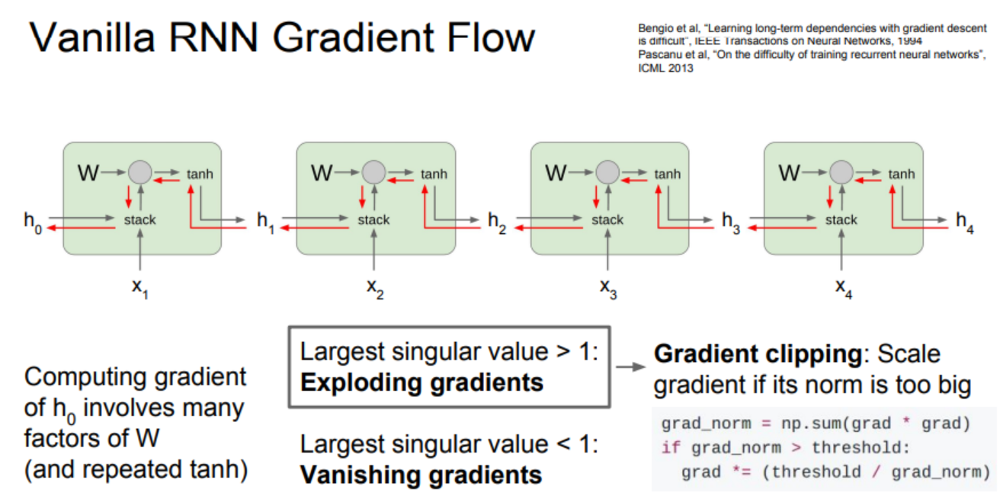

### **How it Works**

Long Short-Term Memory (LSTM) is a type of neural network that is commonly used for sequential data such as time series, speech recognition, and natural language processing. LSTM networks work in phases and sequences that can be summarized as follows:

#### **Phase 1: Input and Forget Gates**
- The LSTM network receives input data and determines which information to keep and which to forget.
- The **input gate** decides which information is relevant and should be stored.
- The **forget gate** discards information that is no longer needed, helping the network focus on relevant patterns.

#### **Phase 2: Memory Cell**
- The memory cell serves as long-term storage for relevant information.
- It retains important information over time while forgetting irrelevant details.
- The memory cell can update its state with new information, ensuring it remains accurate for long sequences.

#### **Phase 3: Output Gate**
- The output gate determines which information from the memory cell is relevant for the current output.
- It ensures that only meaningful and contextually important data is passed forward.
- This gate also regulates how much information is outputted to maintain clarity in predictions.

#### **Phase 4: Backpropagation and Training**
- The LSTM is trained using backpropagation, a supervised learning algorithm.
- During training, the network adjusts the weights of the input, forget, and output gates as well as the memory cell.
- The training process optimizes the network's performance by minimizing the error between predicted and actual outputs.

By following these phases, LSTMs effectively handle long-range dependencies in sequential data and address common challenges like vanishing or exploding gradients.

![](https://emergingindiagroup.com/wp-content/uploads/2024/05/39541331-dae3-4fe8-928c-9fcfeafe9746.webp)

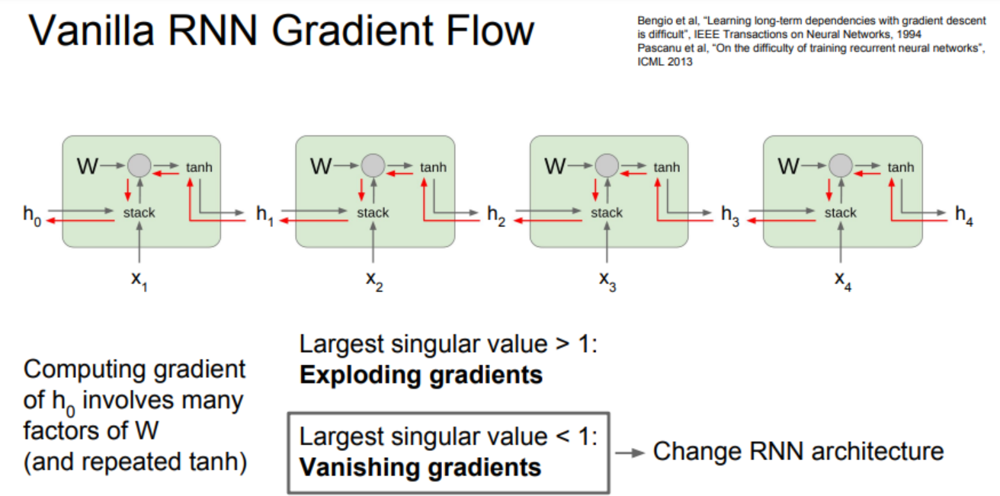

> LSTM is the solution for Vanishing gradients Probelm.

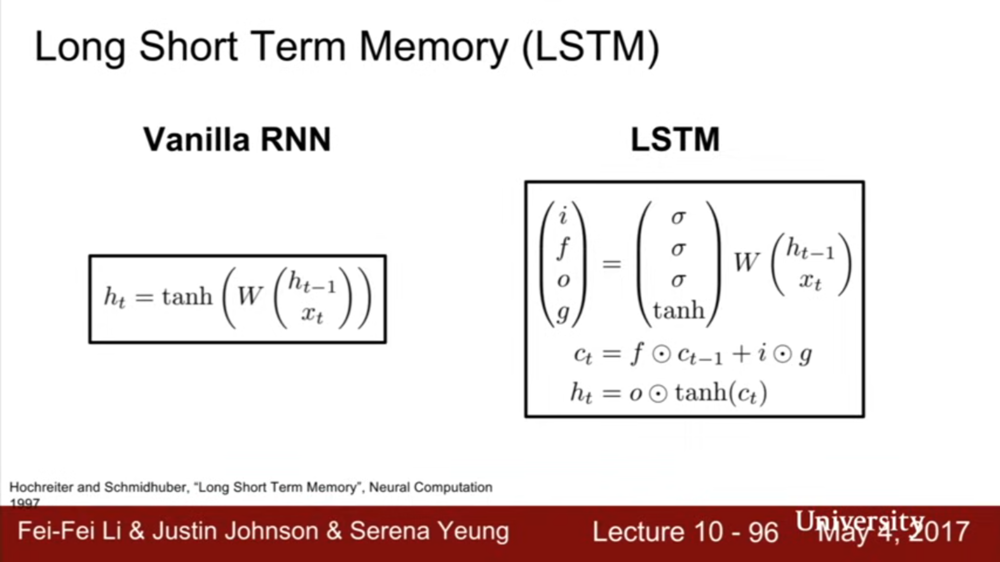

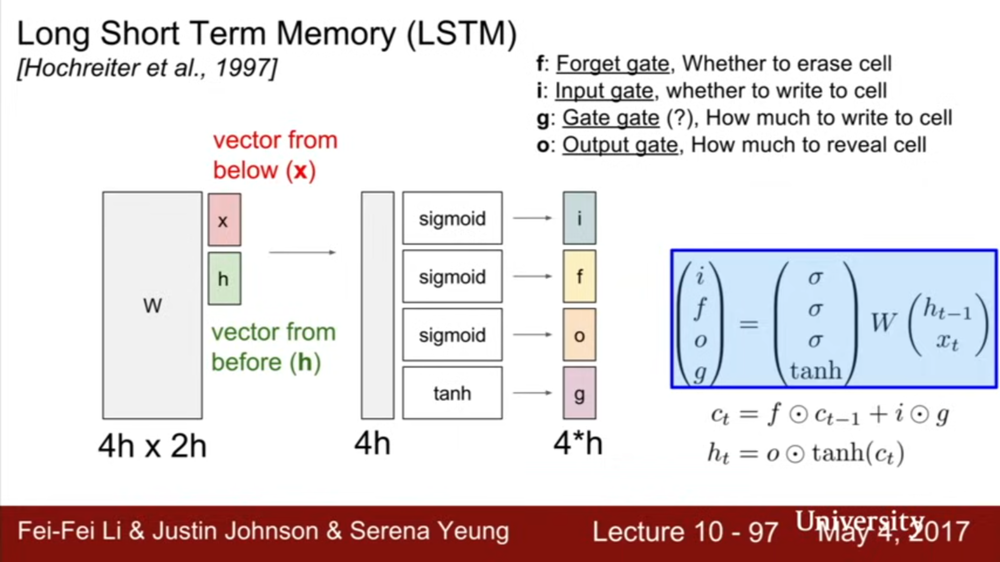

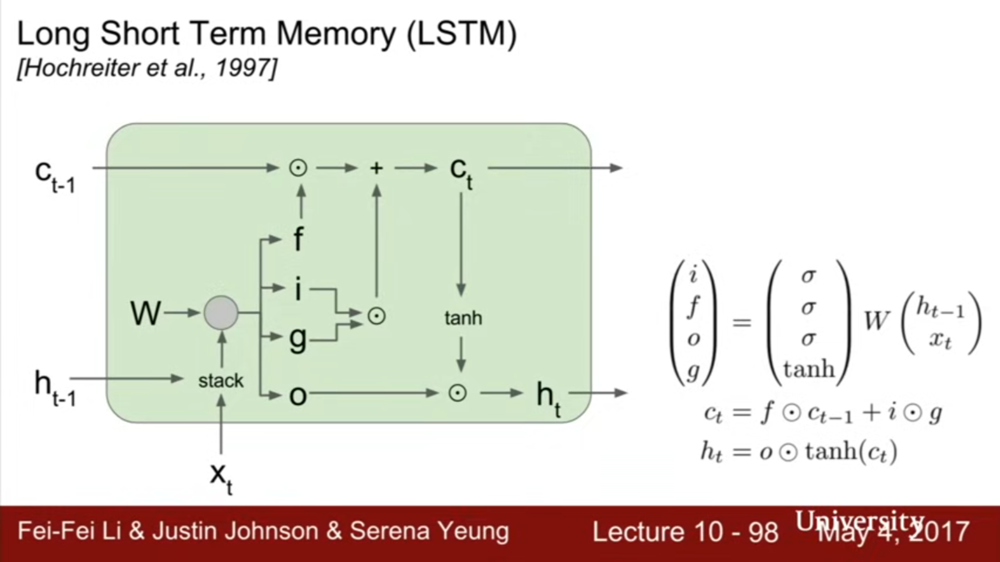

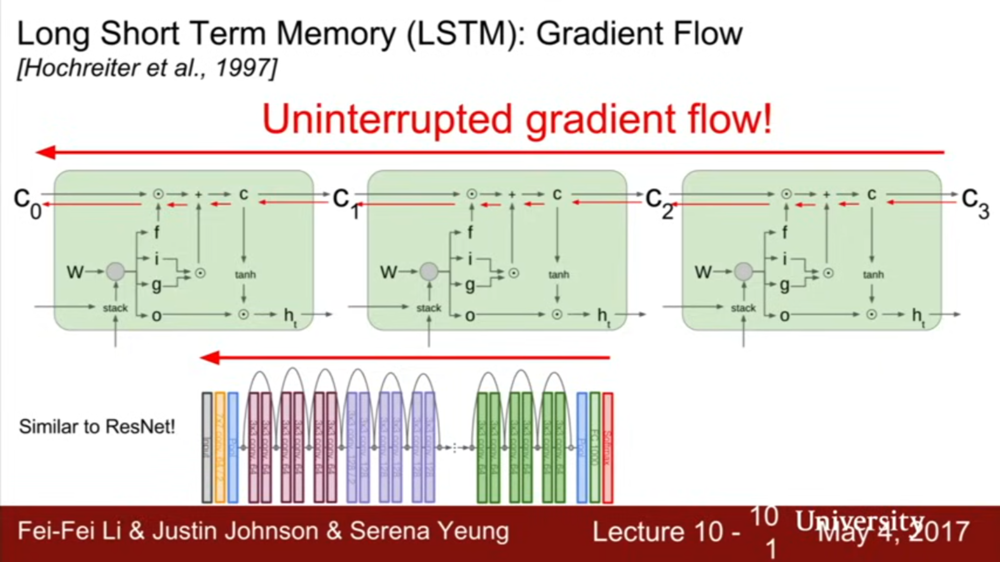

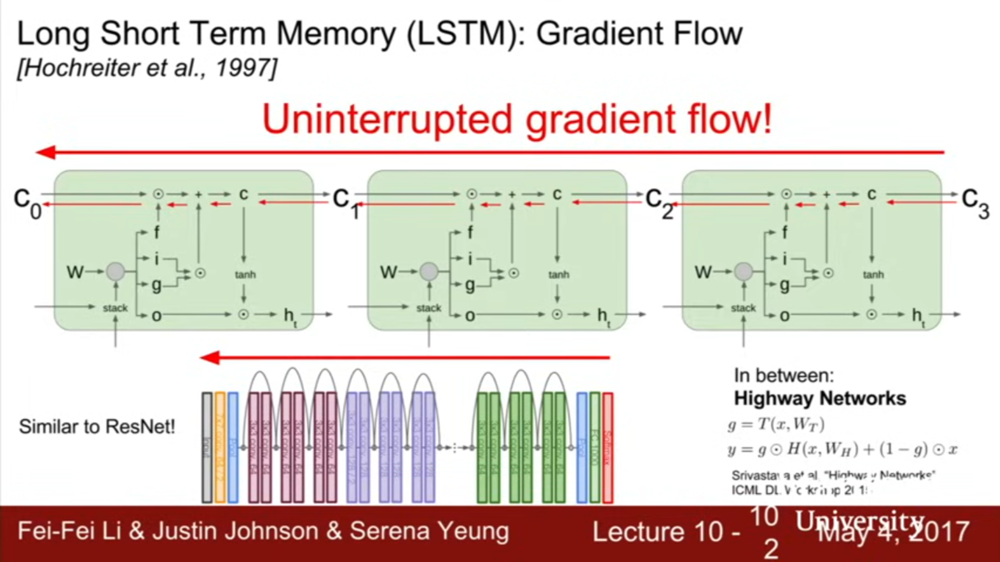

### **10.8.2 How do Gated Recurrent Units (GRUs) compare to LSTMs?**

| **Aspect**                   | **Gated Recurrent Units (GRUs)**                                                                                       | **Long Short-Term Memory (LSTMs)**                                                                                                           |
|------------------------------|----------------------------------------------------------------------------------------------------------------------|---------------------------------------------------------------------------------------------------------------------------------------------|
| **Architecture**             | GRUs have a simpler architecture with two gates: **update gate** and **reset gate**.                                 | LSTMs have a more complex architecture with three gates: **input gate**, **forget gate**, and **output gate**, along with a cell state.      |
| **Cell State**               | GRUs do not have a separate cell state; they combine the hidden state and memory storage into a single structure.    | LSTMs have a distinct cell state to store long-term information, separate from the hidden state.                                             |
| **Gates**                    | GRUs use an **update gate** to control what information to retain and a **reset gate** to control the influence of past information. | LSTMs use **input**, **forget**, and **output gates** to regulate the flow of information and manage memory storage more granularly.          |
| **Parameter Count**          | GRUs have fewer parameters due to their simpler structure, making them computationally less expensive.               | LSTMs have more parameters because of their additional gate and cell state, leading to higher computational cost.                            |
| **Memory Retention**         | GRUs are efficient for shorter sequences but may struggle with longer dependencies compared to LSTMs.                | LSTMs excel in learning long-term dependencies, making them more suitable for longer sequences.                                              |
| **Training Speed**           | GRUs train faster due to fewer parameters and simpler operations.                                                    | LSTMs take longer to train because of their complex structure and additional gates.                                                          |
| **Performance**              | GRUs perform comparably to LSTMs on many tasks, especially when the dataset does not require extensive memory.       | LSTMs often outperform GRUs on tasks that involve long-range dependencies or highly complex sequential data.                                 |
| **Simplicity**               | GRUs are simpler to implement and tune due to their reduced complexity.                                              | LSTMs are more sophisticated but require careful tuning of hyperparameters.                                                                  |
| **Applications**             | GRUs are preferred in applications with shorter sequences or when computational efficiency is a priority.            | LSTMs are widely used in tasks requiring robust long-term memory, such as speech recognition and machine translation.                        |


#### **10.8.2.1 Understanding Long Short Term Memory (LSTM) Networks**

The increasing importance of sequential data across various fields highlights the need for advanced models capable of handling its complexities. Recurrent Neural Networks (RNNs) have long been the go-to solution for sequence-based tasks. However, their limitations in capturing long-term dependencies due to the vanishing gradient problem led to the development of Long Short-Term Memory (LSTM) networks. LSTMs were designed to overcome these challenges by retaining contextual information over long sequences, revolutionizing applications like natural language processing (NLP), time series forecasting, and bioinformatics. LSTMs have significantly improved the ability to process sequential data, unlocking new possibilities across multiple domains.

#### **1. LSTM: A Solution for Long-Term Dependencies**

Long Short-Term Memory (LSTM) networks were developed to address the shortcomings of traditional RNNs in handling long-term dependencies. While basic RNNs struggle with learning from sequences where the important information may lie far back in the data, LSTMs are specifically engineered to retain relevant information for extended periods. They do this by utilizing specialized memory cells and gating mechanisms that regulate the flow of information, allowing the network to selectively remember or forget information over long sequences. This makes LSTMs ideal for applications where context from earlier parts of a sequence is crucial, such as language translation or financial market prediction.

#### **2. Applications of LSTMs**

- **Natural Language Processing (NLP):** LSTMs have become foundational in NLP tasks, such as language translation, speech recognition, sentiment analysis, and text generation. By processing words or tokens sequentially, LSTMs can understand the context and meaning of words based on their positions in the sentence, enabling more accurate language models.
  
- **Time Series Forecasting:** In fields like finance, meteorology, and energy, LSTMs excel at predicting future values in a series of temporal data. By understanding the historical trends, they can generate forecasts for stock prices, weather patterns, and other time-sensitive phenomena.

- **Generative Modeling:** LSTMs are also used in generative tasks, such as creating music, poetry, and even synthetic data. Their ability to capture long-term patterns makes them ideal for generating new sequences that resemble the original training data.

- **Bioinformatics:** LSTMs play a significant role in analyzing biological sequences like DNA or protein structures. These sequences, often with complex dependencies over long stretches of data, can be better understood using LSTM models, aiding in tasks like gene prediction and protein folding.

#### **3. Demystifying LSTM Architecture**

LSTM networks consist of specialized units that work together to solve the problem of long-term dependency learning. The key to their success lies in their architecture, which includes memory cells and several gates that control the flow of information.

##### **Core Components of an LSTM Cell**

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*CEzEcuQ-kDI0uD1wJMxIJg.png)

- **Memory Cell:** The memory cell is the core component of an LSTM, responsible for storing information over time. It maintains a state that is updated at each time step based on the input, forget, and output gates.

- **Forget Gate:** The forget gate determines which information from the memory cell should be discarded. It uses a sigmoid function to output values between 0 and 1, where 0 means "forget" and 1 means "keep."

- **Input Gate:** The input gate decides what new information will be stored in the memory cell. It also uses a sigmoid function to regulate the information flow and a tanh function to create new candidate values to be added to the memory cell.

- **Output Gate:** The output gate controls what information from the memory cell will be passed on to the next layer. Like the other gates, it uses a sigmoid function to determine the output, which is then combined with the memory cell’s state to generate the final output.

- **Candidate Gate:** This gate generates a potential new memory state that could be added to the memory cell, helping refine the model’s understanding of the sequence.

##### **Implementation in Deep Learning**

In deep learning frameworks, LSTMs are typically implemented as part of a neural network layer, where each layer processes a sequence of data. LSTM layers can be stacked to form deeper networks, improving their ability to model complex dependencies in the data. They are often combined with other types of layers, such as convolutional layers or attention mechanisms, to tackle more intricate tasks.

##### **Advanced LSTM Variants**

Over time, researchers have developed advanced variants of LSTMs to improve their efficiency and performance. Some notable variants include:

- **Bidirectional LSTMs:** These models process sequences in both forward and backward directions, allowing them to capture context from both the past and the future in tasks like speech recognition and machine translation.

- **GRUs (Gated Recurrent Units):** A simpler alternative to LSTMs, GRUs combine the forget and input gates into a single gate, reducing computational complexity while still maintaining the ability to model long-term dependencies.

- **Attention Mechanisms:** Attention mechanisms, often combined with LSTMs, allow the model to focus on specific parts of the input sequence, improving the model’s ability to handle long sequences and further enhancing performance in tasks like machine translation.

#### **4. Cutting-Edge Research Advancements in LSTMs**

The field of LSTMs continues to evolve, with new research focusing on improving the efficiency, scalability, and interpretability of these networks. Some key areas of research include:

- **Hybrid Models:** Researchers are exploring hybrid models that combine LSTMs with other neural network architectures, such as Convolutional Neural Networks (CNNs) and Transformer models, to tackle more complex sequence-based tasks.

- **Self-Regularizing LSTMs:** Efforts are being made to improve the regularization techniques in LSTMs to prevent overfitting, especially when training on smaller datasets.

- **Explainable AI (XAI) with LSTMs:** As LSTMs are used in more critical applications, such as healthcare and autonomous systems, there is a growing need to make these models more interpretable. Research in explainable AI is focused on understanding how LSTMs make decisions and ensuring their transparency.

#### **5. Conclusion: The Future of LSTMs**

LSTMs have proven to be a transformative tool for handling sequential data, particularly in applications requiring the modeling of long-term dependencies. As deep learning continues to advance, LSTMs will remain a core technology for many sequence-based tasks. Ongoing research into new variants, hybrid models, and explainability will further enhance the power of LSTMs, opening new possibilities in fields ranging from natural language processing to bioinformatics and beyond. The future of LSTMs is promising, with the potential to unlock even more advanced capabilities in understanding and predicting sequential patterns.


#### **10.8.2.2 Understanding Gated Recurrent Units (GRUs)**

As the demand for processing sequential data grows, researchers have continued to refine Recurrent Neural Networks (RNNs) to overcome limitations such as the vanishing gradient problem. One significant advancement in this area is the development of Gated Recurrent Units (GRUs), a simplified variant of Long Short-Term Memory (LSTM) networks. GRUs were designed to offer many of the benefits of LSTMs while reducing computational complexity. GRUs are well-suited for sequence-based tasks, especially in applications like natural language processing, time series forecasting, and speech recognition, offering an efficient solution where memory and computational resources are limited.

#### **1. GRU: A Simplified Approach to Handling Sequential Data**

Gated Recurrent Units (GRUs) were introduced to address the need for models that can capture long-term dependencies in sequential data with fewer parameters than LSTMs. GRUs combine the forget and input gates found in LSTMs into a single gate, reducing the model's complexity without sacrificing performance. Despite being simpler, GRUs have shown to be just as effective as LSTMs in many applications. This simplification allows GRUs to train faster and use less memory, making them particularly useful in situations where computational resources are a concern.

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*COndNvuf0YmG7yziFKcdYg.png)

#### **2. Applications of GRUs**

- **Natural Language Processing (NLP):** GRUs are commonly used in NLP tasks such as sentiment analysis, machine translation, and speech recognition. Their ability to capture dependencies over time allows them to effectively model context and meaning in text, making them suitable for a wide range of linguistic tasks.

- **Time Series Forecasting:** Similar to LSTMs, GRUs are frequently used for predicting future values in time series data, such as stock prices, weather forecasts, and demand forecasting. Their ability to handle long-term dependencies makes them ideal for capturing the patterns in data collected over time.

- **Speech Recognition:** In speech-to-text applications, GRUs can process the temporal nature of audio signals, learning to recognize patterns in speech and convert them to text. Their efficiency and reduced computational cost make them a viable option in real-time systems.

- **Generative Modeling:** GRUs are also used in generating sequences, such as music or text generation. By learning the underlying structure of the input data, GRUs can generate new sequences that are similar to the original data, useful in creative and generative AI tasks.

#### **3. Demystifying GRU Architecture**

GRUs are a simpler alternative to LSTMs, but they retain much of the functionality necessary for processing sequential data. They utilize gating mechanisms to control the flow of information, though with fewer gates than LSTMs, making them more computationally efficient.

##### Core Components of a GRU

- **Update Gate:** The update gate determines how much of the previous memory should be retained and how much of the new information should be incorporated. It uses a sigmoid function to output values between 0 and 1, where a value close to 1 means that the previous state is retained, and a value close to 0 means that the new information takes precedence.

- **Reset Gate:** The reset gate decides how much of the previous memory to forget when updating the current state. It also uses a sigmoid function to output values between 0 and 1, allowing the model to retain or forget information from the past, depending on the task.

- **Candidate Activation:** The candidate activation represents the new information that is being added to the memory. This value is computed using a tanh function and is used to update the hidden state when combined with the output of the update gate.

##### Implementation in Deep Learning

GRUs are implemented similarly to LSTMs within deep learning frameworks. However, since they have fewer parameters, they tend to train faster and use less memory. GRU layers can be stacked to create deep networks, and they are often used in combination with other types of layers, such as convolutional layers or attention mechanisms, to improve performance in more complex tasks.

#### **4. Cutting-Edge Research Advancements in GRUs**

Recent research in GRUs focuses on improving their performance and adaptability for a wider range of applications. Some areas of advancement include:

- **Hybrid Models:** GRUs are increasingly being used in hybrid models, where they are combined with other architectures, such as Convolutional Neural Networks (CNNs) or Transformer networks, to enhance performance on complex tasks.

- **Variational GRUs:** Variational approaches to GRUs, like Variational Autoencoders (VAEs), are being explored to handle uncertainty in sequential data, making the models more robust in uncertain or noisy environments.

- **Attention Mechanisms:** While GRUs already handle temporal dependencies well, integrating attention mechanisms with GRUs can further enhance their ability to focus on important parts of the sequence, improving performance in tasks like machine translation and summarization.

- **Efficient Training Methods:** Researchers are exploring more efficient training methods for GRUs to further reduce training time and memory usage while maintaining or improving performance.

#### **5. Conclusion: The Future of GRUs**

Gated Recurrent Units (GRUs) offer an efficient and effective solution for processing sequential data, particularly in applications that require the modeling of temporal dependencies. With their reduced complexity compared to LSTMs, GRUs provide a fast and memory-efficient alternative without sacrificing accuracy. As research in deep learning continues, GRUs will remain a valuable tool for many sequence-based tasks, with ongoing advancements making them even more powerful and adaptable. In the future, GRUs are expected to play a key role in applications ranging from natural language processing to time series forecasting and beyond, making them a critical component of modern AI and machine learning systems.


# **11. Detection and Segmentation**
---

## **11.1. Image Classification**


### 11.1.1. What is Image Classification and How Does It Work in Deep Learning?

#### **What is Image Classification?**

##### **Theoretical Perspective:**
Image classification refers to the task of assigning a label to an image based on its visual content. The process involves identifying key patterns, objects, or features within an image and categorizing it into one of several predefined classes. It is a key problem in computer vision, where a model learns from labeled data to make predictions about unseen data. Image classification is a supervised learning problem, meaning that during training, each image in the dataset is paired with a label indicating the true class.

Mathematically, image classification can be framed as a **function approximation** problem, where the goal is to learn a mapping `f : X → Y`, where:
- `X` is the space of images (e.g., each image `x ∈ X` could be represented as a matrix of pixel values),
- `Y` is the space of class labels (e.g., the label could be a class like "cat", "dog", "road sign", etc.).

A deep learning model is trained to minimize the difference between its predicted class and the true class label by adjusting its parameters using optimization techniques like stochastic gradient descent.

##### **Mathematical Perspective:**
- **Input Representation**: An image `I` is usually represented as a matrix of pixel values. For a colored image, this matrix can have dimensions `H × W × 3`, where `H` and `W` are the image's height and width, and 3 corresponds to the RGB color channels. Each pixel is a value between 0 and 255.
  
```
I = { I_{i,j,c} | 1 ≤ i ≤ H, 1 ≤ j ≤ W, 1 ≤ c ≤ 3 }
```


- **Model Representation**: A convolutional neural network (CNN) is a common model used for image classification. The CNN applies a series of filters (kernels) to the image to extract features, with each convolutional layer designed to detect different patterns.

If `f` represents the transformation applied by the network:


```
f(I) = C1(C2(...(Cn(I))...))
```


where `Cn` represents the convolutional and pooling operations, and the final output is passed through a softmax layer to obtain class probabilities:

```
p(y_i|x) = exp(z_i) / Σk exp(z_k)
```


where `z_i` are the output logits for class `i` and `p(y_i|x)` is the probability of the image `x` belonging to class `y_i`.

#### **How Do Deep Learning Models Classify Images in Autonomous Vehicles?**

##### **Theoretical Perspective:**
In autonomous vehicles, deep learning models are used to classify images captured by cameras to identify road signs, obstacles, pedestrians, and more. The key challenge is to build a model that can generalize well to real-world scenarios, where input images can be noisy, varied, and influenced by factors like lighting and weather.

Deep learning models such as CNNs are trained on large labeled datasets, learning to recognize various objects. These models employ hierarchical feature learning, where lower layers capture basic features (e.g., edges, textures), and higher layers capture more complex features (e.g., shapes, objects).

For example, road sign recognition can be viewed as a **multi-class classification** problem, where the goal is to classify the input image into one of several road sign classes (e.g., 'stop', 'yield', 'speed limit').

##### **Mathematical Perspective:**
Let’s define the task of classifying an image `I` into one of the `N` classes:
- `f(I)` represents the output of the deep learning model for an input image `I`, where `f(I)` is a vector of length `N` representing the raw output of the network.
- The final class prediction is determined by applying the softmax function to this vector to get the class probabilities `p(y_i|I)`, where `y_i ∈ Y` is the class label.

The classification loss function typically used for such tasks is **categorical cross-entropy**, which is defined as:

```
L = -Σi=1^N y_i log(p(y_i|I))
```


where:
- `y_i` is the one-hot encoded label for the true class,
- `p(y_i|I)` is the predicted probability for class `i`.

In road sign detection, if the model predicts the class of a stop sign with a probability of 0.8, the goal is to minimize the discrepancy between the predicted probability and the actual label (which would be 1 for the stop sign).



In [ ]:
# Coding Perspective:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense
from tensorflow.keras.optimizers import Adam

# Build a simple CNN model
model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(64, 64, 3)),
    MaxPooling2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Flatten(),
    Dense(128, activation='relu'),
    Dense(10, activation='softmax')  # 10 classes for classification
])

# Compile the model
model.compile(optimizer=Adam(), loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Train the model on a dataset
model.fit(train_images, train_labels, epochs=10, validation_data=(test_images, test_labels))


In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense
from tensorflow.keras.optimizers import Adam

# Assume input images are 64x64 RGB images of road signs
model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(64, 64, 3)),
    MaxPooling2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Flatten(),
    Dense(128, activation='relu'),
    Dense(43, activation='softmax')  # 43 classes (e.g., for 43 road signs)
])

model.compile(optimizer=Adam(), loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Train with road sign images
model.fit(train_images, train_labels, epochs=10, validation_data=(test_images, test_labels))


### **11.1.2. What are the Popular CNN Architectures for Image Classification?**

#### **What is LeNet, and How Was It Used for Early Image Classification?**

##### **Theoretical Perspective:**
LeNet is one of the earliest convolutional neural network (CNN) architectures, developed by Yann LeCun in the late 1980s. It was designed primarily for digit recognition, specifically for classifying handwritten digits in the MNIST dataset. LeNet consists of several convolutional layers, followed by subsampling (or pooling) layers, and fully connected layers at the end.

LeNet's architecture made the use of convolutional layers to automatically extract features from images, which was revolutionary at the time. The architecture typically includes:
- **Convolutional layers** for feature extraction,
- **Subsampling layers** (often average pooling) to reduce spatial dimensions,
- **Fully connected layers** to make final predictions.

LeNet’s success demonstrated the power of CNNs in image classification tasks and set the foundation for more complex architectures.


#### **What is AlexNet and How Did It Revolutionize CNNs for Classification in Autonomous Driving?**

##### **Theoretical Perspective:**
AlexNet, developed by Alex Krizhevsky and colleagues in 2012, was a breakthrough in deep learning for image classification. It won the ImageNet competition by a large margin, significantly reducing the error rate for image classification tasks. AlexNet introduced several innovations:
- **Deep architecture** with eight layers: five convolutional layers followed by three fully connected layers.
- **ReLU activation function** instead of the traditional sigmoid or tanh, allowing faster training.
- **Dropout** to prevent overfitting.
- **Data augmentation** techniques to improve generalization.

In the context of autonomous driving, AlexNet’s architecture was highly influential because it demonstrated how deeper networks could be trained effectively on large datasets, making it suitable for tasks such as object detection, road sign recognition, and pedestrian detection.

#### **What Are VGG and Its Key Contributions to CNN Architectures in Autonomous Vehicle Applications?**

##### **Theoretical Perspective:**
VGG (Visual Geometry Group), developed by Oxford’s VGG team in 2014, is known for its simplicity and deep architecture. It uses very small convolution filters (3x3) and deep stacking of layers, typically 16 or 19 layers. The idea behind VGG was to increase the depth of the network and rely on smaller filters, rather than large convolutions.

In autonomous vehicle applications, VGG is often used for object detection and classification tasks due to its ability to capture complex spatial hierarchies. The architecture's uniform structure makes it easier to adapt and fine-tune on specific datasets such as road signs, vehicles, and pedestrians.

##### **Mathematical Perspective:**
VGG networks are composed of a series of convolutional layers with small 3x3 filters. Each convolutional operation is followed by ReLU activations and max-pooling. Mathematically, the network learns to map input `x` to output `y`:


```
f(x) = C1(C2(...(Cn(x))...))

```

The depth of the architecture allows it to learn increasingly abstract features at each layer.

#### **What is ResNet and How Does It Use Residual Connections for Better Performance in Autonomous Vehicle Perception Tasks?**

##### **Theoretical Perspective:**
ResNet (Residual Networks), introduced by Microsoft in 2015, uses residual connections, or skip connections, to enable the training of very deep networks (hundreds or even thousands of layers). These skip connections allow the network to bypass some layers, mitigating the vanishing gradient problem that arises in very deep networks. This enables more accurate learning and faster convergence.

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*9SrzCTHIVgxzPu3VmvWmVw.png)

![](https://media.geeksforgeeks.org/wp-content/uploads/20200424011138/ResNet.PNG)

In autonomous vehicles, ResNet is widely used for perception tasks like object detection, road segmentation, and scene recognition. The residual connections help the network to focus on learning the differences (or residuals) between the input and output of each block, making it efficient even with deep architectures.

##### **Mathematical Perspective:**
A residual block can be represented as:



```
f(x) = H(x) + x

```

![](https://media.geeksforgeeks.org/wp-content/uploads/20200424011510/Residual-Block.PNG)

Where `H(x)` represents the learned function of the block, and `x` is the input. The addition of `x` (the input) to `H(x)` helps in passing gradients through the layers during backpropagation, avoiding the vanishing gradient problem.

The network is trained to minimize the loss function (e.g., cross-entropy) with the help of residual connections:


```
L = -Σi=1^N y_i log(p(y_i|I))

```


#### **How Does EfficientNet Optimize CNN Architectures for Classification Tasks, and Its Use in Autonomous Driving?**

##### **Theoretical Perspective:**
EfficientNet, introduced by Google in 2019, optimizes CNN architectures by systematically scaling the network in depth, width, and resolution. Instead of arbitrarily increasing the size of the network, EfficientNet uses a compound scaling method to balance these three dimensions, resulting in a highly efficient architecture that achieves state-of-the-art performance with fewer parameters.

**The below images show the different methods of scaling:**
 - Baseline: The original network without scaling.
 - Width Scaling: Increasing the number of channels in each layer.
 - Depth Scaling: Increasing the number of layers.
 - Resolution Scaling: Increasing the input image resolution.
 - Compound Scaling: Simultaneously increasing width, depth, and resolution according to the compound scaling formula.

![](https://media.geeksforgeeks.org/wp-content/uploads/20240513185151/1_-ENqv4TI0JuyY6Nq8XQlAA.webp)

In autonomous driving, EfficientNet can be used for tasks like object detection, road segmentation, and scene classification. Its efficiency allows it to run on resource-constrained devices, making it suitable for real-time processing in autonomous vehicles.

##### **Mathematical Perspective:**
EfficientNet scales the network using a compound coefficient `φ`, which balances depth, width, and resolution:

```
d = φ * d0, w = φ * w0, r = φ * r0

```

Where `d0`, `w0`, and `r0` are the base values for depth, width, and resolution, and `φ` is the scaling factor.

The model is trained to minimize a loss function such as categorical cross-entropy, optimizing the network for accurate predictions with fewer resources.


```
L = -Σi=1^N y_i log(p(y_i|I))

```

![](https://media.geeksforgeeks.org/wp-content/uploads/20240529093853/Comparison-with-EfficientNet-(1).webp)


### **11.1.3. How do CNNs work for image classification, and what layers are commonly used?**

Convolutional Neural Networks (CNNs) are a type of deep learning model particularly effective for image classification tasks. They are designed to automatically and adaptively learn spatial hierarchies of features from images, which makes them ideal for tasks such as recognizing objects in images, such as vehicles, pedestrians, or road signs, in autonomous driving systems.

Here are the common layers used in CNNs for image classification, along with their specific roles in processing images:

#### **1. What are convolutional layers and how do they extract features from images of the road or surroundings?**

**Convolutional layers** are the core building blocks of CNNs. Their main function is to automatically extract features from an image by applying **filters** (also called **kernels**) that move across the image in small steps (called **stride**). These filters are learned during the training process and are designed to detect specific features in the image, such as edges, textures, or more complex patterns.

- **How they work**:
  - Each filter scans the image, performs a **convolution** operation by multiplying the filter with a section of the image (called a **receptive field**), and then sums the results.
  - The filter moves across the entire image, producing a **feature map** that highlights specific features like edges, corners, or patterns.
  
- **In the context of autonomous driving**:
  - CNNs use convolutional layers to extract features of the road, vehicles, pedestrians, and other elements of the environment.
  - For instance, in an image of a road, the convolutional layers may learn to detect features like lane markings, curves, or obstacles such as other vehicles and pedestrians.
  
  The network learns which features are important for tasks such as **object detection** and **road segmentation**, which are essential for safe navigation in autonomous driving systems.

#### **2. How do pooling layers reduce spatial dimensions in CNNs used for object detection and classification in vehicles?**

**Pooling layers** are used to **downsample** the spatial dimensions of the image or feature maps produced by convolutional layers. Pooling helps reduce the computational complexity of the model, preventing overfitting, and allows the network to focus on high-level features.

- **How they work**:
  - **Max pooling** is the most commonly used technique, where a small window (e.g., 2x2 pixels) slides over the feature map, and only the **maximum** value from the window is retained.
  - **Average pooling** computes the average value of the window instead of the maximum value.
  
- **In the context of autonomous driving**:
  - Pooling layers help reduce the size of the feature maps, making the network more efficient and reducing the amount of computation required.
  - This reduction in spatial dimensions allows the network to focus on large-scale features (such as the overall shape of a vehicle or pedestrian) rather than small details (like individual pixels).
  - Pooling also helps the model become **translation-invariant**, meaning it can recognize an object regardless of its position in the image.

#### **3. What are fully connected layers and how do they help in classifying objects, like pedestrians or vehicles, for autonomous driving?**

**Fully connected layers** (also known as **dense layers**) are typically used near the end of the CNN architecture. These layers take the output from the convolutional and pooling layers (which contains high-level features) and flatten it into a vector that is passed through one or more fully connected layers.

- **How they work**:
  - Each neuron in a fully connected layer is connected to every neuron in the previous layer, which allows the network to combine all the features learned by earlier layers.
  - The final fully connected layer typically produces an output corresponding to the predicted class (e.g., **vehicle**, **pedestrian**, or **road sign**).
  - An **activation function**, such as **softmax** for classification tasks, is applied to the output to produce probabilities for each class.

- **In the context of autonomous driving**:
  - After the convolutional and pooling layers have extracted relevant features, the fully connected layers combine these features to make final predictions, such as whether an object in the image is a **pedestrian**, a **vehicle**, or something else.
  - These predictions are essential for **object detection**, which is key for autonomous vehicles to navigate safely by detecting pedestrians, vehicles, and obstacles in real-time.

### **Summary:**

- **Convolutional layers**: Extract low-level features like edges, textures, and shapes from images.
- **Pooling layers**: Reduce the spatial dimensions of the image and feature maps, making the network more efficient and robust.
- **Fully connected layers**: Take the high-level features extracted from earlier layers and classify objects (such as pedestrians, vehicles, etc.) for tasks like object detection in autonomous driving.

Together, these layers enable CNNs to perform complex tasks like recognizing pedestrians, vehicles, and other critical objects in the environment, which are essential for safe and reliable autonomous driving.


## **11.2. Semantic Segmentation**


### **11.2.1. What is semantic segmentation and how is it different from image classification?**

Semantic segmentation is a computer vision task that involves classifying each pixel in an image into a predefined class label, making it essential for applications that require precise object localization and understanding. This technique is particularly useful in fields like autonomous vehicles, where understanding the detailed layout of the environment is crucial for safe navigation and decision-making.

![](https://miro.medium.com/v2/resize:fit:828/format:webp/1*kvh9u8W2sHlQoBPfwERggA.gif)

#### **How does semantic segmentation predict a class label for each pixel in an image?**
Semantic segmentation works by assigning a class label to each individual pixel of an image. The process can be broken down into the following steps:

1. **Image input**: The system receives an image as input, typically from a camera mounted on an autonomous vehicle or robot.
2. **Feature extraction**: Using deep learning models, particularly convolutional neural networks (CNNs), the system extracts features from the image to understand the context and structure of different objects within the scene.
3. **Pixel-wise classification**: Unlike image classification, where the goal is to assign a single label to the entire image, semantic segmentation classifies each pixel of the image into one of several categories. These categories could include things like roads, vehicles, pedestrians, buildings, and more.
4. **Output**: The model generates an output where each pixel is associated with a class label, effectively creating a segmented map of the image that highlights the different objects and areas within the scene.

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*0vxnW4tVpaSsBxpGMfW9vg.png)

For example, in the context of an autonomous vehicle, the semantic segmentation model might classify pixels into categories such as:
- **Road**: Pixels representing the road.
- **Vehicle**: Pixels representing other vehicles on the road.
- **Pedestrian**: Pixels corresponding to pedestrians.
- **Sky**: Pixels corresponding to the sky, etc.

This pixel-wise classification allows for fine-grained understanding of the environment, enabling tasks like obstacle detection, path planning, and scene analysis.

#### **What distinguishes semantic segmentation from general image classification in autonomous vehicles?**
While both semantic segmentation and image classification are crucial in computer vision tasks, they have key differences, especially in the context of autonomous vehicles:

1. **Level of Detail**:
   - **Semantic segmentation** provides detailed, pixel-level understanding of an image by classifying each pixel individually. This allows the system to recognize and differentiate objects, even when they are partially obscured or located at different depths in the scene.
   - **Image classification**, on the other hand, assigns a single label to the entire image. It identifies what the image contains at a high level, such as determining whether the image contains a car, pedestrian, or road, but it doesn't provide any spatial information about where the objects are located.

2. **Purpose**:
   - **Semantic segmentation** is used to create a detailed map of the scene, identifying all objects within it and their exact locations. This is vital for tasks like understanding the road network, detecting pedestrians, or determining safe zones for the vehicle to navigate.
   - **Image classification** is typically used for higher-level understanding, such as identifying whether a vehicle should stop or go based on traffic signs or detecting the presence of obstacles without needing exact location data.

3. **Output**:
   - **Semantic segmentation** produces a mask or map that labels every pixel of the image, which is crucial for tasks that require precise control, such as collision avoidance and path planning.
   - **Image classification** results in a single label that describes the general content of the image, without providing any spatial information about the objects in the scene.

4. **Applications in Autonomous Vehicles**:
   - **Semantic segmentation** is essential for the detailed environmental perception required in autonomous driving. It allows the vehicle to not only detect objects (like cars, pedestrians, or traffic lights) but also to understand their position relative to the vehicle and other objects.
   - **Image classification** is typically used for simpler tasks, like recognizing traffic signs, road types, or obstacles, but lacks the granularity needed for full scene understanding.

In summary, semantic segmentation is a more advanced and detailed approach than image classification, providing pixel-level information that is critical for tasks like object detection, environmental mapping, and safe navigation in autonomous vehicles. While image classification gives a general understanding of the image content, semantic segmentation allows for precise, localized understanding of every part of the image.


### **11.2.2. What are the common architectures for semantic segmentation in autonomous driving?**

Semantic segmentation plays a vital role in autonomous driving, providing a detailed understanding of the environment by classifying each pixel of an image. Several deep learning architectures have been developed to perform this task efficiently, with a focus on real-time processing and high accuracy for complex driving environments.



#### **What is the role of Fully Convolutional Networks (FCNs) in semantic segmentation for lane detection and road marking?**

Fully Convolutional Networks (FCNs) are one of the foundational architectures for semantic segmentation. Unlike traditional convolutional neural networks (CNNs), which are designed for classification tasks, FCNs are specifically tailored for pixel-wise predictions in segmentation tasks. The key role of FCNs in autonomous driving, particularly for tasks like **lane detection** and **road marking** detection, includes:

1. **Pixel-wise Classification**:
   FCNs replace the fully connected layers used in CNNs with convolutional layers, allowing the model to output a pixel-wise classification map. This is crucial for understanding detailed features like lanes, road markings, and other road elements, which require precise localization.

2. **Contextual Understanding**:
   FCNs use skip connections and upsampling layers to preserve spatial information while capturing contextual information from different levels of the network. This is important in autonomous driving, where detecting road boundaries, lane markings, and traffic lanes requires understanding both local and global context in images.

3. **Efficiency**:
   FCNs are efficient in terms of computation and memory usage, making them suitable for real-time processing in autonomous vehicles, where the vehicle needs to detect lanes and road markings continuously as it moves through the environment.

In summary, FCNs are an essential architecture for lane detection and road marking, offering pixel-level accuracy while maintaining computational efficiency for real-time autonomous driving applications.



#### **How does U-Net handle pixel-wise segmentation for road or vehicle detection?**

U-Net is a specialized architecture designed for pixel-wise semantic segmentation, originally developed for medical image segmentation. It is widely used in autonomous driving for tasks such as **road detection** and **vehicle detection** due to its ability to handle precise, localized predictions.

![](https://media.geeksforgeeks.org/wp-content/uploads/20220614121231/Group14.jpg)

The key features of U-Net that make it suitable for these tasks include:

1. **Encoder-Decoder Architecture**:
   U-Net consists of a contracting path (encoder) and an expansive path (decoder). The encoder extracts high-level features from the input image, while the decoder reconstructs the image to produce a pixel-wise segmentation map. This allows U-Net to learn both global and local features, which is critical for detecting complex road scenes and vehicles.

2. **Skip Connections**:
   U-Net uses skip connections that link corresponding layers in the encoder and decoder. These connections help retain spatial information, preventing the loss of fine details during downsampling and upsampling. This is essential for detecting small objects like vehicles, road boundaries, and pedestrians, ensuring high segmentation accuracy.

3. **High Accuracy for Small Features**:
   The architecture is particularly effective for detecting small features within a large image, making it highly suitable for road and vehicle detection, where precision is crucial. It is often used in tasks like identifying vehicles on the road, distinguishing between lanes, and segmenting road surfaces.

In autonomous driving, U-Net provides a powerful method for detecting road elements and vehicles, offering both fine details and robust performance in complex scenes.



#### **What is DeepLabV3+ and how does it use atrous convolutions for semantic segmentation in driving environments?**

DeepLabV3+ is a state-of-the-art semantic segmentation model that builds on the DeepLab family of architectures, with significant improvements for real-time, high-accuracy segmentation. It is particularly effective for driving environments where complex scene understanding is required.

![](https://ignitarium.com/wp-content/uploads/2021/09/Multiclass-semantic-segmentation-using-DeepLabV3-featured-Image-800400.png)

One of the key features of DeepLabV3+ is its use of **atrous (dilated) convolutions**, which provide several advantages in semantic segmentation for autonomous driving:

1. **Atrous Convolutions**:
   Atrous convolutions, or dilated convolutions, are a variant of standard convolutions that allow the receptive field of the filter to increase without losing resolution or increasing the computational cost. This enables the network to capture broader contextual information at various scales while maintaining fine spatial details.

2. **Handling Large Contexts**:
   In driving environments, the context of an object (e.g., a vehicle, road sign, or pedestrian) can vary in size depending on its distance from the camera. Atrous convolutions enable DeepLabV3+ to capture multi-scale context, which is important for identifying objects at different distances, such as nearby pedestrians or distant road signs.

3. **Decoder Module**:
   DeepLabV3+ includes an additional decoder module, which refines the segmentation map produced by the initial network layers. This decoder improves the segmentation boundaries, enhancing the model’s ability to accurately segment road surfaces, lanes, and objects like vehicles in a driving environment.

4. **Real-time Performance**:
   DeepLabV3+ is designed to balance high accuracy with real-time performance, making it well-suited for deployment in autonomous vehicles. The use of atrous convolutions allows the model to operate efficiently while maintaining precise localization of road features and objects.

In summary, DeepLabV3+ leverages atrous convolutions to improve the segmentation of objects in driving environments, making it highly effective for tasks like road segmentation, vehicle detection, and scene understanding. Its ability to handle multi-scale contexts and refine predictions through a decoder module ensures that it performs well in real-world autonomous driving applications.


### **11.2.3. How does Fully Convolutional Networks (FCN) work for semantic segmentation?**

Fully Convolutional Networks (FCNs) are a significant advancement in the field of semantic segmentation, allowing for pixel-level predictions that are crucial for autonomous vehicles. FCNs are designed to replace the fully connected layers of traditional CNNs with convolutional layers, enabling them to output spatially structured data such as segmentation maps.

![](https://www.researchgate.net/publication/358496388/figure/fig3/AS:11431281256835151@1719571230218/Fully-convolutional-networks-FCNs-are-trained-end-to-end-and-are-designed-to-make-dense.jpg)

#### **How does FCN differ from traditional CNNs in handling pixel-level predictions for autonomous vehicles?**

1. **Architectural Difference**:
   Traditional Convolutional Neural Networks (CNNs) are primarily designed for image classification tasks, where the final output is a single class label for the entire image. They use fully connected layers at the end of the network, which results in a fixed-size output (e.g., a single label for an entire image). In contrast, FCNs replace these fully connected layers with convolutional layers, allowing the network to generate a pixel-wise classification map, where each pixel in the image is assigned a class label.

2. **Pixel-Level Output**:
   FCNs perform pixel-wise prediction, meaning that instead of producing a single class label for the whole image, FCNs classify each individual pixel into one of several predefined categories (e.g., road, vehicle, pedestrian, etc.). This capability is essential for autonomous vehicles, as they need detailed, localized information to understand their environment and make decisions in real-time.

3. **No Fixed Output Size**:
   Unlike traditional CNNs, FCNs do not require a fixed-size input or output. FCNs can handle images of arbitrary size and produce an output map that corresponds to the input image’s size, preserving spatial relationships. This is especially useful for tasks like road surface detection, where the network needs to identify and localize various road elements regardless of their scale or position in the image.

4. **Efficient and Flexible**:
   By eliminating fully connected layers, FCNs reduce the number of parameters and computations needed for training and inference, making them more efficient. This is critical for autonomous driving, where real-time performance is essential for processing large volumes of data from cameras and sensors.

![](https://tjmachinelearning.com/lectures/1718/fcn/structure.png)

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*6HDuqhUzP92iXhHoS0Wl3w.png)

- **Key Idea**: By replacing the fully connected layers with convolution layers, FCNs are able to generate segmentation maps that output pixel-wise classifications.
- **Skip Connections**: FCNs commonly use skip connections to combine high-resolution feature maps from the encoder with low-resolution but semantically richer feature maps from deeper layers in the network.


![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*eeePClgqJ28lduHTE_hSFg.jpeg)

In summary, FCNs differ from traditional CNNs by providing pixel-wise predictions, which is essential for tasks like lane detection, road surface classification, and obstacle identification in autonomous vehicles.

#### **What are the advantages of using FCNs for segmentation tasks like road surface detection and obstacle identification?**

FCNs offer several advantages for segmentation tasks, particularly in the context of autonomous driving:

1. **High Spatial Accuracy**:
   Since FCNs perform pixel-level classification, they can precisely locate objects such as vehicles, pedestrians, and road markings. This high spatial accuracy is necessary for tasks like **road surface detection**, where the vehicle needs to understand the exact boundaries of the road and **obstacle identification**, which requires distinguishing between different objects in the environment.

2. **Contextual Understanding**:
   FCNs are capable of maintaining context throughout the entire image using convolutional layers. This ability helps the model capture global context (such as road layout) while retaining local details (like the texture of the road surface or the shape of an obstacle). This contextual understanding is important for identifying hazards, such as potholes, or determining the road type (e.g., asphalt vs. gravel).

3. **Real-Time Performance**:
   FCNs are designed to be computationally efficient, making them suitable for real-time processing. In autonomous vehicles, this real-time capability is critical, as the model needs to continuously analyze the environment and make quick decisions based on live video feeds from cameras.

4. **Adaptability to Diverse Environments**:
   FCNs can be trained to segment a wide variety of objects and road features, including different types of roads, obstacles, lane markings, traffic signs, and pedestrians. This adaptability allows autonomous vehicles to operate in diverse driving environments, from urban streets to highways, with minimal adjustment to the model.

5. **End-to-End Learning**:
   FCNs can be trained in an end-to-end fashion, meaning that the entire network can be optimized for the segmentation task. This end-to-end learning allows the model to learn the most relevant features from the raw input images, without requiring manual feature engineering or preprocessing, making it more efficient and robust for real-world deployment.


> **UNET** is based on **a fully convolutional architecture**, which implies that it is entirely made up of convolutional layers and does not include any fully connected layers. This architecture enables UNET to function on input images of any size, increasing its flexibility and adaptability to various segmentation tasks and input variations.



In summary, the advantages of FCNs for segmentation tasks like road surface detection and obstacle identification include high spatial accuracy, contextual understanding, real-time performance, adaptability, and end-to-end learning, all of which are essential for the safe and effective operation of autonomous vehicles.


### **11.2.4. How do you evaluate the performance of a semantic segmentation model?**

Evaluating the performance of a semantic segmentation model is crucial for understanding its effectiveness in real-world tasks such as autonomous vehicle perception. Several metrics are commonly used to assess how well the model performs in segmenting images into different classes (e.g., road, vehicle, pedestrian, traffic signs).

#### **What is Intersection over Union (IoU) and how is it used in segmentation evaluation for autonomous vehicle perception tasks?**

**Intersection over Union (IoU)** is a widely used metric to evaluate the performance of segmentation models. It measures the overlap between the predicted segmentation mask and the ground truth mask, providing a quantifiable measure of how accurately the model performs in segmenting an object or region.

- **Definition**:
  - IoU is calculated as the ratio of the intersection of the predicted segmentation mask and the ground truth mask to the union of the two:

```
IoU = Area of Intersection / Area of Union
```

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*n6zDI7YRK7nNCCtMoW_MxA.png)


```
 - The ground truth bounding box for the car in our image is defined as follows:

   - Top-left corner coordinates: (50, 50)
   - Bottom-right corner coordinates: (200, 150)

 - Our object detection model generates a predicted bounding box:

   - Top-left corner coordinates: (100, 80)
   - Bottom-right corner coordinates: (180, 120)

Area of Intersection = (180 - 100) * (120 - 80) = 3200 square pixels

Area of Union = (150 - 50) * (200 - 50) + (180 - 100) * (120 - 80) - 3200 = 12000 square pixels


IoU = 3200 / 12000 ≈ 0.267

```

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*PffKrEOZx2OupGcR4pDxMA.png)

  - This formula captures how much the predicted region overlaps with the actual region, giving a value between 0 and 1, where 1 indicates a perfect match.

- **Use in Autonomous Vehicle Perception**:
  In the context of autonomous driving, IoU is critical for evaluating tasks like **road segmentation**, **vehicle detection**, **lane marking identification**, and **traffic sign recognition**. For example, when detecting traffic signs, IoU can be used to determine how well the predicted bounding box or segmentation map aligns with the actual position and shape of the traffic sign in the image. A higher IoU indicates better model performance and more precise localization of objects, which is essential for accurate decision-making in autonomous vehicles.

- **Thresholding**:
  Typically, a threshold (e.g., 0.5 or 0.7) is set to determine whether a prediction is considered correct or incorrect. For IoU values above the threshold, the prediction is deemed a successful detection, while values below the threshold are considered false positives or false negatives.

#### **How do pixel accuracy and mean pixel accuracy help evaluate segmentation results in the context of road or traffic sign detection?**

**Pixel Accuracy** and **Mean Pixel Accuracy** are two additional evaluation metrics that provide insight into the performance of a semantic segmentation model at the pixel level.

- **Pixel Accuracy**:
  - Pixel accuracy measures the proportion of correctly classified pixels in the image. It is calculated as the ratio of the number of correct pixels to the total number of pixels in the image:


  - In the context of **road segmentation** or **traffic sign detection**, pixel accuracy helps to understand how many individual pixels are correctly classified as part of the road, sign, or other objects. However, this metric alone can be misleading in imbalanced datasets, where some classes (e.g., background) may dominate, leading to high pixel accuracy despite poor performance in detecting smaller or less frequent objects.

- **Mean Pixel Accuracy**:
  - Mean pixel accuracy provides a more balanced evaluation by considering the accuracy for each class (e.g., road, vehicle, pedestrian) separately and then averaging them. It is computed as:
  
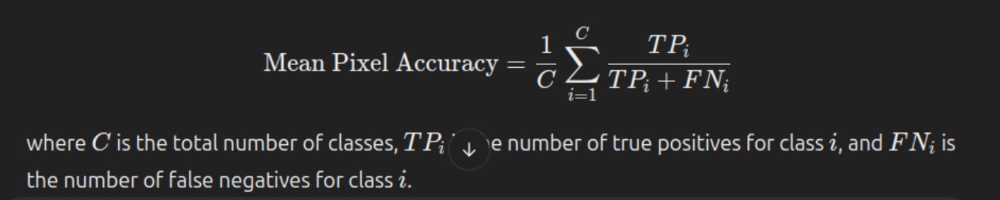

  - This metric is particularly useful for evaluating **segmentation results in multi-class tasks**, such as detecting both **roads and traffic signs**, where the model needs to accurately segment a range of different classes within the same image. Mean pixel accuracy balances the performance across all classes, reducing the bias towards dominant classes and giving more weight to smaller, potentially more difficult classes.

- **Use in Autonomous Vehicles**:
  - For tasks like **road detection**, **lane marking identification**, and **traffic sign recognition**, both pixel accuracy and mean pixel accuracy help assess the precision of the model in segmenting these critical objects. Road detection models need to ensure that the road surface is correctly segmented, and traffic sign detection models should accurately identify signs within the image, which can be evaluated using pixel-based metrics.
  - **Pixel accuracy** helps in understanding the general correctness of pixel classifications, while **mean pixel accuracy** gives a more detailed evaluation by considering the performance across different classes that may have varying importance in driving tasks.

In summary, **IoU** is essential for evaluating overlap and accuracy in object localization tasks, while **pixel accuracy** and **mean pixel accuracy** provide valuable insights into the model’s overall performance at the pixel level, helping to fine-tune segmentation models for autonomous driving tasks such as road surface detection and traffic sign recognition.


### **11.2.5. What are the challenges of semantic segmentation in autonomous driving?**

Semantic segmentation plays a critical role in autonomous driving by enabling the vehicle to understand its surroundings and make informed decisions. However, several challenges arise when applying semantic segmentation to driving environments due to the complexity and variability of real-world scenarios.

#### **How do segmentation models handle object boundaries and pixel precision when detecting vehicles or pedestrians?**

One of the significant challenges in semantic segmentation for autonomous driving is handling **object boundaries** with high precision. Objects such as vehicles, pedestrians, and traffic signs often have intricate and irregular shapes, making it difficult for models to correctly delineate these objects, especially at the pixel level.

- **Boundary Detection**:
  - Accurately detecting the boundaries of objects, like vehicles or pedestrians, is essential for understanding the context and making decisions based on the environment. However, traditional models may struggle with thin or overlapping boundaries due to limitations in pixel-wise prediction, leading to incorrect segmentation.
  - **Edge Refinement**: Techniques such as **Conditional Random Fields (CRFs)** and **boundary-aware models** are often employed to refine object boundaries and improve the segmentation quality. CRFs, for example, can model pixel dependencies and encourage the model to better align with object edges.

- **Pixel Precision**:
  - The precision of pixel classification is crucial, particularly in dense and cluttered environments. In scenarios like urban driving, where pedestrians, vehicles, and other objects are close together, precise pixel-wise segmentation is required to avoid misclassifications that could impact safety.
  - Advanced models like **DeepLabV3+** and **U-Net** use features like **atrous convolutions** and **skip connections** to capture fine-grained details and enhance pixel-level predictions, allowing for better handling of object boundaries in complex scenes.

#### **How do models deal with class imbalance in segmentation tasks, such as distinguishing between road and obstacles?**

Class imbalance is a prevalent issue in semantic segmentation, particularly in autonomous driving, where certain classes (e.g., road surface) are much more prevalent than others (e.g., obstacles or pedestrians). This imbalance can lead to models being biased towards predicting the more frequent class and underperforming when it comes to detecting rare but critical objects.

- **Impact of Class Imbalance**:
  - Models may learn to over-predict the dominant class (e.g., the road) while neglecting minority classes (e.g., pedestrians or obstacles). This bias reduces the model's ability to detect objects that are less frequently encountered but are critical for the vehicle’s safety, such as pedestrians or road obstructions.
  
- **Strategies to Address Class Imbalance**:
  - **Weighted Loss Functions**: To counteract the impact of class imbalance, models can use **weighted loss functions** that assign higher penalties to misclassifications of the minority class. For example, a larger weight can be applied to misclassifying pedestrians or obstacles to ensure the model pays more attention to these critical classes.
  - **Data Augmentation**: Techniques like **image augmentation** (e.g., random cropping, rotation, and flipping) can increase the presence of underrepresented classes, improving the model’s ability to learn from minority objects.
  - **Class Balancing**: In some cases, the dataset can be balanced by adding more annotated images for underrepresented classes or artificially increasing their presence in the training set through **oversampling** or **undersampling** techniques.
  - **Focal Loss**: A specialized loss function called **focal loss** has been used to address class imbalance by down-weighting the contribution of easy-to-classify examples and focusing more on hard-to-classify ones, particularly for rare classes like pedestrians and vehicles.

- **Use in Autonomous Vehicles**:
  - In an autonomous driving scenario, distinguishing between **road surfaces** and **obstacles** is vital. If the model favors predicting the road surface (a common class), it may fail to detect an obstacle in the road, which could lead to dangerous situations. Addressing class imbalance ensures that models are better equipped to identify critical objects like pedestrians, cyclists, or vehicles that could pose a risk.

In summary, the challenges of semantic segmentation in autonomous driving include accurately detecting **object boundaries** and ensuring **pixel precision**, especially when dealing with complex objects like vehicles and pedestrians. Moreover, **class imbalance** poses difficulties in correctly detecting rare but important objects. Solutions such as **weighted loss functions**, **data augmentation**, and **focal loss** can help mitigate these challenges and improve the performance of segmentation models in autonomous driving environments.


### **11.2.6. How is the sliding window approach used in semantic segmentation?**

The **sliding window** approach is a classical technique used in computer vision for object detection and segmentation tasks. In the context of semantic segmentation, the sliding window method helps to perform pixel-wise classification across an image, enabling models to detect and segment objects within driving environments such as roads, vehicles, and pedestrians.

#### **How does the sliding window technique apply to pixel-wise classification in semantic segmentation for driving environments?**

In semantic segmentation, the goal is to assign a class label to each pixel in an image. The sliding window approach helps break down this task into manageable regions by systematically scanning the image with a window of a fixed size. This method provides several advantages, particularly in the context of autonomous driving systems.

- **Sliding Window Mechanism**:
  - The sliding window works by moving a small window (or patch) across the input image. At each position, the model processes the pixels within the window and classifies them into predefined categories (e.g., road, vehicle, pedestrian).
  - The window moves in small steps (often pixel by pixel or with some stride) across the entire image, ensuring that every pixel is processed. The classification at each window position provides the segmentation map for the image.
  
- **Application in Driving Environments**:
  - **Localized Detection**: In the context of autonomous vehicles, this approach is useful for detecting specific objects in the scene. For instance, the sliding window can be used to detect vehicles, pedestrians, or road markings in a frame of camera input by classifying regions in the image that are likely to contain these objects.
  - **Scale Invariance**: To handle objects of varying sizes, multiple sliding windows with different scales or resolutions can be used. This enables the model to detect both small objects (like pedestrians) and large objects (like vehicles or buildings) in the same image.

#### **Challenges of Sliding Window Approach**:

- **Computational Cost**: The sliding window technique can be computationally expensive, especially when used on high-resolution images or when applying it to large images in real-time autonomous driving systems. The window must process every part of the image, which can be slow if not optimized properly.
  
- **Redundancy**: Because the sliding window moves over the entire image, there is a lot of overlap between consecutive windows, leading to redundant processing of the same pixels. This can reduce efficiency and slow down real-time performance.

- **Fine-grained Pixel Classification**: In semantic segmentation, the sliding window must operate at the pixel level, which means that the model needs to predict class labels for every pixel in the window. This can be tricky if objects in the image have complex shapes or boundaries.

#### **Optimizations to Enhance Sliding Window Performance**:

- **Overlapping Windows**: To improve accuracy, overlapping windows can be used, which helps refine the segmentation results by averaging the predictions in the overlapping areas, leading to smoother and more precise boundaries.
  
- **Region of Interest (ROI)**: By limiting the sliding window to regions of interest within the image (e.g., areas where vehicles or pedestrians are likely to appear), the computational cost can be reduced, focusing processing power only on relevant portions of the image.

- **Deep Learning Models**: Modern deep learning-based semantic segmentation models like **FCNs** (Fully Convolutional Networks) and **U-Net** have largely superseded traditional sliding window techniques. These models can perform pixel-wise classification in a single pass using convolutional layers and skip connections, reducing the need for a sliding window.

In summary, the sliding window approach in semantic segmentation is a powerful technique for pixel-wise classification that allows autonomous vehicles to detect and segment objects in driving environments. However, challenges such as computational cost, redundancy, and the complexity of pixel-level predictions still exist. Modern deep learning models have largely addressed these challenges, making the sliding window approach less central in current semantic segmentation tasks.


### 11.2.7. **Semantic Segmentation: Fully Convolutional Networks in Depth**
   - Fully Convolutional Networks (FCNs) are a class of deep learning models designed for dense prediction tasks such as semantic segmentation. Instead of using fully connected layers like traditional neural networks, FCNs rely entirely on convolutional layers, allowing them to make predictions for each pixel in an image. These networks utilize both downsampling (to capture high-level features) and upsampling (to restore spatial resolution) layers, enabling them to output pixel-level predictions.

#### 11.2.7.1 **Convolution as Matrix Multiplication**
   - Convolution operations can be expressed as matrix multiplications, which simplifies understanding their mechanics. By unrolling the input image and filter into matrices, convolution can be viewed as multiplying a matrix of the input by a matrix of the filter, followed by element-wise additions. This view is foundational for understanding convolution transpose operations, where similar principles apply, but in reverse. Matrix multiplication also provides an efficient way to compute convolutions using optimized libraries like BLAS (Basic Linear Algebra Subprograms).

#### 11.2.7.2 **Transpose Convolution: Understanding the Process**
   - Transpose convolutions (also known as deconvolutions) are used to upsample an image. In contrast to normal convolutions that reduce spatial dimensions, transpose convolutions increase the dimensions of the input. This process is achieved by using the same filter used in regular convolutions, but in a reverse manner. The filter is applied to the input in a way that expands the spatial resolution, allowing FCNs to recover spatial details and make pixel-level predictions. Understanding this operation is essential for tasks such as image generation or segmentation, where high-resolution output is needed from a lower-resolution input.

#### 11.2.7.3 **1D Example of Transpose Convolution**
   - A simple 1D example is often used to illustrate transpose convolution. Suppose we have a 1D input vector and a 1D filter. A normal convolution would reduce the size of the input vector by sliding the filter over it. However, in transpose convolution, the filter "spreads out" the input, increasing its size. This example helps demonstrate how the operation works before extending it to 2D or 3D data, such as images or volumetric data, where the filter moves across both height and width (or depth).

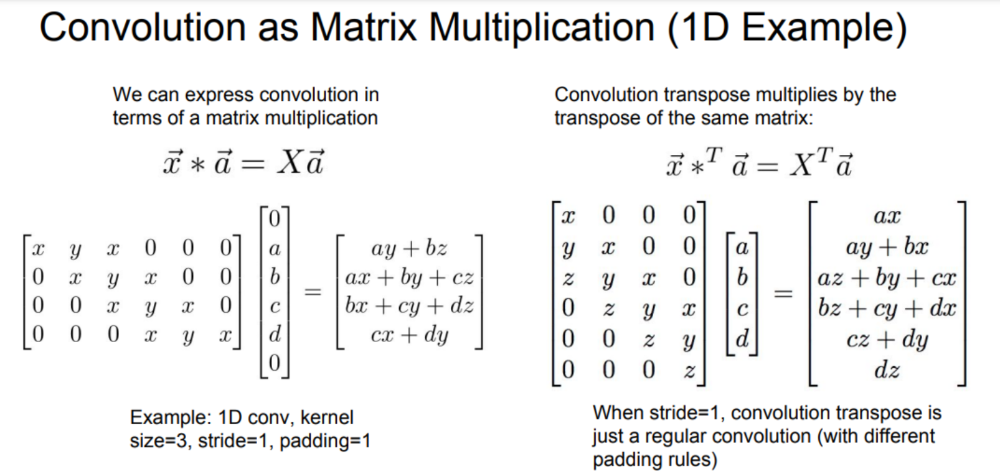

#### 11.2.7.4 **Learnable Upsampling: Transpose Convolution**
   - Unlike traditional methods like nearest neighbor or bilinear interpolation, transpose convolution is a learnable upsampling technique. This means that the parameters of the filter (used for upsampling) are learned during training. The network can optimize how it upsamples based on the specific features it needs to reconstruct. This makes transpose convolution more flexible and powerful compared to static, non-learnable upsampling methods, as it adapts to the data and the task at hand.

#### 11.2.7.5 **Deconvolution and Its Alternatives**
   - Deconvolution is a term often used interchangeably with transpose convolution, but it can be misleading. Deconvolution originally referred to the process of reversing convolution to recover original data, which is not exactly what transpose convolution does. In practice, transpose convolution works by expanding the input rather than directly reversing a convolution. Other alternatives to transpose convolution include upconvolution (which is similar in nature) and fractionally strided convolution, which provides finer control over the output resolution.

#### 11.2.7.6 **In-Network Upsampling: "Unpooling" Techniques**
   - "Unpooling" refers to a technique where the pooling operation is reversed. During a pooling operation (such as max pooling), information from multiple neighboring pixels is compressed into a single value (usually the maximum). In unpooling, the goal is to reconstruct the image by "unpooling" those values back into their spatial locations. This process often relies on storing the positions of the maximum values from the pooling layer, so the network knows where to place the unpooled values. This technique is crucial in networks that aim to recover fine details from downsampled images.

#### 11.2.7.7 **Max Unpooling**
   - Max unpooling is a specific form of unpooling that uses the positions of the maximum values from the pooling layer to guide the unpooling process. In max pooling, a region of the image is replaced by the maximum value, and during unpooling, the maximum values are placed back into their corresponding positions in a larger output space. This helps restore the high-level features of the original image while maintaining spatial resolution. Max unpooling is commonly used in tasks like segmentation, where preserving sharp boundaries and details is crucial.

#### 11.2.7.8 **Nearest Neighbor Upsampling**
   - Nearest neighbor upsampling is a simple and non-learnable technique for upsampling. It works by replicating the nearest pixel value to fill in the gaps when increasing the resolution of an image. This method is computationally cheap and fast, but it can introduce blocky artifacts, making it less suitable for tasks that require high-quality image generation. However, it is sometimes used when learnable upsampling methods like transpose convolution are not necessary or when speed is a priority.


| **Aspect**             | **Downsampling**                                                  | **Upsampling**                                                      |
|------------------------|-------------------------------------------------------------------|---------------------------------------------------------------------|
| **Definition**          | Reducing the resolution or size of an image or signal.            | Increasing the resolution or size of an image or signal.            |
| **Purpose**             | Reduce data size, simplify processing, and extract features.     | Increase resolution, restore details, or generate more data points. |
| **Method**              | Pooling, strided convolutions, averaging, or selecting specific points. | Transpose convolutions, interpolation (e.g., nearest neighbor, bilinear), unpooling. |
| **Applications**        | Feature extraction, data compression, noise reduction.            | Image generation (e.g., super-resolution), semantic segmentation, and resampling in audio. |
| **Effect on Resolution**| Reduces the resolution, leading to lower dimensionality.         | Increases the resolution, making the output larger or more detailed.|
| **Data Preservation**   | May discard some information (e.g., through pooling or averaging).| Creates new data points, often by interpolation or duplication.     |
| **Example in CNNs**     | Pooling layers (e.g., max pooling), strided convolutions.         | Transpose convolutions (deconvolutions), unpooling layers in FCNs. |
| **Visual Example**      | Compressing 4x4 to 2x2, keeping maximum values (e.g., from 1-2-3-4 to 6). | Expanding 2x2 to 4x4, filling new pixels with original values (e.g., from 6 to 6 6 8 8).|



## **11.3. Classification + Localization**


### **11.3.1. What is the Difference Between Image Classification and Classification + Localization?**

#### **Image Classification vs Classification + Localization**

##### **Theoretical Perspective:**
- **Image Classification** is the task of assigning a label or category to an entire image. In the context of autonomous driving, an image classification model can identify objects like pedestrians, vehicles, or road signs in an image but does not provide any spatial information about their locations within the image.

- **Classification + Localization** goes a step further by not only identifying objects (as in image classification) but also providing the spatial coordinates or bounding boxes around the detected objects. This additional spatial information allows the model to pinpoint the exact location of objects within an image, which is crucial for tasks like obstacle avoidance, path planning, and interaction with pedestrians and other vehicles.

Mathematically, the key difference between these tasks is the inclusion of spatial coordinates in the output of **Classification + Localization**. While classification only provides a label, classification + localization provides both a label and the position of the object, often represented as a bounding box.

##### **Mathematical Perspective:**
- In **Image Classification**, the model outputs a vector of class probabilities, `p(y|x)`, where `y` is the class label and `x` is the input image. The output is typically a single class label for the entire image:
  
```
p(y|x) = softmax(z)
```
Where `z` represents the raw output (logits) for each class.

- In **Classification + Localization**, the model predicts both the class label `y` and the spatial location of the object, typically as a bounding box represented by four coordinates `(x_min, y_min, x_max, y_max)`. This bounding box indicates the region of the image where the object is located. The model output in this case consists of both a classification vector and bounding box coordinates:

```
p(y|x) = softmax(z)

```
and

```
bbox = (x_min, y_min, x_max, y_max)
```
Where the bounding box is predicted in addition to the class probabilities.

#### **How Does Classification + Localization Combine Object Recognition with Positioning in Autonomous Driving?**

##### **Theoretical Perspective:**
In autonomous driving, **classification + localization** is critical for tasks like detecting pedestrians, vehicles, road signs, and obstacles while also knowing their exact locations in the environment. The ability to detect the presence and position of obstacles enables the vehicle to take appropriate actions, such as slowing down or steering away from obstacles.

For example, to localize pedestrians or obstacles, the system uses image processing to first classify the object (e.g., recognizing a pedestrian as the class) and then estimates the coordinates of the object within the image. This information is useful for **sensor fusion** tasks, where the camera, LiDAR, radar, and other sensors work together to build an accurate 3D map of the surroundings.

##### **Mathematical Perspective:**
In autonomous driving systems, classification + localization is typically performed using specialized networks like **YOLO (You Only Look Once)** or **Faster R-CNN**. These networks combine classification and localization into a single process.

For a given image `x`, the model predicts:
- A vector `y` representing the class probabilities (e.g., pedestrian, car, etc.).
- A bounding box `bbox = (x_min, y_min, x_max, y_max)` that describes the position of the object within the image.

This allows the vehicle to:
1. **Classify objects** in the scene, determining what the object is (e.g., pedestrian, vehicle).
2. **Localize objects** by providing precise coordinates or bounding boxes that allow the system to identify where objects are located in the environment.

The model is trained using a **combined loss function** that includes both the classification loss (e.g., cross-entropy) and the localization loss (e.g., smooth L1 loss or IoU loss):

```
L = L_classification + λ * L_localization
```
Where `λ` is a weighting factor that balances the classification and localization tasks.

By combining both, the system becomes capable of both recognizing and determining the exact position of objects in real-time, which is essential for autonomous driving decision-making.


#### **11.3.2.1. Classification + Localization**

#### **What is Classification + Localization?**

Classification + Localization is an advanced task in computer vision that involves not only identifying the objects within an image (as in classification) but also determining their spatial location through bounding boxes. This approach is crucial in various real-time applications such as autonomous driving, where it's not enough to just recognize an object; it's equally important to know where that object is located within the environment.

- **Classification**: The model predicts the class label of an object (e.g., car, pedestrian, road sign, etc.).
- **Localization**: The model provides the precise position of the object by predicting its bounding box, typically defined by four coordinates: (x_min, y_min, x_max, y_max), which represent the top-left and bottom-right corners of the object.

In **Classification + Localization**, both tasks are combined to enable the system to detect and localize objects in real-time, which is essential for tasks such as path planning, obstacle avoidance, and safe navigation.

![](https://viso.ai/wp-content/uploads/2024/04/bounding-boxes-OL.jpg)

#### **Theoretical Perspective**

The combination of classification and localization allows a model to address both **what** and **where**:
- **What**: The object is classified into a specific category (e.g., car, pedestrian, traffic light).
- **Where**: The model identifies the exact location of the object in the form of a bounding box, helping to localize it in the visual scene.

For autonomous driving, understanding both the **classification** and **localization** of objects in a given scene helps the vehicle make informed decisions, such as whether to slow down for a pedestrian or avoid a traffic cone on the road.

#### **How Does Classification + Localization Work?**

Classification + Localization typically involves using a **single deep learning model** that predicts both the class labels and bounding box coordinates simultaneously. This task can be addressed using Convolutional Neural Networks (CNNs), specifically designed architectures like **YOLO (You Only Look Once)** or **Faster R-CNN**, which combine these two functions in one framework.

In such architectures:
1. **Feature extraction** is done through CNN layers that capture spatial hierarchies and learn important features from the image.
2. **Classification** is performed by predicting a class label for each object in the image.
3. **Localization** is achieved by regressing the coordinates of the bounding box that surrounds each detected object.

The model is usually trained with a **loss function** that combines both the classification loss and the localization loss, ensuring the model performs well in both tasks.

- **Classification Loss** (typically Cross-Entropy Loss): Measures how well the predicted class labels match the true labels.
- **Localization Loss** (often Smooth L1 Loss or IoU Loss): Measures how well the predicted bounding boxes match the ground truth bounding boxes.

Mathematically, the overall loss function can be written as:

```
L = L_classification + λ * L_localization
```

Where:
- `L_classification` is the loss for classifying the object.
- `L_localization` is the loss for localizing the object.
- `λ` is a hyperparameter that adjusts the balance between the two losses.

#### **Importance of Classification + Localization in Autonomous Driving**

For autonomous driving, classification + localization is essential for:
- **Pedestrian Detection**: Identifying pedestrians and determining their exact position on the road so that the vehicle can safely navigate around them.
- **Obstacle Avoidance**: Detecting and localizing obstacles such as parked cars, debris, or road signs to avoid collisions.
- **Traffic Sign Recognition**: Recognizing traffic signs (e.g., stop signs, speed limits) and determining their location relative to the vehicle to follow the road rules.
- **Lane Detection**: Detecting lane markings on the road and localizing their position to keep the vehicle centered in the lane.

Having both the classification and the bounding box coordinates allows the system to not only identify objects but also determine their relative position in space, facilitating tasks like **collision avoidance**, **path planning**, and **environmental mapping**.

#### **Mathematical and Coding Perspective**

From a coding perspective, implementing classification + localization typically involves using pre-trained models or frameworks like **YOLO**, **Faster R-CNN**, or **SSD** (Single Shot MultiBox Detector), which can detect and localize multiple objects in an image simultaneously. These models are typically trained using large annotated datasets where each object in an image is labeled with both a class and a bounding box.

The model outputs both:
- **Class probabilities** for each object.
- **Bounding box coordinates** (x_min, y_min, x_max, y_max) that specify the object's location in the image.

For example, in **YOLO**, the model divides the image into a grid and predicts the bounding boxes and class labels for each grid cell. The output consists of class probabilities and bounding box coordinates for all objects detected in the image.

#### **Summary**

- **Classification + Localization** combines both object recognition (classification) and object positioning (localization) into a single model.
- It's essential in autonomous driving for detecting and localizing objects such as pedestrians, vehicles, road signs, and obstacles.
- The task is typically tackled using CNN-based models, with a combined loss function that optimizes for both classification accuracy and bounding box precision.
- This combination of **what** (classification) and **where** (localization) allows autonomous vehicles to make more informed decisions and navigate safely through complex environments.

#### **11.3.2.2. Object and Image Localization in Computer Vision**

Object and Image Localization are key tasks in Computer Vision (CV). They involve identifying and locating specific objects within digital images or videos.

![](https://viso.ai/wp-content/uploads/2024/04/occlusion-handling-spatial-network.jpg)

##### **Object Localization vs. Image Localization**
- **Object Localization**: The process of identifying a specific object and marking its location within an image using bounding boxes or segmentation masks.
- **Image Localization**: Involves identifying all objects present in the image and localizing them within a bounding box.

##### **Applications of Object Localization**
- **Security and Surveillance**: Detecting and localizing individuals or vehicles.
- **Autonomous Vehicles**: Recognizing pedestrians, other vehicles, and obstacles for safe navigation.
- **Medical Imaging**: Identifying tumors, organs, or abnormalities in medical scans.
- **Sports Analytics**: Detecting players, balls, and events within a game.
- **Robotics**: Enabling robots to interact with objects by localizing them.

##### **Challenges in Object and Image Localization**
- **Clutter and Background Noise**: Objects may be difficult to identify due to distracting elements in the background.
- **Object Variability**: Different shapes, sizes, and colors of objects can complicate the localization task.
- **Occlusion**: Objects partially hidden behind other objects can be difficult to detect accurately.
- **Scale and Perspective**: Objects appearing at different scales or angles pose challenges in localization.

##### **Steps in Object Localization**
1. **Object Detection**:
   - Deep learning models, such as CNNs and Region-based CNNs (R-CNN), are used to detect potential objects.
2. **Bounding Box Prediction**:
   - Once an object is detected, algorithms predict the coordinates of a bounding box around it.
3. **Instance Segmentation**:
   - For more precise localization, algorithms perform instance segmentation to segment objects pixel by pixel.
4. **Feature Extraction**:
   - Algorithms extract visual features (such as color, texture, and shape) to improve object localization.
5. **Post-Processing**:
   - Redundant bounding boxes are removed using techniques like Non-Maximum Suppression (NMS).
   
##### **Key Models and Techniques in Object Localization**
- **Convolutional Neural Networks (CNNs)**: Essential for feature extraction and object recognition.
- **Region-based CNNs (R-CNN)**: Detects objects using selective search to propose potential object regions.
- **YOLO (You Only Look Once)**: A real-time object detection system that directly predicts bounding boxes and class probabilities from an image.
- **Faster R-CNN**: An improved version of R-CNN that uses Region Proposal Networks (RPN) for faster and more accurate object localization.

##### **Evaluation Metrics**
- **Intersection over Union (IoU)**: Measures the overlap between the predicted and actual bounding boxes.
- **Mean Average Precision (mAP)**: Used to evaluate the precision of object detection and localization.

##### **Multiple Object Localization**
One advanced approach to object localization is **Multiple Object Localization with Self-supervised Transformers (MOST)**. It can detect and localize multiple objects without requiring labeled data for training. MOST leverages a transformer network and self-supervised learning techniques like **DINO (Distillation with No Labels)**.

##### **Applications of Object Localization**
1. **Retail and Marketing**: Tracking customer behavior and product placement in stores.
2. **Healthcare**: Detecting health issues like tumors in X-ray or MRI scans.
3. **Augmented Reality (AR)**: Integrating virtual objects into the real world by localizing them in live footage.
4. **Industrial Automation**: Automating quality control and inspection processes by detecting defects in products.
5. **Facial Recognition**: Identifying and locating faces in security footage or personal devices.

##### **Conclusion**
Object and Image Localization are critical tasks for modern AI applications across various industries, including security, healthcare, and autonomous driving. Techniques such as CNNs, R-CNNs, and YOLO have been instrumental in making localization more accurate and efficient. By leveraging advanced methods like instance segmentation and self-supervised transformers, the field continues to advance toward more robust and scalable localization solutions.



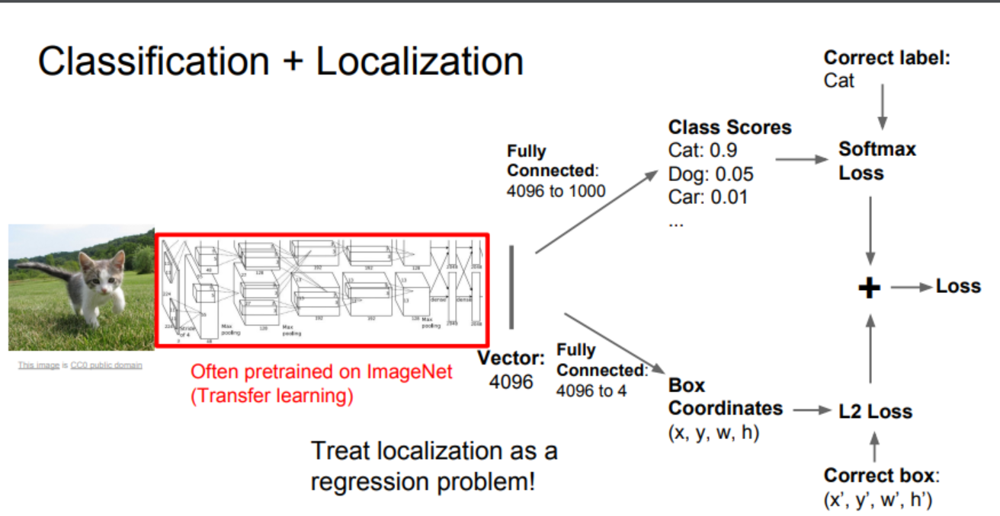

### **11.3.2. What are the key challenges in adding localization to classification?**

Adding localization to classification tasks introduces several complexities, particularly when the model is expected to both identify the object and predict its exact location. This is especially critical in applications like road navigation systems, autonomous driving, and object detection in images. Below are the key challenges faced in integrating localization with classification:

#### **1. Increased Model Complexity**
- **Challenge**: When combining object classification with localization, the model needs to handle multiple outputs: one for class labels and one for the coordinates of bounding boxes or segmentation masks.
- **Impact**: This significantly increases the complexity of the model, requiring more sophisticated architectures and larger datasets for training. For example, a model needs to not only classify a vehicle in an image but also predict where the vehicle is located (bounding box coordinates).

#### **2. Balancing Classification and Localization**
- **Challenge**: In many cases, the model is asked to solve two tasks simultaneously: classification (recognizing what the object is) and localization (determining where it is located). The model needs to strike a balance between these tasks, as focusing too much on one can negatively affect the other.
- **Impact**: For instance, in road navigation systems, if the model heavily focuses on detecting the presence of obstacles (classification), it might struggle to localize them accurately, or vice versa.

#### **3. Handling Varying Object Scales and Positions**
- **Challenge**: Objects in images (or in road navigation systems) can appear at different scales, angles, and positions, making localization harder. A single model must generalize well across these variations while still performing accurate classification and localization.
- **Impact**: In autonomous vehicles, for example, objects like pedestrians, other vehicles, and traffic signs can appear in various sizes and orientations. The model must accurately localize and classify these objects regardless of how they appear in different scenarios.

#### **4. Ambiguity in Object Boundaries**
- **Challenge**: Sometimes, objects may not have clear boundaries, especially when they are partially occluded or overlapping with other objects. This can lead to inaccurate bounding box predictions.
- **Impact**: In road navigation, this could mean that a model fails to identify and localize a pedestrian or another vehicle accurately due to partial occlusion, leading to safety concerns.

#### **5. Computational Resources and Real-Time Constraints**
- **Challenge**: Combining localization and classification requires more computation and memory resources. This becomes particularly challenging in real-time applications like autonomous vehicles, where decisions need to be made quickly.
- **Impact**: Models must be optimized to process data in real-time while maintaining high accuracy in both classification and localization tasks. This requires efficient architectures, such as lightweight models for edge devices or real-time object detection systems.

#### **6. Training Data Requirements**
- **Challenge**: Effective training of models that handle both classification and localization requires large, well-annotated datasets with not only object categories but also precise location information (bounding boxes or segmentation masks).
- **Impact**: Collecting and annotating such datasets can be expensive and time-consuming. For road navigation systems, it may require hours of footage with detailed annotations for objects in the environment.

#### **7. Intersection of Detection and Tracking**
- **Challenge**: In systems that involve object detection and localization (e.g., road navigation for autonomous vehicles), objects must not only be detected and localized but also tracked over time. This adds a temporal dimension to the problem, where the model must keep track of object locations as they move.
- **Impact**: This is particularly challenging for objects like vehicles in motion, which may shift in position or scale from one frame to another. Integrating real-time tracking with classification and localization requires advanced algorithms that can maintain accuracy over time.

#### **How does the model handle both classifying the object and predicting its location (e.g., in road navigation systems)?**

Models that combine both classification and localization typically employ architectures that are specifically designed to handle multi-task learning. These models have two or more outputs:
- **Classification output**: This provides the predicted class label (e.g., pedestrian, car, traffic light) for each object detected in the image or scene.
- **Localization output**: This provides the predicted location of the object, typically in the form of a bounding box with coordinates (x, y, width, height) or a segmentation mask.

In road navigation systems, for example:
- **Object Detection Networks**: These networks, such as **YOLO (You Only Look Once)** or **Faster R-CNN**, are capable of simultaneously performing classification and localization. YOLO, for instance, divides the image into a grid and predicts class probabilities and bounding box coordinates for each grid cell.
- **Region Proposal Networks (RPNs)**: In architectures like **Faster R-CNN**, RPNs generate proposals for possible object locations, which are then refined to produce the final bounding boxes, while a classifier assigns class labels.
- **Multi-Task Learning**: This technique allows the model to simultaneously learn the relationships between different tasks (classification and localization) through shared feature extraction layers, improving overall performance.

By leveraging these architectures and optimization techniques, models can efficiently handle both tasks, ensuring that both classification and localization are performed with high accuracy and efficiency.



### **11.3.3. What models are commonly used for object localization tasks in autonomous vehicles?**

#### **1. YOLO (You Only Look Once)**
- **Theoretical Perspective:** YOLO is a real-time object detection algorithm that performs both classification and localization in a single pass over the image. YOLO divides an image into a grid, and for each grid cell, it predicts a set of bounding boxes, each with an associated class probability and a confidence score. YOLO is designed to be fast and efficient, making it ideal for real-time applications like autonomous driving. It directly outputs the class labels and bounding boxes in one unified framework.

- **How It Works for Localization in Autonomous Vehicles:**
  In autonomous driving, YOLO is used to detect objects like pedestrians, vehicles, traffic lights, road signs, etc. It outputs the coordinates of bounding boxes surrounding these objects along with their predicted class labels, enabling the system to understand both the type and location of objects in the vehicle's environment.

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/0*xfXdebLeaMXt3Vct)

#### **2. Faster R-CNN (Region Convolutional Neural Network)**
- **Theoretical Perspective:** Faster R-CNN is a two-stage object detection model that first generates potential object proposals using a **Region Proposal Network (RPN)** and then classifies and refines these proposals. The RPN efficiently generates region proposals, which are then fed into the second stage (the Fast R-CNN detector) for final classification and bounding box regression. Faster R-CNN is known for its higher accuracy compared to other models like YOLO, especially when objects are small or overlapping.

![](https://production-media.paperswithcode.com/methods/Screen_Shot_2020-05-24_at_5.10.31_PM.png)

- **How It Works for Localization in Autonomous Vehicles:**
  Faster R-CNN is well-suited for detecting and localizing objects in complex scenes, such as traffic environments, where multiple objects (cars, pedestrians, cyclists) are present. It is more accurate than YOLO, especially in scenarios with small or overlapping objects, making it useful for detecting pedestrians and other traffic participants in the vehicle's path.

![](https://www.researchgate.net/profile/Zhipeng-Deng-2/publication/324903264/figure/fig2/AS:640145124499471@1529633899620/The-architecture-of-Faster-R-CNN.png)

#### **3. SSD (Single Shot Multibox Detector)**
- **Theoretical Perspective:** SSD is a single-stage object detection model that generates bounding boxes and class labels in one pass through the network. Unlike Faster R-CNN, SSD uses multiple feature maps at different resolutions to detect objects of various sizes and scales in the image. SSD is designed to be faster than Faster R-CNN and can handle real-time object localization, which is important for dynamic and rapidly changing environments like autonomous driving.

- **How It Works for Localization in Autonomous Vehicles:**
  SSD is used to detect and localize objects like pedestrians, vehicles, and road signs in real-time. Its ability to handle objects of varying scales and its speed make it suitable for dynamic environments where immediate action is needed. SSD is commonly used in autonomous driving for detecting objects in traffic scenarios.




#### **11.3.3.1 Localization VS Detection**

| **Aspect**             | **Localization**                                        | **Detection**                                             |
|------------------------|---------------------------------------------------------|-----------------------------------------------------------|
| **Definition**          | Identifying the location of a specific object in an image. | Identifying and classifying multiple objects in an image, with their locations. |
| **Main Goal**           | Find the position (bounding box) of an object.          | Find multiple objects, classify them, and localize them (bounding boxes). |
| **Task**                | Typically involves identifying one object in an image.  | Involves detecting multiple objects of different classes. |
| **Example Task**        | Locate a car in an image.                              | Detect and classify cars, pedestrians, and bicycles in an image. |
| **Output**              | Coordinates of the bounding box around the object.     | Multiple bounding boxes with class labels (e.g., car, person) and their coordinates. |
| **Common Models**       | - Regression-based methods (e.g., SSD, Faster R-CNN)   | - YOLO (You Only Look Once)                                |
|                        | - R-CNN (Region-based Convolutional Networks)           | - Faster R-CNN (Region-based CNN)                         |
|                        | - Single Shot Multibox Detector (SSD)                   | - RetinaNet                                                |
|                        | - YOLO (in some cases, for bounding box localization)   | - Mask R-CNN (for segmentation + detection)                |
| **Output Format**       | Single bounding box coordinates.                        | Multiple bounding boxes with labels (and possibly confidence scores). |
| **Use Cases**           | - Face localization in images.                         | - Object detection in surveillance (cars, people, etc.). |
|                        | - Hand gesture localization.                           | - Autonomous driving (detecting obstacles, road signs, etc.). |
| **Example Dataset**     | - PASCAL VOC (for localized objects)                   | - COCO (Common Objects in Context for detection tasks)    |
| **Evaluation Metrics**  | - Mean Average Precision (mAP)                         | - Intersection over Union (IoU), Average Precision (AP), Recall, F1 Score |
| **Complexity**          | Typically simpler (one object at a time).               | More complex due to multiple objects and class prediction. |

##### Key Models for Localization:
1. **R-CNN (Region-based CNN)**: First used for object localization by proposing candidate regions and applying CNNs to each region.
2. **YOLO (You Only Look Once)**: Although a detection model, YOLO can also be used for object localization by providing bounding boxes around objects.

##### Key Models for Detection:
1. **YOLO (You Only Look Once)**: A real-time object detection model that detects objects and their locations (bounding boxes) in one pass.
2. **Faster R-CNN**: Uses region proposal networks (RPNs) to generate proposals, followed by CNNs to classify objects and refine bounding boxes.
3. **RetinaNet**: Focuses on addressing the class imbalance problem in detection tasks, using a focal loss function.
4. **Mask R-CNN**: Extends Faster R-CNN to not only detect objects but also segment them (i.e., generate a pixel-wise mask in addition to the bounding box).

### **11.3.4. How is non-maximum suppression (NMS) used in object localization?**

Non-maximum suppression (NMS) is a key technique in object detection and localization tasks used to improve the accuracy of predictions by eliminating redundant or overlapping bounding boxes. It is particularly important in scenarios like autonomous vehicles, where detecting objects accurately is crucial for safety and decision-making. Below is a detailed explanation of what NMS is and how it reduces overlapping bounding boxes in localization tasks.

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*Yu99rVPCZNaCPNqYpTeiFw.png)

#### **What is NMS?**
Non-maximum suppression (NMS) is an algorithm used to filter out multiple bounding boxes that correspond to the same object in an image. In object detection tasks, models often generate several bounding box predictions for the same object, each with a different confidence score. NMS helps to reduce these redundant boxes, ensuring that only the most accurate and relevant one is retained.

![](https://miro.medium.com/v2/resize:fit:750/format:webp/1*_e0_aPNQao8IK92oP0oHyw.png)

NMS operates by following these key steps:
1. **Sort the bounding boxes**: First, the bounding boxes are sorted by their confidence scores (i.e., how confident the model is that the box contains the correct object).
2. **Select the box with the highest score**: The bounding box with the highest confidence score is selected as the reference.
3. **Eliminate overlapping boxes**: For each remaining bounding box, NMS computes the intersection over union (IoU) with the reference box. If the IoU is higher than a predefined threshold (e.g., 0.5), the box is discarded, as it likely represents the same object.
4. **Repeat the process**: This process is repeated until all bounding boxes have been processed and only the best boxes remain.

#### **How does NMS reduce overlapping bounding boxes?**
In object localization tasks, especially when dealing with dense objects or closely spaced objects (such as pedestrians or vehicles in traffic), multiple bounding boxes might be predicted for the same object. NMS helps to reduce this by:
- **Removing duplicate detections**: By comparing the IoU of predicted bounding boxes, NMS ensures that overlapping boxes with low confidence are discarded, leaving only the best prediction for each object.
- **Ensuring a single, precise bounding box per object**: This is crucial in applications like autonomous vehicles, where an object should only be detected once to avoid confusion in further processing tasks (e.g., navigation, obstacle avoidance).

#### **Improving detection accuracy in autonomous vehicles with NMS**
In the context of autonomous vehicles, accurate object detection is vital for making decisions about navigation, collision avoidance, and safe operation. Here's how NMS contributes to better detection:
1. **Eliminating false positives**: NMS reduces the likelihood of detecting multiple boxes for the same object, which can lead to false positives (e.g., detecting the same pedestrian or vehicle multiple times).
2. **Improving object tracking**: With only one bounding box per object, it becomes easier for subsequent algorithms (such as tracking and motion prediction) to track objects as they move in the vehicle's environment.
3. **Enhancing computational efficiency**: By reducing the number of bounding boxes that need to be processed, NMS improves the overall efficiency of the detection system, allowing it to focus on the most relevant predictions.
4. **Precision in safety-critical applications**: For autonomous vehicles, precise object localization ensures that critical safety systems, such as emergency braking or lane-keeping assistance, work correctly. NMS helps to ensure that the system's decision-making process is based on the most accurate representation of the objects in the scene.

#### **Example: Autonomous Vehicle Use Case**
Imagine an autonomous vehicle navigating a busy street where multiple cars and pedestrians are present. Without NMS, the object detection system might generate multiple bounding boxes for the same vehicle, making it unclear which box to follow. By applying NMS, the system filters out these duplicates and keeps only the most accurate box for each vehicle. This results in a clearer understanding of the scene and enables better decision-making for tasks such as avoiding collisions and maintaining a safe distance from other road users.

In summary, non-maximum suppression (NMS) plays a critical role in object localization by reducing redundant bounding boxes and ensuring that only the most relevant detections are retained. This improves detection accuracy, computational efficiency, and ultimately the safety and reliability of systems like autonomous vehicles.


## **11.4. Object Detection**


### **11.4.1. What is object detection and how does it combine classification and localization in autonomous vehicles?**

Object detection is a critical task in computer vision, particularly for autonomous vehicles, as it involves identifying and localizing multiple objects within an image. This dual capability enables autonomous systems to understand their environment and make safe, informed driving decisions.

#### **How does object detection predict both the class and bounding box of objects (e.g., vehicles, pedestrians, traffic lights) in an image?**

- **Classification and Localization**:
  - Object detection extends beyond simple image classification by not only identifying the class of objects (e.g., vehicle, pedestrian, traffic light) but also predicting their spatial location within the image.

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*0XWGBhIeOqfhsR8qa5pi1A.png)

  - For each detected object, the model generates a bounding box, which is a rectangular region surrounding the object. This box is defined by coordinates (e.g., top-left corner and bottom-right corner) and may also include confidence scores for both the class and location predictions.

- **How It Works**:
  - Models for object detection, such as **YOLO (You Only Look Once)**, **SSD (Single Shot Detector)**, and **Faster R-CNN**, use a combination of convolutional neural networks (CNNs) and region proposal methods to simultaneously predict object classes and bounding boxes.
  - These models divide the input image into a grid or use region proposals to identify areas likely to contain objects. Each region is then processed to classify the object and refine its bounding box coordinates.

![](https://miro.medium.com/v2/resize:fit:1200/format:webp/1*DlOea48Y9zPwW2jLWxzKpQ.gif)

- **Relevance to Autonomous Vehicles**:
  - Object detection is essential for identifying critical elements in the driving environment, such as other vehicles, pedestrians, traffic signs, and signals. This capability allows the vehicle to make real-time decisions about navigation, obstacle avoidance, and traffic law compliance.

> To teach a machine to localize objects, we introduce additional labels. These include:
>  - **Object Probability (pc):** A binary indicator (1 or 0) denoting whether the object or objects of interest is present in the image.
 - **Bounding Box Parameters:** If an object is present (pc = 1), the machine learns the specific coordinates (bx, by) and dimensions (bh, bw) of the bounding box.
 - **Class Labels:** Indicating the category of the object (e.g., car, pedestrian), these labels provide a comprehensive understanding of the object’s identity.

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*A3ZMYuqkMDxmf5ZK4jAQUQ.png)

#### **How does object detection extend image classification to multi-object identification, which is crucial for driving in complex environments?**

- **Multi-Object Identification**:
  - Unlike image classification, which assigns a single label to an entire image, object detection allows the identification of multiple objects within the same image, each with its own class label and bounding box. This is vital for autonomous vehicles operating in dynamic and cluttered environments, such as busy intersections or highways.

- **Handling Overlapping Objects**:
  - In real-world driving scenarios, objects often overlap or occlude one another. Object detection models use techniques like **Non-Maximum Suppression (NMS)** to reduce redundant bounding boxes and accurately identify individual objects in such cases.

- **Scalability**:
  - Object detection models are designed to handle diverse object types and scales. For example, a single frame may contain large objects like vehicles and small ones like traffic signs or distant pedestrians, requiring robust detection capabilities.

#### **Significance for Autonomous Vehicles**:

- **Safety**: Real-time object detection ensures that vehicles can identify potential hazards, such as pedestrians crossing the street or sudden stops by other vehicles, enabling timely responses.
- **Navigation**: Detection of lanes, traffic signs, and signals allows vehicles to follow road rules and navigate complex environments safely.
- **Efficiency**: Advanced object detection algorithms provide accurate results with minimal latency, ensuring that decisions are made promptly during driving.

In summary, object detection is a foundational technology for autonomous vehicles, combining the strengths of classification and localization to enable multi-object identification in complex, real-world environments. By predicting both the class and location of objects, it ensures safe and efficient operation in diverse driving scenarios.


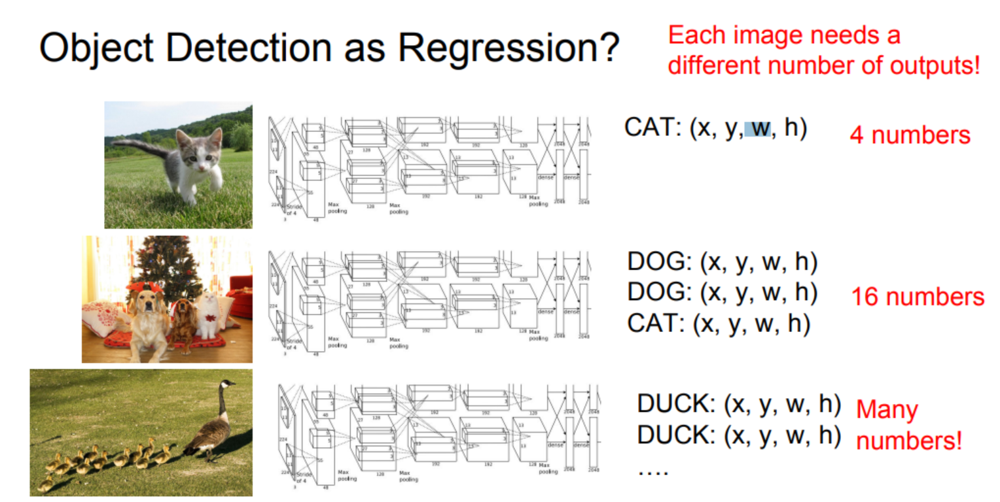

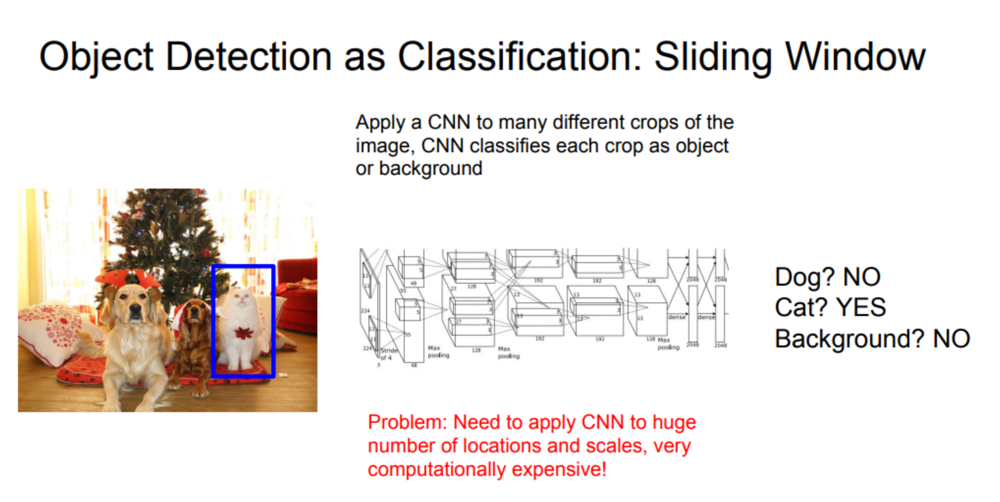

### **11.4.1.1. Understanding Region Proposals, Sliding Window, and Object Detection as Regression**

#### 1. Sliding Window Technique
##### What it is:
A brute-force method where a fixed-size window slides over the entire image at different scales and positions. Each window is analyzed to determine if it contains an object of interest.

##### How it works:
1. The image is divided into overlapping patches of different sizes.
2. Each patch is sent to a classifier (e.g., SVM, CNN) to check if it contains an object.

##### Challenges:
- Computationally expensive since it processes many redundant windows.
- Poor scalability to high-resolution images.
- Fixed window sizes make it less adaptive to varying object shapes and sizes.

#### 2. Region Proposals
##### What it is:
A more efficient alternative to the sliding window. Region proposal methods generate a smaller set of candidate regions (bounding boxes) likely to contain objects, reducing the computational burden.

##### Types of Region Proposal Methods:
- **Selective Search**: Combines regions based on similarity in texture, color, and size.
- **EdgeBoxes**: Uses edge responses to score regions.
- **Region Proposal Networks (RPN)**: Neural network-based methods that predict regions directly from the image (used in Faster R-CNN).

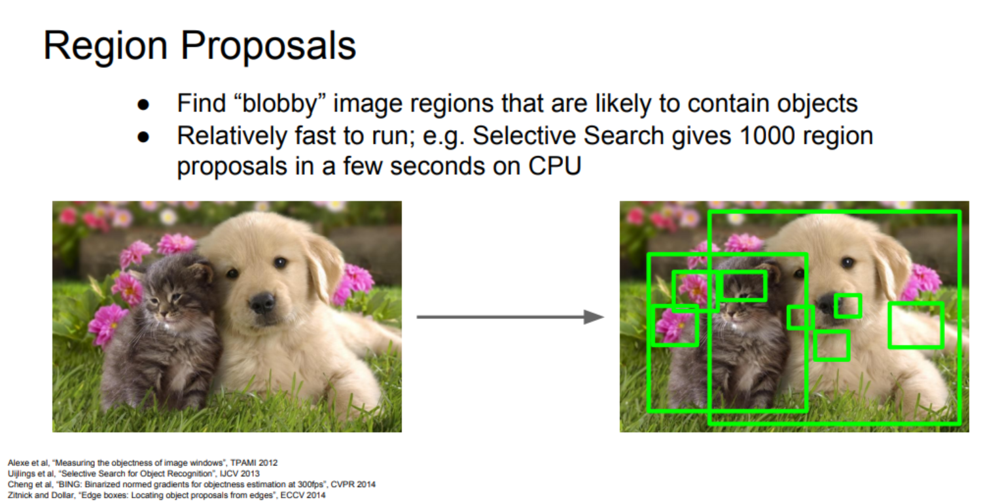

##### Advantages:
- Reduces the number of regions to analyze.
- Focuses on areas with higher chances of containing objects.

#### 3. Object Detection as Regression
##### What it is:
Reformulates object detection as a regression problem where the goal is to directly predict bounding box coordinates and class probabilities for objects.

##### Approaches:
- Instead of generating regions or using sliding windows, modern methods predict bounding boxes directly in one pass.
- Algorithms like **YOLO (You Only Look Once)** and **SSD (Single Shot MultiBox Detector)** divide the image into a grid and regress bounding box coordinates along with object classes.

#### 4. How They Relate:
##### Sliding Window → Region Proposals:
- Sliding windows exhaustively scan the image but are inefficient.
- Region proposals optimize this by focusing only on the most promising regions.
- Region proposals are often considered a smart sampling mechanism inspired by sliding windows.

##### Region Proposals → Object Detection as Regression:
- Traditional region proposal methods (e.g., Selective Search) involve two stages: region generation and classification.
- Regression-based approaches (e.g., YOLO, SSD) skip region proposals entirely, predicting bounding boxes and classes directly from the image in one stage.
- **Faster R-CNN** integrates region proposals with regression: it uses an RPN for proposals and a second stage for refinement.


#### 5. Summary of Evolution:
1. **Sliding Window**: Analyze all regions (inefficient).
2. **Region Proposals**: Focus on fewer, promising regions (more efficient).
3. **Regression-Based Object Detection**: Predict bounding boxes and labels directly without intermediate region proposals (fastest and most modern).


### **11.4.2. What are the popular deep learning architectures for object detection in autonomous driving?**

Object detection in autonomous driving relies on advanced deep learning architectures that balance speed and accuracy. These models are tailored to the dynamic and complex nature of driving environments, where rapid and precise object detection is essential.


#### **Comparison of Architectures**:

| Model           | Speed        | Accuracy      | Suitability for Autonomous Driving |
|------------------|--------------|---------------|-------------------------------------|
| **YOLO**        | Very fast    | Moderate-High | Real-time detection, quick reactions |
| **Faster R-CNN**| Moderate     | High          | High accuracy, handles occlusions well |
| **SSD**         | Fast         | High          | Balanced speed and accuracy, multi-object scenarios |

In conclusion, YOLO, Faster R-CNN, and SSD are three popular architectures for object detection in autonomous driving. Each offers unique strengths, from YOLO’s real-time performance to Faster R-CNN’s precision and SSD’s scalability, ensuring robust detection in diverse driving environments.



#### **How does YOLO (You Only Look Once) achieve real-time object detection for autonomous vehicles on the road?**

- **Overview of YOLO**:
  - YOLO is a state-of-the-art object detection model designed for real-time applications. It divides the input image into a grid and predicts bounding boxes and class probabilities simultaneously for each grid cell.
  - Unlike traditional models that use region proposals, YOLO treats object detection as a regression problem, enabling faster inference.

- **Advantages for Autonomous Driving**:
  - **Real-Time Performance**: YOLO achieves high-speed detection, making it suitable for applications requiring rapid decision-making, such as collision avoidance or pedestrian detection.
  - **Single-Pass Detection**: The entire image is processed in a single pass, reducing computational complexity and latency.
  - **Generalization**: YOLO performs well on varied driving scenarios, such as urban streets and highways.

- **Challenges**:
  - While fast, earlier YOLO versions may struggle with detecting smaller or overlapping objects, although later versions (e.g., YOLOv4, YOLOv5) have significantly improved accuracy.



#### **What is Faster R-CNN and how does it improve detection speed and accuracy in vehicle detection tasks?**

- **Overview of Faster R-CNN**:
  - Faster R-CNN is a two-stage detection model combining region proposal methods with CNNs. It introduces the Region Proposal Network (RPN), which generates high-quality region proposals, significantly improving efficiency over previous R-CNN versions.
  - The second stage refines these proposals and classifies objects.

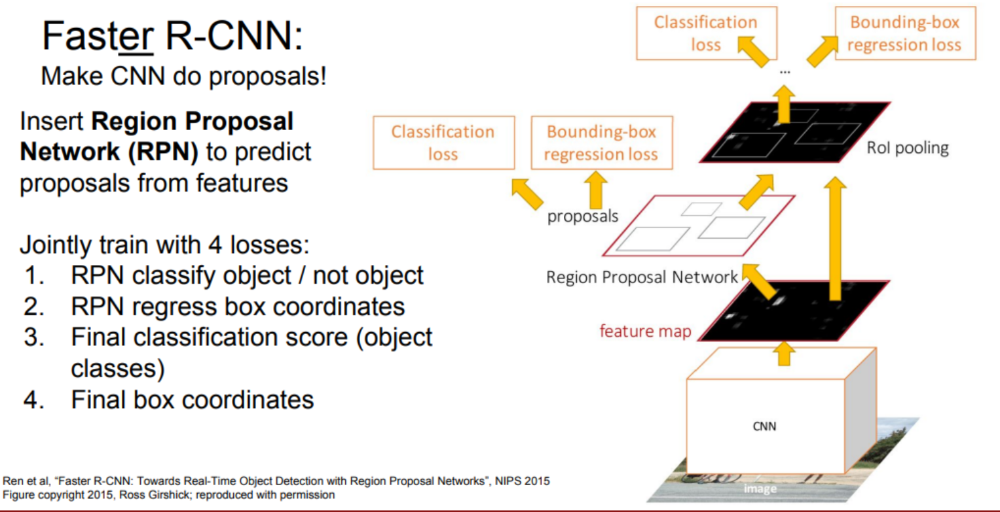

- **Advantages for Autonomous Driving**:
  - **High Accuracy**: Faster R-CNN excels in detecting small or overlapping objects, making it ideal for complex environments, such as crowded intersections or busy highways.
  - **Customizability**: Its modular design allows for fine-tuning specific components for targeted detection tasks.

- **Trade-Offs**:
  - Slower than real-time models like YOLO, Faster R-CNN may require optimization for deployment in latency-sensitive scenarios.


![](https://wiki.cloudfactory.com/media/pages/docs/mp-wiki/model-architectures/faster-r-cnn/d1436cdae7-1684131962/image-15.webp)



#### **What is SSD (Single Shot Multibox Detector) and how does it improve detection performance for multiple objects in driving scenarios?**

- **Overview of SSD**:
  - SSD is a one-stage object detection model that predicts bounding boxes and class labels directly from feature maps without region proposals.
  - It employs multi-scale feature maps and default boxes to detect objects of various sizes, ensuring robust detection across scales.

- **Advantages for Autonomous Driving**:
  - **Speed and Efficiency**: SSD is faster than Faster R-CNN while maintaining competitive accuracy, making it suitable for real-time applications like obstacle detection.
  - **Multi-Object Detection**: SSD is adept at detecting multiple objects in a single frame, which is crucial for understanding complex driving scenes.
  - **Scalability**: By using feature maps at different resolutions, SSD handles objects of diverse sizes effectively, from distant traffic lights to nearby pedestrians.

- **Challenges**:
  - Slightly less accurate than Faster R-CNN for smaller objects, though subsequent improvements (e.g., SSD512) address this limitation.

### **11.4.4. How does YOLO work for real-time object detection?**

YOLO (You Only Look Once) is a cutting-edge object detection model designed for high-speed and accurate detection, making it a cornerstone in autonomous driving systems where real-time decision-making is crucial.

#### **How does YOLO detect objects (e.g., pedestrians, other vehicles) in a single forward pass, crucial for autonomous driving?**

- **Single Forward Pass**:
  - YOLO divides the input image into a grid (e.g., 13x13 or larger for higher resolution) and assigns each grid cell the task of predicting bounding boxes and class probabilities.
  - Each grid cell predicts:
    - **Bounding Boxes**: Defined by their coordinates \((x, y, w, h)\), where \(x, y\) are the center coordinates, and \(w, h\) are the width and height relative to the image dimensions.
    - **Class Probabilities**: The likelihood of the object in the bounding box belonging to specific classes (e.g., car, pedestrian, traffic light).

- **Unified Detection**:
  - Unlike traditional models that separate object detection into region proposal and classification, YOLO performs both simultaneously, treating detection as a regression problem.
  - This unification ensures faster detection by avoiding redundant computations.

- **Predicting Multiple Objects**:
  - Each grid cell can predict multiple bounding boxes with confidence scores, indicating the likelihood of an object being present and the quality of the bounding box.

#### **How does YOLO optimize for real-time performance in object detection tasks on the road?**

- **End-to-End Training**:
  - YOLO is trained end-to-end, optimizing for both bounding box prediction and class probabilities in a single neural network pass. This reduces overhead compared to multi-stage detection systems.

- **Shared Computations**:
  - YOLO leverages shared computations across the entire image, reducing redundancy and enhancing processing speed. Features are extracted using convolutional layers, which process the image globally instead of focusing on individual regions.

- **Real-Time Performance**:
  - YOLO achieves impressive speeds, processing up to 45 frames per second (FPS) in its original version and over 100 FPS in lightweight versions like Tiny-YOLO. This capability ensures timely responses for safety-critical tasks in autonomous driving.

- **Trade-Offs for Speed**:
  - YOLO’s design prioritizes speed, which sometimes leads to reduced accuracy in detecting smaller or overlapping objects. However, newer versions (e.g., YOLOv4, YOLOv5) have introduced improvements to mitigate these issues.

#### **Why is YOLO ideal for autonomous driving?**

- **Timely Decisions**:
  - Autonomous vehicles rely on split-second decisions to avoid collisions, recognize traffic signals, and navigate safely. YOLO’s real-time capabilities align perfectly with these requirements.

- **Versatility**:
  - YOLO is effective across various driving scenarios, detecting diverse objects like pedestrians, vehicles, cyclists, and road signs, making it a comprehensive solution for dynamic environments.

- **Improved Versions**:
  - Subsequent iterations, such as YOLOv4 and YOLOv5, have enhanced detection accuracy, robustness, and scalability while maintaining real-time performance, ensuring YOLO remains a leader in object detection for autonomous systems.

In summary, YOLO’s ability to detect objects in a single forward pass, coupled with its optimization for real-time performance, makes it a pivotal tool in autonomous driving. It enables fast, accurate detection of vehicles, pedestrians, and other objects, supporting the safe and efficient operation of self-driving cars.


### **11.4.5. What is mAP (Mean Average Precision) and How is it Used to Evaluate Object Detection?**

#### **Understanding Mean Average Precision (mAP): A Comprehensive Guide**

**Mean Average Precision (mAP)** is a metric commonly used to evaluate the performance of object detection and segmentation systems. It helps measure how well a model detects and classifies objects within an image, often used in models like Faster R-CNN, MobileNet SSD, and YOLO, among others. mAP is a key evaluation metric in benchmark challenges such as Pascal VOC, COCO, and others.

### What is Mean Average Precision (mAP)?

mAP is used to evaluate object detection models. It is the average of **Average Precision (AP)** values across different classes, measured across various thresholds of recall (from 0 to 1).

### Key Sub-Metrics Involved in mAP Calculation:

1. **Confusion Matrix**:
   - **True Positives (TP)**: Correct predictions that match the ground truth.
   - **False Positives (FP)**: Incorrect predictions where the model predicted a class that doesn’t exist in the ground truth.
   - **True Negatives (TN)**: Correctly predicted negative cases.
   - **False Negatives (FN)**: Missed predictions where the model failed to detect a true object.

![](https://framerusercontent.com/images/6fYj0ziVKvUIv8eXRrdxjyxGFN4.png)

2. **Intersection over Union (IoU)**:
   - IoU measures the overlap between the predicted bounding box and the ground truth box. Higher IoU indicates better prediction.

![](https://framerusercontent.com/images/i3Kpx2SJ9ji7C3vwiMm0wJbjZ8.png?scale-down-to=1024)

![](https://framerusercontent.com/images/8aavqiY2hY12fFzLHHIgicHzAQ4.png)

3. **Precision**:
   - Precision measures the accuracy of the positive predictions made by the model. It is defined as the ratio of **True Positives (TP)** to the total number of predicted positives (**TP + FP**).

![](https://framerusercontent.com/images/8wpQpD7UyvqFfhLsaeo00QUUhdM.png)

> For instance, the precision is calculated using the IoU threshold in object detection tasks.
> In the image below, the cat on the left has 0.3 IoU (< IoU Threshold) w.r.t ground truth and is classified as false positive. In contrast, the cat on the right is classified as true positive because it has an IoU of 0.7 (> IoU Threshold) w.r.t ground truth.

```
if IoU threshold = 0.5
```

![](https://framerusercontent.com/images/hhh8iuuEVrIdelh9HQG7dFCxP5Y.png)

4. **Recall**:
   - Recall measures the ability of the model to find all the true positives. It is defined as the ratio of **True Positives (TP)** to the total number of actual positives (**TP + FN**).

### How to Correctly Calculate mAP?

To calculate **Average Precision (AP)**, the following steps are followed:

1. **Generate the prediction scores** using the model.
2. **Convert the scores to class labels**.
3. **Calculate the confusion matrix** (TP, FP, TN, FN).
4. **Calculate Precision and Recall**.
5. **Calculate the area under the Precision-Recall curve**.
6. **Measure the average precision** across all recall values.

Finally, **Mean Average Precision (mAP)** is obtained by averaging the AP across all classes in the dataset.

### Precision-Recall Curve Breakdown

- **Precision** reflects the accuracy of positive predictions.
- **Recall** measures the completeness of positive predictions.

![](https://framerusercontent.com/images/gHlx5PJgWb8XChlMUAw76ost2gw.png)

Using a **Precision-Recall curve** helps visualize the trade-off between these two metrics as the model’s confidence threshold is adjusted. A good model should balance both precision and recall, but depending on the application, you may prioritize one over the other. For instance, in critical applications like medical detection, recall (avoiding false negatives) may be more important than precision.

### mAP for Object Detection

In object detection tasks, the model’s job is to **localize objects** in an image and classify them correctly. For mAP evaluation, models like YOLO or Faster R-CNN generate predictions with bounding boxes, and the evaluation is based on how well these boxes match ground truth annotations.

The precision for object detection is calculated based on the **IoU threshold**. For example:
- **IoU threshold = 0.8**: Precision is calculated as 66.67% if 4 out of 6 predictions are correct.
- **IoU threshold = 0.5**: Precision is 83.33% if 5 out of 6 are correct.

![](https://framerusercontent.com/images/y1JkVMU7kPs3PIsw6bFDMx3YaPg.png)

![](https://framerusercontent.com/images/PpPrp34qgP3clgXFom3Xy3XCwTQ.png?scale-down-to=1024)

### mAP Calculation in Challenges (e.g., COCO)

The **COCO** challenge calculates mAP by averaging the AP values over 80 classes and 10 IoU thresholds, from 0.5 to 0.95, with a step size of 0.05.

### Key Takeaways on mAP

- **mAP** is a key metric used in computer vision for evaluating object detection models.
- It balances **precision** (accuracy of predictions) and **recall** (completeness of predictions).
- mAP incorporates the **IoU threshold** to evaluate how well the predicted bounding boxes match the ground truth.
- The calculation of mAP involves averaging precision at different recall values and across multiple IoU thresholds to provide a comprehensive evaluation of the model's performance.


**To compute mAP for vehicle perception systems, follow these general steps:**

1. **Run the Object Detection Model**:
   - The model detects vehicles, pedestrians, or other objects in an image or video frame.

2. **Calculate Precision and Recall for Each Class**:
   - For each predicted bounding box, compare it to the ground truth bounding boxes using IoU (Intersection over Union).
   - If the IoU is above a certain threshold (commonly 0.5), the prediction is considered a true positive.
   - If the IoU is below the threshold, it’s considered a false positive.
   - If an object is not detected (false negative), it contributes to the recall.

3. **Compute Average Precision (AP) for Each Class**:
   - For each object class (e.g., cars, pedestrians), calculate precision at various recall levels.
   - Average these precision values across recall levels to compute the Average Precision (AP) for each class.

4. **Compute Mean Average Precision (mAP)**:
   - Average the AP values for all object classes to compute mAP.
   - This gives a single value representing the model’s ability to detect objects across all classes.

   The formula for AP at a particular IoU threshold is:
```text
   AP = ∫ Precision(Recall) d(Recall)
```



### **11.4.6. What are Anchor Boxes and How Do They Work in Object Detection?**

#### What Are Anchor Boxes?
Anchor boxes are predefined bounding boxes of different sizes and aspect ratios that serve as reference templates for detecting objects in an image. They play a crucial role in object detection algorithms like Faster R-CNN, YOLO, and SSD by allowing the model to predict objects with varying shapes and scales.

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*4t90PoQlLB7eDqRrZ9gGLA.jpeg)

#### Role of Anchor Boxes in Faster R-CNN
In Faster R-CNN, anchor boxes are used as a mechanism to:
- **Identify Vehicles and Obstacles**: Anchor boxes act as starting points for predicting bounding boxes around vehicles, pedestrians, and other objects.
- **Link Features to Regions**: They map feature maps to regions of interest, making it easier to detect objects in diverse locations of an image.

For instance, when identifying vehicles in a driving scenario:
- Faster R-CNN generates multiple anchor boxes at each spatial location in the feature map.
- It classifies these anchor boxes as either containing an object or being part of the background.
- It adjusts the anchor boxes to fit the objects' precise sizes and positions using regression.

#### How Anchor Boxes Help Detect Objects of Various Sizes and Aspect Ratios
Anchor boxes address the challenge of detecting objects with different sizes and shapes by:
1. **Providing Flexibility in Size and Aspect Ratios**:
   - Anchor boxes are predefined with multiple scales (e.g., small, medium, large) and aspect ratios (e.g., tall, wide, square).
   - This ensures that objects of various dimensions can match at least one anchor box.

2. **Enabling Dynamic Detection in Driving Environments**:
   - In dynamic scenarios like autonomous driving, objects like vehicles, pedestrians, and obstacles may appear at different distances, angles, or resolutions.
   - By applying anchor boxes at each location on the feature map, models can predict objects of varying sizes and shapes regardless of their position in the image.

3. **Facilitating Multi-Scale Detection**:
   - The feature pyramid in object detection networks generates feature maps at different scales.
   - Anchor boxes on these maps ensure detection of small objects (e.g., far-off vehicles) and large objects (e.g., nearby obstacles) within the same image.

#### Workflow of Anchor Boxes in Object Detection:
1. **Generate Anchor Boxes**:
   - Anchor boxes are placed at each pixel of the feature map, covering the entire image.
   - Each anchor box is associated with a specific size and aspect ratio.

2. **Match Ground Truth to Anchor Boxes**:
   - Each ground truth bounding box (for objects in the image) is matched to the closest anchor box using the Intersection over Union (IoU) metric.
   - Anchor boxes with high IoU are labeled as containing an object; others are labeled as background.

3. **Refine Predictions**:
   - The network adjusts (regresses) the anchor box coordinates to better fit the ground truth bounding boxes.
   - It also predicts the class probabilities for each anchor box.

| **Aspect**                 | **Anchor Boxes**                                                      | **Bounding Boxes**                                                |
|----------------------------|----------------------------------------------------------------------|-------------------------------------------------------------------|
| **Definition**             | Predefined fixed-size boxes used as reference templates during object detection. | Predicted rectangular boxes that enclose detected objects in an image. |
| **Purpose**                | Help the model predict object locations and sizes by providing initial reference shapes. | Represent the final output of object detection, identifying objects' locations and sizes. |
| **Source**                 | Manually defined before training, based on the dataset's characteristics. | Generated dynamically by the model as part of its predictions.    |
| **Variability**            | Fixed in size, shape, and aspect ratio for a given model configuration. | Varies based on the detected object's actual size, shape, and position. |
| **Relation to Ground Truth** | Used to match ground truth boxes during training for better learning. | Compared with ground truth boxes during evaluation to calculate metrics like IoU. |
| **Optimization Role**      | Serve as a starting point to refine predictions; model adjusts offsets to match objects better. | Result of the model's predictions after adjustments and refinements. |
| **Usage Examples**         | Faster R-CNN, YOLO, SSD use anchor boxes as initial guesses for object locations. | Bounding boxes are the final outputs of these models, encapsulating detected objects. |
| **Overlap with Ground Truth** | Overlap with ground truth boxes is used to compute IoU and classify them as positive or negative during training. | Must closely match ground truth boxes for high evaluation scores (mAP). |
| **Post-Processing**        | Not displayed directly; used internally for predictions.             | Displayed as visible outputs in object detection results.         |


#### Summary:
Anchor boxes are a key innovation in object detection algorithms, enabling efficient and accurate detection of objects with varying sizes and shapes. They make it possible to handle diverse and dynamic environments, such as detecting vehicles and obstacles in autonomous driving systems, by providing a structured approach to detect objects across scales and aspect ratios.


### **11.4.7. MetaAnchor**

We propose **MetaAnchor**, a flexible anchor mechanism for object detection that dynamically generates anchor functions from customizable prior boxes. By using weight prediction, MetaAnchor integrates seamlessly with systems like RetinaNet, offering:

- **Robustness** to varying anchor settings and bounding box distributions.
- **Transferability** for different tasks.

[MetaAnchor](https://arxiv.org/pdf/1807.00980)

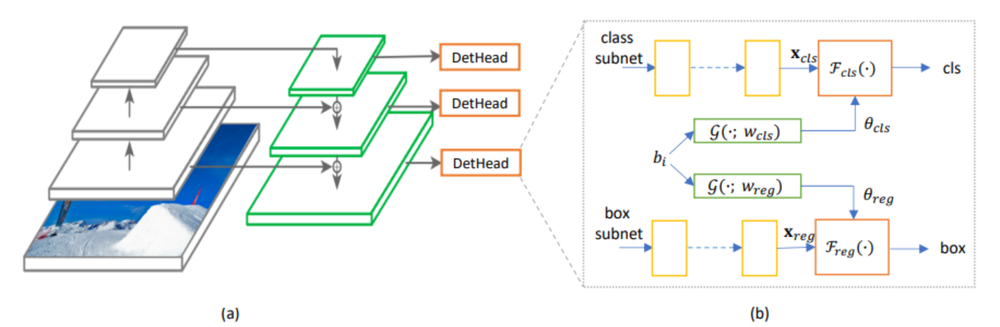

Experiments on the COCO dataset show that MetaAnchor outperforms traditional methods across various scenarios.

#### 1. Introduction

Object detection typically requires generating bounding boxes and classification labels. **Anchor-based methods** are commonly used, dividing the bounding box space into discrete bins and generating object boxes via anchor functions. However, predefined anchors have limitations:

1. Fixed anchors reduce flexibility.
2. Predefined anchor sets struggle with different datasets.

#### MetaAnchor: A Dynamic Approach

**MetaAnchor** eliminates the need for predefined anchors by dynamically generating anchor functions from prior boxes. This allows for greater flexibility and customization during inference.

##### Key Benefits

1. **Robustness**: MetaAnchor can sample anchors during training, ensuring flexible and effective learning.
2. **Adaptability**: It is better suited for tasks involving different bounding box distributions, such as transfer learning.

#### 2. Related Work

Anchor-based methods, essential to many detection systems, face challenges like excessive parameters and lack of flexibility. MetaAnchor addresses these issues by dynamically generating anchor functions.

#### 3. Approach

**MetaAnchor** uses a generator \(G(b_i; w)\) to map customized prior boxes \(b_i\) to anchor functions. The generator uses learnable parameters and a residual term to ensure efficient, flexible weight prediction.

#### 4. Conclusion

MetaAnchor introduces a flexible, robust method for anchor-based object detection, offering significant improvements in robustness to anchor settings and dataset transferability. It enhances frameworks like RetinaNet with better adaptability and performance.


# Comparison: Bounding Boxes, Anchor Boxes, and Meta Anchors

| **Feature**           | **Bounding Boxes**                          | **Anchor Boxes**                               | **Meta Anchors**                             |
|-----------------------|---------------------------------------------|-----------------------------------------------|---------------------------------------------|
| **Definition**         | Rectangular boxes enclosing detected objects | Predefined, fixed-size reference boxes for predictions | Dynamically learned templates for anchor generation |
| **Purpose**           | Represent final predicted object locations  | Serve as starting points for bounding box prediction | Adapt anchor properties to data and task dynamically |
| **Static/Dynamic**    | Dynamic (output of the model)               | Static (predefined, fixed sizes/aspect ratios) | Dynamic (learned during training)           |
| **Role in Pipeline**  | Final output                                | Intermediate step for predicting bounding boxes | Adaptive anchor generator for predictions   |
| **Design Complexity** | Simple (directly linked to objects)         | Requires manual design (scales, aspect ratios) | Fully automated learning of optimal anchors |
| **Flexibility**       | Fixed to detected object characteristics    | Limited by predefined shapes and sizes        | Highly flexible and adaptive to data        |
| **Example**           | Bounding box for a "cat" as `[x_min, y_min, x_max, y_max]` | Anchor boxes for different aspect ratios like `1:1`, `2:1`, `1:2` | Anchor shapes are learned on-the-fly during training |


### **11.4.8. What are the key features and benefits of YOLO for object detection tasks?**

YOLO (You Only Look Once) has revolutionized object detection with its unique approach of combining classification and localization in a single network pass. YOLO’s ability to provide real-time, accurate, and efficient detection has made it a critical technology for autonomous vehicles, where timely decision-making is essential for safety and performance.

#### **How does YOLO optimize for real-time detection with high accuracy in autonomous vehicles?**

- **Real-Time Detection**:
  - YOLO processes the entire image in a single forward pass, making it incredibly fast. This means it can achieve real-time object detection at high frame rates (up to 45-100 frames per second, depending on the version).
  - The single-pass approach significantly reduces computation time compared to traditional two-stage models, where region proposals are first generated and then classified.

- **End-to-End Architecture**:
  - YOLO uses an end-to-end convolutional network for object detection, making it highly efficient. It directly predicts the class of objects and the bounding box coordinates in one unified framework, eliminating the need for region proposals and simplifying the detection process.

- **High-Accuracy Performance**:
  - YOLO is known for its ability to achieve high accuracy in detecting a wide variety of objects, including vehicles, pedestrians, cyclists, and traffic signs. Despite its speed, recent YOLO versions (YOLOv4, YOLOv5) have made improvements in accuracy, especially for smaller objects and overlapping objects.

- **Global Context Awareness**:
  - YOLO considers the entire image during the detection process, which allows it to leverage global context. This is crucial for understanding the relationships between objects in complex driving environments, such as identifying a pedestrian walking towards a vehicle or detecting the road signs in the context of other vehicles.

- **Improved Object Localization**:
  - YOLO’s use of grid-based prediction enables it to predict multiple bounding boxes within each grid cell, which enhances its ability to localize objects accurately, even in crowded or cluttered scenes, like those often encountered in autonomous driving scenarios.

- **Adaptability to Different Scenarios**:
  - YOLO has been adapted to different environments and hardware configurations, offering variations such as Tiny-YOLO for resource-constrained devices. This flexibility ensures it can be used in a wide range of autonomous vehicles with different computing capabilities.

- **Fast Training and Inference**:
  - YOLO models are optimized for both fast training and inference, making it ideal for real-time applications. With its relatively low computational demands, YOLO is well-suited for deployment on embedded systems in autonomous vehicles, providing fast decision-making without requiring extensive hardware.

- **Scalable Performance**:
  - With various versions (such as YOLOv3, YOLOv4, and YOLOv5), each offering trade-offs between speed and accuracy, YOLO can be fine-tuned for specific tasks in autonomous driving. This scalability ensures that YOLO can be used in vehicles with varying computational power, from high-end systems to more budget-conscious solutions.

#### **Key Benefits of YOLO for Autonomous Vehicles**:

1. **Efficiency**:
   - YOLO is optimized for fast inference, making it suitable for real-time applications in autonomous driving where quick object detection is critical for safety and navigation.

2. **Accuracy**:
   - While maintaining speed, YOLO achieves high accuracy in detecting objects, even in challenging scenarios such as poor lighting, motion blur, or complex traffic environments.

3. **Robust Multi-Object Detection**:
   - YOLO can detect and classify multiple objects simultaneously, which is essential for autonomous driving applications that require real-time awareness of pedestrians, other vehicles, cyclists, and road hazards.

4. **Simplified Detection Pipeline**:
   - By combining both localization and classification in a single model, YOLO simplifies the object detection pipeline, reducing the complexity of deploying and maintaining systems in autonomous vehicles.

5. **Versatility**:
   - YOLO can be used for a wide range of tasks in autonomous driving, from detecting road signs and traffic lights to recognizing pedestrians and vehicles, making it a versatile tool for various detection needs.

6. **Improved Versions**:
   - With each iteration, YOLO has improved in terms of both accuracy and efficiency. YOLOv4 and YOLOv5 have enhanced features that allow for better performance in real-world driving environments, including more accurate bounding box predictions and better handling of smaller objects.

![](https://github.com/ultralytics/docs/releases/download/0/object-detection-examples.avif)

[YOLO](https://docs.ultralytics.com/tasks/detect/)

In conclusion, YOLO’s combination of speed, accuracy, and simplicity makes it an ideal choice for object detection tasks in autonomous driving. Its ability to detect and localize multiple objects in real-time is critical for ensuring the safety and efficiency of autonomous vehicles as they navigate complex and dynamic environments.


In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 887.3/887.3 kB 14.2 MB/s eta 0:00:00



Found https://ultralytics.com/images/bus.jpg locally at bus.jpg
image 1/1 /content/bus.jpg: 640x480 4 persons, 1 bus, 171.9ms
Speed: 5.1ms preprocess, 171.9ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 480)


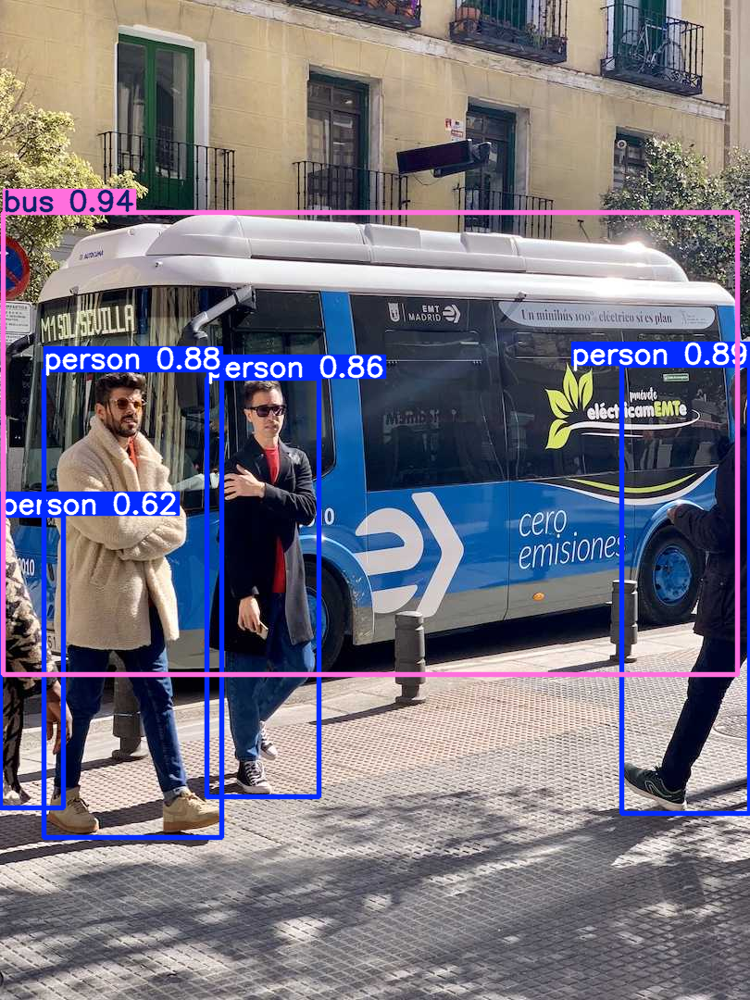

In [ ]:
from ultralytics import YOLO

# Load the model
model = YOLO("yolo11n.pt")  # Load an official model

# Predict on the image
results = model("https://ultralytics.com/images/bus.jpg")  # Predict on an image

# Show the image with predictions
results[0].show()  # Access the first result and display the image with predicted results


### **11.4.9. How does the sliding window technique work in computer vision for object detection?**

The sliding window technique is a fundamental approach used in object detection to locate objects in different regions of an image. It involves moving a fixed-size window across an image at different scales and positions to examine each part of the image. This method allows the model to search for objects in a variety of locations within the image and detect them, even if they appear at different sizes or locations.

#### **What is the sliding window technique?**
- **Definition**: The sliding window technique is an exhaustive search method where a fixed-size window moves across an image in steps, typically both horizontally and vertically, covering all regions. At each step, the window examines the portion of the image it covers and classifies whether it contains an object of interest.
  
- **Process**:
  1. **Window Initialization**: A window of a fixed size is defined, and it is initially placed at the top-left corner of the image.
  2. **Sliding the Window**: The window slides across the image in small steps, covering the entire image. This can happen both horizontally and vertically, and the step size (stride) determines the overlap between adjacent windows.
  3. **Object Classification**: For each window position, the region of the image inside the window is passed through a classifier (e.g., a convolutional neural network or a traditional machine learning model) to determine if it contains a target object.
  4. **Scaling the Window**: To detect objects of different sizes, the window can be resized to different scales. This allows the technique to detect objects regardless of their size within the image.

#### **How does the sliding window technique help detect objects in different regions of an image?**
- **Searches All Regions**: The sliding window systematically scans through the image, ensuring that every region is checked for the presence of an object. By moving the window across the entire image, the technique covers every possible location where an object might be present.
  
- **Localizing Objects**: By sliding across the image, the technique can localize objects within specific regions, as it classifies each window to identify whether it contains a particular object. This allows it to detect objects that may appear in various locations within the image.
  
- **Handling Multiple Objects**: Multiple sliding windows can be used simultaneously to search for different objects in various parts of the image. This can help detect objects in a cluttered scene by analyzing each section individually.
  
- **Flexible to Object Sizes**: The ability to scale the window allows the sliding window technique to detect objects of various sizes. The window can start at one scale, move across the image, and then resize to check for smaller or larger objects, ensuring that the technique works for a wide range of object sizes.

#### **Challenges of the Sliding Window Technique:**
1. **Computationally Expensive**: The sliding window method can be computationally expensive, as it requires applying the classifier to every window, potentially covering the entire image at multiple scales. This can lead to high processing times, especially with large images.
2. **Redundancy**: There can be significant overlap between adjacent windows, leading to redundant computations.
3. **Limited Detection Range**: While the sliding window technique searches for objects in different parts of the image, it may miss certain objects if the window size is not appropriate or if objects are too small or large relative to the chosen window scale.

#### **Use in Object Detection**:
In the past, the sliding window technique was widely used in object detection tasks such as pedestrian detection or face detection. It has been incorporated in many early detection algorithms like Histogram of Oriented Gradients (HOG) with a linear classifier. However, modern deep learning-based object detection methods like YOLO and Faster R-CNN have largely replaced the sliding window approach due to their higher efficiency and accuracy.

Nevertheless, the sliding window remains a useful concept in computer vision, particularly in simpler or computationally constrained environments.



## **11.5. Instance Segmentation**


### **11.5.1. What is instance segmentation and how does it differ from semantic segmentation in autonomous vehicles?**

Instance segmentation is a computer vision task that involves segmenting and labeling individual objects within an image, distinguishing between different instances of the same object class. This is an advanced form of segmentation that not only labels each pixel as belonging to a specific class (like semantic segmentation) but also differentiates between different objects of the same class.

![](https://www.ibm.com/content/dam/connectedassets-adobe-cms/worldwide-content/creative-assets/s-migr/ul/g/e0/14/image-segmentation-diagram-all-4x.component.complex-narrative-m.ts=1724685248074.png/content/adobe-cms/us/en/topics/instance-segmentation/jcr:content/root/table_of_contents/body/content_section_styled/content-section-body/complex_narrative_co_460940063/items/content_group_1131846919/image)

#### **How does instance segmentation distinguish between multiple objects of the same class (e.g., cars in a parking lot)?**
- **Semantic Segmentation vs. Instance Segmentation**: In semantic segmentation, all pixels that belong to the same class are labeled with the same tag, so multiple cars in a parking lot would all have the same label (e.g., "car"). However, instance segmentation goes a step further and differentiates each car, assigning a unique label to each one. For example, car 1, car 2, and so on, even though all belong to the same "car" class.
  
- **Object-Level Differentiation**: Instance segmentation creates a mask for each individual object, allowing the system to distinguish between different instances of the same class. This is done by separating the foreground pixels associated with each object and assigning them unique identifiers. As a result, even though the objects belong to the same category (e.g., vehicles), each instance is given a unique label, allowing for better identification and tracking.

- **Applications in Autonomous Driving**: In driving scenarios, instance segmentation helps with more accurate object detection, especially in crowded environments. For example, when detecting vehicles in a parking lot or on a busy street, instance segmentation ensures that each car, pedestrian, or other objects are individually identified and not treated as a single mass of pixels belonging to the same category.

#### **How do models handle segmentation of multiple instances of the same object in an image, which is crucial for driving scenarios?**

Instance segmentation plays a crucial role in autonomous driving, where the goal is not only to detect objects in an image but to distinguish between individual instances of the same object class (e.g., detecting and segmenting multiple cars or pedestrians). In complex driving environments, where objects can overlap, occlude, or move dynamically, models need to accurately identify and segment each instance of an object.

### Key Concepts in Instance Segmentation

#### 1. Instance Segmentation Models (Detection and Segmentation)
These are the models used to perform instance segmentation, including both **two-stage** and **single-stage** approaches. They work together to detect and segment individual object instances.

- **Two-Stage Models (e.g., Mask R-CNN)**:
  - **Step 1: Object Detection**: First, the model detects regions in the image that likely contain objects (using region proposal methods).
  - **Step 2: Instance Segmentation**: Then, the model applies pixel-wise segmentation to generate masks for each object detected, allowing it to distinguish between instances even if they are close together.

- **Single-Stage Models (e.g., YOLACT)**:
  - These models perform both object detection and instance segmentation in one step, using parallel processing. This allows faster processing, which is important in real-time applications like autonomous driving.

#### 2. Model Architectures (Encoder-Decoder, Convolutional Neural Networks, and Transformers)
These refer to the underlying architecture of the models used for instance segmentation and how they process images to extract and segment features.

- **Convolutional Neural Networks (CNNs)**:
  - CNNs are used to extract relevant features from input images, allowing the model to identify objects and learn complex patterns.
  - They can be applied in both two-stage and single-stage instance segmentation models.

- **Transformers (e.g., Vision Transformers, Swin Transformers)**:
  - These models use **self-attention** to capture long-range relationships within an image, which can improve segmentation accuracy, especially in complex, crowded scenes like driving environments.
  - **Swin Transformers** improve the efficiency of transformers by using shifted windows, making them less computationally expensive.

- **Encoder-Decoder Architecture**:
  - The encoder extracts features from the image, and the decoder reconstructs the image with segmentation maps (both class and instance labels). This architecture is central to both CNN-based and transformer-based models.

#### 3. Masking and Labeling
This describes how the model assigns labels to individual objects in the image.

- **Masking and Labeling**:
  - The model creates a mask for each object and labels it not only by its class (e.g., "car") but also by its instance (e.g., "car 1", "car 2"). This allows it to distinguish between different instances of the same object class.

#### 4. Region Proposal Networks (RPNs) and Mask Generation
These are mechanisms for detecting regions of interest in the image and generating accurate segmentation masks for each detected instance.

- **Region Proposal Networks (RPNs)**:
  - Used in models like Mask R-CNN, RPNs help identify potential object regions in the image by generating bounding boxes. These regions are then analyzed for object presence.
  - Once the regions are identified, instance segmentation is applied to each, generating accurate masks for each detected object.

![](https://miro.medium.com/v2/resize:fit:1100/format:webp/1*2XfVI3HEucG3pmF3QeWTgQ.jpeg)

#### 5. Handling Occlusions and Overlaps
In real-world scenarios, objects may be partially hidden or overlapping, which is common in driving environments. This concept explains how models can handle such challenges.

- **Handling Occlusions and Overlaps**:
  - Objects often overlap or occlude each other (e.g., one car in front of another), but instance segmentation ensures that each object is still segmented individually. Models like Mask R-CNN can differentiate overlapping objects and assign separate segmentation masks to each.


#### 6. Tracking and Multiple Object Identification
This concept involves the ability to track and identify multiple instances of objects over time, which is important for dynamic environments like driving.

- **Tracking and Multiple Object Identification**:
  - Instance segmentation not only detects and segments objects but also helps in tracking their position across video frames. This is essential in driving scenarios for tracking vehicles, pedestrians, and other objects in motion.


### Summary of Grouped Key Concepts:
1. **Instance Segmentation Models** (e.g., Mask R-CNN, YOLACT) – Defines how the model performs both detection and segmentation.
2. **Model Architectures** (CNNs, Transformers, Encoder-Decoder) – The underlying structures that process images for segmentation.
3. **Masking and Labeling** – How the model assigns unique labels to objects, distinguishing between different instances.
4. **Region Proposal Networks and Mask Generation** – How regions are proposed and segmentation masks are generated for each object.
5. **Handling Occlusions and Overlaps** – How models address challenges such as object occlusion or overlap.
6. **Tracking and Multiple Object Identification** – How instance segmentation helps in tracking and identifying objects over time.

The concepts are grouped logically to show their relationship and avoid overlap. The **Instance Segmentation Models** work with **Masking and Labeling** to provide instance-level segmentation, which relies on **RPNs** for region identification and the **Encoder-Decoder** architecture for feature extraction and mask generation. **Handling Occlusions** and **Tracking** are crucial when working in dynamic environments like driving.


#### **Key Difference from Semantic Segmentation**:
- **Semantic Segmentation**: Assigns a class label to each pixel (e.g., "car," "pedestrian," "road") but does not differentiate between instances of the same class. Multiple cars in the same image would all be labeled as "car," and they would be indistinguishable.
  
- **Instance Segmentation**: Assigns a unique instance label to each object, even if they belong to the same class. Each car in the parking lot would not only be labeled as "car" but also as "car 1," "car 2," etc., allowing the model to track and differentiate between each individual object.

Instance segmentation is essential in autonomous driving for precise object detection, collision avoidance, and efficient decision-making in complex driving environments.


### **11.5.2. How does Mask R-CNN perform both object detection and instance segmentation?**

Mask R-CNN is an extension of Faster R-CNN that enables the simultaneous detection of objects and the generation of precise instance segmentation masks. This architecture is widely used in autonomous vehicles for both detecting objects (e.g., cars, pedestrians) and segmenting each instance in high-resolution images, providing a robust solution for perception tasks.

#### **What is the architecture of Mask R-CNN and how does it handle both tasks simultaneously for autonomous vehicle perception?**
- **Faster R-CNN Backbone**: Mask R-CNN builds upon Faster R-CNN, which is a region-based convolutional neural network designed for object detection. It uses a Region Proposal Network (RPN) to generate potential bounding boxes for objects in the image. These bounding boxes are the areas of interest where objects are most likely to be located.

- **RoIAlign**: One of the key innovations in Mask R-CNN is the introduction of RoIAlign (Region of Interest Align), which replaces the RoIPooling step used in Faster R-CNN. RoIAlign improves the accuracy of the region proposal by avoiding quantization of feature maps, ensuring that the features extracted for each proposed region are more precise and spatially aligned. This is particularly important for high-quality segmentation.

- **Two Parallel Heads**:
  - **Object Detection Head**: Like Faster R-CNN, Mask R-CNN has an object detection head that predicts the class and bounding box for each object in the image.
  - **Mask Prediction Head**: The second head of the network is responsible for predicting a segmentation mask for each detected object. It generates a pixel-wise mask for each object within its proposed bounding box. This allows the model to not only detect the object but also segment it at the pixel level, which is essential for autonomous vehicle perception tasks like obstacle avoidance, road marking recognition, and vehicle tracking.

- **Simultaneous Tasks**: Mask R-CNN performs both tasks (object detection and instance segmentation) in parallel during the inference process. The detection head predicts the bounding boxes and class labels, while the mask head generates the precise segmentation masks for each instance. This parallelization allows for efficient real-time object detection and segmentation, which is crucial for dynamic driving environments.

#### **How does the mask prediction head in Mask R-CNN generate pixel-level segmentation masks for precise vehicle detection?**
- **Mask Prediction Architecture**: The mask prediction head of Mask R-CNN generates a binary segmentation mask for each detected object. For each object proposal (i.e., each region within a bounding box), the network outputs a small, fixed-size mask (e.g., 28x28 pixels). This mask represents the pixel-level segmentation of the object within its bounding box.

- **Upsampling**: After predicting the small mask, Mask R-CNN upscales it to the original size of the bounding box using bilinear interpolation. This ensures that the segmentation mask aligns with the actual object in the image, providing a high-quality pixel-wise segmentation of the object.

- **Multi-Class Segmentation**: Mask R-CNN can handle multiple object classes simultaneously. It generates a separate segmentation mask for each detected object and assigns it a unique label based on the class predicted by the object detection head. For instance, in a scenario with cars and pedestrians, the model will output different masks for each instance of a car and each pedestrian, even if they belong to the same class.

- **Pixel-Level Precision**: The mask head in Mask R-CNN is trained to predict pixel-level precision in the segmentation masks, which allows the model to distinguish between objects with high accuracy. In autonomous vehicles, this level of detail is crucial for tasks like identifying the exact boundaries of a vehicle for collision avoidance, detecting pedestrians for safety, and recognizing road features for navigation.

#### **Applications in Autonomous Driving**:
- **Vehicle and Pedestrian Detection**: Mask R-CNN's ability to generate precise instance segmentation masks makes it well-suited for vehicle and pedestrian detection in autonomous driving. It can accurately identify individual vehicles in a traffic scene and track their movement, even in crowded or dynamic environments.
  
- **Obstacle Avoidance**: The model can segment and label obstacles on the road, providing valuable information for obstacle detection and navigation. By detecting and segmenting obstacles like other vehicles, pedestrians, and traffic signs, the vehicle can make safer driving decisions.

- **Lane and Road Marking Recognition**: Mask R-CNN can also be used for road marking and lane detection, enabling the vehicle to understand the structure of the road and navigate accordingly.

#### **Key Benefits of Mask R-CNN in Autonomous Vehicles**:
- **Simultaneous Object Detection and Segmentation**: Mask R-CNN's ability to detect and segment objects at the same time is essential for real-time perception tasks in autonomous vehicles.
- **High-Quality Segmentation Masks**: The mask head generates pixel-wise segmentation masks, which allows for more detailed understanding of the environment, important for tasks like object tracking and precise obstacle detection.
- **Versatility**: Mask R-CNN can handle a wide range of object types and scenarios, from vehicles and pedestrians to road features, making it highly versatile for autonomous driving systems.

Mask R-CNN provides a powerful and efficient solution for both object detection and instance segmentation, making it a vital tool in the perception stack of autonomous vehicles.


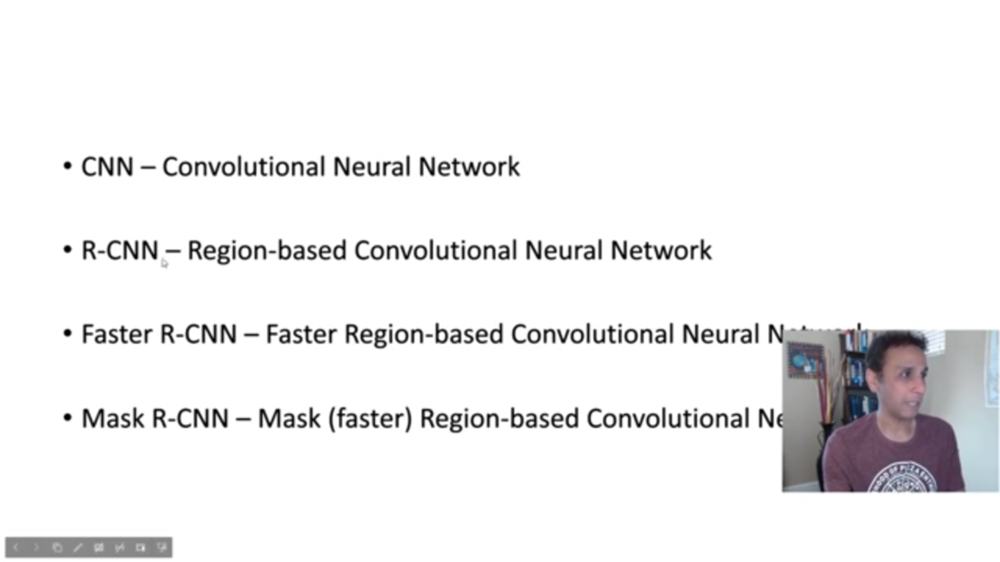

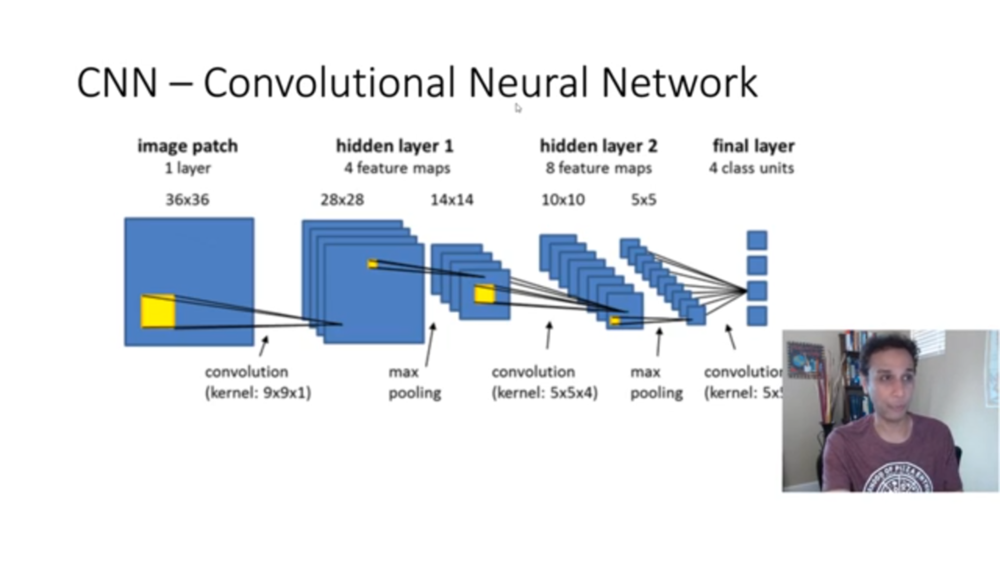

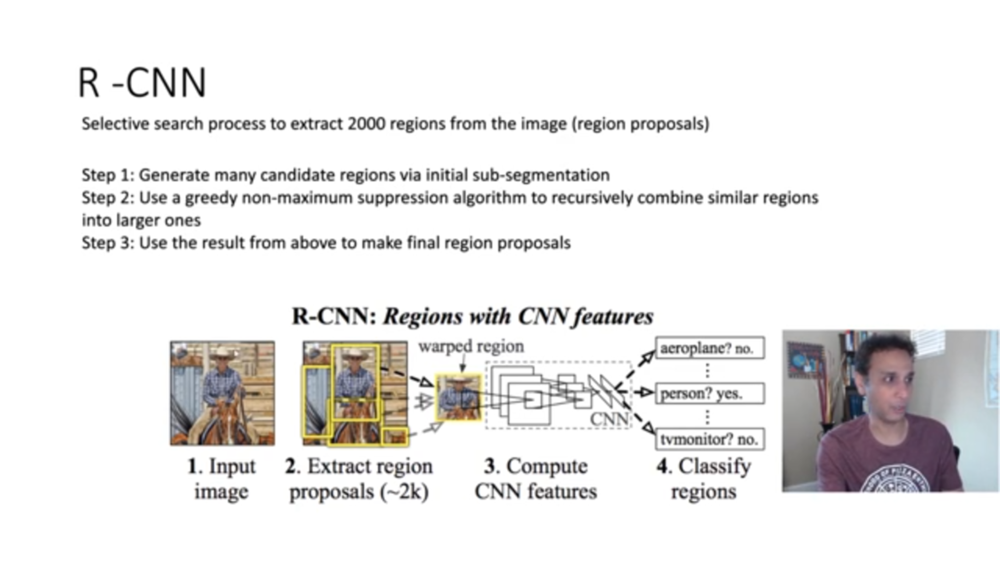

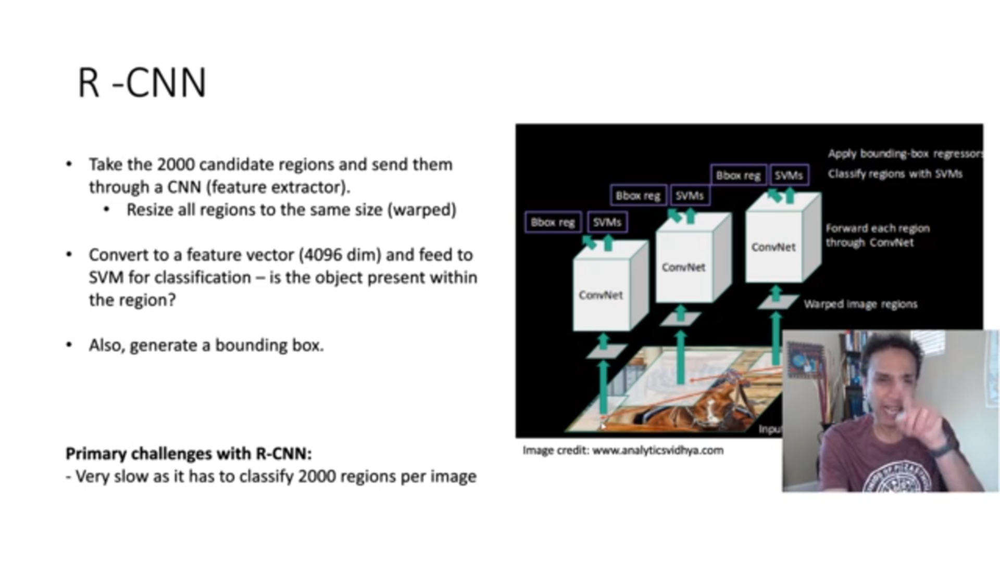

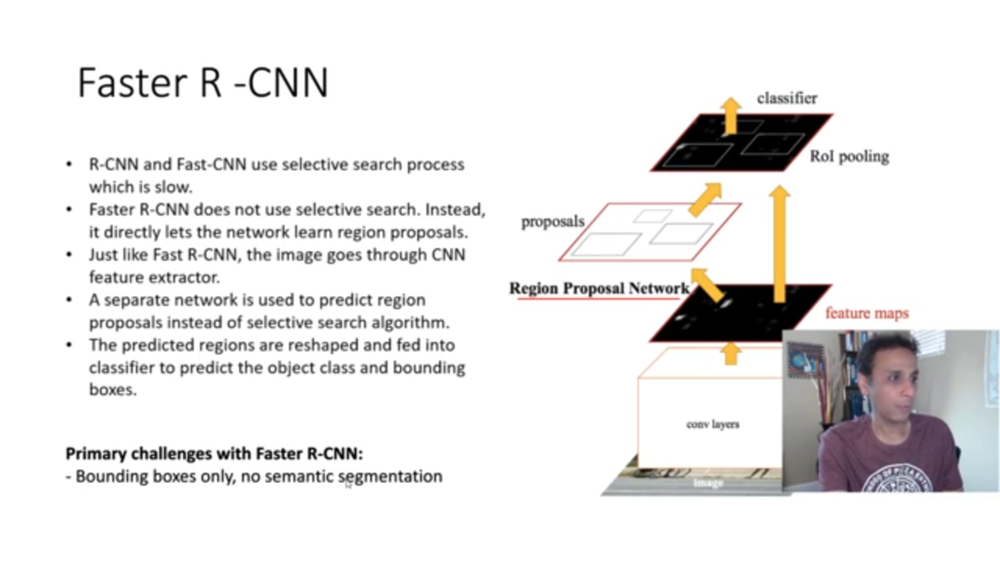

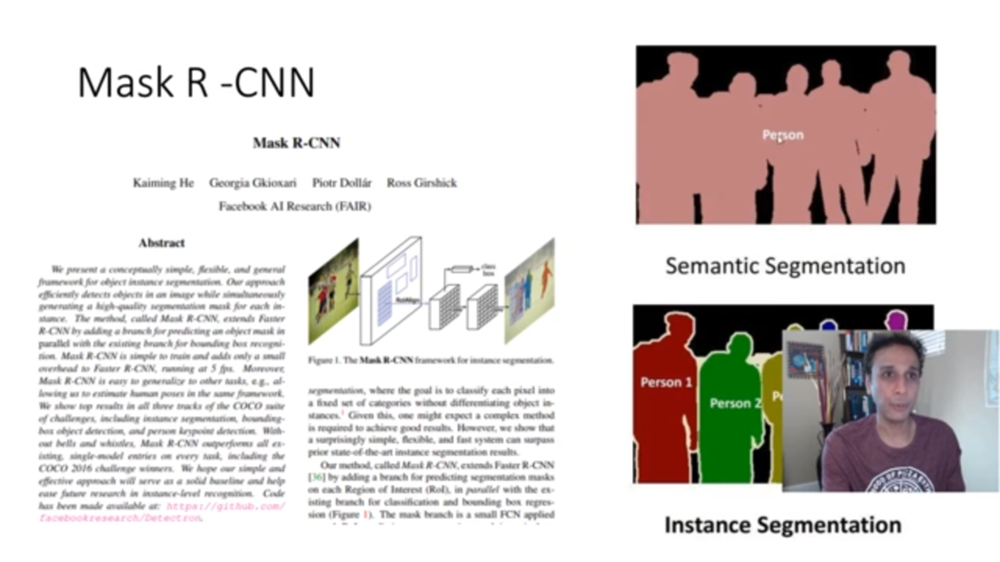

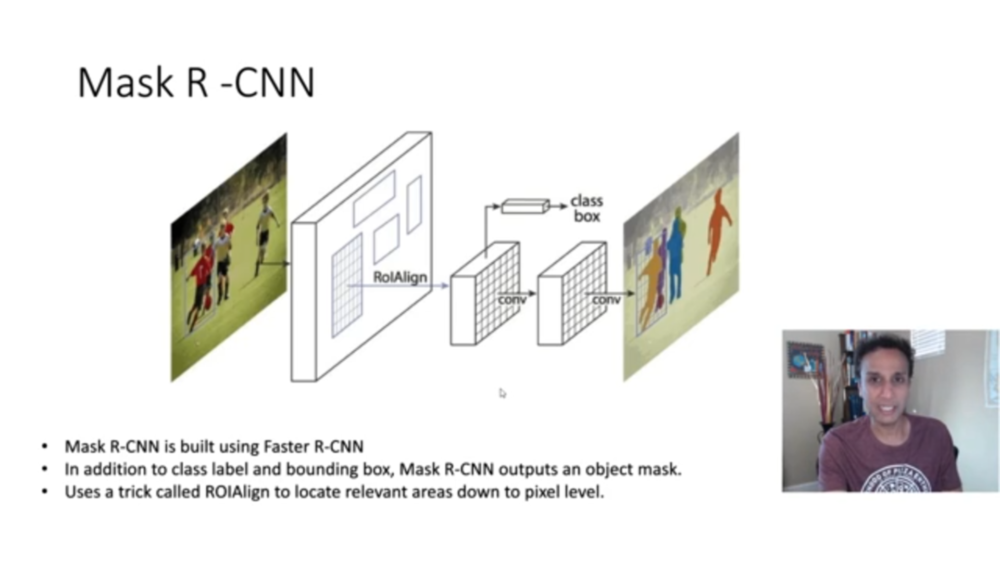

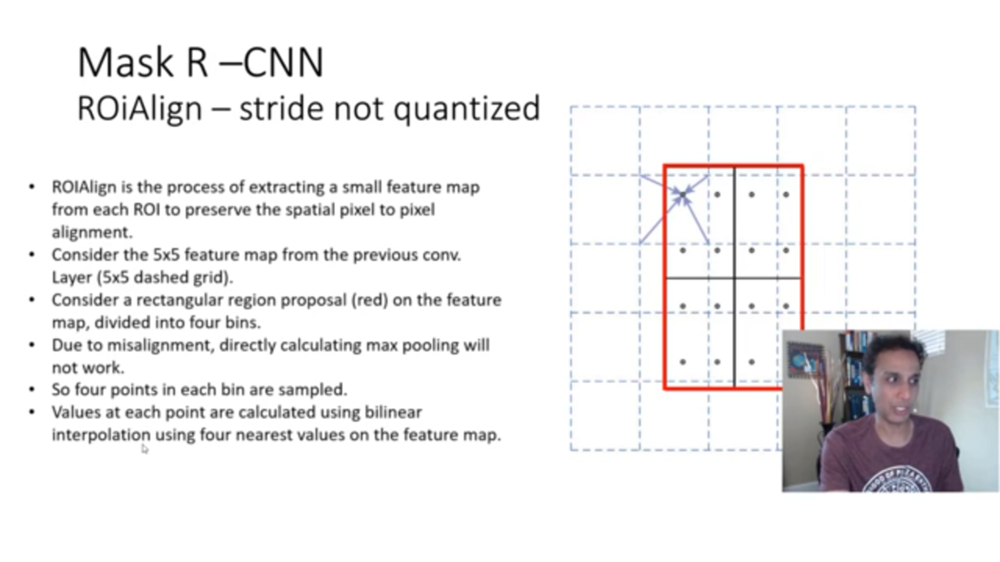

![](https://blog.roboflow.com/content/images/2024/04/image-1074.webp)

### **11.5.3. What are the main challenges in instance segmentation for autonomous driving?**

Instance segmentation is a critical task in autonomous driving as it involves both detecting objects (such as vehicles and pedestrians) and segmenting each instance at the pixel level. However, there are several challenges that need to be addressed to make instance segmentation robust and efficient in complex driving environments.

#### **How do instance segmentation models handle occlusions and overlapping instances in busy traffic scenarios?**
- **Occlusion Handling**: Occlusions occur when one object blocks part or all of another object from view. In busy traffic scenarios, vehicles or pedestrians can be partially obscured by other objects, making it challenging to accurately segment and identify individual instances. Instance segmentation models typically handle occlusions by:
  - **Feature Fusion**: Combining multiple layers of features from the network's backbone can help the model maintain context for occluded objects. By merging information from various levels, the model can infer missing parts of occluded objects.
  - **Region Proposals**: Using region proposal networks (RPNs), like in Mask R-CNN, the model generates potential bounding boxes for objects, even those that may be partially hidden. It then uses context from surrounding areas to better estimate the full shape and boundaries of occluded objects.
  - **Contextual Information**: Some models use contextual information, such as the relationships between different objects in the scene (e.g., vehicle in front of pedestrian), to disambiguate occluded instances.

- **Overlapping Instances**: In dense traffic scenarios, multiple objects can overlap, creating significant challenges for instance segmentation. To handle overlapping instances:
  - **Instance-Level Segmentation Masks**: Each instance of an object is assigned a unique segmentation mask. The model needs to generate distinct, non-overlapping masks for each instance, even if they are close together or partially occluded.
  - **Hierarchical Object Detection**: Some models use hierarchical approaches, where objects are first detected at a coarse level, and then fine-tuned for more precise segmentation. This multi-stage process helps in separating overlapping instances.
  - **Bounding Box Refinement**: The model can refine predicted bounding boxes based on surrounding objects and context, improving the separation of overlapping instances.

#### **What techniques can improve the precision of pixel-wise predictions for overlapping objects like vehicles in dense traffic?**
- **Better Backbone Architectures**: A stronger backbone (e.g., ResNet, EfficientNet) can improve feature extraction, which is crucial for distinguishing between overlapping objects. These architectures allow for better learning of fine-grained details, especially in complex scenes.
  
- **Multi-Scale Feature Fusion**: By combining features from multiple scales, the model can better capture both small and large objects in the image. This helps to segment overlapping objects at different scales accurately.
  
- **Mask Refinement Networks**: Refinement networks can be employed after the initial segmentation to improve the quality of the masks, especially in overlapping regions. These networks learn to refine the edges and boundaries of the segmentation masks.
  
- **Attention Mechanisms**: Attention mechanisms can help the model focus on the most relevant parts of the image, particularly in challenging areas where objects overlap. Self-attention or spatial attention can guide the model to emphasize important regions and improve mask accuracy.
  
- **Use of Depth Information**: Depth sensors, such as LiDAR or stereo cameras, can be integrated with the instance segmentation model to provide additional spatial information. This can help resolve ambiguities when objects are overlapping by providing 3D context.
  
- **Graph-Based Approaches**: Some advanced techniques use graph-based methods to handle relationships between objects in the scene. These approaches can model interactions between objects and improve the segmentation of instances that are close together or overlapping.

- **Post-Processing Techniques**: Techniques like **Non-Maximum Suppression (NMS)** or **Soft-NMS** are commonly used to refine predictions by eliminating redundant detections or improving boundary precision. These methods can help in separating overlapping objects and enhancing the quality of the segmentation masks.

#### **Conclusion**:
Instance segmentation is crucial for autonomous driving but presents significant challenges, especially in scenarios with occlusions and overlapping objects. By leveraging advanced architectures, multi-scale feature fusion, attention mechanisms, and external data sources like depth information, autonomous systems can improve the precision of segmentation tasks. Additionally, techniques such as post-processing and mask refinement are essential to ensure high-quality pixel-wise predictions, which are necessary for safe and efficient driving in complex environments.


### **11.5.4. What is panoptic segmentation and how is it different from instance segmentation?**

Panoptic segmentation is an advanced computer vision task that aims to provide a comprehensive understanding of a scene by combining both semantic segmentation (identifying object classes) and instance segmentation (distinguishing between different objects of the same class). This approach offers a complete scene understanding, crucial for autonomous vehicles that need to interpret complex environments for safe navigation.

#### **What is the concept of panoptic segmentation and how does it combine semantic and instance segmentation for full scene understanding?**

- **Semantic Segmentation**: In semantic segmentation, each pixel in the image is assigned a class label (e.g., road, vehicle, pedestrian) but does not distinguish between different instances of the same class. This task provides a general understanding of the scene.
  
- **Instance Segmentation**: Instance segmentation goes a step further by not only labeling the class of each pixel but also distinguishing between different instances of the same class (e.g., separating multiple vehicles in a parking lot). This is critical for tracking individual objects in a scene.

- **Panoptic Segmentation**: Panoptic segmentation combines both of these tasks. It provides a pixel-level classification of the scene, where every pixel is either labeled with a class (as in semantic segmentation) or with a unique instance identifier (as in instance segmentation). This means:
  - Every pixel in the image is assigned both a class label and an instance ID (for objects like cars or pedestrians).
  - This enables the model to classify both the type of objects and the individual instances, providing a richer and more detailed understanding of the environment.
  
In essence, panoptic segmentation merges the benefits of semantic segmentation (overall scene understanding) and instance segmentation (precise object delineation), offering a full view of both the objects and the scene itself.

#### **How does panoptic segmentation improve on traditional instance segmentation in understanding complex driving environments?**

Panoptic segmentation improves on traditional instance segmentation by:
- **Unified Approach**: Traditional instance segmentation focuses only on detecting and segmenting individual objects. Panoptic segmentation, on the other hand, provides both object classification and segmentation, including background areas like roads, sidewalks, and traffic signs. This gives a more complete view of the scene, which is essential for tasks such as path planning, obstacle avoidance, and decision-making in autonomous driving.
  
- **Handling Unlabeled Regions**: In traditional instance segmentation, regions that are not occupied by objects of interest (such as road surfaces) may not be handled adequately. Panoptic segmentation, however, labels these areas with a "thing" or "stuff" label (e.g., road, sky), ensuring that all parts of the image are classified, even if no distinct object is present. This improves environmental understanding for vehicles when navigating complex or sparse areas.
  
- **Improved Efficiency**: By combining semantic and instance segmentation into one unified model, panoptic segmentation can improve computational efficiency. Instead of running separate models for semantic segmentation and instance segmentation, a panoptic segmentation model can perform both tasks simultaneously, saving processing power and reducing model complexity.

- **Better Scene Understanding for Complex Driving Environments**: Panoptic segmentation is especially useful in complex driving scenarios, such as urban environments, where many objects (vehicles, pedestrians, cyclists) and non-object elements (roads, sidewalks, buildings) coexist. It provides a richer, more detailed map of the environment, allowing the autonomous system to make more informed decisions. For example, when dealing with overlapping vehicles in a busy intersection, panoptic segmentation can still differentiate between the objects and the road or sidewalk, even when some vehicles are partially occluded.

![](https://www.researchgate.net/profile/Andra-Petrovai/publication/329616112/figure/fig2/AS:739657281175556@1553359446925/Panoptic-segmentation-by-unifying-semantic-and-instance-segmentation.ppm)

#### **Conclusion**:
Panoptic segmentation offers a more holistic approach to scene understanding by combining the strengths of both semantic and instance segmentation. For autonomous vehicles, this means better recognition of objects, improved handling of occlusions, and a more comprehensive understanding of the environment, all of which are crucial for navigating complex driving scenarios safely and efficiently.



## **11.6. Additional General Questions for Autonomous Vehicle Applications**


### **11.6.1. What is the role of data augmentation in improving the performance of deep learning models for object detection?**

Data augmentation plays a crucial role in improving the generalization and robustness of deep learning models for object detection, especially in the context of autonomous driving. The goal is to artificially expand the dataset by applying transformations to the original data, which helps the model learn to recognize objects under different conditions and variations that may occur in real-world scenarios.

#### **How do techniques like flipping, rotation, and scaling improve the generalization of models in driving conditions?**

- **Flipping**: Flipping the images horizontally or vertically simulates the appearance of objects from different orientations. This is useful in autonomous driving scenarios where vehicles, pedestrians, and other objects can appear from various angles on the road. By flipping the images, the model becomes better at recognizing objects from all directions, improving its robustness in detecting vehicles and pedestrians regardless of orientation.
  
- **Rotation**: Rotating the images allows the model to be exposed to objects that appear at different angles. This is particularly important in driving environments where objects like traffic signs, road markings, or vehicles can appear at various orientations due to turns, slopes, or camera perspectives. Rotated images help the model handle such transformations, making it more adaptable to real-world driving scenarios.

- **Scaling**: Scaling refers to resizing images to simulate objects at different distances or sizes. In driving, objects may appear smaller (distant) or larger (closer) depending on the vehicle's proximity. Scaling helps the model learn to detect objects effectively, regardless of their size or distance from the camera, enhancing performance in dynamic driving environments.

These techniques, along with others like cropping, color jittering, and adding noise, help models become more robust to variations in lighting, weather conditions, and environmental factors that could otherwise hinder detection accuracy.



### **11.6.2. How does transfer learning contribute to the success of deep learning models in autonomous driving applications?**

Transfer learning leverages pre-trained models, typically trained on large-scale datasets like ImageNet, to improve the performance of deep learning models in specific tasks, even when labeled data is scarce. By transferring knowledge gained from one domain (e.g., general image classification) to another (e.g., vehicle detection or road segmentation), the model can achieve better performance with fewer training samples.

#### **How do pre-trained models like VGG or ResNet contribute to better performance on specific tasks like vehicle detection or road segmentation?**

- **VGG**: VGG networks, with their simple architecture of stacked convolutional layers, are widely used for transfer learning. Their ability to capture low- and mid-level features such as edges and textures is beneficial for tasks like vehicle detection, where identifying distinct patterns in images is crucial. By fine-tuning a pre-trained VGG model on a specific dataset (e.g., for autonomous vehicle detection), the model can quickly adapt to the new task, leveraging learned feature representations for improved performance.

- **ResNet**: ResNet, with its deeper architectures and residual connections, helps mitigate the vanishing gradient problem in very deep networks. It is especially effective for tasks that require extracting detailed, high-level features from complex scenes, like road segmentation. In autonomous driving, fine-tuning a pre-trained ResNet model on road segmentation tasks helps the model capture fine-grained details such as lane markings, road textures, and boundaries, leading to better accuracy in real-world driving conditions.

Transfer learning significantly accelerates model convergence and can result in better performance on tasks like vehicle detection, road segmentation, and obstacle detection, especially when large amounts of labeled data are not available.



### **11.6.3. How does the choice of loss function impact the accuracy of deep learning models for object detection in autonomous vehicles?**

The loss function plays a vital role in guiding the model's learning process by defining how the predicted outputs are penalized based on their difference from the ground truth. A well-chosen loss function can improve the model's accuracy and efficiency for object detection tasks, such as identifying obstacles, road signs, or lane boundaries.

#### **What is the role of a loss function in training models for tasks like obstacle detection or road lane segmentation?**

- **Obstacle Detection**: In object detection tasks, the loss function typically combines two components: classification loss (for classifying object types) and localization loss (for predicting the bounding box). Common loss functions like **cross-entropy loss** for classification and **smooth L1 loss** for bounding box regression are used to minimize the error between predicted and ground truth labels and bounding box coordinates. The loss function ensures that the model accurately detects and localizes obstacles, even in challenging conditions (e.g., occlusions, varying object sizes).

- **Road Lane Segmentation**: In road lane segmentation, the loss function must handle pixel-wise classification. Common choices include **cross-entropy loss** for pixel classification tasks or **dice loss**, which is particularly useful for handling imbalanced datasets, where the background (road surface) may dominate the foreground (lanes). These loss functions enable the model to learn how to predict road lanes with high precision, even in the presence of challenging factors like road curvature or occlusions from other vehicles.

The choice of loss function affects how well the model learns to differentiate between object classes, localize objects, and handle difficult scenarios such as overlapping objects, occlusions, or fine-grained segmentation details. Optimizing the right loss function is critical to ensuring high accuracy and robustness for autonomous vehicle perception tasks.


## **11.7. Conclusion**


### **11.7.1. What are the future trends in deep learning for autonomous vehicles?**

Deep learning continues to evolve and will play a pivotal role in the future development of autonomous vehicle technologies. As AI models improve and computational power increases, autonomous systems will become more reliable, efficient, and safer. Some key trends to look out for include:

#### **How will advancements in deep learning improve real-time decision-making and safety in autonomous driving systems?**

- **Improved Object Detection and Classification**: Advancements in deep learning will lead to more accurate and faster object detection and classification models. With better recognition of vehicles, pedestrians, cyclists, and other obstacles, autonomous vehicles will be able to make quicker and more precise decisions. This will improve real-time decision-making, especially in complex, dynamic environments like urban streets or highways with high traffic volumes. The enhanced accuracy in detecting objects will help minimize the risk of accidents and improve safety.

- **Enhanced Perception Systems**: The integration of multiple sensor modalities (camera, LiDAR, radar) with deep learning will create more robust and accurate perception systems. Future models will better fuse information from these sensors to create a unified understanding of the environment, even in challenging conditions like low visibility or bad weather. This multimodal perception will enable autonomous vehicles to react to real-world situations more accurately, such as avoiding collisions, detecting road hazards, and navigating complex intersections.

- **End-to-End Learning Models**: Future autonomous systems are expected to rely more on end-to-end deep learning models that can take raw sensor data (e.g., video or LiDAR) and directly output driving commands. These models, which combine perception, planning, and control in a single framework, will allow for more efficient and adaptive decision-making in real-time. This approach can significantly improve the safety and performance of autonomous vehicles by reducing delays between sensing, decision-making, and execution.

- **Real-Time Adaptation**: As deep learning models improve, autonomous vehicles will be better equipped to adapt to changing environments in real-time. For example, vehicles will be able to adjust to new traffic patterns, road conditions, or unforeseen obstacles dynamically. This adaptability will be crucial in ensuring that autonomous vehicles can operate safely in diverse environments and scenarios, from city streets to rural roads.

- **Explainability and Safety**: Future deep learning models for autonomous vehicles will also focus on enhancing explainability and interpretability. In safety-critical systems like autonomous driving, it's important to understand the reasoning behind AI decisions. Improved transparency in model predictions will help developers ensure that the vehicle behaves in a predictable and safe manner, which is essential for regulatory approval and public trust.

In summary, advancements in deep learning will significantly enhance real-time decision-making, enabling autonomous vehicles to operate more safely and efficiently in complex and unpredictable environments. As these technologies continue to evolve, they will make autonomous driving systems smarter, more adaptive, and ultimately safer for all road users.


# **next**